<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Описание-проекта" data-toc-modified-id="Описание-проекта-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Описание проекта</a></span><ul class="toc-item"><li><span><a href="#Описание-данных" data-toc-modified-id="Описание-данных-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Описание данных</a></span></li><li><span><a href="#Общий-датасет" data-toc-modified-id="Общий-датасет-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Общий датасет</a></span></li><li><span><a href="#Вывод:" data-toc-modified-id="Вывод:-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Вывод:</a></span></li></ul></li><li><span><a href="#Target" data-toc-modified-id="Target-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Target</a></span></li><li><span><a href="#Features" data-toc-modified-id="Features-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Features</a></span></li><li><span><a href="#Общая-таблица" data-toc-modified-id="Общая-таблица-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Общая таблица</a></span><ul class="toc-item"><li><span><a href="#Объединение-датасетов" data-toc-modified-id="Объединение-датасетов-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Объединение датасетов</a></span></li><li><span><a href="#Кодирование-категориальных-признаков" data-toc-modified-id="Кодирование-категориальных-признаков-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Кодирование категориальных признаков</a></span></li><li><span><a href="#Test/Train" data-toc-modified-id="Test/Train-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Test/Train</a></span></li></ul></li><li><span><a href="#Модели" data-toc-modified-id="Модели-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Модели</a></span><ul class="toc-item"><li><span><a href="#DummyClassifier" data-toc-modified-id="DummyClassifier-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>DummyClassifier</a></span></li></ul></li></ul></div>

## Описание проекта
Сервис  “Мой Чемпион” помогает спортивным школам фигурного катания, тренерам мониторить результаты своих подопечных и планировать дальнейшее развитие спортсменов.

**Цель**

Создать модель, помогающую находить элементы, которые могут быть успешно исполнены спортсменом на соревновании. 
Сервис будет прогнозировать прогресс и возможное выполнение тех или иных элементов программы по истории предыдущих выступлений и выполнения элементов на соревнованиях.

**Задачи DS**

Объединить данные, провести анализ данных, изучить аномалии, корреляции, описать наблюдения и сделать выводы.
Агрегировать датасет и подготовить обучающие признаки.
Создать модель для предсказания вероятности успешного выполнения элементов.
Проанализировать признаки, выявить ошибки и слабые стороны модели.

In [42]:
# Импорт библиотек

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
#import plotly.express as px
import re

from sklearn.preprocessing import MinMaxScaler, LabelEncoder

In [2]:
from sklearn.model_selection import train_test_split, cross_val_score,  RandomizedSearchCV
#from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.linear_model import LogisticRegression
from sklearn.multioutput import MultiOutputClassifier
from sklearn.metrics import make_scorer, f1_score


In [3]:
from sklearn.dummy import DummyClassifier

In [4]:
import catboost
import time

from tqdm import tqdm
from catboost import CatBoostClassifier

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

### Описание данных

In [8]:
# Загрузка файла с данными
total_scores = pd.read_csv('data_01_predict_progress/total_scores.csv')
tournament_scores = pd.read_csv('data_01_predict_progress/tournament_scores.csv')
tournaments = pd.read_csv('data_01_predict_progress/tournaments.csv')
units = pd.read_csv('data_01_predict_progress/units.csv')

In [9]:
units.head()

,id,color,school_id
0,9474,green,244.0
1,733,green,203.0
2,734,green,235.0
3,735,green,168.0
4,736,green,168.0


**units** - 
Юнит – спортивная единица. Мы работаем с одиночным катанием, в одном юните только один спортсмен. Если бы были пары/команды, то было б несколько спортсменов в юните.
- id: идентификатор юнита
- color: категория
- school_id: идентификатор школы

В датесете содержатся пропуски в столбцах 'school_id' и 'color' 

In [10]:
units.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4596 entries, 0 to 4595
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   id         4596 non-null   int64  
 1   color      4595 non-null   object 
 2   school_id  4007 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 107.8+ KB


In [11]:
units['color'].unique()

array(['green', 'lime', nan], dtype=object)

In [12]:
units['color'].value_counts()

color
green    3800
lime      795
Name: count, dtype: int64

In [13]:
units['school_id'].value_counts()

school_id
62.0       348
198.0      345
111.0      255
38.0       241
192.0      124
93.0        80
64.0        78
257.0       77
254.0       66
27.0        62
256.0       62
25.0        59
89.0        57
49.0        57
63.0        56
277.0       53
30.0        49
251.0       46
223.0       46
156.0       44
164.0       41
276.0       40
24.0        40
253.0       36
94.0        36
90.0        36
152.0       33
128.0       31
79.0        30
272.0       30
5.0         29
82.0        28
135.0       27
61.0        26
285.0       26
275.0       25
274.0       23
244.0       23
201.0       23
171.0       22
212.0       22
75.0        22
279.0       21
96.0        21
284.0       20
278.0       20
105.0       19
4.0         19
15.0        19
29.0        19
17.0        19
270.0       19
252.0       18
282.0       18
224.0       18
206.0       18
280.0       17
190.0       17
176.0       17
199.0       16
139.0       16
229.0       16
249.0       16
40.0        16
286.0       15
215.0       15


In [14]:
tournaments.head()

,id,date_start,date_end,origin_id
0,1,2090-11-29,2090-12-01,2.0
1,2,2091-03-06,2091-03-10,1.0
2,3,2090-10-05,2090-10-08,2.0
3,4,2090-10-18,2090-10-21,2.0
4,5,2090-10-21,2090-10-24,2.0


**tournaments** -
Турнир состоит из нескольких категорий, оценки по категориям расписаны в total_scores
- id: идентификатор турнира
- date_start: дата начала
- date_end: дата завершения
- origin_id: место проведения

In [15]:
tournaments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 142 entries, 0 to 141
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          142 non-null    int64  
 1   date_start  142 non-null    object 
 2   date_end    142 non-null    object 
 3   origin_id   142 non-null    float64
dtypes: float64(1), int64(1), object(2)
memory usage: 4.6+ KB


In [16]:
total_scores.head()

,id,unit_id,tournament_id,base_score,components_score,total_score,elements_score,decreasings_score,starting_place,place,segment_name,info,overall_place,overall_total_score,overall_place_str
0,442027,304,4785,47.2,43.47,102.70,59.23,0.0,17,1,Короткая программа,x Надбавка за прыжки во второй половине програ...,2,293.74,2
1,442028,604,4785,45.4,46.71,101.19,54.48,0.0,18,2,Короткая программа,q Прыжок приземлён в четверть x Надбавка за пр...,1,294.75,1
2,442029,409,4785,44.0,46.82,99.20,52.38,0.0,6,3,Короткая программа,q Прыжок приземлён в четверть x Надбавка за пр...,4,285.57,4
3,442030,524,4785,46.2,44.86,91.84,47.98,-1.0,3,4,Короткая программа,q Прыжок приземлён в четверть x Надбавка за пр...,3,292.42,3
4,442031,412,4785,44.2,42.59,89.73,48.14,-1.0,15,5,Короткая программа,q Прыжок приземлён в четверть x Надбавка за пр...,6,265.34,6


In [17]:
total_scores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21301 entries, 0 to 21300
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   21301 non-null  int64  
 1   unit_id              21301 non-null  int64  
 2   tournament_id        21301 non-null  int64  
 3   base_score           21301 non-null  float64
 4   components_score     21301 non-null  float64
 5   total_score          21301 non-null  float64
 6   elements_score       21301 non-null  float64
 7   decreasings_score    21301 non-null  float64
 8   starting_place       21301 non-null  int64  
 9   place                21301 non-null  int64  
 10  segment_name         21284 non-null  object 
 11  info                 20720 non-null  object 
 12  overall_place        21301 non-null  int64  
 13  overall_total_score  21284 non-null  float64
 14  overall_place_str    10814 non-null  object 
dtypes: float64(6), int64(6), object(3)
m

**total_scores** - Оценки за выступления по категориям и общие за турнир
- id: идентификатор выступления, джойнится с tournament_scores.total_score_id
- unit_id: идентификатор юнита, ключ к units.id
- tournament_id: идентификатор турнира, tournaments.id
- components_score: артистизм (мастерство, композиция, хореография)
- base_score: базовая оценка за элементы в выступлении (идеал)
- elements_score: реальная оценка всех выполненных элементов, base_score+goe
- decreasings_score: снижения оценок за ошибки
- total_score: components_score+elements_score+decreasings_score за выступление
- starting_place: жеребъёвка
- place: занятое место в категории category_name+segment_name
- segment_name: название сегмента
- info: комментарии и пояснения к оценке
- overall_place: итоговое место в турнире
- overall_total_score: итоговая оценка за весь турнир
- overall_place_str: комментарии, пояснения

In [18]:
tournament_scores.head()

,id,total_score_id,title,decrease,base_score,goe,avg_score
0,1,1,2A,NaN,3.3,0.66,3.96
1,2,1,3F+3Lo,NaN,10.2,-0.11,10.09
2,3,1,3Lz,NaN,0.0,-1.30,5.19
3,4,1,CCoSp4,NaN,3.5,0.56,4.06
4,5,1,FCSp4,NaN,3.2,0.64,3.84


In [19]:
# выполняемые элементы
tournament_scores['title'].value_counts().head(100)

title
CCoSp4        8687
2A            8500
ChSq1         8301
CCoSp3        6064
StSq2         5097
LSp4          4551
3Lo           3904
1A            3379
2Lz           3266
2F            2967
3Lz           2882
FCSp4         2802
FSSp3         2753
StSq1         2725
LSp3          2641
FSSp4         2606
3F            2468
3S            2240
StSqB         2095
StSq3         1943
2S            1914
CCoSp2        1779
2Lo           1776
2A<<          1767
FSSp2         1694
3Lz+3T        1685
FCSp3         1674
1Lz           1644
FCCoSp4       1600
ChSpl1        1588
CSSp4         1578
2A<           1252
2Lz+2Lo       1241
3Lz+2T        1115
LSp2          1058
3S+2T         1018
CSSp3          977
3T             977
2Lz+2T         964
CCoSp1         942
3A             911
SSpB           856
3F+2T          851
3Lo<           830
3Lo+2T         820
2F+2Lo         805
3S<            794
2Lz<           752
FCSp2          750
2A+2T          724
2F<            711
2F!            683
FSSp1 

In [20]:
tournament_scores['title'].nunique()

3425

In [21]:
tournament_scores['decrease'].unique()

array([nan, 'q', '<', '!', '<<', 'nS', 'F', '*', 'e', 'nU', 'nC', '<<*',
       '<*', 'B', 'nS*', '!F', 'F*', '!*', 'q*', 'e*', 'nF', 'nB', 'B.',
       'f*', 'В', '<F', 'qF', 'b', '!<', 'f', '!F*', 'FnU', 'FF'],
      dtype=object)

- '*' - элемент не засчитывается
- q - недокручена четверть
- < - недокручено 90-180 градусов
- << - недокручено больше 180 градусов
- e  - отталкивание не с того ребра
- ! - толчок не с точного ребра
- F - упал
- B - bonus 
- nU, nC, nS, nF, nB - ошибки во вращениях

**tournament_scores** - Таблица с оценками поэлементно
- id: идентификатор оценки за конкретный элемент/комбинацию
- total_score_id: идентикатор выступления, ключ total_scores.id
- title: запись элемента или комбинации элементов с отметками об ошибках
- decrease: за что снижена оценка
- base_score: базовая оценка (идеал, цена данного элемента/комбинации, сложность)
- goe: Grade of Execute, качество исполнения, судейские надбавки/убавки
- avg_score: оценка за элемент/комбинацию (усредненная по судьям)

In [23]:
tournament_scores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 172158 entries, 0 to 172157
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   id              172158 non-null  int64  
 1   total_score_id  172158 non-null  int64  
 2   title           172158 non-null  object 
 3   decrease        41185 non-null   object 
 4   base_score      172158 non-null  float64
 5   goe             172158 non-null  float64
 6   avg_score       172158 non-null  float64
dtypes: float64(3), int64(2), object(2)
memory usage: 9.2+ MB


В 'decrease'  много пропусков - это связано с тем, что замечаней по выполнению элементов не было

В 'base_score'  - базовая оценка много полей заполненных нулями - исправим это, рассчитав 'base_score' как 'avg_score'-'goe'

In [24]:
tournament_scores['base_score'] = tournament_scores['avg_score'] - tournament_scores['goe']

In [25]:
tournament_scores.head(20)

,id,total_score_id,title,decrease,base_score,goe,avg_score
0,1,1,2A,NaN,3.30,0.66,3.96
1,2,1,3F+3Lo,NaN,10.20,-0.11,10.09
2,3,1,3Lz,NaN,6.49,-1.30,5.19
3,4,1,CCoSp4,NaN,3.50,0.56,4.06
4,5,1,FCSp4,NaN,3.20,0.64,3.84
5,6,1,LSp4,NaN,2.70,0.49,3.19
6,7,1,StSq2,NaN,2.60,0.26,2.86
7,8,8,2A,NaN,3.30,0.53,3.83
8,9,8,3F,NaN,5.83,0.42,6.25
9,10,8,3Fq+3Loq,q,10.20,-1.91,8.29


###  Общий датасет
Объединим таблицы: units и total_scores

In [26]:
# объединим units и total_scores по ключу unit_id
df = pd.merge(
    units, total_scores,
    left_on='id',
    right_on='unit_id'
)

In [27]:
df.sort_values('id_x', ascending=True).head()

,id_x,color,school_id,id_y,unit_id,tournament_id,base_score,components_score,total_score,elements_score,decreasings_score,starting_place,place,segment_name,info,overall_place,overall_total_score,overall_place_str
12334,1,green,198.0,7556,1,33,30.61,22.81,52.67,31.86,0.0,17,13,Короткая программа,< Недокрученный прыжок x Надбавка за прыжки во...,15,140.43,NaN
12337,1,green,198.0,10342,1,52,52.46,52.74,95.61,47.87,0.0,6,14,Произвольная программа,q Прыжок приземлён в четверть < Недокрученный ...,14,151.55,NaN
12336,1,green,198.0,441807,1,4790,52.39,55.65,111.05,55.40,0.0,28,11,Произвольная программа,q Прыжок приземлён в четверть x Надбавка за пр...,10,170.40,10
12335,1,green,198.0,7576,1,33,48.03,43.79,87.76,44.97,0.0,6,15,Произвольная программа,< Недокрученный прыжок << Пониженный прыжок x ...,15,140.43,NaN
12333,1,green,198.0,6094,1,21,59.26,55.67,118.09,62.42,0.0,5,4,Произвольная программа,q Прыжок приземлён в четверть < Недокрученный ...,4,174.38,NaN


In [28]:
# удалим столбец 'id_x' дублирующий 'unit_id'
df = df.drop(["id_x"], axis=1)

In [29]:
# переименуем столбец 'id_y'  в 'total_score_id'
df = df.rename(columns = {'id_y':'total_score_id'})

Добавим таблицу tournaments по ключу 'tournament_id'

In [30]:
df = pd.merge(
    df, tournaments,
    left_on='tournament_id',
    right_on='id'
)

In [31]:
df.head()

,color,school_id,total_score_id,unit_id,tournament_id,base_score,components_score,total_score,elements_score,decreasings_score,starting_place,place,segment_name,info,overall_place,overall_total_score,overall_place_str,id,date_start,date_end,origin_id
0,green,244.0,442068,9474,4785,31.73,33.87,68.40,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.30,18,4785,2091-12-20,2091-12-24,2.0
1,green,244.0,442094,9474,4785,46.05,61.33,95.90,40.57,-6.0,10,18,Произвольная программа,* Недопустимый элемент < Недокрученный прыжок ...,18,164.30,18,4785,2091-12-20,2091-12-24,2.0
2,green,203.0,5246,733,17,22.40,21.64,42.70,21.06,0.0,18,16,Короткая программа,< Недокрученный прыжок x Надбавка за прыжки во...,17,107.00,NaN,17,2090-12-09,2090-12-12,2.0
3,green,203.0,5271,733,17,32.98,36.93,64.30,28.37,0.0,8,18,Произвольная программа,< Недокрученный прыжок << Пониженный прыжок e ...,17,107.00,NaN,17,2090-12-09,2090-12-12,2.0
4,green,235.0,442856,734,4793,21.95,22.76,41.76,21.00,-2.0,14,29,Короткая программа,< Недокрученный прыжок << Пониженный прыжок x ...,25,121.41,25,4793,2091-12-09,2091-12-11,2.0


In [32]:
# удалим колонку 'id' дублирующую 'tournament_id'
df = df.drop(["id"], axis=1)

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21301 entries, 0 to 21300
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   color                21301 non-null  object 
 1   school_id            20384 non-null  float64
 2   total_score_id       21301 non-null  int64  
 3   unit_id              21301 non-null  int64  
 4   tournament_id        21301 non-null  int64  
 5   base_score           21301 non-null  float64
 6   components_score     21301 non-null  float64
 7   total_score          21301 non-null  float64
 8   elements_score       21301 non-null  float64
 9   decreasings_score    21301 non-null  float64
 10  starting_place       21301 non-null  int64  
 11  place                21301 non-null  int64  
 12  segment_name         21284 non-null  object 
 13  info                 20720 non-null  object 
 14  overall_place        21301 non-null  int64  
 15  overall_total_score  21284 non-null 

Добавим таблицу tournament_scores по ключу 'total_score_id'

In [34]:
df = pd.merge(
    df, tournament_scores,
    left_on='total_score_id',
    right_on='total_score_id'
)

In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 172158 entries, 0 to 172157
Data columns (total 26 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   color                172158 non-null  object 
 1   school_id            164913 non-null  float64
 2   total_score_id       172158 non-null  int64  
 3   unit_id              172158 non-null  int64  
 4   tournament_id        172158 non-null  int64  
 5   base_score_x         172158 non-null  float64
 6   components_score     172158 non-null  float64
 7   total_score          172158 non-null  float64
 8   elements_score       172158 non-null  float64
 9   decreasings_score    172158 non-null  float64
 10  starting_place       172158 non-null  int64  
 11  place                172158 non-null  int64  
 12  segment_name         172115 non-null  object 
 13  info                 168356 non-null  object 
 14  overall_place        172158 non-null  int64  
 15  overall_total_sco

In [36]:
#количество уникальных значений 'origin_id' -место проведения
df['origin_id'].value_counts()

origin_id
2.0    78204
1.0    55240
0.0    38714
Name: count, dtype: int64

In [37]:
print('Количество турниров:', df['tournament_id'].nunique())

Количество турниров: 142


In [38]:
print('Количество записей по каждому турниру:')
df['tournament_id'].value_counts()

Количество записей по каждому турниру:


tournament_id
6859    4314
78      4223
7114    4045
6848    3660
77      3398
7098    3041
7117    2860
85      2853
7103    2838
79      2786
7110    2769
88      2749
7106    2635
6864    2634
6866    2433
2       2363
24      2255
39      2229
76      2222
68      2218
6699    2203
6885    2011
7092    1982
18      1909
3       1885
14      1873
4992    1863
176     1850
47      1767
40      1728
7111    1724
4790    1709
4793    1638
17      1617
45      1588
48      1550
7109    1547
73      1519
398     1484
6847    1454
84      1430
4789    1412
6845    1410
6160    1403
21      1399
5879    1377
51      1337
177     1296
7115    1281
4794    1266
52      1265
23      1257
4865    1247
33      1245
1       1221
69      1180
91      1160
6850    1159
6849    1155
49      1155
7112    1116
7104    1032
72      1019
222     1009
92      1008
44      1008
263     1001
6676     999
6844     987
43       975
29       960
50       957
2616     948
86       940
22       936
95       93

In [39]:
print('Количество записей по каждому участнику:')
df["unit_id"].value_counts()

Количество записей по каждому участнику:


unit_id
351      442
350      411
354      365
310      363
313      363
        ... 
9526       2
9533       2
9532       2
9521       2
10015      1
Name: count, Length: 3393, dtype: int64

In [40]:
print('Количество турниров для каждого участника')
display(df.groupby('unit_id')['tournament_id'].nunique())

Количество турниров для каждого участника


unit_id
1        15
3        12
4         6
5         6
6        12
         ..
35003     1
35004     1
35005     1
35006     1
35024     1
Name: tournament_id, Length: 3393, dtype: int64

В данных присутствуют спортсмены, принимавшие участие только в одном соревновании.

### Вывод: 
Нам предоставлены несколько таблиц в которых хранятся данные по каждому спортсмену: в каких турнирах участвовал, какие элементы выполнял, какие ошибки были, сколько баллов набрал, какие места в каком сегменте завоёвывал.

В данных есть информация о 3393 спортсменах. Количество турниров: 142 в трёх различных местах.

Все датасеты были соединины в один.

В данных присутствуют пропуски в столбцах: 
- 'school_id' - идентификатор школы, восстановить невозможно
- 'info' - комментарии к выступлению, восстановить невозможно
- 'segment_name' - название сегмента, восстановить невозможно
- 'overall_total_score' - итоговая оценка за весь,  турнир,восстановить невозможно
- 'overall_place_str', восстановить невозможно
- 'decrease' - за что снижена оценка. Это связано с тем, что замечаней по выполнению элементов не было. Именно исходя из этих данным будем выбирать элементы выполненные без ошибок. (таргет)

## Target

Создадим новый датасет с таргетом исходя из имеющихся данных: для каждого спортсмена выберем элементы, которые он выполнял без ошибок.

In [43]:
# Функция для извлечения элементов из строки
def extract_elements(text):
    # Паттерн для совпадения элементов, исключая строчную 'e', заглавные 'V' и 'B', и 'q' после 'A', 'T', 'F'
    pattern = r'\b\d*[A-Z][a-zA-Z]*\d*\b'
    # Находим все совпадения
    matches = re.findall(pattern, text)
    # Удаляем 'e' внутри каждого совпадения и обрабатываем случаи с V или B в конце элемента
    final_matches = []
    for match in matches:
        # Убираем 'e'
        match = re.sub(r'e', '', match)
        # Удаляем V или B в конце элемента
        match = re.sub(r'[B]$', '', match)
        match = re.sub(r'[V]$', '', match)
        if re.search(r'[ATFo]q', match):
            # Убираем "q" после "A", "T", "F"
            final_matches.append(re.sub(r'q', '', match))
        else:
            final_matches.append(match)
    return final_matches


# Применение функции к каждому элементу столбца
df['list_title'] = df['title'].apply(extract_elements)

df['list_title'] = df['list_title'].apply(lambda x: [item for item in x if item not in ['COMBO', 'REP']])

In [44]:
df.head()

,color,school_id,total_score_id,unit_id,tournament_id,base_score_x,components_score,total_score,elements_score,decreasings_score,starting_place,place,segment_name,info,overall_place,overall_total_score,overall_place_str,date_start,date_end,origin_id,id,title,decrease,base_score_y,goe,avg_score,list_title
0,green,244.0,442068,9474,4785,31.73,33.87,68.4,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.3,18,2091-12-20,2091-12-24,2.0,156595,3Lz+3T,NaN,10.10,1.18,11.28,"[3Lz, 3T]"
1,green,244.0,442068,9474,4785,31.73,33.87,68.4,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.3,18,2091-12-20,2091-12-24,2.0,156596,2A,NaN,3.30,0.85,4.15,[2A]
2,green,244.0,442068,9474,4785,31.73,33.87,68.4,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.3,18,2091-12-20,2091-12-24,2.0,156597,FCSp4,NaN,3.20,0.87,4.07,[FCSp4]
3,green,244.0,442068,9474,4785,31.73,33.87,68.4,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.3,18,2091-12-20,2091-12-24,2.0,156598,3F,NaN,5.83,-1.36,4.47,[3F]
4,green,244.0,442068,9474,4785,31.73,33.87,68.4,35.53,-1.0,1,9,Короткая программа,x Надбавка за прыжки во второй половине програ...,18,164.3,18,2091-12-20,2091-12-24,2.0,156599,SSp4,NaN,2.50,0.61,3.11,[SSp4]


In [45]:
# для 'unit_id' = 1  выведем данные
df.query('unit_id == 1')

,color,school_id,total_score_id,unit_id,tournament_id,base_score_x,components_score,total_score,elements_score,decreasings_score,starting_place,place,segment_name,info,overall_place,overall_total_score,overall_place_str,date_start,date_end,origin_id,id,title,decrease,base_score_y,goe,avg_score,list_title
100447,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161036,2A,NaN,3.30,0.59,3.89,[2A]
100448,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161037,3F!,!,5.30,0.11,5.41,[3F]
100449,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161038,LSp4,NaN,2.70,0.49,3.19,[LSp4]
100450,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161039,3Lz+2Lo,NaN,8.36,0.83,9.19,"[3Lz, 2Lo]"
100451,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161040,FCSp4,NaN,3.20,0.64,3.84,[FCSp4]
100452,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161041,StSq2,NaN,2.60,0.52,3.12,[StSq2]
100453,green,198.0,442658,1,4844,28.96,28.00,60.70,32.70,0.0,4,3,Короткая программа,! Неясное ребро на толчке F/Lz x Надбавка за п...,3,183.24,3,2091-12-25,2091-12-26,1.0,161042,CCoSp4,NaN,3.50,0.56,4.06,[CCoSp4]
100454,green,198.0,442666,1,4844,59.07,57.41,122.54,65.13,0.0,6,3,Произвольная программа,q Прыжок приземлён в четверть x Надбавка за пр...,3,183.24,3,2091-12-25,2091-12-26,1.0,161102,3T,NaN,4.20,0.76,4.96,[3T]
100455,green,198.0,442666,1,4844,59.07,57.41,122.54,65.13,0.0,6,3,Произвольная программа,q Прыжок приземлён в четверть x Надбавка за пр...,3,183.24,3,2091-12-25,2091-12-26,1.0,161103,3Lz+2T,NaN,7.20,0.83,8.03,"[3Lz, 2T]"
100456,green,198.0,442666,1,4844,59.07,57.41,122.54,65.13,0.0,6,3,Произвольная программа,q Прыжок приземлён в четверть x Надбавка за пр...,3,183.24,3,2091-12-25,2091-12-26,1.0,161104,2A,NaN,3.30,0.59,3.89,[2A]


Из данных о соревнованиях по фигурному катанию составим список элементов, исмолняемых спортсменами

In [46]:
# cписок элементов
elements = ["USp", "LSp", "LSp1",'LSp2', 'LSp3', 'LSp4',
                "CSp", "CSp1", "CSp2", "CSp3", "CSp4",
                "SSp", "SSp1",  "SSp2", "SSp3", "SSp4",
                "FUSp",
                "FLSp1", 
                "FCSp", "FCSp1", "FCSp2", "FCSp3", "FCSp4",
                "FSSp", "FSSp1", "FSSp2", "FSSp3", "FSSp4", 
                "CUSp", 
                "CLSp",
                "CCSp", "CCSp1", "CCSp2", "CCSp3", "CCSp4", 
                "CSSp", "CSSp1", "CSSp2", "CSSp3", "CSSp4", 
                "CoSp", "CoSp1", "CoSp2", 
                "CCoSp", "CCoSp1", "CCoSp2", "CCoSp3", "CCoSp4", 
                "StSq", "StSq1", "StSq2", "StSq3", "StSq4", 
                "ChSq", "ChSq1",
                "T", "1T", "2T", "3T", "4T", 
                "S", "1S", "2S", "3S", "4S", 
                "Lo", "1Lo", "2Lo", "3Lo", "4Lo", 
                "F", "1F", "2F", "3F", "4F", 
                "Lz", "1Lz", "2Lz", "3Lz", "4Lz", 
                "A", "1A", "2A", "3A", "4A",
                "1Eu"]

In [47]:
# Создание списка для накопления данных
rows = []

# Заполнение таблицы
for unit_id in df['unit_id'].unique():
    # Получаем все записи для данного unit_id
    unit_records = df[df['unit_id'] == unit_id]
    decrease_value = unit_records['decrease'].iloc[0]  # Берем значение decrease из первой записи
    
    # Инициализация словаря для данного unit_id
    unit_dict = {'unit_id': unit_id}
    for target in elements:
        # Если 'decrease' равно NaN, устанавливаем значение 1 для всех таргетов
        if pd.isna(decrease_value):
            unit_dict[target] = 1 if any(target in lst for lst in unit_records['list_title']) else 0
        # Если 'decrease' не равно NaN, устанавливаем значение 0 для всех фичей
        else:
            unit_dict[target] = 0
    
    # Добавляем словарь в список
    rows.append(unit_dict)

# Преобразование списка словарей в DataFrame
target_df = pd.DataFrame(rows)

In [48]:
target_df.head(10)

,unit_id,USp,LSp,LSp1,LSp2,LSp3,LSp4,CSp,CSp1,CSp2,CSp3,CSp4,SSp,SSp1,SSp2,SSp3,SSp4,FUSp,FLSp1,FCSp,FCSp1,FCSp2,FCSp3,FCSp4,FSSp,FSSp1,FSSp2,FSSp3,FSSp4,CUSp,CLSp,CCSp,CCSp1,CCSp2,CCSp3,CCSp4,CSSp,CSSp1,CSSp2,CSSp3,CSSp4,CoSp,CoSp1,CoSp2,CCoSp,CCoSp1,CCoSp2,CCoSp3,CCoSp4,StSq,StSq1,StSq2,StSq3,StSq4,ChSq,ChSq1,T,1T,2T,3T,4T,S,1S,2S,3S,4S,Lo,1Lo,2Lo,3Lo,4Lo,F,1F,2F,3F,4F,Lz,1Lz,2Lz,3Lz,4Lz,A,1A,2A,3A,4A,1Eu
0,9474,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,1,0,0,1
1,733,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0
2,734,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,735,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0
4,736,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,737,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,0,1,0,0,0,1,1,1,0,0,0,1,1,0,0,0,1,0,0,1
6,738,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1
7,739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,740,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,1,0,0,0
9,1007,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [49]:
#объединим столбцы с одинаковыми по смыслу элементами: 
target_df['LSp1'] = target_df[['LSp', 'LSp1']].max(axis=1)
target_df['CSp1'] = target_df[['CSp', 'CSp1']].max(axis=1) 
target_df['SSp1'] = target_df[['SSp', 'SSp1']].max(axis=1)
target_df['FCSp1'] = target_df[['FCSp', 'FCSp1']].max(axis=1)
target_df['FSSp1'] = target_df[['FSSp', 'FSSp1']].max(axis=1)
target_df['CCSp1'] = target_df[['CCSp', 'CCSp1']].max(axis=1)
target_df['CSSp1'] = target_df[['CSSp', 'CSSp1']].max(axis=1)
target_df['CoSp1'] = target_df[['CoSp', 'CoSp1']].max(axis=1)
target_df['CCoSp1'] = target_df[['CCoSp', 'CCoSp1']].max(axis=1)
target_df['StSq1'] = target_df[['StSq', 'StSq1']].max(axis=1)
target_df['ChSq'] = target_df[['ChSq', 'ChSq1']].max(axis=1)
target_df['1T'] = target_df[['T', '1T']].max(axis=1)
target_df['1S'] = target_df[['S', '1S']].max(axis=1)
target_df['1Lo'] = target_df[['Lo', '1Lo']].max(axis=1)
target_df['1F'] = target_df[['F', '1F']].max(axis=1)
target_df['1Lz'] = target_df[['Lz', '1Lz']].max(axis=1) 
target_df['1A'] = target_df[['A', '1A']].max(axis=1)

In [50]:
target_df = target_df.drop(columns=['LSp', 'CSp', 'SSp', 'FCSp', 'FSSp', 'CCSp', 'CSSp', 'CoSp',
                                       'CCoSp', 'StSq', 'ChSq1', 'T', 'S', 'Lo', 'F', 'Lz', 'A' ])

In [51]:
target_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3393 entries, 0 to 3392
Data columns (total 70 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   unit_id  3393 non-null   int64
 1   USp      3393 non-null   int64
 2   LSp1     3393 non-null   int64
 3   LSp2     3393 non-null   int64
 4   LSp3     3393 non-null   int64
 5   LSp4     3393 non-null   int64
 6   CSp1     3393 non-null   int64
 7   CSp2     3393 non-null   int64
 8   CSp3     3393 non-null   int64
 9   CSp4     3393 non-null   int64
 10  SSp1     3393 non-null   int64
 11  SSp2     3393 non-null   int64
 12  SSp3     3393 non-null   int64
 13  SSp4     3393 non-null   int64
 14  FUSp     3393 non-null   int64
 15  FLSp1    3393 non-null   int64
 16  FCSp1    3393 non-null   int64
 17  FCSp2    3393 non-null   int64
 18  FCSp3    3393 non-null   int64
 19  FCSp4    3393 non-null   int64
 20  FSSp1    3393 non-null   int64
 21  FSSp2    3393 non-null   int64
 22  FSSp3    3393 non-null  

## Features

Создадим новую таблицу с фичами исходя из имеющихся данных.
Для каждого спортсмены определим
- количество турниров, в которых он участвовал
- даты первого и последнего турниров
- категория ('color')
- Лучшее и худшее место в различных сегментах
- Лучший и худший бал за выступление по сегментам
- Максимальное и минимальное значение  Grade of Execute - надбавки за элементы
- Среднее значение среднего бала заэлементы

**Количество турниров, в которых участвовал спортсмен**

In [52]:
feature_df = df.groupby('unit_id')['tournament_id'].nunique().reset_index()

In [53]:
feature_df.rename(columns={'tournament_id': 'count_tournament'}, inplace=True)

**Даты первого и последнего турнира**

In [54]:
# Преобразование столбца 'date_start' в формат datetime, обработка ошибок
df['date_start'] = pd.to_datetime(df['date_start'], errors='coerce')

In [55]:
# первый турнир
first_tournament = df.groupby('unit_id')['date_start'].min().reset_index()
first_tournament.rename(columns={'date_start': 'first_tournament'}, inplace=True)

feature_df = pd.merge(
    feature_df, first_tournament,
    left_on='unit_id',
    right_on='unit_id'
)

In [56]:
# последний турнир
last_tournament = df.groupby('unit_id')['date_start'].max().reset_index()
last_tournament.rename(columns={'date_start': 'last_tournament'}, inplace=True)
feature_df = pd.merge(
    feature_df, last_tournament,
    left_on='unit_id',
    right_on='unit_id'
)

In [57]:
feature_df.head()

,unit_id,count_tournament,first_tournament,last_tournament
0,1,15,2090-04-19,2092-04-23
1,3,12,2090-10-05,2092-04-23
2,4,6,2090-10-26,2091-12-15
3,5,6,2090-10-26,2092-04-14
4,6,12,2090-10-26,2092-04-23


**Категория**

In [59]:
color = df.groupby('unit_id')['color'].max().reset_index()
feature_df = pd.merge(
    feature_df, color,
    left_on='unit_id',
    right_on='unit_id'
)

**Лучшее и худшее место в различных сегментах**

In [60]:
print('Список уникальных названий сегментов:', df['segment_name'].unique())

Список уникальных названий сегментов: ['Короткая программа' 'Произвольная программа' 'Кoроткая программа'
 'Прoизвольная прoграмма' 'Пpoизвольная программа' 'Элементы'
 'Кopoткaя пpoгpaммa' 'Пpoизвoльнaя пpoгpaммa' 'Произвольная программа.'
 'Прыжки' 'Элeмeнты' 'Kopoткaя пpoгpaммa' 'Произвольнaя программа'
 'Коpоткая программа' 'Пpoизвольнaя программа' 'Интерпретация.' nan
 'Интерпретация']


In [61]:
# количество записей для каждого уникального значения сегмента
df['segment_name'].value_counts()

segment_name
Произвольная программа     91935
Короткая программа         53525
Произвольная программа.    17091
Элементы                    3520
Пpoизвoльнaя пpoгpaммa      1581
Прыжки                       852
Кoроткая программа           700
Кopoткaя пpoгpaммa           659
Произвольнaя программа       473
Прoизвольная прoграмма       427
Kopoткaя пpoгpaммa           377
Элeмeнты                     341
Пpoизвольная программа       315
Коpоткая программа           126
Интерпретация.               111
Пpoизвольнaя программа        70
Интерпретация                 12
Name: count, dtype: int64

Приведём значения сегментов к единому написанию

In [62]:
# переименуем значения - пиведём их к единому написанию
df['segment_name'] = df['segment_name'].replace({
    'Пpoизвoльнaя пpoгpaммa': 'Произвольная программа',
    'Произвольная программа.': 'Произвольная программа',
    'Пpoизвольнaя программа': 'Произвольная программа',
    'Пpoизвольная программа': 'Произвольная программа',
    'Прoизвольная прoграмма': 'Произвольная программа',
    'Пpoизвольнaя программа': 'Произвольная программа',
    'Произвольнaя программа': 'Произвольная программа',
    'Kopoткaя пpoгpaммa': 'Короткая программа',
    'Кopoткaя пpoгpaммa': 'Короткая программа',
    'Коpоткая программа': 'Короткая программа',
    'Кoроткая программа': 'Короткая программа',
    'Пpогpaммa': 'Программа',
    'Элeмeнты': 'Элементы',
    'Прыжки': 'Прыжки',
    'Интерпретация.': 'Интерпретация'
})

print(df['segment_name'].unique())

['Короткая программа' 'Произвольная программа' 'Элементы' 'Прыжки'
 'Интерпретация' nan]


In [63]:
# количество записей для каждого уникального значения сегмента
df['segment_name'].value_counts()

segment_name
Произвольная программа    111892
Короткая программа         55387
Элементы                    3861
Прыжки                       852
Интерпретация                123
Name: count, dtype: int64

In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 172158 entries, 0 to 172157
Data columns (total 27 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   color                172158 non-null  object        
 1   school_id            164913 non-null  float64       
 2   total_score_id       172158 non-null  int64         
 3   unit_id              172158 non-null  int64         
 4   tournament_id        172158 non-null  int64         
 5   base_score_x         172158 non-null  float64       
 6   components_score     172158 non-null  float64       
 7   total_score          172158 non-null  float64       
 8   elements_score       172158 non-null  float64       
 9   decreasings_score    172158 non-null  float64       
 10  starting_place       172158 non-null  int64         
 11  place                172158 non-null  int64         
 12  segment_name         172115 non-null  object        
 13  info          

In [65]:
# удалим записи с пропусками: 43 записи
df = df.dropna(subset =['segment_name'])

In [66]:
print(df['segment_name'].unique())

['Короткая программа' 'Произвольная программа' 'Элементы' 'Прыжки'
 'Интерпретация']


In [67]:
# Группировка по 'unit_id' и 'segment_name' и нахождение минимального значения 'place'
best_place = df.groupby(['unit_id', 'segment_name'])['place'].min().unstack().reset_index()

# Переименование столбцов
best_place.columns = ['unit_id', 'best_place_interpretation', 'best_place_short', 'best_place_free', 'best_place_jump', 'best_place_elements']
best_place.head()

,unit_id,best_place_interpretation,best_place_short,best_place_free,best_place_jump,best_place_elements
0,1,NaN,1.0,3.0,NaN,NaN
1,3,NaN,1.0,1.0,NaN,NaN
2,4,NaN,2.0,2.0,NaN,NaN
3,5,NaN,2.0,2.0,NaN,NaN
4,6,NaN,3.0,1.0,NaN,NaN


In [68]:
# заполним пропуски 0
best_place = best_place.fillna(0)

In [69]:
feature_df = pd.merge(
    feature_df, best_place,
    left_on='unit_id',
    right_on='unit_id'
)

In [70]:
# Группировка по 'unit_id' и 'segment_name' и нахождение максимальное значения 'place'
worst_place = df.groupby(['unit_id', 'segment_name'])['place'].max().unstack().reset_index()

# Переименование столбцов
worst_place.columns = ['unit_id', 'worst_place_interpretation', 'worst_place_short', 'worst_place_free', 'worst_place_jump', 'worst_place_elements']

worst_place = worst_place.fillna(0)

feature_df = pd.merge(
    feature_df, worst_place,
    left_on='unit_id',
    right_on='unit_id'
)

**Лучший и худший бал за выступление по сегментам**

In [71]:
# Группировка по 'unit_id' и 'segment_name' и нахождение минимальное значения 'total_score'
worst_total_score = df.groupby(['unit_id', 'segment_name'])['total_score'].min().unstack().reset_index()

# Переименование столбцов
worst_total_score.columns = ['unit_id', 'worst_total_score_interpretation', 'worst_total_score_short', 'worst_total_score_free', 'worst_total_score_jump', 'worst_total_score_elements']

worst_total_score = worst_total_score.fillna(0)

feature_df = pd.merge(
    feature_df, worst_total_score,
    left_on='unit_id',
    right_on='unit_id'
)

In [72]:
# Группировка по 'unit_id' и 'segment_name' и нахождение максимальное значения 'total_score'
best_total_score = df.groupby(['unit_id', 'segment_name'])['total_score'].max().unstack().reset_index()

# Переименование столбцов
best_total_score.columns = ['unit_id', 'best_total_score_interpretation', 'best_total_score_short', 'best_total_score_free', 'best_total_score_jump', 'best_total_score_elements']

best_total_score = best_total_score.fillna(0)

feature_df = pd.merge(
    feature_df, best_total_score,
    left_on='unit_id',
    right_on='unit_id'
)

**Максимальное и минимальное значение  Grade of Execute - надбавки за элементы**

In [73]:
max_goe = df.groupby('unit_id')['goe'].max().reset_index()
max_goe.rename(columns={'goe': 'max_goe'}, inplace=True)
feature_df = pd.merge(
    feature_df, max_goe,
    left_on='unit_id',
    right_on='unit_id'
)

In [74]:
min_goe = df.groupby('unit_id')['goe'].min().reset_index()
min_goe.rename(columns={'goe': 'min_goe'}, inplace=True)
feature_df = pd.merge(
    feature_df, min_goe,
    left_on='unit_id',
    right_on='unit_id'
)

**Среднее значение среднего бала за элементы**

In [75]:
avg_score = df.groupby('unit_id')['avg_score'].mean().reset_index()

In [76]:
avg_score = df.groupby('unit_id')['avg_score'].mean().reset_index()
feature_df = pd.merge(
    feature_df, avg_score,
    left_on='unit_id',
    right_on='unit_id'
)feature_df.info()

,unit_id,avg_score
0,1,4.566000
1,3,4.800278
2,4,3.705327
3,5,4.474393
4,6,5.463889
...,...,...
3377,35003,2.555333
3378,35004,2.152667
3379,35005,2.226000
3380,35006,2.774706


In [77]:
feature_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3382 entries, 0 to 3381
Data columns (total 27 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   unit_id                           3382 non-null   int64         
 1   count_tournament                  3382 non-null   int64         
 2   first_tournament                  3382 non-null   datetime64[ns]
 3   last_tournament                   3382 non-null   datetime64[ns]
 4   color                             3382 non-null   object        
 5   best_place_interpretation         3382 non-null   float64       
 6   best_place_short                  3382 non-null   float64       
 7   best_place_free                   3382 non-null   float64       
 8   best_place_jump                   3382 non-null   float64       
 9   best_place_elements               3382 non-null   float64       
 10  worst_place_interpretation        3382 non-null 

## Общая таблица

### Объединение датасетов

In [78]:
# Объединим данные по каждому спортсмену в общую таблицу
full_df = pd.merge(
    feature_df, target_df,
    left_on='unit_id',
    right_on='unit_id'
)

In [79]:
full_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3382 entries, 0 to 3381
Data columns (total 96 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   unit_id                           3382 non-null   int64         
 1   count_tournament                  3382 non-null   int64         
 2   first_tournament                  3382 non-null   datetime64[ns]
 3   last_tournament                   3382 non-null   datetime64[ns]
 4   color                             3382 non-null   object        
 5   best_place_interpretation         3382 non-null   float64       
 6   best_place_short                  3382 non-null   float64       
 7   best_place_free                   3382 non-null   float64       
 8   best_place_jump                   3382 non-null   float64       
 9   best_place_elements               3382 non-null   float64       
 10  worst_place_interpretation        3382 non-null 

### Кодирование категориальных признаков

In [80]:
# закодируем категориальные признаки столбец 'color'
# Кодирование категориальных признаков с использованием LabelEncoder
label_encoders = {}
for column in ['color']:
    le = LabelEncoder()
    full_df[column] = le.fit_transform(full_df[column])
    label_encoders[column] = le
full_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3382 entries, 0 to 3381
Data columns (total 96 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   unit_id                           3382 non-null   int64         
 1   count_tournament                  3382 non-null   int64         
 2   first_tournament                  3382 non-null   datetime64[ns]
 3   last_tournament                   3382 non-null   datetime64[ns]
 4   color                             3382 non-null   int64         
 5   best_place_interpretation         3382 non-null   float64       
 6   best_place_short                  3382 non-null   float64       
 7   best_place_free                   3382 non-null   float64       
 8   best_place_jump                   3382 non-null   float64       
 9   best_place_elements               3382 non-null   float64       
 10  worst_place_interpretation        3382 non-null 

Уберём из датасета записи, где количество турниров меньше 2

In [81]:
# Фильтрация датасета
full_df = full_df[full_df['count_tournament'] > 1]

Разделим данные на таргет и признаки

In [82]:
#выделим таргет 
target = full_df[["USp", "LSp1",'LSp2', 'LSp3', 'LSp4',
                "CSp1", "CSp2", "CSp3", "CSp4",
                "SSp1",  "SSp2", "SSp3", "SSp4",
                "FUSp",
                "FLSp1", 
                "FCSp1", "FCSp2", "FCSp3", "FCSp4",
                "FSSp1", "FSSp2", "FSSp3", "FSSp4", 
                "CUSp", 
                "CLSp",
                "CCSp1", "CCSp2", "CCSp3", "CCSp4", 
                "CSSp1", "CSSp2", "CSSp3", "CSSp4", 
                "CoSp1", "CoSp2", 
                "CCoSp1", "CCoSp2", "CCoSp3", "CCoSp4", 
                "StSq1", "StSq2", "StSq3", "StSq4", 
                "ChSq",
                "1T", "2T", "3T", "4T", 
                "1S", "2S", "3S", "4S", 
                "1Lo", "2Lo", "3Lo", "4Lo", 
                "1F", "2F", "3F", "4F", 
                "1Lz", "2Lz", "3Lz", "4Lz", 
                "1A", "2A", "3A", "4A",
                "1Eu"]]
features = full_df.drop(columns=["USp", "LSp1",'LSp2', 'LSp3', 'LSp4',
                "CSp1", "CSp2", "CSp3", "CSp4",
                "SSp1",  "SSp2", "SSp3", "SSp4",
                "FUSp",
                "FLSp1", 
                "FCSp1", "FCSp2", "FCSp3", "FCSp4",
                "FSSp1", "FSSp2", "FSSp3", "FSSp4", 
                "CUSp", 
                "CLSp",
                "CCSp1", "CCSp2", "CCSp3", "CCSp4", 
                "CSSp1", "CSSp2", "CSSp3", "CSSp4", 
                "CoSp1", "CoSp2", 
                "CCoSp1", "CCoSp2", "CCoSp3", "CCoSp4", 
                "StSq1", "StSq2", "StSq3", "StSq4", 
                "ChSq",
                "1T", "2T", "3T", "4T", 
                "1S", "2S", "3S", "4S", 
                "1Lo", "2Lo", "3Lo", "4Lo", 
                "1F", "2F", "3F", "4F", 
                "1Lz", "2Lz", "3Lz", "4Lz", 
                "1A", "2A", "3A", "4A",
                "1Eu"], axis = 1)

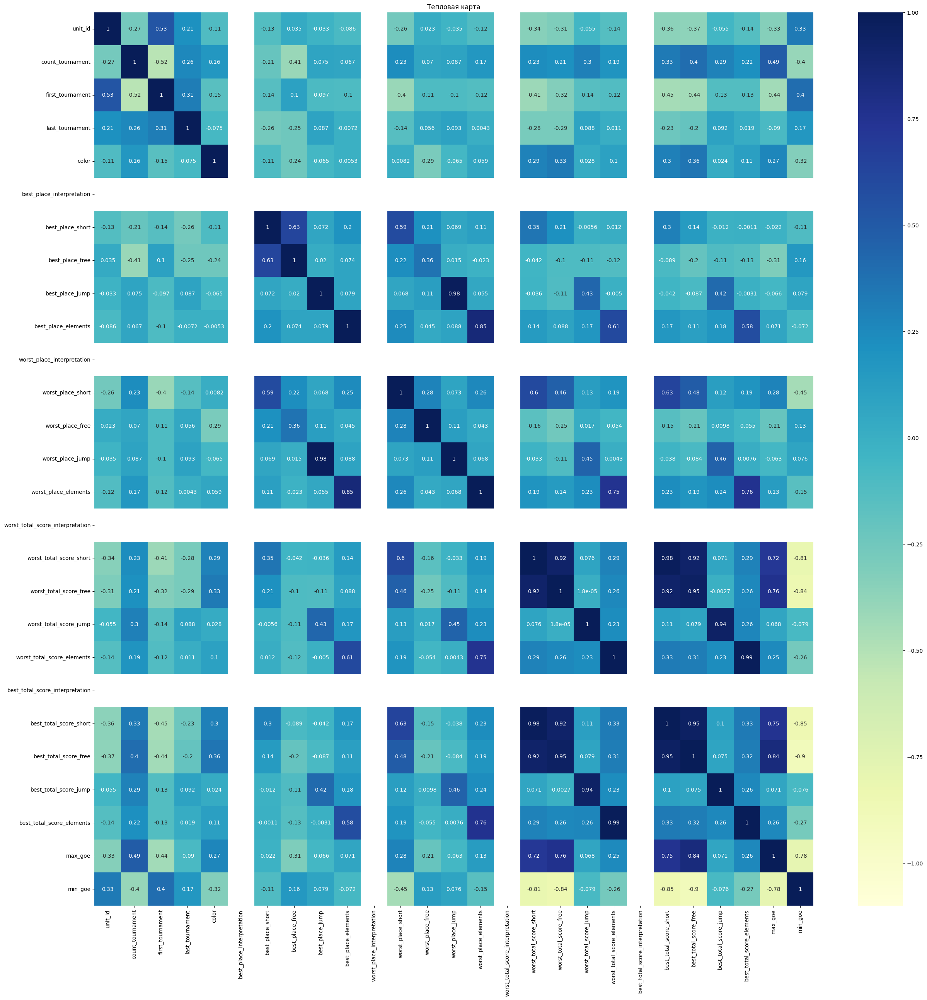

In [83]:
plt.figure(figsize=(30,30))
sns.heatmap(features.corr(), vmax=-1, vmin=1, annot=True, cmap='YlGnBu')
plt.title('Тепловая карта')
plt.show()

В датасете присутствуют коррелирующие между собой признаки - будем использовать регуляризацию.

In [84]:
target.describe()

,USp,LSp1,LSp2,LSp3,LSp4,CSp1,CSp2,CSp3,CSp4,SSp1,SSp2,SSp3,SSp4,FUSp,FLSp1,FCSp1,FCSp2,FCSp3,FCSp4,FSSp1,FSSp2,FSSp3,FSSp4,CUSp,CLSp,CCSp1,CCSp2,CCSp3,CCSp4,CSSp1,CSSp2,CSSp3,CSSp4,CoSp1,CoSp2,CCoSp1,CCoSp2,CCoSp3,CCoSp4,StSq1,StSq2,StSq3,StSq4,ChSq,1T,2T,3T,4T,1S,2S,3S,4S,1Lo,2Lo,3Lo,4Lo,1F,2F,3F,4F,1Lz,2Lz,3Lz,4Lz,1A,2A,3A,4A,1Eu
count,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.00000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.00000,2291.0,2291.0,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.0,2291.0,2291.00000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.000000,2291.0,2291.000000
mean,0.000873,0.065474,0.115234,0.202532,0.193802,0.130074,0.00742,0.003055,0.001746,0.147970,0.040157,0.042776,0.00742,0.0,0.0,0.046704,0.103012,0.166303,0.161502,0.117852,0.203841,0.251855,0.181580,0.0,0.0,0.01615,0.018333,0.041467,0.040594,0.164557,0.086425,0.088608,0.073767,0.015277,0.000436,0.189437,0.215626,0.376255,0.312091,0.333915,0.307289,0.158446,0.024880,0.484941,0.040157,0.413357,0.239633,0.025753,0.039284,0.373636,0.296377,0.020515,0.235705,0.389786,0.246617,0.002182,0.124400,0.344391,0.210825,0.003055,0.236141,0.328677,0.216499,0.007857,0.402444,0.350938,0.042340,0.0,0.231340
std,0.029540,0.247414,0.319373,0.401974,0.395362,0.336458,0.08584,0.055204,0.041757,0.355148,0.196370,0.202396,0.08584,0.0,0.0,0.211051,0.304041,0.372434,0.368073,0.322504,0.402940,0.434173,0.385582,0.0,0.0,0.12608,0.134180,0.199410,0.197390,0.370861,0.281052,0.284239,0.261448,0.122680,0.020892,0.391941,0.411346,0.484551,0.463448,0.471713,0.461471,0.365238,0.155793,0.499882,0.196370,0.492543,0.426953,0.158432,0.194313,0.483874,0.456759,0.141785,0.424531,0.487808,0.431136,0.046676,0.330109,0.475273,0.407983,0.055204,0.424803,0.469835,0.411948,0.088309,0.490498,0.477368,0.201407,0.0,0.421781
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

In [85]:
target.sum()

USp          2
LSp1       150
LSp2       264
LSp3       464
LSp4       444
CSp1       298
CSp2        17
CSp3         7
CSp4         4
SSp1       339
SSp2        92
SSp3        98
SSp4        17
FUSp         0
FLSp1        0
FCSp1      107
FCSp2      236
FCSp3      381
FCSp4      370
FSSp1      270
FSSp2      467
FSSp3      577
FSSp4      416
CUSp         0
CLSp         0
CCSp1       37
CCSp2       42
CCSp3       95
CCSp4       93
CSSp1      377
CSSp2      198
CSSp3      203
CSSp4      169
CoSp1       35
CoSp2        1
CCoSp1     434
CCoSp2     494
CCoSp3     862
CCoSp4     715
StSq1      765
StSq2      704
StSq3      363
StSq4       57
ChSq      1111
1T          92
2T         947
3T         549
4T          59
1S          90
2S         856
3S         679
4S          47
1Lo        540
2Lo        893
3Lo        565
4Lo          5
1F         285
2F         789
3F         483
4F           7
1Lz        541
2Lz        753
3Lz        496
4Lz         18
1A         922
2A         804
3A        

Удалим из таргета элементы, которые ни разу не встречались: 4A, CLSp, CUSp, FLSp1, FUSp и 'USp', 'CSp4', '4Lo', '4F', 'CSp3', 'CoSp2', который встречался меньше 10 раз

In [86]:
target = target.drop(columns=[
                "FUSp", 'USp', 'CSp4', '4Lo', '4F', 'CSp3',
                "FLSp1",
                "CUSp", 
                "CLSp", "CoSp2",
                "4A"], axis = 1)

### Test/Train

In [87]:
# разделим на тестовую и тренировочную 
features_train, features_test, target_train, target_test = train_test_split(features, 
                                                                            target.values, test_size=0.25,
                                                                            random_state=123456)

## Модели

### DummyClassifier

Проверим данные на случайной модели

In [89]:
# Определение метрики для кросс-валидации (используем средний F1-score для каждой метки)
scorer = make_scorer(f1_score, average='micro')

In [90]:
# DummyRegressor

model_DR =  DummyClassifier(strategy= 'stratified')
clf = MultiOutputClassifier(model_DR, n_jobs=-1)
F1_DR = cross_val_score(clf, features_train, target_train, scoring =scorer, cv=5)

print(f'F1-score (micro average) на кросс-валидации: {F1_DR}')
print(f'Средний F1-score (micro average) на кросс-валидации: {F1_DR.mean()}')

F1-score (micro average) на кросс-валидации: [0.25180723 0.27111756 0.275      0.25703422 0.248     ]
Средний F1-score (micro average) на кросс-валидации: 0.2605918022263162


In [ ]:
# Создание модели CatBoostClassifier
model_CBC = CatBoostClassifier()

# Обертка модели для многовыходной классификации
clf = MultiOutputClassifier(model_CBC)

# Параметры для поиска
parameters = {
    'estimator__depth': [1, 10, 2],
    'estimator__learning_rate': [0.05, 0.1, 0.5],
    'estimator__iterations': [100, 200, 350, 500],
    'estimator__l2_leaf_reg': [1, 3, 5],
    'estimator__random_strength': [1, 2, 3, 4, 5]
}

# Настройка RandomizedSearchCV
model_Grid = RandomizedSearchCV(
    clf,
    parameters,
    scoring='f1_micro', 
    cv=5,
    n_jobs=-1,
    random_state=12345,
    verbose=10
)

# Обучение модели
model_Grid.fit(features_train, target_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 3/5; 2/10] START estimator__depth=1, estimator__iterations=500, estimator__l2_leaf_reg=3, estimator__learning_rate=0.05, estimator__random_strength=5
0:	learn: 0.6346521	total: 58.2ms	remaining: 29s
1:	learn: 0.5808243	total: 59.2ms	remaining: 14.7s
2:	learn: 0.5371802	total: 60.2ms	remaining: 9.97s
3:	learn: 0.4895286	total: 61.3ms	remaining: 7.6s
4:	learn: 0.4574393	total: 62.3ms	remaining: 6.17s
5:	learn: 0.4182092	total: 63.3ms	remaining: 5.21s
6:	learn: 0.3948949	total: 64.4ms	remaining: 4.54s
7:	learn: 0.3743302	total: 65.4ms	remaining: 4.02s
8:	learn: 0.3562947	total: 66.3ms	remaining: 3.62s
9:	learn: 0.3391989	total: 67.3ms	remaining: 3.3s
10:	learn: 0.3202789	total: 68.3ms	remaining: 3.03s
11:	learn: 0.3088854	total: 69.2ms	remaining: 2.81s
12:	learn: 0.2988857	total: 70.2ms	remaining: 2.63s
13:	learn: 0.2848203	total: 71.2ms	remaining: 2.47s
14:	learn: 0.2774581	total: 72.2ms	remaining: 2.33s
15:	learn: 0.270240

203:	learn: 0.1813930	total: 372ms	remaining: 540ms
204:	learn: 0.1813614	total: 373ms	remaining: 537ms
205:	learn: 0.1811712	total: 374ms	remaining: 534ms
206:	learn: 0.1809698	total: 375ms	remaining: 531ms
207:	learn: 0.1807889	total: 376ms	remaining: 528ms
208:	learn: 0.1805948	total: 377ms	remaining: 525ms
209:	learn: 0.1805636	total: 378ms	remaining: 522ms
210:	learn: 0.1805405	total: 379ms	remaining: 519ms
211:	learn: 0.1805121	total: 380ms	remaining: 516ms
212:	learn: 0.1804855	total: 383ms	remaining: 516ms
213:	learn: 0.1804601	total: 384ms	remaining: 513ms
214:	learn: 0.1803132	total: 385ms	remaining: 510ms
215:	learn: 0.1801469	total: 386ms	remaining: 507ms
216:	learn: 0.1800674	total: 387ms	remaining: 505ms
217:	learn: 0.1799122	total: 388ms	remaining: 502ms
218:	learn: 0.1798466	total: 389ms	remaining: 499ms
219:	learn: 0.1797384	total: 390ms	remaining: 496ms
220:	learn: 0.1797149	total: 391ms	remaining: 494ms
221:	learn: 0.1796927	total: 395ms	remaining: 495ms
222:	learn: 

382:	learn: 0.1590491	total: 672ms	remaining: 205ms
383:	learn: 0.1590161	total: 673ms	remaining: 203ms
384:	learn: 0.1589920	total: 674ms	remaining: 201ms
385:	learn: 0.1589548	total: 675ms	remaining: 199ms
386:	learn: 0.1589309	total: 676ms	remaining: 197ms
387:	learn: 0.1588496	total: 677ms	remaining: 195ms
388:	learn: 0.1588412	total: 678ms	remaining: 193ms
389:	learn: 0.1588248	total: 679ms	remaining: 192ms
390:	learn: 0.1587389	total: 691ms	remaining: 192ms
391:	learn: 0.1586821	total: 692ms	remaining: 191ms
392:	learn: 0.1586736	total: 693ms	remaining: 189ms
393:	learn: 0.1586110	total: 694ms	remaining: 187ms
394:	learn: 0.1585766	total: 695ms	remaining: 185ms
395:	learn: 0.1585104	total: 696ms	remaining: 183ms
396:	learn: 0.1584781	total: 701ms	remaining: 182ms
397:	learn: 0.1583475	total: 702ms	remaining: 180ms
398:	learn: 0.1583169	total: 703ms	remaining: 178ms
399:	learn: 0.1582380	total: 704ms	remaining: 176ms
400:	learn: 0.1582296	total: 705ms	remaining: 174ms
401:	learn: 

128:	learn: 0.2755613	total: 209ms	remaining: 602ms
129:	learn: 0.2748400	total: 210ms	remaining: 599ms
130:	learn: 0.2747921	total: 212ms	remaining: 596ms
131:	learn: 0.2747546	total: 221ms	remaining: 616ms
132:	learn: 0.2747268	total: 222ms	remaining: 612ms
133:	learn: 0.2746766	total: 223ms	remaining: 609ms
134:	learn: 0.2744617	total: 224ms	remaining: 606ms
135:	learn: 0.2744603	total: 225ms	remaining: 602ms
136:	learn: 0.2743985	total: 226ms	remaining: 599ms
137:	learn: 0.2741913	total: 227ms	remaining: 595ms
138:	learn: 0.2741902	total: 228ms	remaining: 591ms
139:	learn: 0.2741891	total: 229ms	remaining: 588ms
140:	learn: 0.2727457	total: 233ms	remaining: 593ms
141:	learn: 0.2724445	total: 234ms	remaining: 589ms
142:	learn: 0.2723900	total: 235ms	remaining: 586ms
143:	learn: 0.2723547	total: 236ms	remaining: 582ms
144:	learn: 0.2721661	total: 237ms	remaining: 579ms
145:	learn: 0.2721142	total: 238ms	remaining: 576ms
146:	learn: 0.2720574	total: 239ms	remaining: 573ms
147:	learn: 

365:	learn: 0.2528796	total: 691ms	remaining: 253ms
366:	learn: 0.2528098	total: 692ms	remaining: 251ms
367:	learn: 0.2527670	total: 693ms	remaining: 248ms
368:	learn: 0.2526851	total: 694ms	remaining: 246ms
369:	learn: 0.2526212	total: 706ms	remaining: 248ms
370:	learn: 0.2525754	total: 707ms	remaining: 246ms
371:	learn: 0.2525309	total: 708ms	remaining: 244ms
372:	learn: 0.2524804	total: 709ms	remaining: 241ms
373:	learn: 0.2524196	total: 710ms	remaining: 239ms
374:	learn: 0.2524041	total: 712ms	remaining: 237ms
375:	learn: 0.2523205	total: 713ms	remaining: 235ms
376:	learn: 0.2522786	total: 714ms	remaining: 233ms
377:	learn: 0.2521702	total: 715ms	remaining: 231ms
378:	learn: 0.2521192	total: 716ms	remaining: 228ms
379:	learn: 0.2520779	total: 717ms	remaining: 226ms
380:	learn: 0.2520379	total: 718ms	remaining: 224ms
381:	learn: 0.2520225	total: 719ms	remaining: 222ms
382:	learn: 0.2519632	total: 720ms	remaining: 220ms
383:	learn: 0.2518953	total: 725ms	remaining: 219ms
384:	learn: 

255:	learn: 0.3112415	total: 491ms	remaining: 468ms
257:	learn: 0.3018070	total: 479ms	remaining: 450ms
258:	learn: 0.3017076	total: 481ms	remaining: 447ms
259:	learn: 0.3016497	total: 490ms	remaining: 452ms
260:	learn: 0.3015753	total: 491ms	remaining: 450ms
261:	learn: 0.3014992	total: 492ms	remaining: 447ms
262:	learn: 0.3014421	total: 493ms	remaining: 445ms
263:	learn: 0.3013906	total: 495ms	remaining: 442ms
264:	learn: 0.3013688	total: 496ms	remaining: 440ms
265:	learn: 0.3013024	total: 497ms	remaining: 437ms
266:	learn: 0.3012265	total: 501ms	remaining: 437ms
267:	learn: 0.3011685	total: 509ms	remaining: 441ms
268:	learn: 0.3011166	total: 510ms	remaining: 438ms
269:	learn: 0.3010941	total: 511ms	remaining: 436ms
270:	learn: 0.3010272	total: 512ms	remaining: 433ms
271:	learn: 0.3010054	total: 513ms	remaining: 430ms
272:	learn: 0.3009436	total: 514ms	remaining: 428ms
273:	learn: 0.3008922	total: 516ms	remaining: 425ms
274:	learn: 0.3008241	total: 517ms	remaining: 423ms
275:	learn: 

71:	learn: 0.2795412	total: 162ms	remaining: 964ms
72:	learn: 0.2791921	total: 164ms	remaining: 958ms
73:	learn: 0.2789574	total: 165ms	remaining: 949ms
74:	learn: 0.2788639	total: 166ms	remaining: 940ms
75:	learn: 0.2787355	total: 167ms	remaining: 932ms
76:	learn: 0.2785191	total: 168ms	remaining: 924ms
77:	learn: 0.2777249	total: 170ms	remaining: 918ms
78:	learn: 0.2770578	total: 171ms	remaining: 910ms
79:	learn: 0.2765975	total: 181ms	remaining: 949ms
80:	learn: 0.2765181	total: 182ms	remaining: 941ms
81:	learn: 0.2736706	total: 183ms	remaining: 934ms
82:	learn: 0.2732610	total: 184ms	remaining: 927ms
83:	learn: 0.2728841	total: 186ms	remaining: 919ms
84:	learn: 0.2725209	total: 187ms	remaining: 912ms
85:	learn: 0.2724821	total: 188ms	remaining: 905ms
86:	learn: 0.2722709	total: 189ms	remaining: 897ms
87:	learn: 0.2720556	total: 197ms	remaining: 924ms
88:	learn: 0.2719653	total: 199ms	remaining: 917ms
89:	learn: 0.2712788	total: 200ms	remaining: 910ms
90:	learn: 0.2712357	total: 201

386:	learn: 0.2266452	total: 795ms	remaining: 232ms
387:	learn: 0.2266257	total: 796ms	remaining: 230ms
388:	learn: 0.2265906	total: 797ms	remaining: 228ms
389:	learn: 0.2265476	total: 799ms	remaining: 225ms
390:	learn: 0.2265101	total: 800ms	remaining: 223ms
391:	learn: 0.2264552	total: 807ms	remaining: 222ms
392:	learn: 0.2263894	total: 808ms	remaining: 220ms
393:	learn: 0.2263436	total: 810ms	remaining: 218ms
394:	learn: 0.2263022	total: 811ms	remaining: 216ms
395:	learn: 0.2262603	total: 812ms	remaining: 213ms
396:	learn: 0.2262224	total: 813ms	remaining: 211ms
397:	learn: 0.2261814	total: 814ms	remaining: 209ms
398:	learn: 0.2261401	total: 816ms	remaining: 206ms
399:	learn: 0.2261293	total: 822ms	remaining: 205ms
400:	learn: 0.2261049	total: 823ms	remaining: 203ms
401:	learn: 0.2260703	total: 825ms	remaining: 201ms
402:	learn: 0.2260514	total: 826ms	remaining: 199ms
403:	learn: 0.2260106	total: 827ms	remaining: 197ms
404:	learn: 0.2259918	total: 829ms	remaining: 194ms
405:	learn: 

424:	learn: 0.2172748	total: 844ms	remaining: 149ms
425:	learn: 0.2172409	total: 845ms	remaining: 147ms
426:	learn: 0.2172163	total: 846ms	remaining: 145ms
427:	learn: 0.2171749	total: 848ms	remaining: 143ms
428:	learn: 0.2171451	total: 860ms	remaining: 142ms
429:	learn: 0.2171028	total: 861ms	remaining: 140ms
430:	learn: 0.2170615	total: 863ms	remaining: 138ms
431:	learn: 0.2170367	total: 864ms	remaining: 136ms
432:	learn: 0.2170056	total: 865ms	remaining: 134ms
433:	learn: 0.2169782	total: 867ms	remaining: 132ms
434:	learn: 0.2169497	total: 868ms	remaining: 130ms
435:	learn: 0.2169210	total: 878ms	remaining: 129ms
436:	learn: 0.2168806	total: 880ms	remaining: 127ms
437:	learn: 0.2168701	total: 881ms	remaining: 125ms
438:	learn: 0.2168522	total: 882ms	remaining: 123ms
439:	learn: 0.2168241	total: 884ms	remaining: 121ms
440:	learn: 0.2168090	total: 885ms	remaining: 118ms
441:	learn: 0.2163272	total: 887ms	remaining: 116ms
442:	learn: 0.2162967	total: 894ms	remaining: 115ms
443:	learn: 

201:	learn: 0.1416981	total: 555ms	remaining: 819ms
202:	learn: 0.1415389	total: 556ms	remaining: 814ms
203:	learn: 0.1413959	total: 558ms	remaining: 809ms
204:	learn: 0.1412834	total: 559ms	remaining: 804ms
205:	learn: 0.1411065	total: 564ms	remaining: 805ms
206:	learn: 0.1409387	total: 565ms	remaining: 800ms
207:	learn: 0.1408321	total: 567ms	remaining: 796ms
208:	learn: 0.1406886	total: 568ms	remaining: 791ms
209:	learn: 0.1406632	total: 569ms	remaining: 786ms
210:	learn: 0.1405674	total: 571ms	remaining: 782ms
211:	learn: 0.1404360	total: 572ms	remaining: 777ms
212:	learn: 0.1403471	total: 576ms	remaining: 776ms
213:	learn: 0.1401780	total: 577ms	remaining: 771ms
214:	learn: 0.1401176	total: 578ms	remaining: 767ms
215:	learn: 0.1399974	total: 580ms	remaining: 762ms
216:	learn: 0.1398879	total: 584ms	remaining: 762ms
217:	learn: 0.1397372	total: 586ms	remaining: 758ms
218:	learn: 0.1396150	total: 587ms	remaining: 753ms
219:	learn: 0.1395912	total: 589ms	remaining: 749ms
220:	learn: 

15:	learn: 0.0705958	total: 43.2ms	remaining: 1.31s
16:	learn: 0.0656477	total: 44.7ms	remaining: 1.27s
17:	learn: 0.0614257	total: 46.2ms	remaining: 1.24s
18:	learn: 0.0578866	total: 54.8ms	remaining: 1.39s
19:	learn: 0.0547841	total: 56.2ms	remaining: 1.35s
20:	learn: 0.0522359	total: 57.7ms	remaining: 1.32s
21:	learn: 0.0500511	total: 59.4ms	remaining: 1.29s
22:	learn: 0.0481184	total: 61ms	remaining: 1.26s
23:	learn: 0.0464823	total: 62.5ms	remaining: 1.24s
24:	learn: 0.0450801	total: 68.9ms	remaining: 1.31s
25:	learn: 0.0437566	total: 70.7ms	remaining: 1.29s
26:	learn: 0.0427003	total: 72.2ms	remaining: 1.26s
27:	learn: 0.0417947	total: 73.8ms	remaining: 1.24s
28:	learn: 0.0405859	total: 75.3ms	remaining: 1.22s
29:	learn: 0.0399221	total: 76.9ms	remaining: 1.21s
30:	learn: 0.0393263	total: 88ms	remaining: 1.33s
31:	learn: 0.0388074	total: 91.1ms	remaining: 1.33s
32:	learn: 0.0383259	total: 92.5ms	remaining: 1.31s
33:	learn: 0.0379283	total: 94ms	remaining: 1.29s
34:	learn: 0.03751

331:	learn: 0.0240486	total: 876ms	remaining: 443ms
332:	learn: 0.0240196	total: 879ms	remaining: 441ms
333:	learn: 0.0239907	total: 891ms	remaining: 443ms
334:	learn: 0.0239099	total: 892ms	remaining: 440ms
335:	learn: 0.0238791	total: 895ms	remaining: 437ms
336:	learn: 0.0238220	total: 896ms	remaining: 433ms
337:	learn: 0.0237952	total: 898ms	remaining: 430ms
338:	learn: 0.0237874	total: 899ms	remaining: 427ms
339:	learn: 0.0237629	total: 909ms	remaining: 428ms
340:	learn: 0.0236184	total: 910ms	remaining: 424ms
341:	learn: 0.0235878	total: 912ms	remaining: 421ms
342:	learn: 0.0235598	total: 914ms	remaining: 418ms
343:	learn: 0.0235344	total: 915ms	remaining: 415ms
344:	learn: 0.0234984	total: 917ms	remaining: 412ms
345:	learn: 0.0234206	total: 928ms	remaining: 413ms
346:	learn: 0.0233701	total: 930ms	remaining: 410ms
347:	learn: 0.0233649	total: 932ms	remaining: 407ms
348:	learn: 0.0232883	total: 934ms	remaining: 404ms
349:	learn: 0.0232408	total: 935ms	remaining: 401ms
350:	learn: 

147:	learn: 0.2198292	total: 449ms	remaining: 1.07s
148:	learn: 0.2198260	total: 451ms	remaining: 1.06s
149:	learn: 0.2196362	total: 452ms	remaining: 1.05s
150:	learn: 0.2195359	total: 454ms	remaining: 1.05s
151:	learn: 0.2193689	total: 456ms	remaining: 1.04s
152:	learn: 0.2192786	total: 458ms	remaining: 1.04s
153:	learn: 0.2191914	total: 459ms	remaining: 1.03s
154:	learn: 0.2191128	total: 467ms	remaining: 1.04s
155:	learn: 0.2189057	total: 469ms	remaining: 1.03s
156:	learn: 0.2188072	total: 471ms	remaining: 1.03s
157:	learn: 0.2188024	total: 472ms	remaining: 1.02s
158:	learn: 0.2185150	total: 474ms	remaining: 1.02s
159:	learn: 0.2184504	total: 476ms	remaining: 1.01s
160:	learn: 0.2182025	total: 485ms	remaining: 1.02s
161:	learn: 0.2181909	total: 486ms	remaining: 1.01s
162:	learn: 0.2181045	total: 488ms	remaining: 1.01s
163:	learn: 0.2178466	total: 490ms	remaining: 1s
164:	learn: 0.2176822	total: 491ms	remaining: 998ms
165:	learn: 0.2176240	total: 498ms	remaining: 1s
166:	learn: 0.2175

461:	learn: 0.1956226	total: 1.42s	remaining: 117ms
462:	learn: 0.1955952	total: 1.43s	remaining: 114ms
463:	learn: 0.1955804	total: 1.44s	remaining: 111ms
464:	learn: 0.1955706	total: 1.44s	remaining: 108ms
465:	learn: 0.1955226	total: 1.44s	remaining: 105ms
466:	learn: 0.1954776	total: 1.44s	remaining: 102ms
467:	learn: 0.1954569	total: 1.44s	remaining: 98.8ms
468:	learn: 0.1954035	total: 1.46s	remaining: 96.3ms
469:	learn: 0.1953939	total: 1.47s	remaining: 94ms
470:	learn: 0.1953799	total: 1.48s	remaining: 90.8ms
471:	learn: 0.1953495	total: 1.48s	remaining: 87.6ms
472:	learn: 0.1952945	total: 1.48s	remaining: 84.4ms
473:	learn: 0.1952521	total: 1.49s	remaining: 81.8ms
474:	learn: 0.1951005	total: 1.49s	remaining: 78.6ms
475:	learn: 0.1950772	total: 1.5s	remaining: 75.4ms
476:	learn: 0.1950258	total: 1.5s	remaining: 72.2ms
477:	learn: 0.1949950	total: 1.5s	remaining: 69ms
478:	learn: 0.1949785	total: 1.51s	remaining: 66.1ms
479:	learn: 0.1949373	total: 1.51s	remaining: 62.9ms
480:	l

276:	learn: 0.1318251	total: 895ms	remaining: 721ms
277:	learn: 0.1317509	total: 897ms	remaining: 717ms
278:	learn: 0.1317158	total: 899ms	remaining: 712ms
279:	learn: 0.1316783	total: 901ms	remaining: 708ms
280:	learn: 0.1315443	total: 903ms	remaining: 704ms
281:	learn: 0.1314403	total: 922ms	remaining: 713ms
282:	learn: 0.1313389	total: 924ms	remaining: 708ms
283:	learn: 0.1312684	total: 926ms	remaining: 704ms
284:	learn: 0.1311627	total: 927ms	remaining: 700ms
285:	learn: 0.1311250	total: 929ms	remaining: 695ms
286:	learn: 0.1310870	total: 933ms	remaining: 693ms
287:	learn: 0.1309909	total: 935ms	remaining: 688ms
288:	learn: 0.1309272	total: 937ms	remaining: 684ms
289:	learn: 0.1308604	total: 939ms	remaining: 680ms
290:	learn: 0.1308229	total: 940ms	remaining: 675ms
291:	learn: 0.1306401	total: 945ms	remaining: 673ms
292:	learn: 0.1305496	total: 946ms	remaining: 669ms
293:	learn: 0.1304915	total: 948ms	remaining: 664ms
294:	learn: 0.1304008	total: 950ms	remaining: 660ms
295:	learn: 

92:	learn: 0.1563231	total: 300ms	remaining: 1.31s
93:	learn: 0.1562811	total: 311ms	remaining: 1.34s
94:	learn: 0.1556418	total: 313ms	remaining: 1.33s
95:	learn: 0.1555293	total: 315ms	remaining: 1.32s
96:	learn: 0.1555104	total: 317ms	remaining: 1.31s
97:	learn: 0.1551857	total: 319ms	remaining: 1.31s
98:	learn: 0.1549947	total: 323ms	remaining: 1.31s
99:	learn: 0.1538179	total: 325ms	remaining: 1.3s
100:	learn: 0.1531841	total: 327ms	remaining: 1.29s
101:	learn: 0.1528189	total: 329ms	remaining: 1.28s
102:	learn: 0.1525211	total: 330ms	remaining: 1.27s
103:	learn: 0.1522592	total: 337ms	remaining: 1.28s
104:	learn: 0.1511702	total: 339ms	remaining: 1.28s
105:	learn: 0.1509790	total: 341ms	remaining: 1.27s
106:	learn: 0.1507713	total: 344ms	remaining: 1.26s
107:	learn: 0.1507357	total: 357ms	remaining: 1.29s
108:	learn: 0.1505624	total: 359ms	remaining: 1.29s
109:	learn: 0.1504935	total: 360ms	remaining: 1.28s
110:	learn: 0.1499169	total: 362ms	remaining: 1.27s
111:	learn: 0.1497261

406:	learn: 0.1081880	total: 1.49s	remaining: 341ms
407:	learn: 0.1081621	total: 1.5s	remaining: 338ms
408:	learn: 0.1079850	total: 1.5s	remaining: 334ms
409:	learn: 0.1079137	total: 1.5s	remaining: 330ms
410:	learn: 0.1079045	total: 1.5s	remaining: 326ms
411:	learn: 0.1078502	total: 1.5s	remaining: 322ms
412:	learn: 0.1077824	total: 1.51s	remaining: 318ms
413:	learn: 0.1076986	total: 1.51s	remaining: 314ms
414:	learn: 0.1076396	total: 1.51s	remaining: 310ms
415:	learn: 0.1075627	total: 1.51s	remaining: 306ms
416:	learn: 0.1075411	total: 1.51s	remaining: 302ms
417:	learn: 0.1074767	total: 1.52s	remaining: 298ms
418:	learn: 0.1074221	total: 1.52s	remaining: 294ms
419:	learn: 0.1073957	total: 1.52s	remaining: 290ms
420:	learn: 0.1073512	total: 1.53s	remaining: 286ms
421:	learn: 0.1073254	total: 1.53s	remaining: 282ms
422:	learn: 0.1072449	total: 1.53s	remaining: 279ms
423:	learn: 0.1072284	total: 1.53s	remaining: 275ms
424:	learn: 0.1072122	total: 1.53s	remaining: 271ms
425:	learn: 0.107

221:	learn: 0.0286036	total: 1.01s	remaining: 1.27s
222:	learn: 0.0285915	total: 1.02s	remaining: 1.26s
223:	learn: 0.0285804	total: 1.02s	remaining: 1.26s
224:	learn: 0.0284973	total: 1.02s	remaining: 1.25s
225:	learn: 0.0284179	total: 1.04s	remaining: 1.26s
226:	learn: 0.0284084	total: 1.04s	remaining: 1.25s
227:	learn: 0.0283309	total: 1.04s	remaining: 1.25s
228:	learn: 0.0282036	total: 1.05s	remaining: 1.24s
229:	learn: 0.0281109	total: 1.05s	remaining: 1.23s
230:	learn: 0.0280346	total: 1.07s	remaining: 1.24s
231:	learn: 0.0279639	total: 1.07s	remaining: 1.23s
232:	learn: 0.0278520	total: 1.07s	remaining: 1.23s
233:	learn: 0.0277842	total: 1.07s	remaining: 1.22s
234:	learn: 0.0277101	total: 1.07s	remaining: 1.21s
235:	learn: 0.0276427	total: 1.08s	remaining: 1.21s
236:	learn: 0.0275977	total: 1.08s	remaining: 1.2s
237:	learn: 0.0275333	total: 1.08s	remaining: 1.19s
238:	learn: 0.0273948	total: 1.08s	remaining: 1.18s
239:	learn: 0.0273316	total: 1.1s	remaining: 1.19s
240:	learn: 0.

38:	learn: 0.1762408	total: 208ms	remaining: 2.46s
39:	learn: 0.1758693	total: 210ms	remaining: 2.41s
40:	learn: 0.1755523	total: 212ms	remaining: 2.37s
41:	learn: 0.1753302	total: 220ms	remaining: 2.4s
42:	learn: 0.1751406	total: 222ms	remaining: 2.36s
43:	learn: 0.1747500	total: 225ms	remaining: 2.33s
44:	learn: 0.1745662	total: 227ms	remaining: 2.29s
45:	learn: 0.1734145	total: 238ms	remaining: 2.35s
46:	learn: 0.1725058	total: 241ms	remaining: 2.32s
47:	learn: 0.1723589	total: 243ms	remaining: 2.29s
48:	learn: 0.1721898	total: 245ms	remaining: 2.25s
49:	learn: 0.1714410	total: 254ms	remaining: 2.28s
50:	learn: 0.1711679	total: 256ms	remaining: 2.25s
51:	learn: 0.1711035	total: 258ms	remaining: 2.22s
52:	learn: 0.1710589	total: 260ms	remaining: 2.19s
53:	learn: 0.1699554	total: 262ms	remaining: 2.16s
54:	learn: 0.1699096	total: 269ms	remaining: 2.18s
55:	learn: 0.1692865	total: 272ms	remaining: 2.15s
56:	learn: 0.1683871	total: 274ms	remaining: 2.13s
57:	learn: 0.1678905	total: 293m

355:	learn: 0.1491015	total: 1.6s	remaining: 647ms
356:	learn: 0.1490577	total: 1.6s	remaining: 641ms
357:	learn: 0.1490097	total: 1.6s	remaining: 636ms
358:	learn: 0.1489923	total: 1.6s	remaining: 630ms
359:	learn: 0.1489562	total: 1.61s	remaining: 625ms
360:	learn: 0.1489075	total: 1.61s	remaining: 621ms
361:	learn: 0.1488717	total: 1.61s	remaining: 616ms
362:	learn: 0.1488549	total: 1.62s	remaining: 611ms
363:	learn: 0.1488235	total: 1.62s	remaining: 605ms
364:	learn: 0.1486681	total: 1.62s	remaining: 600ms
365:	learn: 0.1486272	total: 1.63s	remaining: 597ms
366:	learn: 0.1485438	total: 1.63s	remaining: 591ms
367:	learn: 0.1485098	total: 1.63s	remaining: 586ms
368:	learn: 0.1484832	total: 1.64s	remaining: 581ms
369:	learn: 0.1484707	total: 1.65s	remaining: 581ms
370:	learn: 0.1484366	total: 1.66s	remaining: 576ms
371:	learn: 0.1483757	total: 1.66s	remaining: 570ms
372:	learn: 0.1483590	total: 1.66s	remaining: 565ms
373:	learn: 0.1483346	total: 1.66s	remaining: 560ms
374:	learn: 0.14

172:	learn: 0.2463586	total: 724ms	remaining: 1.37s
173:	learn: 0.2462766	total: 726ms	remaining: 1.36s
174:	learn: 0.2460657	total: 728ms	remaining: 1.35s
175:	learn: 0.2459735	total: 730ms	remaining: 1.34s
176:	learn: 0.2458837	total: 742ms	remaining: 1.35s
177:	learn: 0.2457761	total: 750ms	remaining: 1.36s
178:	learn: 0.2455803	total: 752ms	remaining: 1.35s
179:	learn: 0.2454049	total: 754ms	remaining: 1.34s
180:	learn: 0.2453077	total: 756ms	remaining: 1.33s
181:	learn: 0.2451163	total: 765ms	remaining: 1.34s
182:	learn: 0.2450275	total: 768ms	remaining: 1.33s
183:	learn: 0.2448527	total: 770ms	remaining: 1.32s
184:	learn: 0.2447349	total: 772ms	remaining: 1.31s
185:	learn: 0.2446985	total: 784ms	remaining: 1.32s
186:	learn: 0.2444980	total: 786ms	remaining: 1.31s
187:	learn: 0.2444172	total: 787ms	remaining: 1.31s
188:	learn: 0.2443343	total: 790ms	remaining: 1.3s
189:	learn: 0.2441861	total: 792ms	remaining: 1.29s
190:	learn: 0.2440819	total: 803ms	remaining: 1.3s
191:	learn: 0.

486:	learn: 0.2263239	total: 1.99s	remaining: 53.1ms
487:	learn: 0.2262817	total: 1.99s	remaining: 48.9ms
488:	learn: 0.2262473	total: 1.99s	remaining: 44.8ms
489:	learn: 0.2261841	total: 1.99s	remaining: 40.7ms
490:	learn: 0.2261677	total: 1.99s	remaining: 36.6ms
491:	learn: 0.2261338	total: 2s	remaining: 32.5ms
492:	learn: 0.2260933	total: 2s	remaining: 28.4ms
493:	learn: 0.2260672	total: 2s	remaining: 24.3ms
494:	learn: 0.2260159	total: 2s	remaining: 20.2ms
495:	learn: 0.2259769	total: 2s	remaining: 16.2ms
496:	learn: 0.2259583	total: 2s	remaining: 12.1ms
497:	learn: 0.2259365	total: 2.01s	remaining: 8.07ms
498:	learn: 0.2258841	total: 2.01s	remaining: 4.03ms
499:	learn: 0.2258501	total: 2.01s	remaining: 0us
0:	learn: 0.6663003	total: 2.27ms	remaining: 1.13s
1:	learn: 0.6412964	total: 4.01ms	remaining: 999ms
2:	learn: 0.6201191	total: 5.98ms	remaining: 991ms
3:	learn: 0.5797125	total: 7.82ms	remaining: 970ms
4:	learn: 0.5641032	total: 9.49ms	remaining: 940ms
5:	learn: 0.5502427	tota

303:	learn: 0.2770760	total: 1.14s	remaining: 733ms
304:	learn: 0.2769893	total: 1.14s	remaining: 728ms
305:	learn: 0.2769508	total: 1.14s	remaining: 723ms
306:	learn: 0.2769163	total: 1.15s	remaining: 726ms
307:	learn: 0.2768776	total: 1.16s	remaining: 721ms
308:	learn: 0.2767872	total: 1.16s	remaining: 716ms
309:	learn: 0.2767322	total: 1.16s	remaining: 711ms
310:	learn: 0.2766810	total: 1.16s	remaining: 706ms
311:	learn: 0.2766365	total: 1.18s	remaining: 711ms
312:	learn: 0.2763096	total: 1.18s	remaining: 706ms
313:	learn: 0.2762403	total: 1.18s	remaining: 702ms
314:	learn: 0.2761709	total: 1.19s	remaining: 697ms
315:	learn: 0.2761216	total: 1.19s	remaining: 692ms
316:	learn: 0.2760824	total: 1.19s	remaining: 687ms
317:	learn: 0.2760456	total: 1.19s	remaining: 682ms
318:	learn: 0.2760129	total: 1.19s	remaining: 677ms
319:	learn: 0.2759466	total: 1.2s	remaining: 672ms
320:	learn: 0.2758792	total: 1.2s	remaining: 667ms
321:	learn: 0.2758428	total: 1.2s	remaining: 664ms
322:	learn: 0.2

118:	learn: 0.2503608	total: 427ms	remaining: 1.37s
119:	learn: 0.2503436	total: 429ms	remaining: 1.36s
120:	learn: 0.2499628	total: 443ms	remaining: 1.39s
121:	learn: 0.2497177	total: 445ms	remaining: 1.38s
122:	learn: 0.2496830	total: 447ms	remaining: 1.37s
123:	learn: 0.2496815	total: 448ms	remaining: 1.36s
124:	learn: 0.2496808	total: 450ms	remaining: 1.35s
125:	learn: 0.2496478	total: 457ms	remaining: 1.36s
126:	learn: 0.2495478	total: 459ms	remaining: 1.35s
127:	learn: 0.2494624	total: 461ms	remaining: 1.34s
128:	learn: 0.2491338	total: 463ms	remaining: 1.33s
129:	learn: 0.2490548	total: 465ms	remaining: 1.32s
130:	learn: 0.2489066	total: 473ms	remaining: 1.33s
131:	learn: 0.2488971	total: 475ms	remaining: 1.32s
132:	learn: 0.2488819	total: 476ms	remaining: 1.31s
133:	learn: 0.2486693	total: 478ms	remaining: 1.3s
134:	learn: 0.2485909	total: 480ms	remaining: 1.3s
135:	learn: 0.2485422	total: 482ms	remaining: 1.29s
136:	learn: 0.2485375	total: 484ms	remaining: 1.28s
137:	learn: 0.

433:	learn: 0.2296307	total: 1.56s	remaining: 237ms
434:	learn: 0.2295761	total: 1.56s	remaining: 234ms
435:	learn: 0.2295255	total: 1.57s	remaining: 230ms
436:	learn: 0.2295112	total: 1.57s	remaining: 226ms
437:	learn: 0.2294784	total: 1.57s	remaining: 222ms
438:	learn: 0.2294433	total: 1.57s	remaining: 219ms
439:	learn: 0.2293310	total: 1.58s	remaining: 216ms
440:	learn: 0.2292974	total: 1.58s	remaining: 212ms
441:	learn: 0.2292746	total: 1.59s	remaining: 209ms
442:	learn: 0.2292488	total: 1.6s	remaining: 206ms
443:	learn: 0.2292170	total: 1.6s	remaining: 202ms
444:	learn: 0.2291870	total: 1.61s	remaining: 199ms
445:	learn: 0.2291553	total: 1.61s	remaining: 195ms
446:	learn: 0.2291023	total: 1.62s	remaining: 192ms
447:	learn: 0.2290918	total: 1.62s	remaining: 188ms
448:	learn: 0.2290628	total: 1.62s	remaining: 184ms
449:	learn: 0.2290359	total: 1.62s	remaining: 180ms
450:	learn: 0.2290045	total: 1.62s	remaining: 176ms
451:	learn: 0.2288944	total: 1.63s	remaining: 173ms
452:	learn: 0.

249:	learn: 0.3221754	total: 925ms	remaining: 925ms
250:	learn: 0.3220999	total: 935ms	remaining: 928ms
251:	learn: 0.3219923	total: 937ms	remaining: 922ms
252:	learn: 0.3218928	total: 939ms	remaining: 916ms
253:	learn: 0.3218028	total: 940ms	remaining: 911ms
254:	learn: 0.3217280	total: 942ms	remaining: 905ms
255:	learn: 0.3216204	total: 945ms	remaining: 901ms
256:	learn: 0.3215496	total: 947ms	remaining: 896ms
257:	learn: 0.3214853	total: 949ms	remaining: 891ms
258:	learn: 0.3213880	total: 951ms	remaining: 885ms
259:	learn: 0.3211677	total: 953ms	remaining: 880ms
260:	learn: 0.3210816	total: 961ms	remaining: 880ms
261:	learn: 0.3210352	total: 972ms	remaining: 883ms
262:	learn: 0.3209325	total: 973ms	remaining: 877ms
263:	learn: 0.3208186	total: 975ms	remaining: 872ms
264:	learn: 0.3207588	total: 977ms	remaining: 867ms
265:	learn: 0.3207093	total: 979ms	remaining: 862ms
266:	learn: 0.3205095	total: 991ms	remaining: 865ms
267:	learn: 0.3203834	total: 994ms	remaining: 860ms
268:	learn: 

63:	learn: 0.4534531	total: 201ms	remaining: 1.37s
64:	learn: 0.4532972	total: 209ms	remaining: 1.4s
65:	learn: 0.4523848	total: 211ms	remaining: 1.38s
66:	learn: 0.4520608	total: 212ms	remaining: 1.37s
67:	learn: 0.4494600	total: 215ms	remaining: 1.36s
68:	learn: 0.4492745	total: 217ms	remaining: 1.35s
69:	learn: 0.4487834	total: 224ms	remaining: 1.38s
70:	learn: 0.4485349	total: 226ms	remaining: 1.36s
71:	learn: 0.4479872	total: 228ms	remaining: 1.36s
72:	learn: 0.4478683	total: 231ms	remaining: 1.35s
73:	learn: 0.4478222	total: 232ms	remaining: 1.34s
74:	learn: 0.4477559	total: 240ms	remaining: 1.36s
75:	learn: 0.4474707	total: 242ms	remaining: 1.35s
76:	learn: 0.4473641	total: 244ms	remaining: 1.34s
77:	learn: 0.4472000	total: 246ms	remaining: 1.33s
78:	learn: 0.4469476	total: 248ms	remaining: 1.32s
79:	learn: 0.4466170	total: 255ms	remaining: 1.34s
80:	learn: 0.4465326	total: 256ms	remaining: 1.33s
81:	learn: 0.4459937	total: 258ms	remaining: 1.31s
82:	learn: 0.4458332	total: 260m

378:	learn: 0.3838377	total: 1.32s	remaining: 421ms
379:	learn: 0.3837606	total: 1.32s	remaining: 417ms
380:	learn: 0.3837062	total: 1.32s	remaining: 413ms
381:	learn: 0.3836662	total: 1.32s	remaining: 409ms
382:	learn: 0.3836233	total: 1.33s	remaining: 405ms
383:	learn: 0.3835254	total: 1.34s	remaining: 405ms
384:	learn: 0.3834651	total: 1.34s	remaining: 401ms
385:	learn: 0.3834135	total: 1.34s	remaining: 397ms
386:	learn: 0.3832815	total: 1.35s	remaining: 393ms
387:	learn: 0.3831787	total: 1.35s	remaining: 389ms
388:	learn: 0.3831301	total: 1.35s	remaining: 387ms
389:	learn: 0.3830561	total: 1.36s	remaining: 383ms
390:	learn: 0.3829892	total: 1.36s	remaining: 379ms
391:	learn: 0.3829343	total: 1.36s	remaining: 375ms
392:	learn: 0.3828833	total: 1.36s	remaining: 371ms
393:	learn: 0.3827859	total: 1.37s	remaining: 368ms
394:	learn: 0.3827385	total: 1.37s	remaining: 364ms
395:	learn: 0.3826552	total: 1.37s	remaining: 360ms
396:	learn: 0.3825787	total: 1.38s	remaining: 358ms
397:	learn: 

196:	learn: 0.4554759	total: 715ms	remaining: 1.1s
197:	learn: 0.4554121	total: 717ms	remaining: 1.09s
198:	learn: 0.4552068	total: 719ms	remaining: 1.09s
199:	learn: 0.4546550	total: 721ms	remaining: 1.08s
200:	learn: 0.4545928	total: 728ms	remaining: 1.08s
201:	learn: 0.4543692	total: 729ms	remaining: 1.08s
202:	learn: 0.4541916	total: 731ms	remaining: 1.07s
203:	learn: 0.4540763	total: 736ms	remaining: 1.07s
204:	learn: 0.4538658	total: 740ms	remaining: 1.06s
205:	learn: 0.4532821	total: 742ms	remaining: 1.06s
206:	learn: 0.4530781	total: 749ms	remaining: 1.06s
207:	learn: 0.4529518	total: 753ms	remaining: 1.06s
208:	learn: 0.4527858	total: 755ms	remaining: 1.05s
209:	learn: 0.4526494	total: 756ms	remaining: 1.04s
210:	learn: 0.4524465	total: 760ms	remaining: 1.04s
211:	learn: 0.4523877	total: 763ms	remaining: 1.04s
212:	learn: 0.4516706	total: 766ms	remaining: 1.03s
213:	learn: 0.4514687	total: 768ms	remaining: 1.02s
214:	learn: 0.4512860	total: 784ms	remaining: 1.04s
215:	learn: 0

9:	learn: 0.4802398	total: 25.2ms	remaining: 1.23s
10:	learn: 0.4700145	total: 27.3ms	remaining: 1.22s
11:	learn: 0.4570949	total: 31ms	remaining: 1.26s
12:	learn: 0.4517425	total: 41ms	remaining: 1.54s
13:	learn: 0.4437824	total: 42.8ms	remaining: 1.49s
14:	learn: 0.4390649	total: 44.8ms	remaining: 1.45s
15:	learn: 0.4343612	total: 46.7ms	remaining: 1.41s
16:	learn: 0.4295153	total: 50ms	remaining: 1.42s
17:	learn: 0.4271051	total: 61.7ms	remaining: 1.65s
18:	learn: 0.4226868	total: 63.3ms	remaining: 1.6s
19:	learn: 0.4199292	total: 64.6ms	remaining: 1.55s
20:	learn: 0.4159241	total: 66.3ms	remaining: 1.51s
21:	learn: 0.4135150	total: 67.9ms	remaining: 1.48s
22:	learn: 0.4059127	total: 69.6ms	remaining: 1.44s
23:	learn: 0.4014185	total: 79.9ms	remaining: 1.58s
24:	learn: 0.3975466	total: 81.9ms	remaining: 1.55s
25:	learn: 0.3960097	total: 83.9ms	remaining: 1.53s
26:	learn: 0.3945555	total: 85.8ms	remaining: 1.5s
27:	learn: 0.3881857	total: 88ms	remaining: 1.48s
28:	learn: 0.3876961	to

325:	learn: 0.3014575	total: 1.09s	remaining: 585ms
326:	learn: 0.3013440	total: 1.1s	remaining: 581ms
327:	learn: 0.3012825	total: 1.1s	remaining: 577ms
328:	learn: 0.3012280	total: 1.11s	remaining: 577ms
329:	learn: 0.3011685	total: 1.11s	remaining: 572ms
330:	learn: 0.3011162	total: 1.11s	remaining: 568ms
331:	learn: 0.3010913	total: 1.11s	remaining: 564ms
332:	learn: 0.3009960	total: 1.12s	remaining: 560ms
333:	learn: 0.3008521	total: 1.12s	remaining: 556ms
334:	learn: 0.3007945	total: 1.13s	remaining: 557ms
335:	learn: 0.3007351	total: 1.13s	remaining: 553ms
336:	learn: 0.3006653	total: 1.13s	remaining: 549ms
337:	learn: 0.3005909	total: 1.14s	remaining: 545ms
338:	learn: 0.3005418	total: 1.14s	remaining: 541ms
339:	learn: 0.3004357	total: 1.15s	remaining: 540ms
340:	learn: 0.3003093	total: 1.15s	remaining: 536ms
341:	learn: 0.2997611	total: 1.15s	remaining: 532ms
342:	learn: 0.2996990	total: 1.15s	remaining: 528ms
343:	learn: 0.2996747	total: 1.16s	remaining: 524ms
344:	learn: 0.

141:	learn: 0.0559505	total: 524ms	remaining: 1.32s
142:	learn: 0.0557445	total: 526ms	remaining: 1.31s
143:	learn: 0.0556774	total: 528ms	remaining: 1.3s
144:	learn: 0.0556563	total: 529ms	remaining: 1.3s
145:	learn: 0.0556029	total: 531ms	remaining: 1.29s
146:	learn: 0.0555803	total: 533ms	remaining: 1.28s
147:	learn: 0.0554577	total: 535ms	remaining: 1.27s
148:	learn: 0.0554562	total: 537ms	remaining: 1.26s
149:	learn: 0.0554476	total: 539ms	remaining: 1.26s
150:	learn: 0.0553508	total: 545ms	remaining: 1.26s
151:	learn: 0.0552873	total: 546ms	remaining: 1.25s
152:	learn: 0.0552437	total: 548ms	remaining: 1.24s
153:	learn: 0.0552175	total: 550ms	remaining: 1.24s
154:	learn: 0.0551706	total: 552ms	remaining: 1.23s
155:	learn: 0.0551026	total: 564ms	remaining: 1.24s
156:	learn: 0.0550632	total: 568ms	remaining: 1.24s
157:	learn: 0.0549106	total: 569ms	remaining: 1.23s
158:	learn: 0.0548024	total: 572ms	remaining: 1.23s
159:	learn: 0.0547981	total: 574ms	remaining: 1.22s
160:	learn: 0.

455:	learn: 0.0447746	total: 1.5s	remaining: 144ms
456:	learn: 0.0447710	total: 1.5s	remaining: 141ms
457:	learn: 0.0447665	total: 1.52s	remaining: 139ms
458:	learn: 0.0447398	total: 1.53s	remaining: 137ms
459:	learn: 0.0447068	total: 1.53s	remaining: 133ms
460:	learn: 0.0446679	total: 1.54s	remaining: 130ms
461:	learn: 0.0446537	total: 1.54s	remaining: 127ms
462:	learn: 0.0446502	total: 1.55s	remaining: 124ms
463:	learn: 0.0446394	total: 1.55s	remaining: 120ms
464:	learn: 0.0446362	total: 1.55s	remaining: 117ms
465:	learn: 0.0446232	total: 1.55s	remaining: 113ms
466:	learn: 0.0446201	total: 1.56s	remaining: 110ms
467:	learn: 0.0446064	total: 1.56s	remaining: 107ms
468:	learn: 0.0445933	total: 1.56s	remaining: 103ms
469:	learn: 0.0445805	total: 1.56s	remaining: 99.9ms
470:	learn: 0.0445710	total: 1.57s	remaining: 96.5ms
471:	learn: 0.0445606	total: 1.57s	remaining: 93.1ms
472:	learn: 0.0445575	total: 1.58s	remaining: 90.1ms
473:	learn: 0.0445299	total: 1.58s	remaining: 86.7ms
474:	lear

271:	learn: 0.0409484	total: 954ms	remaining: 800ms
272:	learn: 0.0409040	total: 956ms	remaining: 795ms
273:	learn: 0.0408622	total: 959ms	remaining: 791ms
274:	learn: 0.0407795	total: 963ms	remaining: 788ms
275:	learn: 0.0407521	total: 965ms	remaining: 783ms
276:	learn: 0.0407308	total: 967ms	remaining: 779ms
277:	learn: 0.0407111	total: 969ms	remaining: 774ms
278:	learn: 0.0406813	total: 972ms	remaining: 770ms
279:	learn: 0.0406635	total: 985ms	remaining: 774ms
280:	learn: 0.0406239	total: 986ms	remaining: 769ms
281:	learn: 0.0405986	total: 988ms	remaining: 764ms
282:	learn: 0.0405792	total: 991ms	remaining: 760ms
283:	learn: 0.0405420	total: 993ms	remaining: 755ms
284:	learn: 0.0405238	total: 1s	remaining: 756ms
285:	learn: 0.0405055	total: 1s	remaining: 752ms
286:	learn: 0.0404342	total: 1.01s	remaining: 748ms
287:	learn: 0.0404171	total: 1.01s	remaining: 743ms
288:	learn: 0.0401029	total: 1.01s	remaining: 740ms
289:	learn: 0.0400795	total: 1.01s	remaining: 735ms
290:	learn: 0.0400

89:	learn: 0.0830884	total: 279ms	remaining: 1.27s
90:	learn: 0.0828438	total: 281ms	remaining: 1.26s
91:	learn: 0.0825755	total: 283ms	remaining: 1.25s
92:	learn: 0.0825297	total: 285ms	remaining: 1.25s
93:	learn: 0.0819440	total: 287ms	remaining: 1.24s
94:	learn: 0.0819315	total: 289ms	remaining: 1.23s
95:	learn: 0.0812347	total: 300ms	remaining: 1.26s
96:	learn: 0.0810245	total: 301ms	remaining: 1.25s
97:	learn: 0.0810005	total: 303ms	remaining: 1.24s
98:	learn: 0.0804146	total: 305ms	remaining: 1.24s
99:	learn: 0.0803704	total: 307ms	remaining: 1.23s
100:	learn: 0.0798738	total: 318ms	remaining: 1.26s
101:	learn: 0.0798265	total: 323ms	remaining: 1.26s
102:	learn: 0.0798082	total: 325ms	remaining: 1.25s
103:	learn: 0.0797812	total: 327ms	remaining: 1.24s
104:	learn: 0.0797290	total: 329ms	remaining: 1.24s
105:	learn: 0.0796544	total: 337ms	remaining: 1.25s
106:	learn: 0.0796446	total: 339ms	remaining: 1.25s
107:	learn: 0.0792249	total: 341ms	remaining: 1.24s
108:	learn: 0.0789611	t

404:	learn: 0.0618921	total: 1.39s	remaining: 326ms
405:	learn: 0.0618709	total: 1.39s	remaining: 322ms
406:	learn: 0.0618327	total: 1.39s	remaining: 318ms
407:	learn: 0.0618185	total: 1.4s	remaining: 316ms
408:	learn: 0.0618053	total: 1.4s	remaining: 312ms
409:	learn: 0.0617765	total: 1.41s	remaining: 309ms
410:	learn: 0.0617022	total: 1.41s	remaining: 305ms
411:	learn: 0.0616968	total: 1.41s	remaining: 301ms
412:	learn: 0.0616010	total: 1.42s	remaining: 300ms
413:	learn: 0.0615581	total: 1.42s	remaining: 296ms
414:	learn: 0.0615482	total: 1.43s	remaining: 294ms
415:	learn: 0.0615386	total: 1.44s	remaining: 290ms
416:	learn: 0.0615197	total: 1.45s	remaining: 289ms
417:	learn: 0.0615074	total: 1.46s	remaining: 286ms
418:	learn: 0.0614708	total: 1.46s	remaining: 282ms
419:	learn: 0.0614431	total: 1.46s	remaining: 278ms
420:	learn: 0.0614380	total: 1.46s	remaining: 274ms
421:	learn: 0.0614288	total: 1.47s	remaining: 271ms
422:	learn: 0.0614147	total: 1.47s	remaining: 267ms
423:	learn: 0.

[CV 5/5; 1/10] START estimator__depth=10, estimator__iterations=200, estimator__l2_leaf_reg=3, estimator__learning_rate=0.1, estimator__random_strength=2
0:	learn: 0.5582911	total: 98.2ms	remaining: 19.5s
1:	learn: 0.4524057	total: 146ms	remaining: 14.4s
2:	learn: 0.3823273	total: 200ms	remaining: 13.1s
3:	learn: 0.3286681	total: 245ms	remaining: 12s
4:	learn: 0.2937309	total: 304ms	remaining: 11.8s
5:	learn: 0.2683383	total: 353ms	remaining: 11.4s
6:	learn: 0.2457243	total: 409ms	remaining: 11.3s
7:	learn: 0.2296526	total: 448ms	remaining: 10.8s
8:	learn: 0.2149427	total: 515ms	remaining: 10.9s
9:	learn: 0.2039586	total: 538ms	remaining: 10.2s
10:	learn: 0.1934931	total: 568ms	remaining: 9.76s
11:	learn: 0.1876374	total: 620ms	remaining: 9.71s
12:	learn: 0.1775753	total: 656ms	remaining: 9.44s
13:	learn: 0.1689249	total: 699ms	remaining: 9.29s
14:	learn: 0.1648584	total: 743ms	remaining: 9.16s
15:	learn: 0.1589418	total: 785ms	remaining: 9.03s
16:	learn: 0.1537435	total: 830ms	remaini

[CV 3/5; 1/10] START estimator__depth=10, estimator__iterations=200, estimator__l2_leaf_reg=3, estimator__learning_rate=0.1, estimator__random_strength=2
0:	learn: 0.5580973	total: 123ms	remaining: 24.6s
1:	learn: 0.4527810	total: 170ms	remaining: 16.8s
2:	learn: 0.3777688	total: 218ms	remaining: 14.3s
3:	learn: 0.3317499	total: 271ms	remaining: 13.3s
4:	learn: 0.2959223	total: 332ms	remaining: 13s
5:	learn: 0.2713182	total: 376ms	remaining: 12.2s
6:	learn: 0.2497178	total: 430ms	remaining: 11.9s
7:	learn: 0.2321053	total: 486ms	remaining: 11.7s
8:	learn: 0.2174074	total: 526ms	remaining: 11.2s
9:	learn: 0.2050742	total: 546ms	remaining: 10.4s
10:	learn: 0.1964489	total: 591ms	remaining: 10.2s
11:	learn: 0.1866146	total: 642ms	remaining: 10.1s
12:	learn: 0.1761910	total: 683ms	remaining: 9.82s
13:	learn: 0.1685257	total: 734ms	remaining: 9.75s
14:	learn: 0.1644236	total: 785ms	remaining: 9.69s
15:	learn: 0.1582717	total: 833ms	remaining: 9.58s
16:	learn: 0.1536281	total: 884ms	remainin

217:	learn: 0.0644371	total: 765ms	remaining: 989ms
218:	learn: 0.0642499	total: 767ms	remaining: 984ms
219:	learn: 0.0642171	total: 768ms	remaining: 978ms
220:	learn: 0.0642041	total: 770ms	remaining: 972ms
221:	learn: 0.0641662	total: 780ms	remaining: 977ms
222:	learn: 0.0641350	total: 782ms	remaining: 972ms
223:	learn: 0.0641227	total: 785ms	remaining: 967ms
224:	learn: 0.0640866	total: 787ms	remaining: 961ms
225:	learn: 0.0640539	total: 788ms	remaining: 956ms
226:	learn: 0.0640224	total: 803ms	remaining: 966ms
227:	learn: 0.0639940	total: 805ms	remaining: 961ms
228:	learn: 0.0639473	total: 807ms	remaining: 955ms
229:	learn: 0.0639169	total: 809ms	remaining: 950ms
230:	learn: 0.0638880	total: 811ms	remaining: 945ms
231:	learn: 0.0638761	total: 813ms	remaining: 939ms
232:	learn: 0.0638346	total: 815ms	remaining: 934ms
233:	learn: 0.0638014	total: 817ms	remaining: 929ms
234:	learn: 0.0637751	total: 819ms	remaining: 923ms
235:	learn: 0.0636065	total: 831ms	remaining: 930ms
236:	learn: 

32:	learn: 0.3835806	total: 107ms	remaining: 1.51s
33:	learn: 0.3798649	total: 108ms	remaining: 1.49s
34:	learn: 0.3786589	total: 110ms	remaining: 1.46s
35:	learn: 0.3742261	total: 112ms	remaining: 1.45s
36:	learn: 0.3736719	total: 114ms	remaining: 1.43s
37:	learn: 0.3705965	total: 116ms	remaining: 1.41s
38:	learn: 0.3673299	total: 119ms	remaining: 1.4s
39:	learn: 0.3669378	total: 120ms	remaining: 1.39s
40:	learn: 0.3663134	total: 135ms	remaining: 1.51s
41:	learn: 0.3658816	total: 138ms	remaining: 1.5s
42:	learn: 0.3647743	total: 140ms	remaining: 1.49s
43:	learn: 0.3646952	total: 142ms	remaining: 1.47s
44:	learn: 0.3622343	total: 152ms	remaining: 1.54s
45:	learn: 0.3620338	total: 154ms	remaining: 1.52s
46:	learn: 0.3606893	total: 157ms	remaining: 1.51s
47:	learn: 0.3600090	total: 159ms	remaining: 1.49s
48:	learn: 0.3598885	total: 161ms	remaining: 1.48s
49:	learn: 0.3587984	total: 172ms	remaining: 1.54s
50:	learn: 0.3566887	total: 173ms	remaining: 1.52s
51:	learn: 0.3545741	total: 175ms

350:	learn: 0.2798181	total: 1.25s	remaining: 531ms
351:	learn: 0.2797610	total: 1.25s	remaining: 527ms
352:	learn: 0.2796975	total: 1.25s	remaining: 523ms
353:	learn: 0.2796314	total: 1.26s	remaining: 519ms
354:	learn: 0.2795786	total: 1.26s	remaining: 517ms
355:	learn: 0.2795599	total: 1.27s	remaining: 513ms
356:	learn: 0.2794771	total: 1.27s	remaining: 509ms
357:	learn: 0.2793819	total: 1.27s	remaining: 504ms
358:	learn: 0.2793364	total: 1.27s	remaining: 500ms
359:	learn: 0.2792982	total: 1.3s	remaining: 506ms
360:	learn: 0.2792025	total: 1.3s	remaining: 502ms
361:	learn: 0.2791597	total: 1.31s	remaining: 500ms
362:	learn: 0.2790801	total: 1.31s	remaining: 495ms
363:	learn: 0.2790621	total: 1.31s	remaining: 491ms
364:	learn: 0.2790115	total: 1.32s	remaining: 487ms
365:	learn: 0.2789302	total: 1.32s	remaining: 483ms
366:	learn: 0.2788716	total: 1.32s	remaining: 480ms
367:	learn: 0.2788330	total: 1.32s	remaining: 476ms
368:	learn: 0.2787729	total: 1.33s	remaining: 471ms
369:	learn: 0.

22:	learn: 0.2984449	total: 73.4ms	remaining: 1.52s
23:	learn: 0.2959587	total: 75.9ms	remaining: 1.5s
24:	learn: 0.2937832	total: 82.8ms	remaining: 1.57s
25:	learn: 0.2918449	total: 84.8ms	remaining: 1.54s
26:	learn: 0.2901172	total: 86.6ms	remaining: 1.52s
27:	learn: 0.2885758	total: 88.5ms	remaining: 1.49s
28:	learn: 0.2868173	total: 90.7ms	remaining: 1.47s
29:	learn: 0.2855938	total: 110ms	remaining: 1.72s
30:	learn: 0.2845041	total: 112ms	remaining: 1.69s
31:	learn: 0.2834133	total: 114ms	remaining: 1.66s
32:	learn: 0.2801578	total: 115ms	remaining: 1.63s
33:	learn: 0.2794039	total: 117ms	remaining: 1.61s
34:	learn: 0.2766139	total: 132ms	remaining: 1.76s
35:	learn: 0.2760535	total: 134ms	remaining: 1.73s
36:	learn: 0.2754287	total: 136ms	remaining: 1.7s
37:	learn: 0.2730810	total: 138ms	remaining: 1.67s
38:	learn: 0.2709938	total: 141ms	remaining: 1.67s
39:	learn: 0.2706717	total: 145ms	remaining: 1.66s
40:	learn: 0.2703828	total: 146ms	remaining: 1.64s
41:	learn: 0.2701233	total

166:	learn: 0.2482134	total: 606ms	remaining: 1.21s
167:	learn: 0.2481505	total: 618ms	remaining: 1.22s
168:	learn: 0.2479198	total: 620ms	remaining: 1.21s
169:	learn: 0.2477155	total: 624ms	remaining: 1.21s
170:	learn: 0.2476298	total: 626ms	remaining: 1.2s
171:	learn: 0.2473187	total: 628ms	remaining: 1.2s
172:	learn: 0.2471066	total: 633ms	remaining: 1.2s
173:	learn: 0.2469145	total: 635ms	remaining: 1.19s
174:	learn: 0.2468090	total: 636ms	remaining: 1.18s
175:	learn: 0.2465515	total: 638ms	remaining: 1.18s
176:	learn: 0.2463614	total: 640ms	remaining: 1.17s
177:	learn: 0.2461359	total: 643ms	remaining: 1.16s
178:	learn: 0.2459379	total: 645ms	remaining: 1.16s
179:	learn: 0.2457463	total: 647ms	remaining: 1.15s
180:	learn: 0.2455729	total: 649ms	remaining: 1.14s
181:	learn: 0.2452603	total: 666ms	remaining: 1.16s
182:	learn: 0.2449823	total: 673ms	remaining: 1.17s
183:	learn: 0.2448279	total: 674ms	remaining: 1.16s
184:	learn: 0.2445778	total: 682ms	remaining: 1.16s
185:	learn: 0.2

479:	learn: 0.1943385	total: 1.99s	remaining: 83.1ms
480:	learn: 0.1943023	total: 2s	remaining: 78.8ms
481:	learn: 0.1942493	total: 2s	remaining: 74.6ms
482:	learn: 0.1942406	total: 2s	remaining: 70.4ms
483:	learn: 0.1941852	total: 2.01s	remaining: 66.5ms
484:	learn: 0.1941650	total: 2.01s	remaining: 62.3ms
485:	learn: 0.1941221	total: 2.02s	remaining: 58.1ms
486:	learn: 0.1940765	total: 2.02s	remaining: 53.9ms
487:	learn: 0.1940333	total: 2.02s	remaining: 49.7ms
488:	learn: 0.1939806	total: 2.03s	remaining: 45.6ms
489:	learn: 0.1939721	total: 2.03s	remaining: 41.5ms
490:	learn: 0.1938956	total: 2.04s	remaining: 37.4ms
491:	learn: 0.1938437	total: 2.04s	remaining: 33.2ms
492:	learn: 0.1937457	total: 2.04s	remaining: 29ms
493:	learn: 0.1936972	total: 2.05s	remaining: 24.9ms
494:	learn: 0.1936481	total: 2.06s	remaining: 20.8ms
495:	learn: 0.1935658	total: 2.06s	remaining: 16.6ms
496:	learn: 0.1935308	total: 2.06s	remaining: 12.4ms
497:	learn: 0.1934901	total: 2.06s	remaining: 8.28ms
498:

296:	learn: 0.1379979	total: 1.18s	remaining: 809ms
297:	learn: 0.1379656	total: 1.19s	remaining: 804ms
298:	learn: 0.1379551	total: 1.2s	remaining: 803ms
299:	learn: 0.1378704	total: 1.2s	remaining: 798ms
300:	learn: 0.1378296	total: 1.2s	remaining: 793ms
301:	learn: 0.1378192	total: 1.2s	remaining: 787ms
302:	learn: 0.1377612	total: 1.2s	remaining: 782ms
303:	learn: 0.1377379	total: 1.21s	remaining: 778ms
304:	learn: 0.1377027	total: 1.21s	remaining: 773ms
305:	learn: 0.1376634	total: 1.21s	remaining: 768ms
306:	learn: 0.1376036	total: 1.21s	remaining: 762ms
307:	learn: 0.1375828	total: 1.23s	remaining: 765ms
308:	learn: 0.1375725	total: 1.23s	remaining: 759ms
309:	learn: 0.1375320	total: 1.23s	remaining: 755ms
310:	learn: 0.1374636	total: 1.23s	remaining: 750ms
311:	learn: 0.1374421	total: 1.25s	remaining: 752ms
312:	learn: 0.1373837	total: 1.25s	remaining: 746ms
313:	learn: 0.1373467	total: 1.25s	remaining: 741ms
314:	learn: 0.1372811	total: 1.25s	remaining: 736ms
315:	learn: 0.137

111:	learn: 0.1117361	total: 398ms	remaining: 1.38s
112:	learn: 0.1117010	total: 400ms	remaining: 1.37s
113:	learn: 0.1113137	total: 402ms	remaining: 1.36s
114:	learn: 0.1112049	total: 406ms	remaining: 1.36s
115:	learn: 0.1111618	total: 408ms	remaining: 1.35s
116:	learn: 0.1110378	total: 409ms	remaining: 1.34s
117:	learn: 0.1110209	total: 421ms	remaining: 1.36s
118:	learn: 0.1109805	total: 423ms	remaining: 1.35s
119:	learn: 0.1108644	total: 424ms	remaining: 1.34s
120:	learn: 0.1107007	total: 426ms	remaining: 1.33s
121:	learn: 0.1106881	total: 428ms	remaining: 1.32s
122:	learn: 0.1106859	total: 429ms	remaining: 1.32s
123:	learn: 0.1106442	total: 445ms	remaining: 1.35s
124:	learn: 0.1106428	total: 447ms	remaining: 1.34s
125:	learn: 0.1106127	total: 449ms	remaining: 1.33s
126:	learn: 0.1104093	total: 450ms	remaining: 1.32s
127:	learn: 0.1103056	total: 452ms	remaining: 1.31s
128:	learn: 0.1102962	total: 458ms	remaining: 1.31s
129:	learn: 0.1102156	total: 466ms	remaining: 1.32s
130:	learn: 

425:	learn: 0.0966746	total: 1.73s	remaining: 301ms
426:	learn: 0.0966649	total: 1.73s	remaining: 297ms
427:	learn: 0.0966555	total: 1.74s	remaining: 293ms
428:	learn: 0.0966308	total: 1.74s	remaining: 288ms
429:	learn: 0.0966115	total: 1.74s	remaining: 284ms
430:	learn: 0.0965602	total: 1.75s	remaining: 279ms
431:	learn: 0.0965316	total: 1.75s	remaining: 275ms
432:	learn: 0.0965224	total: 1.75s	remaining: 271ms
433:	learn: 0.0965136	total: 1.75s	remaining: 267ms
434:	learn: 0.0964781	total: 1.76s	remaining: 262ms
435:	learn: 0.0964701	total: 1.76s	remaining: 258ms
436:	learn: 0.0964430	total: 1.76s	remaining: 254ms
437:	learn: 0.0964255	total: 1.77s	remaining: 251ms
438:	learn: 0.0964071	total: 1.77s	remaining: 246ms
439:	learn: 0.0963980	total: 1.78s	remaining: 242ms
440:	learn: 0.0963787	total: 1.78s	remaining: 238ms
441:	learn: 0.0963504	total: 1.8s	remaining: 236ms
442:	learn: 0.0963420	total: 1.8s	remaining: 232ms
443:	learn: 0.0963344	total: 1.8s	remaining: 228ms
444:	learn: 0.0

242:	learn: 0.0548627	total: 952ms	remaining: 1.01s
243:	learn: 0.0548301	total: 965ms	remaining: 1.01s
244:	learn: 0.0548119	total: 967ms	remaining: 1.01s
245:	learn: 0.0547809	total: 969ms	remaining: 1s
246:	learn: 0.0547569	total: 971ms	remaining: 995ms
247:	learn: 0.0547394	total: 973ms	remaining: 989ms
248:	learn: 0.0547342	total: 988ms	remaining: 996ms
249:	learn: 0.0547049	total: 990ms	remaining: 990ms
250:	learn: 0.0546875	total: 993ms	remaining: 985ms
251:	learn: 0.0546718	total: 994ms	remaining: 979ms
252:	learn: 0.0546430	total: 1.01s	remaining: 983ms
253:	learn: 0.0546380	total: 1.01s	remaining: 977ms
254:	learn: 0.0546225	total: 1.01s	remaining: 971ms
255:	learn: 0.0546178	total: 1.01s	remaining: 968ms
256:	learn: 0.0545905	total: 1.02s	remaining: 962ms
257:	learn: 0.0545751	total: 1.02s	remaining: 957ms
258:	learn: 0.0545706	total: 1.02s	remaining: 952ms
259:	learn: 0.0545446	total: 1.02s	remaining: 946ms
260:	learn: 0.0545296	total: 1.03s	remaining: 940ms
261:	learn: 0.0

56:	learn: 0.4326832	total: 200ms	remaining: 1.56s
57:	learn: 0.4322580	total: 202ms	remaining: 1.54s
58:	learn: 0.4321629	total: 230ms	remaining: 1.72s
59:	learn: 0.4321425	total: 232ms	remaining: 1.7s
60:	learn: 0.4314932	total: 234ms	remaining: 1.68s
61:	learn: 0.4311295	total: 236ms	remaining: 1.67s
62:	learn: 0.4310312	total: 238ms	remaining: 1.65s
63:	learn: 0.4305946	total: 240ms	remaining: 1.63s
64:	learn: 0.4299525	total: 242ms	remaining: 1.62s
65:	learn: 0.4298837	total: 244ms	remaining: 1.61s
66:	learn: 0.4296426	total: 247ms	remaining: 1.59s
67:	learn: 0.4296331	total: 252ms	remaining: 1.6s
68:	learn: 0.4296238	total: 254ms	remaining: 1.59s
69:	learn: 0.4296185	total: 256ms	remaining: 1.57s
70:	learn: 0.4295516	total: 258ms	remaining: 1.56s
71:	learn: 0.4294888	total: 260ms	remaining: 1.55s
72:	learn: 0.4294469	total: 270ms	remaining: 1.58s
73:	learn: 0.4294193	total: 279ms	remaining: 1.6s
74:	learn: 0.4293693	total: 281ms	remaining: 1.59s
75:	learn: 0.4289900	total: 283ms	

373:	learn: 0.3622746	total: 1.37s	remaining: 462ms
374:	learn: 0.3621675	total: 1.38s	remaining: 459ms
375:	learn: 0.3621536	total: 1.38s	remaining: 455ms
376:	learn: 0.3620546	total: 1.38s	remaining: 450ms
377:	learn: 0.3619968	total: 1.38s	remaining: 446ms
378:	learn: 0.3619483	total: 1.38s	remaining: 442ms
379:	learn: 0.3618480	total: 1.39s	remaining: 439ms
380:	learn: 0.3617837	total: 1.4s	remaining: 438ms
381:	learn: 0.3617200	total: 1.4s	remaining: 434ms
382:	learn: 0.3617073	total: 1.41s	remaining: 430ms
383:	learn: 0.3615962	total: 1.41s	remaining: 426ms
384:	learn: 0.3614622	total: 1.42s	remaining: 424ms
385:	learn: 0.3614153	total: 1.42s	remaining: 420ms
386:	learn: 0.3613678	total: 1.42s	remaining: 416ms
387:	learn: 0.3613074	total: 1.43s	remaining: 411ms
388:	learn: 0.3612359	total: 1.43s	remaining: 407ms
389:	learn: 0.3611828	total: 1.44s	remaining: 407ms
390:	learn: 0.3611441	total: 1.44s	remaining: 403ms
391:	learn: 0.3610804	total: 1.45s	remaining: 398ms
392:	learn: 0.

187:	learn: 0.4472337	total: 834ms	remaining: 1.38s
188:	learn: 0.4463493	total: 840ms	remaining: 1.38s
189:	learn: 0.4462517	total: 842ms	remaining: 1.37s
190:	learn: 0.4458109	total: 844ms	remaining: 1.36s
191:	learn: 0.4456206	total: 846ms	remaining: 1.36s
192:	learn: 0.4453330	total: 848ms	remaining: 1.35s
193:	learn: 0.4450464	total: 850ms	remaining: 1.34s
194:	learn: 0.4445804	total: 853ms	remaining: 1.33s
195:	learn: 0.4443295	total: 855ms	remaining: 1.32s
196:	learn: 0.4440990	total: 857ms	remaining: 1.32s
197:	learn: 0.4436524	total: 864ms	remaining: 1.32s
198:	learn: 0.4434086	total: 866ms	remaining: 1.31s
199:	learn: 0.4431680	total: 868ms	remaining: 1.3s
200:	learn: 0.4431206	total: 869ms	remaining: 1.29s
201:	learn: 0.4429584	total: 871ms	remaining: 1.28s
202:	learn: 0.4426007	total: 877ms	remaining: 1.28s
203:	learn: 0.4423783	total: 879ms	remaining: 1.27s
204:	learn: 0.4421923	total: 881ms	remaining: 1.27s
205:	learn: 0.4420102	total: 883ms	remaining: 1.26s
206:	learn: 0

1:	learn: 0.6690727	total: 3.84ms	remaining: 957ms
2:	learn: 0.6653454	total: 14.9ms	remaining: 2.46s
3:	learn: 0.6619009	total: 21ms	remaining: 2.6s
4:	learn: 0.6590472	total: 23ms	remaining: 2.28s
5:	learn: 0.6535125	total: 25.2ms	remaining: 2.08s
6:	learn: 0.6438377	total: 34.9ms	remaining: 2.46s
7:	learn: 0.6378590	total: 36.7ms	remaining: 2.26s
8:	learn: 0.6283706	total: 38.7ms	remaining: 2.11s
9:	learn: 0.6153666	total: 41.2ms	remaining: 2.02s
10:	learn: 0.6101820	total: 43.3ms	remaining: 1.92s
11:	learn: 0.6046358	total: 63.2ms	remaining: 2.57s
12:	learn: 0.6038246	total: 64.9ms	remaining: 2.43s
13:	learn: 0.5980243	total: 66.6ms	remaining: 2.31s
14:	learn: 0.5937292	total: 68.3ms	remaining: 2.21s
15:	learn: 0.5930055	total: 70ms	remaining: 2.12s
16:	learn: 0.5908747	total: 77.1ms	remaining: 2.19s
17:	learn: 0.5904135	total: 79ms	remaining: 2.11s
18:	learn: 0.5861219	total: 80.8ms	remaining: 2.04s
19:	learn: 0.5835423	total: 82.7ms	remaining: 1.99s
20:	learn: 0.5763654	total: 84

319:	learn: 0.5124982	total: 1.29s	remaining: 728ms
320:	learn: 0.5123793	total: 1.3s	remaining: 723ms
321:	learn: 0.5123018	total: 1.3s	remaining: 718ms
322:	learn: 0.5122272	total: 1.3s	remaining: 713ms
323:	learn: 0.5121292	total: 1.3s	remaining: 708ms
324:	learn: 0.5120583	total: 1.3s	remaining: 703ms
325:	learn: 0.5118870	total: 1.31s	remaining: 698ms
326:	learn: 0.5118469	total: 1.31s	remaining: 696ms
327:	learn: 0.5118105	total: 1.32s	remaining: 690ms
328:	learn: 0.5117473	total: 1.32s	remaining: 685ms
329:	learn: 0.5116687	total: 1.32s	remaining: 680ms
330:	learn: 0.5115811	total: 1.32s	remaining: 676ms
331:	learn: 0.5115737	total: 1.32s	remaining: 671ms
332:	learn: 0.5114968	total: 1.33s	remaining: 665ms
333:	learn: 0.5114897	total: 1.33s	remaining: 661ms
334:	learn: 0.5114170	total: 1.33s	remaining: 655ms
335:	learn: 0.5113424	total: 1.34s	remaining: 655ms
336:	learn: 0.5112978	total: 1.34s	remaining: 650ms
337:	learn: 0.5111395	total: 1.34s	remaining: 645ms
338:	learn: 0.511

136:	learn: 0.3785046	total: 542ms	remaining: 1.44s
137:	learn: 0.3784411	total: 544ms	remaining: 1.43s
138:	learn: 0.3783257	total: 546ms	remaining: 1.42s
139:	learn: 0.3779582	total: 554ms	remaining: 1.43s
140:	learn: 0.3777774	total: 556ms	remaining: 1.42s
141:	learn: 0.3777460	total: 558ms	remaining: 1.41s
142:	learn: 0.3777115	total: 560ms	remaining: 1.4s
143:	learn: 0.3776244	total: 562ms	remaining: 1.39s
144:	learn: 0.3774838	total: 580ms	remaining: 1.42s
145:	learn: 0.3772582	total: 582ms	remaining: 1.41s
146:	learn: 0.3769941	total: 584ms	remaining: 1.4s
147:	learn: 0.3769782	total: 585ms	remaining: 1.39s
148:	learn: 0.3769729	total: 601ms	remaining: 1.42s
149:	learn: 0.3761623	total: 603ms	remaining: 1.41s
150:	learn: 0.3761130	total: 605ms	remaining: 1.4s
151:	learn: 0.3760807	total: 607ms	remaining: 1.39s
152:	learn: 0.3760662	total: 609ms	remaining: 1.38s
153:	learn: 0.3759526	total: 624ms	remaining: 1.4s
154:	learn: 0.3754322	total: 626ms	remaining: 1.39s
155:	learn: 0.37

450:	learn: 0.3493853	total: 1.77s	remaining: 193ms
451:	learn: 0.3493416	total: 1.77s	remaining: 189ms
452:	learn: 0.3493236	total: 1.78s	remaining: 184ms
453:	learn: 0.3492839	total: 1.79s	remaining: 181ms
454:	learn: 0.3492631	total: 1.79s	remaining: 177ms
455:	learn: 0.3492132	total: 1.79s	remaining: 173ms
456:	learn: 0.3491566	total: 1.8s	remaining: 169ms
457:	learn: 0.3491232	total: 1.8s	remaining: 166ms
458:	learn: 0.3490750	total: 1.81s	remaining: 162ms
459:	learn: 0.3490110	total: 1.81s	remaining: 157ms
460:	learn: 0.3489723	total: 1.81s	remaining: 153ms
461:	learn: 0.3489230	total: 1.81s	remaining: 149ms
462:	learn: 0.3488782	total: 1.82s	remaining: 145ms
463:	learn: 0.3488594	total: 1.83s	remaining: 142ms
464:	learn: 0.3488144	total: 1.83s	remaining: 138ms
465:	learn: 0.3487473	total: 1.83s	remaining: 134ms
466:	learn: 0.3486919	total: 1.83s	remaining: 130ms
467:	learn: 0.3486488	total: 1.86s	remaining: 127ms
468:	learn: 0.3486091	total: 1.86s	remaining: 123ms
469:	learn: 0.

266:	learn: 0.5149657	total: 1.17s	remaining: 1.02s
267:	learn: 0.5149356	total: 1.17s	remaining: 1.01s
268:	learn: 0.5148267	total: 1.18s	remaining: 1.01s
269:	learn: 0.5147150	total: 1.18s	remaining: 1.01s
270:	learn: 0.5147035	total: 1.19s	remaining: 1s
271:	learn: 0.5146334	total: 1.19s	remaining: 995ms
272:	learn: 0.5145255	total: 1.19s	remaining: 989ms
273:	learn: 0.5144084	total: 1.2s	remaining: 990ms
274:	learn: 0.5142861	total: 1.2s	remaining: 984ms
275:	learn: 0.5141271	total: 1.21s	remaining: 978ms
276:	learn: 0.5140192	total: 1.21s	remaining: 972ms
277:	learn: 0.5140004	total: 1.22s	remaining: 975ms
278:	learn: 0.5137543	total: 1.22s	remaining: 968ms
279:	learn: 0.5136286	total: 1.22s	remaining: 962ms
280:	learn: 0.5136183	total: 1.23s	remaining: 956ms
281:	learn: 0.5136089	total: 1.23s	remaining: 950ms
282:	learn: 0.5134657	total: 1.23s	remaining: 946ms
283:	learn: 0.5134517	total: 1.24s	remaining: 941ms
284:	learn: 0.5132283	total: 1.24s	remaining: 935ms
285:	learn: 0.513

83:	learn: 0.4088151	total: 345ms	remaining: 1.71s
84:	learn: 0.4085433	total: 347ms	remaining: 1.69s
85:	learn: 0.4084935	total: 350ms	remaining: 1.68s
86:	learn: 0.4084184	total: 352ms	remaining: 1.67s
87:	learn: 0.4083100	total: 369ms	remaining: 1.73s
88:	learn: 0.4081819	total: 372ms	remaining: 1.72s
89:	learn: 0.4081604	total: 374ms	remaining: 1.7s
90:	learn: 0.4080555	total: 376ms	remaining: 1.69s
91:	learn: 0.4080517	total: 390ms	remaining: 1.73s
92:	learn: 0.4080351	total: 392ms	remaining: 1.71s
93:	learn: 0.4079997	total: 394ms	remaining: 1.7s
94:	learn: 0.4079424	total: 396ms	remaining: 1.69s
95:	learn: 0.4075962	total: 398ms	remaining: 1.68s
96:	learn: 0.4075480	total: 410ms	remaining: 1.7s
97:	learn: 0.4075384	total: 412ms	remaining: 1.69s
98:	learn: 0.4075180	total: 416ms	remaining: 1.68s
99:	learn: 0.4074374	total: 418ms	remaining: 1.67s
100:	learn: 0.4073016	total: 419ms	remaining: 1.66s
101:	learn: 0.4072650	total: 421ms	remaining: 1.64s
102:	learn: 0.4071016	total: 423

396:	learn: 0.3866265	total: 1.66s	remaining: 431ms
397:	learn: 0.3865862	total: 1.66s	remaining: 426ms
398:	learn: 0.3865371	total: 1.66s	remaining: 421ms
399:	learn: 0.3864996	total: 1.68s	remaining: 419ms
400:	learn: 0.3864191	total: 1.68s	remaining: 415ms
401:	learn: 0.3863648	total: 1.68s	remaining: 410ms
402:	learn: 0.3863198	total: 1.68s	remaining: 405ms
403:	learn: 0.3862814	total: 1.68s	remaining: 400ms
404:	learn: 0.3861894	total: 1.69s	remaining: 397ms
405:	learn: 0.3861234	total: 1.69s	remaining: 392ms
406:	learn: 0.3858478	total: 1.7s	remaining: 388ms
407:	learn: 0.3857881	total: 1.7s	remaining: 383ms
408:	learn: 0.3857552	total: 1.7s	remaining: 379ms
409:	learn: 0.3857252	total: 1.7s	remaining: 374ms
410:	learn: 0.3856836	total: 1.71s	remaining: 369ms
411:	learn: 0.3856385	total: 1.71s	remaining: 365ms
412:	learn: 0.3855571	total: 1.72s	remaining: 363ms
413:	learn: 0.3855093	total: 1.73s	remaining: 358ms
414:	learn: 0.3854647	total: 1.73s	remaining: 354ms
415:	learn: 0.38

211:	learn: 0.2143993	total: 934ms	remaining: 1.27s
212:	learn: 0.2142809	total: 936ms	remaining: 1.26s
213:	learn: 0.2141644	total: 938ms	remaining: 1.25s
214:	learn: 0.2141076	total: 941ms	remaining: 1.25s
215:	learn: 0.2140295	total: 959ms	remaining: 1.26s
216:	learn: 0.2139195	total: 961ms	remaining: 1.25s
217:	learn: 0.2138503	total: 964ms	remaining: 1.25s
218:	learn: 0.2137975	total: 966ms	remaining: 1.24s
219:	learn: 0.2137250	total: 972ms	remaining: 1.24s
220:	learn: 0.2136595	total: 974ms	remaining: 1.23s
221:	learn: 0.2135364	total: 976ms	remaining: 1.22s
222:	learn: 0.2134671	total: 978ms	remaining: 1.22s
223:	learn: 0.2134184	total: 981ms	remaining: 1.21s
224:	learn: 0.2133459	total: 983ms	remaining: 1.2s
225:	learn: 0.2132799	total: 985ms	remaining: 1.19s
226:	learn: 0.2131670	total: 987ms	remaining: 1.19s
227:	learn: 0.2131066	total: 993ms	remaining: 1.18s
228:	learn: 0.2130033	total: 995ms	remaining: 1.18s
229:	learn: 0.2129368	total: 1s	remaining: 1.18s
230:	learn: 0.21

26:	learn: 0.0889717	total: 111ms	remaining: 1.95s
27:	learn: 0.0885731	total: 114ms	remaining: 1.92s
28:	learn: 0.0877263	total: 116ms	remaining: 1.88s
29:	learn: 0.0861725	total: 121ms	remaining: 1.9s
30:	learn: 0.0841010	total: 123ms	remaining: 1.86s
31:	learn: 0.0822342	total: 125ms	remaining: 1.83s
32:	learn: 0.0804191	total: 127ms	remaining: 1.8s
33:	learn: 0.0793887	total: 138ms	remaining: 1.9s
34:	learn: 0.0769595	total: 141ms	remaining: 1.87s
35:	learn: 0.0757032	total: 143ms	remaining: 1.84s
36:	learn: 0.0746344	total: 145ms	remaining: 1.81s
37:	learn: 0.0735896	total: 147ms	remaining: 1.78s
38:	learn: 0.0729078	total: 154ms	remaining: 1.82s
39:	learn: 0.0728888	total: 156ms	remaining: 1.8s
40:	learn: 0.0712715	total: 158ms	remaining: 1.77s
41:	learn: 0.0705702	total: 161ms	remaining: 1.75s
42:	learn: 0.0704614	total: 170ms	remaining: 1.8s
43:	learn: 0.0689325	total: 172ms	remaining: 1.78s
44:	learn: 0.0686210	total: 174ms	remaining: 1.76s
45:	learn: 0.0677535	total: 181ms	re

117:	learn: 0.0538480	total: 11.5s	remaining: 8s
118:	learn: 0.0530317	total: 11.6s	remaining: 7.91s
119:	learn: 0.0522654	total: 11.7s	remaining: 7.8s
120:	learn: 0.0520210	total: 11.8s	remaining: 7.71s
121:	learn: 0.0511936	total: 11.9s	remaining: 7.62s
122:	learn: 0.0505818	total: 12s	remaining: 7.51s
123:	learn: 0.0501369	total: 12.1s	remaining: 7.41s
124:	learn: 0.0493199	total: 12.2s	remaining: 7.33s
125:	learn: 0.0491234	total: 12.3s	remaining: 7.22s
126:	learn: 0.0484673	total: 12.4s	remaining: 7.12s
127:	learn: 0.0479462	total: 12.5s	remaining: 7.02s
128:	learn: 0.0472674	total: 12.6s	remaining: 6.92s
129:	learn: 0.0465867	total: 12.7s	remaining: 6.82s
130:	learn: 0.0460695	total: 12.8s	remaining: 6.73s
131:	learn: 0.0452848	total: 12.9s	remaining: 6.64s
132:	learn: 0.0444456	total: 13s	remaining: 6.55s
133:	learn: 0.0434738	total: 13.1s	remaining: 6.46s
134:	learn: 0.0433379	total: 13.2s	remaining: 6.36s
135:	learn: 0.0428663	total: 13.3s	remaining: 6.26s
136:	learn: 0.042408

117:	learn: 0.0470793	total: 11.8s	remaining: 8.2s
118:	learn: 0.0464330	total: 11.9s	remaining: 8.11s
119:	learn: 0.0459647	total: 12s	remaining: 7.99s
120:	learn: 0.0451682	total: 12.1s	remaining: 7.88s
121:	learn: 0.0446628	total: 12.2s	remaining: 7.78s
122:	learn: 0.0442506	total: 12.3s	remaining: 7.68s
123:	learn: 0.0435752	total: 12.4s	remaining: 7.59s
124:	learn: 0.0428452	total: 12.5s	remaining: 7.5s
125:	learn: 0.0420450	total: 12.6s	remaining: 7.39s
126:	learn: 0.0411963	total: 12.7s	remaining: 7.29s
127:	learn: 0.0407793	total: 12.8s	remaining: 7.21s
128:	learn: 0.0401980	total: 12.9s	remaining: 7.1s
129:	learn: 0.0397856	total: 13s	remaining: 7.01s
130:	learn: 0.0392689	total: 13.1s	remaining: 6.92s
131:	learn: 0.0386948	total: 13.2s	remaining: 6.8s
132:	learn: 0.0378787	total: 13.3s	remaining: 6.71s
133:	learn: 0.0372698	total: 13.4s	remaining: 6.6s
134:	learn: 0.0365757	total: 13.5s	remaining: 6.49s
135:	learn: 0.0361065	total: 13.6s	remaining: 6.4s
136:	learn: 0.0357277	

342:	learn: 0.0401200	total: 1.43s	remaining: 653ms
343:	learn: 0.0401010	total: 1.43s	remaining: 650ms
344:	learn: 0.0400723	total: 1.44s	remaining: 645ms
345:	learn: 0.0400466	total: 1.44s	remaining: 640ms
346:	learn: 0.0400017	total: 1.44s	remaining: 635ms
347:	learn: 0.0399713	total: 1.44s	remaining: 630ms
348:	learn: 0.0399418	total: 1.45s	remaining: 627ms
349:	learn: 0.0399266	total: 1.45s	remaining: 622ms
350:	learn: 0.0399032	total: 1.45s	remaining: 617ms
351:	learn: 0.0398843	total: 1.46s	remaining: 612ms
352:	learn: 0.0398629	total: 1.47s	remaining: 611ms
353:	learn: 0.0397187	total: 1.47s	remaining: 606ms
354:	learn: 0.0396909	total: 1.47s	remaining: 601ms
355:	learn: 0.0396604	total: 1.47s	remaining: 596ms
356:	learn: 0.0395323	total: 1.47s	remaining: 591ms
357:	learn: 0.0395237	total: 1.48s	remaining: 588ms
358:	learn: 0.0395010	total: 1.48s	remaining: 583ms
359:	learn: 0.0394805	total: 1.49s	remaining: 578ms
360:	learn: 0.0394506	total: 1.49s	remaining: 573ms
361:	learn: 

158:	learn: 0.5839906	total: 655ms	remaining: 1.41s
159:	learn: 0.5832414	total: 658ms	remaining: 1.4s
160:	learn: 0.5832220	total: 671ms	remaining: 1.41s
161:	learn: 0.5829920	total: 677ms	remaining: 1.41s
162:	learn: 0.5826909	total: 680ms	remaining: 1.41s
163:	learn: 0.5826457	total: 682ms	remaining: 1.4s
164:	learn: 0.5825304	total: 691ms	remaining: 1.4s
165:	learn: 0.5823326	total: 693ms	remaining: 1.39s
166:	learn: 0.5821568	total: 696ms	remaining: 1.39s
167:	learn: 0.5821327	total: 698ms	remaining: 1.38s
168:	learn: 0.5818645	total: 700ms	remaining: 1.37s
169:	learn: 0.5817097	total: 702ms	remaining: 1.36s
170:	learn: 0.5816065	total: 705ms	remaining: 1.36s
171:	learn: 0.5809581	total: 707ms	remaining: 1.35s
172:	learn: 0.5804016	total: 709ms	remaining: 1.34s
173:	learn: 0.5801787	total: 722ms	remaining: 1.35s
174:	learn: 0.5800476	total: 724ms	remaining: 1.34s
175:	learn: 0.5798093	total: 726ms	remaining: 1.34s
176:	learn: 0.5796881	total: 728ms	remaining: 1.33s
177:	learn: 0.5

474:	learn: 0.5509977	total: 2.18s	remaining: 115ms
475:	learn: 0.5509659	total: 2.19s	remaining: 110ms
476:	learn: 0.5509649	total: 2.2s	remaining: 106ms
477:	learn: 0.5508913	total: 2.2s	remaining: 101ms
478:	learn: 0.5508598	total: 2.2s	remaining: 96.5ms
479:	learn: 0.5508234	total: 2.2s	remaining: 91.8ms
480:	learn: 0.5507976	total: 2.2s	remaining: 87.1ms
481:	learn: 0.5507289	total: 2.21s	remaining: 82.6ms
482:	learn: 0.5507001	total: 2.21s	remaining: 77.9ms
483:	learn: 0.5506558	total: 2.21s	remaining: 73.3ms
484:	learn: 0.5505951	total: 2.22s	remaining: 68.6ms
485:	learn: 0.5505429	total: 2.22s	remaining: 63.9ms
486:	learn: 0.5504841	total: 2.23s	remaining: 59.6ms
487:	learn: 0.5503925	total: 2.23s	remaining: 54.9ms
488:	learn: 0.5503611	total: 2.24s	remaining: 50.4ms
489:	learn: 0.5503602	total: 2.26s	remaining: 46.1ms
490:	learn: 0.5503058	total: 2.26s	remaining: 41.4ms
491:	learn: 0.5502508	total: 2.26s	remaining: 36.8ms
492:	learn: 0.5502209	total: 2.26s	remaining: 32.2ms
49

291:	learn: 0.1386772	total: 1.3s	remaining: 928ms
292:	learn: 0.1385104	total: 1.32s	remaining: 930ms
293:	learn: 0.1384536	total: 1.32s	remaining: 924ms
294:	learn: 0.1384037	total: 1.32s	remaining: 918ms
295:	learn: 0.1383616	total: 1.32s	remaining: 912ms
296:	learn: 0.1382902	total: 1.33s	remaining: 912ms
297:	learn: 0.1382589	total: 1.34s	remaining: 906ms
298:	learn: 0.1382245	total: 1.34s	remaining: 900ms
299:	learn: 0.1381756	total: 1.34s	remaining: 894ms
300:	learn: 0.1381412	total: 1.35s	remaining: 894ms
301:	learn: 0.1381023	total: 1.35s	remaining: 888ms
302:	learn: 0.1380603	total: 1.36s	remaining: 883ms
303:	learn: 0.1380139	total: 1.36s	remaining: 877ms
304:	learn: 0.1379959	total: 1.36s	remaining: 871ms
305:	learn: 0.1379623	total: 1.37s	remaining: 869ms
306:	learn: 0.1379337	total: 1.37s	remaining: 863ms
307:	learn: 0.1378865	total: 1.37s	remaining: 857ms
308:	learn: 0.1378050	total: 1.38s	remaining: 851ms
309:	learn: 0.1376541	total: 1.38s	remaining: 845ms
310:	learn: 0

107:	learn: 0.5430409	total: 464ms	remaining: 1.68s
108:	learn: 0.5429123	total: 466ms	remaining: 1.67s
109:	learn: 0.5428385	total: 468ms	remaining: 1.66s
110:	learn: 0.5421590	total: 470ms	remaining: 1.65s
111:	learn: 0.5421555	total: 472ms	remaining: 1.63s
112:	learn: 0.5421283	total: 501ms	remaining: 1.71s
113:	learn: 0.5421058	total: 502ms	remaining: 1.7s
114:	learn: 0.5418746	total: 504ms	remaining: 1.69s
115:	learn: 0.5418206	total: 506ms	remaining: 1.68s
116:	learn: 0.5408333	total: 516ms	remaining: 1.69s
117:	learn: 0.5408247	total: 518ms	remaining: 1.68s
118:	learn: 0.5408238	total: 520ms	remaining: 1.67s
119:	learn: 0.5406648	total: 532ms	remaining: 1.69s
120:	learn: 0.5406577	total: 534ms	remaining: 1.67s
121:	learn: 0.5406286	total: 536ms	remaining: 1.66s
122:	learn: 0.5403983	total: 539ms	remaining: 1.65s
123:	learn: 0.5403925	total: 558ms	remaining: 1.69s
124:	learn: 0.5402551	total: 560ms	remaining: 1.68s
125:	learn: 0.5402268	total: 562ms	remaining: 1.67s
126:	learn: 0

424:	learn: 0.5133881	total: 2s	remaining: 352ms
425:	learn: 0.5133583	total: 2s	remaining: 347ms
426:	learn: 0.5132946	total: 2s	remaining: 343ms
427:	learn: 0.5132519	total: 2.01s	remaining: 338ms
428:	learn: 0.5131967	total: 2.01s	remaining: 333ms
429:	learn: 0.5131399	total: 2.01s	remaining: 327ms
430:	learn: 0.5130817	total: 2.02s	remaining: 323ms
431:	learn: 0.5130277	total: 2.02s	remaining: 318ms
432:	learn: 0.5129943	total: 2.02s	remaining: 313ms
433:	learn: 0.5129330	total: 2.02s	remaining: 308ms
434:	learn: 0.5128801	total: 2.03s	remaining: 303ms
435:	learn: 0.5128189	total: 2.04s	remaining: 300ms
436:	learn: 0.5127682	total: 2.04s	remaining: 295ms
437:	learn: 0.5126666	total: 2.04s	remaining: 290ms
438:	learn: 0.5126009	total: 2.05s	remaining: 285ms
439:	learn: 0.5125512	total: 2.07s	remaining: 282ms
440:	learn: 0.5124941	total: 2.07s	remaining: 277ms
441:	learn: 0.5124917	total: 2.08s	remaining: 272ms
442:	learn: 0.5124507	total: 2.08s	remaining: 267ms
443:	learn: 0.5123941

241:	learn: 0.2735412	total: 1s	remaining: 1.07s
242:	learn: 0.2734806	total: 1s	remaining: 1.06s
243:	learn: 0.2734140	total: 1.01s	remaining: 1.06s
244:	learn: 0.2733266	total: 1.01s	remaining: 1.05s
245:	learn: 0.2732679	total: 1.02s	remaining: 1.05s
246:	learn: 0.2731962	total: 1.02s	remaining: 1.04s
247:	learn: 0.2731410	total: 1.02s	remaining: 1.04s
248:	learn: 0.2730482	total: 1.02s	remaining: 1.03s
249:	learn: 0.2729841	total: 1.04s	remaining: 1.04s
250:	learn: 0.2729175	total: 1.04s	remaining: 1.03s
251:	learn: 0.2728912	total: 1.04s	remaining: 1.03s
252:	learn: 0.2728369	total: 1.05s	remaining: 1.02s
253:	learn: 0.2727667	total: 1.05s	remaining: 1.02s
254:	learn: 0.2726793	total: 1.05s	remaining: 1.01s
255:	learn: 0.2726226	total: 1.05s	remaining: 1s
256:	learn: 0.2725630	total: 1.06s	remaining: 1s
257:	learn: 0.2724964	total: 1.07s	remaining: 1s
258:	learn: 0.2724450	total: 1.07s	remaining: 996ms
259:	learn: 0.2723462	total: 1.07s	remaining: 990ms
260:	learn: 0.2722928	total

57:	learn: 0.0566362	total: 259ms	remaining: 1.98s
58:	learn: 0.0566286	total: 261ms	remaining: 1.95s
59:	learn: 0.0562091	total: 264ms	remaining: 1.93s
60:	learn: 0.0561702	total: 273ms	remaining: 1.97s
61:	learn: 0.0555502	total: 276ms	remaining: 1.95s
62:	learn: 0.0554071	total: 278ms	remaining: 1.93s
63:	learn: 0.0553847	total: 281ms	remaining: 1.92s
64:	learn: 0.0550902	total: 285ms	remaining: 1.9s
65:	learn: 0.0550124	total: 287ms	remaining: 1.89s
66:	learn: 0.0545783	total: 289ms	remaining: 1.87s
67:	learn: 0.0545211	total: 291ms	remaining: 1.85s
68:	learn: 0.0544769	total: 312ms	remaining: 1.95s
69:	learn: 0.0544044	total: 314ms	remaining: 1.93s
70:	learn: 0.0543983	total: 316ms	remaining: 1.91s
71:	learn: 0.0539375	total: 319ms	remaining: 1.89s
72:	learn: 0.0538878	total: 328ms	remaining: 1.92s
73:	learn: 0.0536037	total: 330ms	remaining: 1.9s
74:	learn: 0.0535109	total: 332ms	remaining: 1.88s
75:	learn: 0.0533378	total: 334ms	remaining: 1.86s
76:	learn: 0.0533241	total: 347ms

373:	learn: 0.0408906	total: 1.76s	remaining: 595ms
374:	learn: 0.0408652	total: 1.77s	remaining: 589ms
375:	learn: 0.0408560	total: 1.77s	remaining: 584ms
376:	learn: 0.0408337	total: 1.77s	remaining: 578ms
377:	learn: 0.0408143	total: 1.79s	remaining: 578ms
378:	learn: 0.0407890	total: 1.79s	remaining: 572ms
379:	learn: 0.0407666	total: 1.79s	remaining: 567ms
380:	learn: 0.0407255	total: 1.8s	remaining: 561ms
381:	learn: 0.0407167	total: 1.81s	remaining: 558ms
382:	learn: 0.0406916	total: 1.81s	remaining: 553ms
383:	learn: 0.0406614	total: 1.81s	remaining: 547ms
384:	learn: 0.0406356	total: 1.81s	remaining: 542ms
385:	learn: 0.0405875	total: 1.83s	remaining: 539ms
386:	learn: 0.0405683	total: 1.83s	remaining: 534ms
387:	learn: 0.0405594	total: 1.83s	remaining: 529ms
388:	learn: 0.0405385	total: 1.83s	remaining: 523ms
389:	learn: 0.0404928	total: 1.85s	remaining: 521ms
390:	learn: 0.0404848	total: 1.85s	remaining: 516ms
391:	learn: 0.0404701	total: 1.85s	remaining: 510ms
392:	learn: 0

189:	learn: 0.1332404	total: 861ms	remaining: 1.4s
190:	learn: 0.1331549	total: 863ms	remaining: 1.4s
191:	learn: 0.1330491	total: 865ms	remaining: 1.39s
192:	learn: 0.1329321	total: 868ms	remaining: 1.38s
193:	learn: 0.1327477	total: 875ms	remaining: 1.38s
194:	learn: 0.1325775	total: 877ms	remaining: 1.37s
195:	learn: 0.1324630	total: 880ms	remaining: 1.36s
196:	learn: 0.1323054	total: 882ms	remaining: 1.36s
197:	learn: 0.1321823	total: 901ms	remaining: 1.37s
198:	learn: 0.1320403	total: 903ms	remaining: 1.36s
199:	learn: 0.1318955	total: 905ms	remaining: 1.36s
200:	learn: 0.1317652	total: 907ms	remaining: 1.35s
201:	learn: 0.1316270	total: 909ms	remaining: 1.34s
202:	learn: 0.1315283	total: 912ms	remaining: 1.33s
203:	learn: 0.1310976	total: 914ms	remaining: 1.33s
204:	learn: 0.1309718	total: 916ms	remaining: 1.32s
205:	learn: 0.1308374	total: 918ms	remaining: 1.31s
206:	learn: 0.1307645	total: 921ms	remaining: 1.3s
207:	learn: 0.1306481	total: 923ms	remaining: 1.29s
208:	learn: 0.1

3:	learn: 0.6794330	total: 21.6ms	remaining: 2.68s
4:	learn: 0.6765704	total: 23.6ms	remaining: 2.34s
5:	learn: 0.6741673	total: 25.6ms	remaining: 2.11s
6:	learn: 0.6719310	total: 27.7ms	remaining: 1.95s
7:	learn: 0.6700387	total: 43.4ms	remaining: 2.67s
8:	learn: 0.6683954	total: 46ms	remaining: 2.51s
9:	learn: 0.6666213	total: 48.3ms	remaining: 2.37s
10:	learn: 0.6652053	total: 50.8ms	remaining: 2.26s
11:	learn: 0.6636720	total: 71.3ms	remaining: 2.9s
12:	learn: 0.6624882	total: 73.5ms	remaining: 2.75s
13:	learn: 0.6611491	total: 75.7ms	remaining: 2.63s
14:	learn: 0.6593399	total: 77.5ms	remaining: 2.51s
15:	learn: 0.6585590	total: 81.7ms	remaining: 2.47s
16:	learn: 0.6578166	total: 95.9ms	remaining: 2.73s
17:	learn: 0.6563078	total: 98ms	remaining: 2.62s
18:	learn: 0.6553447	total: 100ms	remaining: 2.54s
19:	learn: 0.6547971	total: 104ms	remaining: 2.49s
20:	learn: 0.6543318	total: 124ms	remaining: 2.83s
21:	learn: 0.6539055	total: 126ms	remaining: 2.74s
22:	learn: 0.6526028	total: 

320:	learn: 0.5869243	total: 1.78s	remaining: 991ms
321:	learn: 0.5868357	total: 1.79s	remaining: 988ms
322:	learn: 0.5866878	total: 1.79s	remaining: 981ms
323:	learn: 0.5866048	total: 1.79s	remaining: 974ms
324:	learn: 0.5865219	total: 1.79s	remaining: 966ms
325:	learn: 0.5864348	total: 1.8s	remaining: 960ms
326:	learn: 0.5863254	total: 1.8s	remaining: 953ms
327:	learn: 0.5862375	total: 1.8s	remaining: 945ms
328:	learn: 0.5861915	total: 1.8s	remaining: 938ms
329:	learn: 0.5861113	total: 1.81s	remaining: 931ms
330:	learn: 0.5860207	total: 1.81s	remaining: 924ms
331:	learn: 0.5856783	total: 1.81s	remaining: 917ms
332:	learn: 0.5856087	total: 1.81s	remaining: 910ms
333:	learn: 0.5855740	total: 1.82s	remaining: 903ms
334:	learn: 0.5854936	total: 1.82s	remaining: 897ms
335:	learn: 0.5854551	total: 1.82s	remaining: 890ms
336:	learn: 0.5853746	total: 1.83s	remaining: 886ms
337:	learn: 0.5853448	total: 1.83s	remaining: 879ms
338:	learn: 0.5853427	total: 1.85s	remaining: 877ms
339:	learn: 0.58

136:	learn: 0.3529520	total: 609ms	remaining: 1.61s
137:	learn: 0.3528564	total: 611ms	remaining: 1.6s
138:	learn: 0.3527952	total: 614ms	remaining: 1.59s
139:	learn: 0.3527075	total: 622ms	remaining: 1.6s
140:	learn: 0.3526527	total: 624ms	remaining: 1.59s
141:	learn: 0.3524930	total: 626ms	remaining: 1.58s
142:	learn: 0.3524918	total: 628ms	remaining: 1.57s
143:	learn: 0.3524189	total: 630ms	remaining: 1.56s
144:	learn: 0.3522888	total: 641ms	remaining: 1.57s
145:	learn: 0.3521188	total: 644ms	remaining: 1.56s
146:	learn: 0.3520480	total: 646ms	remaining: 1.55s
147:	learn: 0.3519660	total: 648ms	remaining: 1.54s
148:	learn: 0.3519478	total: 654ms	remaining: 1.54s
149:	learn: 0.3519334	total: 656ms	remaining: 1.53s
150:	learn: 0.3519291	total: 658ms	remaining: 1.52s
151:	learn: 0.3519192	total: 661ms	remaining: 1.51s
152:	learn: 0.3518439	total: 668ms	remaining: 1.51s
153:	learn: 0.3518440	total: 671ms	remaining: 1.51s
154:	learn: 0.3517300	total: 680ms	remaining: 1.51s
155:	learn: 0.

452:	learn: 0.3283174	total: 2.17s	remaining: 225ms
453:	learn: 0.3282688	total: 2.18s	remaining: 221ms
454:	learn: 0.3282329	total: 2.18s	remaining: 216ms
455:	learn: 0.3282136	total: 2.19s	remaining: 211ms
456:	learn: 0.3281505	total: 2.19s	remaining: 206ms
457:	learn: 0.3280946	total: 2.21s	remaining: 202ms
458:	learn: 0.3280518	total: 2.21s	remaining: 197ms
459:	learn: 0.3280226	total: 2.21s	remaining: 192ms
460:	learn: 0.3279832	total: 2.21s	remaining: 187ms
461:	learn: 0.3278965	total: 2.22s	remaining: 183ms
462:	learn: 0.3278615	total: 2.23s	remaining: 178ms
463:	learn: 0.3278163	total: 2.23s	remaining: 173ms
464:	learn: 0.3277971	total: 2.23s	remaining: 168ms
465:	learn: 0.3277779	total: 2.24s	remaining: 163ms
466:	learn: 0.3277198	total: 2.24s	remaining: 158ms
467:	learn: 0.3276568	total: 2.24s	remaining: 153ms
468:	learn: 0.3275790	total: 2.24s	remaining: 148ms
469:	learn: 0.3275601	total: 2.25s	remaining: 144ms
470:	learn: 0.3275016	total: 2.26s	remaining: 139ms
471:	learn: 

268:	learn: 0.0376578	total: 1.28s	remaining: 1.1s
269:	learn: 0.0375751	total: 1.29s	remaining: 1.1s
270:	learn: 0.0375454	total: 1.29s	remaining: 1.09s
271:	learn: 0.0375258	total: 1.3s	remaining: 1.09s
272:	learn: 0.0374765	total: 1.3s	remaining: 1.08s
273:	learn: 0.0374569	total: 1.31s	remaining: 1.08s
274:	learn: 0.0374458	total: 1.31s	remaining: 1.07s
275:	learn: 0.0374276	total: 1.31s	remaining: 1.06s
276:	learn: 0.0373801	total: 1.31s	remaining: 1.06s
277:	learn: 0.0373532	total: 1.32s	remaining: 1.06s
278:	learn: 0.0373243	total: 1.33s	remaining: 1.05s
279:	learn: 0.0373058	total: 1.33s	remaining: 1.04s
280:	learn: 0.0372864	total: 1.33s	remaining: 1.04s
281:	learn: 0.0372487	total: 1.34s	remaining: 1.03s
282:	learn: 0.0372253	total: 1.34s	remaining: 1.03s
283:	learn: 0.0371486	total: 1.34s	remaining: 1.02s
284:	learn: 0.0371009	total: 1.35s	remaining: 1.01s
285:	learn: 0.0370828	total: 1.35s	remaining: 1.01s
286:	learn: 0.0370642	total: 1.36s	remaining: 1.01s
287:	learn: 0.03

85:	learn: 0.4127664	total: 444ms	remaining: 2.14s
86:	learn: 0.4126746	total: 447ms	remaining: 2.12s
87:	learn: 0.4126015	total: 449ms	remaining: 2.1s
88:	learn: 0.4125099	total: 451ms	remaining: 2.08s
89:	learn: 0.4118071	total: 463ms	remaining: 2.11s
90:	learn: 0.4112007	total: 466ms	remaining: 2.09s
91:	learn: 0.4107477	total: 468ms	remaining: 2.08s
92:	learn: 0.4107210	total: 471ms	remaining: 2.06s
93:	learn: 0.4106180	total: 476ms	remaining: 2.06s
94:	learn: 0.4104773	total: 479ms	remaining: 2.04s
95:	learn: 0.4104575	total: 481ms	remaining: 2.02s
96:	learn: 0.4104257	total: 483ms	remaining: 2.01s
97:	learn: 0.4100637	total: 507ms	remaining: 2.08s
98:	learn: 0.4095387	total: 510ms	remaining: 2.06s
99:	learn: 0.4092690	total: 513ms	remaining: 2.05s
100:	learn: 0.4089205	total: 516ms	remaining: 2.04s
101:	learn: 0.4085567	total: 521ms	remaining: 2.03s
102:	learn: 0.4084550	total: 524ms	remaining: 2.02s
103:	learn: 0.4083946	total: 526ms	remaining: 2s
104:	learn: 0.4082960	total: 52

401:	learn: 0.3801340	total: 2.08s	remaining: 508ms
402:	learn: 0.3801103	total: 2.09s	remaining: 502ms
403:	learn: 0.3800006	total: 2.1s	remaining: 498ms
404:	learn: 0.3799372	total: 2.1s	remaining: 492ms
405:	learn: 0.3798754	total: 2.1s	remaining: 486ms
406:	learn: 0.3797473	total: 2.1s	remaining: 480ms
407:	learn: 0.3797223	total: 2.11s	remaining: 476ms
408:	learn: 0.3796718	total: 2.11s	remaining: 470ms
409:	learn: 0.3796208	total: 2.12s	remaining: 465ms
410:	learn: 0.3795640	total: 2.12s	remaining: 459ms
411:	learn: 0.3794980	total: 2.13s	remaining: 454ms
412:	learn: 0.3794365	total: 2.13s	remaining: 449ms
413:	learn: 0.3793721	total: 2.13s	remaining: 443ms
414:	learn: 0.3793045	total: 2.14s	remaining: 439ms
415:	learn: 0.3792467	total: 2.14s	remaining: 433ms
416:	learn: 0.3791829	total: 2.15s	remaining: 427ms
417:	learn: 0.3791814	total: 2.15s	remaining: 421ms
418:	learn: 0.3791725	total: 2.17s	remaining: 420ms
419:	learn: 0.3791594	total: 2.17s	remaining: 414ms
420:	learn: 0.37

217:	learn: 0.5922260	total: 1.07s	remaining: 1.39s
218:	learn: 0.5921598	total: 1.07s	remaining: 1.38s
219:	learn: 0.5919844	total: 1.09s	remaining: 1.39s
220:	learn: 0.5917185	total: 1.1s	remaining: 1.38s
221:	learn: 0.5915097	total: 1.1s	remaining: 1.38s
222:	learn: 0.5913364	total: 1.1s	remaining: 1.37s
223:	learn: 0.5910975	total: 1.1s	remaining: 1.36s
224:	learn: 0.5909537	total: 1.11s	remaining: 1.35s
225:	learn: 0.5907988	total: 1.11s	remaining: 1.34s
226:	learn: 0.5906206	total: 1.11s	remaining: 1.34s
227:	learn: 0.5904992	total: 1.12s	remaining: 1.33s
228:	learn: 0.5904383	total: 1.12s	remaining: 1.33s
229:	learn: 0.5902528	total: 1.12s	remaining: 1.32s
230:	learn: 0.5896987	total: 1.13s	remaining: 1.31s
231:	learn: 0.5895219	total: 1.13s	remaining: 1.31s
232:	learn: 0.5892871	total: 1.14s	remaining: 1.3s
233:	learn: 0.5891278	total: 1.14s	remaining: 1.29s
234:	learn: 0.5889558	total: 1.14s	remaining: 1.28s
235:	learn: 0.5888352	total: 1.15s	remaining: 1.29s
236:	learn: 0.588

31:	learn: 0.3391771	total: 147ms	remaining: 2.14s
32:	learn: 0.3369020	total: 148ms	remaining: 2.1s
33:	learn: 0.3347830	total: 150ms	remaining: 2.06s
34:	learn: 0.3324953	total: 153ms	remaining: 2.03s
35:	learn: 0.3303124	total: 159ms	remaining: 2.06s
36:	learn: 0.3287388	total: 162ms	remaining: 2.02s
37:	learn: 0.3273733	total: 164ms	remaining: 1.99s
38:	learn: 0.3250344	total: 166ms	remaining: 1.96s
39:	learn: 0.3249634	total: 168ms	remaining: 1.94s
40:	learn: 0.3241308	total: 177ms	remaining: 1.98s
41:	learn: 0.3240071	total: 179ms	remaining: 1.96s
42:	learn: 0.3233542	total: 183ms	remaining: 1.94s
43:	learn: 0.3233164	total: 196ms	remaining: 2.03s
44:	learn: 0.3214884	total: 206ms	remaining: 2.08s
45:	learn: 0.3213989	total: 209ms	remaining: 2.06s
46:	learn: 0.3211751	total: 211ms	remaining: 2.04s
47:	learn: 0.3211736	total: 214ms	remaining: 2.01s
48:	learn: 0.3208984	total: 227ms	remaining: 2.09s
49:	learn: 0.3208801	total: 229ms	remaining: 2.06s
50:	learn: 0.3207587	total: 232m

350:	learn: 0.2956449	total: 2.03s	remaining: 862ms
351:	learn: 0.2955827	total: 2.03s	remaining: 855ms
352:	learn: 0.2955214	total: 2.04s	remaining: 849ms
353:	learn: 0.2954842	total: 2.04s	remaining: 842ms
354:	learn: 0.2954378	total: 2.04s	remaining: 835ms
355:	learn: 0.2954066	total: 2.05s	remaining: 828ms
356:	learn: 0.2953495	total: 2.06s	remaining: 824ms
357:	learn: 0.2953151	total: 2.06s	remaining: 817ms
358:	learn: 0.2952742	total: 2.06s	remaining: 810ms
359:	learn: 0.2952402	total: 2.06s	remaining: 803ms
360:	learn: 0.2951989	total: 2.08s	remaining: 801ms
361:	learn: 0.2951802	total: 2.08s	remaining: 795ms
362:	learn: 0.2951499	total: 2.09s	remaining: 788ms
363:	learn: 0.2951034	total: 2.09s	remaining: 781ms
364:	learn: 0.2950697	total: 2.1s	remaining: 776ms
365:	learn: 0.2950360	total: 2.1s	remaining: 769ms
366:	learn: 0.2949938	total: 2.11s	remaining: 766ms
367:	learn: 0.2949756	total: 2.13s	remaining: 763ms
368:	learn: 0.2948777	total: 2.15s	remaining: 764ms
369:	learn: 0.

36:	learn: 0.1644400	total: 3.46s	remaining: 15.3s
37:	learn: 0.1622076	total: 3.57s	remaining: 15.2s
38:	learn: 0.1599436	total: 3.67s	remaining: 15.2s
39:	learn: 0.1574435	total: 3.78s	remaining: 15.1s
40:	learn: 0.1549631	total: 3.9s	remaining: 15.1s
41:	learn: 0.1513716	total: 4.04s	remaining: 15.2s
42:	learn: 0.1501532	total: 4.15s	remaining: 15.2s
43:	learn: 0.1480096	total: 4.25s	remaining: 15.1s
44:	learn: 0.1462472	total: 4.35s	remaining: 15s
45:	learn: 0.1436447	total: 4.47s	remaining: 15s
46:	learn: 0.1416353	total: 4.55s	remaining: 14.8s
47:	learn: 0.1389409	total: 4.67s	remaining: 14.8s
48:	learn: 0.1378779	total: 4.79s	remaining: 14.7s
49:	learn: 0.1364131	total: 4.87s	remaining: 14.6s
50:	learn: 0.1354090	total: 4.97s	remaining: 14.5s
51:	learn: 0.1339689	total: 5.08s	remaining: 14.5s
52:	learn: 0.1323918	total: 5.18s	remaining: 14.4s
53:	learn: 0.1300630	total: 5.28s	remaining: 14.3s
54:	learn: 0.1279572	total: 5.38s	remaining: 14.2s
55:	learn: 0.1268550	total: 5.49s	re

410:	learn: 0.2042162	total: 2.06s	remaining: 447ms
411:	learn: 0.2041719	total: 2.06s	remaining: 441ms
412:	learn: 0.2041511	total: 2.09s	remaining: 440ms
413:	learn: 0.2040764	total: 2.09s	remaining: 435ms
414:	learn: 0.2040062	total: 2.09s	remaining: 429ms
415:	learn: 0.2039507	total: 2.1s	remaining: 423ms
416:	learn: 0.2039087	total: 2.1s	remaining: 419ms
417:	learn: 0.2038632	total: 2.11s	remaining: 413ms
418:	learn: 0.2038250	total: 2.11s	remaining: 408ms
419:	learn: 0.2037259	total: 2.11s	remaining: 402ms
420:	learn: 0.2036642	total: 2.12s	remaining: 399ms
421:	learn: 0.2036219	total: 2.13s	remaining: 393ms
422:	learn: 0.2035708	total: 2.13s	remaining: 388ms
423:	learn: 0.2034994	total: 2.13s	remaining: 382ms
424:	learn: 0.2034477	total: 2.14s	remaining: 378ms
425:	learn: 0.2033718	total: 2.14s	remaining: 372ms
426:	learn: 0.2033077	total: 2.14s	remaining: 367ms
427:	learn: 0.2032463	total: 2.15s	remaining: 361ms
428:	learn: 0.2032113	total: 2.15s	remaining: 356ms
429:	learn: 0.

35:	learn: 0.1491739	total: 3.54s	remaining: 16.1s
36:	learn: 0.1470427	total: 3.65s	remaining: 16.1s
37:	learn: 0.1449207	total: 3.77s	remaining: 16.1s
38:	learn: 0.1438653	total: 3.88s	remaining: 16s
39:	learn: 0.1422604	total: 4.01s	remaining: 16s
40:	learn: 0.1410420	total: 4.12s	remaining: 16s
41:	learn: 0.1385313	total: 4.24s	remaining: 15.9s
42:	learn: 0.1372422	total: 4.36s	remaining: 15.9s
43:	learn: 0.1358645	total: 4.46s	remaining: 15.8s
44:	learn: 0.1342733	total: 4.56s	remaining: 15.7s
45:	learn: 0.1335848	total: 4.6s	remaining: 15.4s
46:	learn: 0.1323716	total: 4.7s	remaining: 15.3s
47:	learn: 0.1309820	total: 4.79s	remaining: 15.2s
48:	learn: 0.1301919	total: 4.92s	remaining: 15.2s
49:	learn: 0.1292603	total: 5.03s	remaining: 15.1s
50:	learn: 0.1289423	total: 5.05s	remaining: 14.7s
51:	learn: 0.1274510	total: 5.14s	remaining: 14.6s
52:	learn: 0.1258664	total: 5.25s	remaining: 14.6s
53:	learn: 0.1229517	total: 5.37s	remaining: 14.5s
54:	learn: 0.1219860	total: 5.48s	remai

36:	learn: 0.1552944	total: 3.52s	remaining: 15.5s
37:	learn: 0.1518457	total: 3.64s	remaining: 15.5s
38:	learn: 0.1505567	total: 3.74s	remaining: 15.4s
39:	learn: 0.1488628	total: 3.86s	remaining: 15.4s
40:	learn: 0.1464538	total: 3.96s	remaining: 15.4s
41:	learn: 0.1447970	total: 4.05s	remaining: 15.2s
42:	learn: 0.1423127	total: 4.2s	remaining: 15.3s
43:	learn: 0.1391865	total: 4.3s	remaining: 15.2s
44:	learn: 0.1371267	total: 4.41s	remaining: 15.2s
45:	learn: 0.1354945	total: 4.5s	remaining: 15.1s
46:	learn: 0.1344987	total: 4.6s	remaining: 15s
47:	learn: 0.1330175	total: 4.69s	remaining: 14.8s
48:	learn: 0.1316108	total: 4.77s	remaining: 14.7s
49:	learn: 0.1308632	total: 4.87s	remaining: 14.6s
50:	learn: 0.1292912	total: 4.98s	remaining: 14.6s
51:	learn: 0.1282553	total: 5.07s	remaining: 14.4s
52:	learn: 0.1258961	total: 5.18s	remaining: 14.4s
53:	learn: 0.1239700	total: 5.28s	remaining: 14.3s
54:	learn: 0.1230214	total: 5.38s	remaining: 14.2s
55:	learn: 0.1203281	total: 5.47s	rem

479:	learn: 0.2103452	total: 2.38s	remaining: 99ms
480:	learn: 0.2103133	total: 2.39s	remaining: 94.3ms
481:	learn: 0.2101672	total: 2.39s	remaining: 89.3ms
482:	learn: 0.2101396	total: 2.39s	remaining: 84.2ms
483:	learn: 0.2100698	total: 2.4s	remaining: 79.2ms
484:	learn: 0.2100237	total: 2.4s	remaining: 74.2ms
485:	learn: 0.2099765	total: 2.4s	remaining: 69.1ms
486:	learn: 0.2099417	total: 2.4s	remaining: 64.1ms
487:	learn: 0.2099163	total: 2.4s	remaining: 59.1ms
488:	learn: 0.2098610	total: 2.41s	remaining: 54.1ms
489:	learn: 0.2098390	total: 2.41s	remaining: 49.2ms
490:	learn: 0.2098102	total: 2.41s	remaining: 44.2ms
491:	learn: 0.2097621	total: 2.41s	remaining: 39.3ms
492:	learn: 0.2097458	total: 2.42s	remaining: 34.3ms
493:	learn: 0.2096328	total: 2.42s	remaining: 29.5ms
494:	learn: 0.2095633	total: 2.43s	remaining: 24.6ms
495:	learn: 0.2094809	total: 2.44s	remaining: 19.6ms
496:	learn: 0.2094271	total: 2.44s	remaining: 14.7ms
497:	learn: 0.2094027	total: 2.44s	remaining: 9.8ms
4

296:	learn: 0.5398193	total: 1.63s	remaining: 1.11s
297:	learn: 0.5397791	total: 1.63s	remaining: 1.1s
298:	learn: 0.5396785	total: 1.63s	remaining: 1.1s
299:	learn: 0.5396690	total: 1.63s	remaining: 1.09s
300:	learn: 0.5395922	total: 1.66s	remaining: 1.1s
301:	learn: 0.5394957	total: 1.66s	remaining: 1.09s
302:	learn: 0.5393417	total: 1.66s	remaining: 1.08s
303:	learn: 0.5393413	total: 1.67s	remaining: 1.07s
304:	learn: 0.5392362	total: 1.69s	remaining: 1.08s
305:	learn: 0.5392309	total: 1.69s	remaining: 1.07s
306:	learn: 0.5391358	total: 1.69s	remaining: 1.06s
307:	learn: 0.5389809	total: 1.69s	remaining: 1.06s
308:	learn: 0.5389731	total: 1.7s	remaining: 1.05s
309:	learn: 0.5388875	total: 1.71s	remaining: 1.04s
310:	learn: 0.5387286	total: 1.72s	remaining: 1.04s
311:	learn: 0.5385811	total: 1.74s	remaining: 1.04s
312:	learn: 0.5385001	total: 1.74s	remaining: 1.04s
313:	learn: 0.5384123	total: 1.74s	remaining: 1.03s
314:	learn: 0.5382811	total: 1.74s	remaining: 1.02s
315:	learn: 0.53

113:	learn: 0.2617629	total: 567ms	remaining: 1.92s
114:	learn: 0.2617600	total: 569ms	remaining: 1.91s
115:	learn: 0.2617101	total: 572ms	remaining: 1.89s
116:	learn: 0.2616681	total: 588ms	remaining: 1.92s
117:	learn: 0.2616612	total: 590ms	remaining: 1.91s
118:	learn: 0.2616491	total: 592ms	remaining: 1.9s
119:	learn: 0.2610527	total: 595ms	remaining: 1.88s
120:	learn: 0.2605164	total: 613ms	remaining: 1.92s
121:	learn: 0.2605154	total: 615ms	remaining: 1.91s
122:	learn: 0.2604665	total: 618ms	remaining: 1.89s
123:	learn: 0.2603615	total: 620ms	remaining: 1.88s
124:	learn: 0.2600628	total: 627ms	remaining: 1.88s
125:	learn: 0.2600625	total: 630ms	remaining: 1.87s
126:	learn: 0.2600615	total: 632ms	remaining: 1.85s
127:	learn: 0.2599646	total: 634ms	remaining: 1.84s
128:	learn: 0.2594077	total: 642ms	remaining: 1.85s
129:	learn: 0.2590236	total: 645ms	remaining: 1.84s
130:	learn: 0.2589889	total: 648ms	remaining: 1.82s
131:	learn: 0.2589658	total: 650ms	remaining: 1.81s
132:	learn: 0

429:	learn: 0.2395049	total: 2.24s	remaining: 364ms
430:	learn: 0.2394506	total: 2.24s	remaining: 359ms
431:	learn: 0.2394150	total: 2.24s	remaining: 353ms
432:	learn: 0.2393629	total: 2.25s	remaining: 349ms
433:	learn: 0.2393304	total: 2.26s	remaining: 343ms
434:	learn: 0.2393036	total: 2.26s	remaining: 338ms
435:	learn: 0.2392715	total: 2.27s	remaining: 334ms
436:	learn: 0.2391893	total: 2.28s	remaining: 328ms
437:	learn: 0.2391567	total: 2.28s	remaining: 323ms
438:	learn: 0.2390976	total: 2.28s	remaining: 317ms
439:	learn: 0.2390720	total: 2.31s	remaining: 315ms
440:	learn: 0.2390391	total: 2.31s	remaining: 309ms
441:	learn: 0.2390158	total: 2.31s	remaining: 304ms
442:	learn: 0.2389840	total: 2.32s	remaining: 299ms
443:	learn: 0.2389256	total: 2.32s	remaining: 293ms
444:	learn: 0.2388821	total: 2.33s	remaining: 288ms
445:	learn: 0.2388370	total: 2.33s	remaining: 282ms
446:	learn: 0.2388230	total: 2.34s	remaining: 277ms
447:	learn: 0.2387837	total: 2.34s	remaining: 271ms
448:	learn: 

246:	learn: 0.3850091	total: 1.24s	remaining: 1.27s
247:	learn: 0.3848996	total: 1.25s	remaining: 1.26s
248:	learn: 0.3847883	total: 1.25s	remaining: 1.26s
249:	learn: 0.3843893	total: 1.26s	remaining: 1.26s
250:	learn: 0.3842617	total: 1.26s	remaining: 1.25s
251:	learn: 0.3841334	total: 1.26s	remaining: 1.24s
252:	learn: 0.3840237	total: 1.27s	remaining: 1.24s
253:	learn: 0.3839423	total: 1.27s	remaining: 1.23s
254:	learn: 0.3838328	total: 1.28s	remaining: 1.23s
255:	learn: 0.3837342	total: 1.29s	remaining: 1.23s
256:	learn: 0.3836238	total: 1.29s	remaining: 1.22s
257:	learn: 0.3835241	total: 1.29s	remaining: 1.21s
258:	learn: 0.3834316	total: 1.3s	remaining: 1.21s
259:	learn: 0.3833188	total: 1.3s	remaining: 1.21s
260:	learn: 0.3832456	total: 1.31s	remaining: 1.2s
261:	learn: 0.3828971	total: 1.31s	remaining: 1.19s
262:	learn: 0.3828169	total: 1.32s	remaining: 1.19s
263:	learn: 0.3827261	total: 1.32s	remaining: 1.18s
264:	learn: 0.3826152	total: 1.33s	remaining: 1.18s
265:	learn: 0.3

62:	learn: 0.5845135	total: 351ms	remaining: 2.43s
63:	learn: 0.5844606	total: 358ms	remaining: 2.44s
64:	learn: 0.5843463	total: 364ms	remaining: 2.43s
65:	learn: 0.5830613	total: 366ms	remaining: 2.41s
66:	learn: 0.5821835	total: 369ms	remaining: 2.39s
67:	learn: 0.5819507	total: 376ms	remaining: 2.39s
68:	learn: 0.5818071	total: 388ms	remaining: 2.42s
69:	learn: 0.5815336	total: 392ms	remaining: 2.4s
70:	learn: 0.5814727	total: 394ms	remaining: 2.38s
71:	learn: 0.5805568	total: 396ms	remaining: 2.35s
72:	learn: 0.5805520	total: 398ms	remaining: 2.33s
73:	learn: 0.5805503	total: 405ms	remaining: 2.33s
74:	learn: 0.5798762	total: 408ms	remaining: 2.31s
75:	learn: 0.5796929	total: 410ms	remaining: 2.29s
76:	learn: 0.5793103	total: 413ms	remaining: 2.27s
77:	learn: 0.5792245	total: 425ms	remaining: 2.3s
78:	learn: 0.5788827	total: 429ms	remaining: 2.29s
79:	learn: 0.5785448	total: 432ms	remaining: 2.27s
80:	learn: 0.5783398	total: 456ms	remaining: 2.36s
81:	learn: 0.5783016	total: 458ms

378:	learn: 0.5225846	total: 2.32s	remaining: 740ms
379:	learn: 0.5225203	total: 2.37s	remaining: 748ms
380:	learn: 0.5224744	total: 2.37s	remaining: 741ms
381:	learn: 0.5223946	total: 2.37s	remaining: 733ms
382:	learn: 0.5223636	total: 2.38s	remaining: 726ms
383:	learn: 0.5223025	total: 2.42s	remaining: 733ms
384:	learn: 0.5222951	total: 2.43s	remaining: 725ms
385:	learn: 0.5221770	total: 2.43s	remaining: 718ms
386:	learn: 0.5221359	total: 2.43s	remaining: 711ms
387:	learn: 0.5221291	total: 2.44s	remaining: 703ms
388:	learn: 0.5219862	total: 2.44s	remaining: 696ms
389:	learn: 0.5218818	total: 2.45s	remaining: 691ms
390:	learn: 0.5218714	total: 2.49s	remaining: 694ms
391:	learn: 0.5217853	total: 2.49s	remaining: 686ms
392:	learn: 0.5216649	total: 2.49s	remaining: 679ms
393:	learn: 0.5216554	total: 2.5s	remaining: 671ms
394:	learn: 0.5216104	total: 2.51s	remaining: 668ms
395:	learn: 0.5215560	total: 2.51s	remaining: 660ms
396:	learn: 0.5214870	total: 2.52s	remaining: 653ms
397:	learn: 0

196:	learn: 0.2592898	total: 1.3s	remaining: 2s
197:	learn: 0.2591618	total: 1.3s	remaining: 1.99s
198:	learn: 0.2589707	total: 1.32s	remaining: 2s
199:	learn: 0.2588652	total: 1.32s	remaining: 1.99s
200:	learn: 0.2587704	total: 1.33s	remaining: 1.99s
201:	learn: 0.2586855	total: 1.37s	remaining: 2.02s
202:	learn: 0.2585329	total: 1.37s	remaining: 2s
203:	learn: 0.2584545	total: 1.37s	remaining: 1.99s
204:	learn: 0.2584087	total: 1.38s	remaining: 1.98s
205:	learn: 0.2583653	total: 1.38s	remaining: 1.97s
206:	learn: 0.2582905	total: 1.38s	remaining: 1.95s
207:	learn: 0.2581480	total: 1.38s	remaining: 1.94s
208:	learn: 0.2580795	total: 1.41s	remaining: 1.96s
209:	learn: 0.2580430	total: 1.41s	remaining: 1.95s
210:	learn: 0.2580031	total: 1.41s	remaining: 1.93s
211:	learn: 0.2579053	total: 1.41s	remaining: 1.92s
212:	learn: 0.2578675	total: 1.43s	remaining: 1.93s
213:	learn: 0.2577473	total: 1.44s	remaining: 1.92s
214:	learn: 0.2576722	total: 1.44s	remaining: 1.91s
215:	learn: 0.2575087	t

12:	learn: 0.0852823	total: 77.8ms	remaining: 2.92s
13:	learn: 0.0762562	total: 89ms	remaining: 3.09s
14:	learn: 0.0706285	total: 91.4ms	remaining: 2.96s
15:	learn: 0.0655162	total: 93.8ms	remaining: 2.84s
16:	learn: 0.0579331	total: 96.3ms	remaining: 2.73s
17:	learn: 0.0513125	total: 119ms	remaining: 3.19s
18:	learn: 0.0463378	total: 125ms	remaining: 3.15s
19:	learn: 0.0418740	total: 127ms	remaining: 3.04s
20:	learn: 0.0403207	total: 132ms	remaining: 3.01s
21:	learn: 0.0368587	total: 135ms	remaining: 2.93s
22:	learn: 0.0339990	total: 137ms	remaining: 2.85s
23:	learn: 0.0321626	total: 140ms	remaining: 2.78s
24:	learn: 0.0300497	total: 165ms	remaining: 3.13s
25:	learn: 0.0281940	total: 167ms	remaining: 3.04s
26:	learn: 0.0266009	total: 170ms	remaining: 2.97s
27:	learn: 0.0252709	total: 173ms	remaining: 2.91s
28:	learn: 0.0240796	total: 176ms	remaining: 2.86s
29:	learn: 0.0230783	total: 179ms	remaining: 2.8s
30:	learn: 0.0222063	total: 181ms	remaining: 2.74s
31:	learn: 0.0214471	total: 1

328:	learn: 0.0057538	total: 2.6s	remaining: 1.35s
329:	learn: 0.0057464	total: 2.62s	remaining: 1.35s
330:	learn: 0.0057329	total: 2.62s	remaining: 1.34s
331:	learn: 0.0057230	total: 2.63s	remaining: 1.33s
332:	learn: 0.0057130	total: 2.63s	remaining: 1.32s
333:	learn: 0.0057014	total: 2.64s	remaining: 1.31s
334:	learn: 0.0056784	total: 2.64s	remaining: 1.3s
335:	learn: 0.0056669	total: 2.64s	remaining: 1.29s
336:	learn: 0.0056597	total: 2.65s	remaining: 1.28s
337:	learn: 0.0056564	total: 2.67s	remaining: 1.28s
338:	learn: 0.0056461	total: 2.68s	remaining: 1.27s
339:	learn: 0.0056394	total: 2.68s	remaining: 1.26s
340:	learn: 0.0056281	total: 2.71s	remaining: 1.26s
341:	learn: 0.0056213	total: 2.71s	remaining: 1.25s
342:	learn: 0.0055995	total: 2.73s	remaining: 1.25s
343:	learn: 0.0055960	total: 2.73s	remaining: 1.24s
344:	learn: 0.0055928	total: 2.73s	remaining: 1.23s
345:	learn: 0.0055861	total: 2.74s	remaining: 1.22s
346:	learn: 0.0055765	total: 2.75s	remaining: 1.21s
347:	learn: 0.

146:	learn: 0.6060127	total: 1.33s	remaining: 3.2s
147:	learn: 0.6059661	total: 1.33s	remaining: 3.17s
148:	learn: 0.6059050	total: 1.34s	remaining: 3.16s
149:	learn: 0.6054794	total: 1.34s	remaining: 3.13s
150:	learn: 0.6054151	total: 1.34s	remaining: 3.11s
151:	learn: 0.6053410	total: 1.35s	remaining: 3.09s
152:	learn: 0.6052755	total: 1.36s	remaining: 3.08s
153:	learn: 0.6052738	total: 1.36s	remaining: 3.06s
154:	learn: 0.6051804	total: 1.36s	remaining: 3.04s
155:	learn: 0.6051081	total: 1.37s	remaining: 3.02s
156:	learn: 0.6049364	total: 1.38s	remaining: 3.01s
157:	learn: 0.6045630	total: 1.38s	remaining: 2.99s
158:	learn: 0.6044772	total: 1.38s	remaining: 2.97s
159:	learn: 0.6043246	total: 1.39s	remaining: 2.95s
160:	learn: 0.6042735	total: 1.44s	remaining: 3.03s
161:	learn: 0.6041682	total: 1.44s	remaining: 3.01s
162:	learn: 0.6040172	total: 1.44s	remaining: 2.99s
163:	learn: 0.6038798	total: 1.45s	remaining: 2.96s
164:	learn: 0.6035576	total: 1.45s	remaining: 2.95s
165:	learn: 0

461:	learn: 0.5713630	total: 3.47s	remaining: 286ms
462:	learn: 0.5713493	total: 3.47s	remaining: 278ms
463:	learn: 0.5712875	total: 3.48s	remaining: 270ms
464:	learn: 0.5711931	total: 3.48s	remaining: 262ms
465:	learn: 0.5711311	total: 3.5s	remaining: 255ms
466:	learn: 0.5711002	total: 3.5s	remaining: 247ms
467:	learn: 0.5710257	total: 3.5s	remaining: 239ms
468:	learn: 0.5709373	total: 3.51s	remaining: 232ms
469:	learn: 0.5708572	total: 3.51s	remaining: 224ms
470:	learn: 0.5707925	total: 3.52s	remaining: 216ms
471:	learn: 0.5707224	total: 3.52s	remaining: 209ms
472:	learn: 0.5706737	total: 3.52s	remaining: 201ms
473:	learn: 0.5705780	total: 3.53s	remaining: 194ms
474:	learn: 0.5705086	total: 3.53s	remaining: 186ms
475:	learn: 0.5704644	total: 3.53s	remaining: 178ms
476:	learn: 0.5703797	total: 3.55s	remaining: 171ms
477:	learn: 0.5703143	total: 3.56s	remaining: 164ms
478:	learn: 0.5702692	total: 3.56s	remaining: 156ms
479:	learn: 0.5702690	total: 3.56s	remaining: 149ms
480:	learn: 0.5

278:	learn: 0.4139245	total: 1.98s	remaining: 1.57s
279:	learn: 0.4138423	total: 1.98s	remaining: 1.56s
280:	learn: 0.4137570	total: 1.99s	remaining: 1.55s
281:	learn: 0.4136932	total: 2s	remaining: 1.54s
282:	learn: 0.4136300	total: 2s	remaining: 1.53s
283:	learn: 0.4135812	total: 2s	remaining: 1.52s
284:	learn: 0.4135390	total: 2s	remaining: 1.51s
285:	learn: 0.4134721	total: 2.03s	remaining: 1.52s
286:	learn: 0.4134155	total: 2.03s	remaining: 1.51s
287:	learn: 0.4133814	total: 2.03s	remaining: 1.5s
288:	learn: 0.4133251	total: 2.05s	remaining: 1.5s
289:	learn: 0.4132633	total: 2.1s	remaining: 1.52s
290:	learn: 0.4132060	total: 2.1s	remaining: 1.51s
291:	learn: 0.4131288	total: 2.1s	remaining: 1.5s
292:	learn: 0.4130682	total: 2.11s	remaining: 1.49s
293:	learn: 0.4130138	total: 2.11s	remaining: 1.48s
294:	learn: 0.4129819	total: 2.12s	remaining: 1.47s
295:	learn: 0.4129264	total: 2.12s	remaining: 1.46s
296:	learn: 0.4128641	total: 2.12s	remaining: 1.45s
297:	learn: 0.4128091	total: 2

95:	learn: 0.0658693	total: 557ms	remaining: 2.34s
96:	learn: 0.0657042	total: 562ms	remaining: 2.33s
97:	learn: 0.0655629	total: 564ms	remaining: 2.31s
98:	learn: 0.0654628	total: 566ms	remaining: 2.29s
99:	learn: 0.0654456	total: 568ms	remaining: 2.27s
100:	learn: 0.0653194	total: 570ms	remaining: 2.25s
101:	learn: 0.0653061	total: 575ms	remaining: 2.24s
102:	learn: 0.0653020	total: 577ms	remaining: 2.22s
103:	learn: 0.0652715	total: 579ms	remaining: 2.21s
104:	learn: 0.0651707	total: 581ms	remaining: 2.19s
105:	learn: 0.0651691	total: 593ms	remaining: 2.21s
106:	learn: 0.0649352	total: 596ms	remaining: 2.19s
107:	learn: 0.0649142	total: 598ms	remaining: 2.17s
108:	learn: 0.0648948	total: 601ms	remaining: 2.15s
109:	learn: 0.0648910	total: 617ms	remaining: 2.19s
110:	learn: 0.0648867	total: 620ms	remaining: 2.17s
111:	learn: 0.0647362	total: 623ms	remaining: 2.16s
112:	learn: 0.0647322	total: 651ms	remaining: 2.23s
113:	learn: 0.0647173	total: 654ms	remaining: 2.21s
114:	learn: 0.064

410:	learn: 0.0494290	total: 2.2s	remaining: 477ms
411:	learn: 0.0493633	total: 2.21s	remaining: 473ms
412:	learn: 0.0493540	total: 2.22s	remaining: 467ms
413:	learn: 0.0493254	total: 2.22s	remaining: 461ms
414:	learn: 0.0493093	total: 2.22s	remaining: 455ms
415:	learn: 0.0491668	total: 2.23s	remaining: 450ms
416:	learn: 0.0491574	total: 2.23s	remaining: 444ms
417:	learn: 0.0491308	total: 2.23s	remaining: 438ms
418:	learn: 0.0490998	total: 2.24s	remaining: 433ms
419:	learn: 0.0490745	total: 2.25s	remaining: 429ms
420:	learn: 0.0490604	total: 2.26s	remaining: 423ms
421:	learn: 0.0490517	total: 2.26s	remaining: 418ms
422:	learn: 0.0489911	total: 2.26s	remaining: 412ms
423:	learn: 0.0489579	total: 2.27s	remaining: 407ms
424:	learn: 0.0489316	total: 2.27s	remaining: 401ms
425:	learn: 0.0488983	total: 2.27s	remaining: 395ms
426:	learn: 0.0488772	total: 2.28s	remaining: 389ms
427:	learn: 0.0488455	total: 2.29s	remaining: 385ms
428:	learn: 0.0488204	total: 2.29s	remaining: 379ms
429:	learn: 0

227:	learn: 0.3488523	total: 1.2s	remaining: 1.43s
228:	learn: 0.3487330	total: 1.2s	remaining: 1.42s
229:	learn: 0.3486836	total: 1.21s	remaining: 1.42s
230:	learn: 0.3485623	total: 1.21s	remaining: 1.41s
231:	learn: 0.3484610	total: 1.23s	remaining: 1.42s
232:	learn: 0.3484138	total: 1.23s	remaining: 1.41s
233:	learn: 0.3482531	total: 1.23s	remaining: 1.4s
234:	learn: 0.3482085	total: 1.24s	remaining: 1.4s
235:	learn: 0.3481239	total: 1.25s	remaining: 1.39s
236:	learn: 0.3479973	total: 1.25s	remaining: 1.39s
237:	learn: 0.3479170	total: 1.25s	remaining: 1.38s
238:	learn: 0.3478744	total: 1.25s	remaining: 1.37s
239:	learn: 0.3477720	total: 1.26s	remaining: 1.36s
240:	learn: 0.3476220	total: 1.26s	remaining: 1.35s
241:	learn: 0.3475816	total: 1.26s	remaining: 1.35s
242:	learn: 0.3474665	total: 1.26s	remaining: 1.34s
243:	learn: 0.3473730	total: 1.27s	remaining: 1.33s
244:	learn: 0.3472910	total: 1.28s	remaining: 1.33s
245:	learn: 0.3472039	total: 1.28s	remaining: 1.32s
246:	learn: 0.34

36:	learn: 0.2263782	total: 208ms	remaining: 2.61s
37:	learn: 0.2204010	total: 215ms	remaining: 2.61s
38:	learn: 0.2200366	total: 217ms	remaining: 2.57s
39:	learn: 0.2184223	total: 220ms	remaining: 2.53s
40:	learn: 0.2157769	total: 222ms	remaining: 2.49s
41:	learn: 0.2136686	total: 225ms	remaining: 2.45s
42:	learn: 0.2133437	total: 228ms	remaining: 2.42s
43:	learn: 0.2130502	total: 230ms	remaining: 2.38s
44:	learn: 0.2121159	total: 239ms	remaining: 2.42s
45:	learn: 0.2107829	total: 242ms	remaining: 2.39s
46:	learn: 0.2091512	total: 245ms	remaining: 2.36s
47:	learn: 0.2088277	total: 264ms	remaining: 2.49s
48:	learn: 0.2085266	total: 267ms	remaining: 2.46s
49:	learn: 0.2082201	total: 269ms	remaining: 2.42s
50:	learn: 0.2078499	total: 272ms	remaining: 2.39s
51:	learn: 0.2078220	total: 276ms	remaining: 2.38s
52:	learn: 0.2071818	total: 279ms	remaining: 2.35s
53:	learn: 0.2071650	total: 284ms	remaining: 2.35s
54:	learn: 0.2067870	total: 289ms	remaining: 2.34s
55:	learn: 0.2050228	total: 291

351:	learn: 0.1633045	total: 1.96s	remaining: 825ms
352:	learn: 0.1632636	total: 1.97s	remaining: 822ms
353:	learn: 0.1631822	total: 1.97s	remaining: 815ms
354:	learn: 0.1631750	total: 1.98s	remaining: 808ms
355:	learn: 0.1630943	total: 1.99s	remaining: 806ms
356:	learn: 0.1630348	total: 2s	remaining: 799ms
357:	learn: 0.1628938	total: 2.03s	remaining: 805ms
358:	learn: 0.1628542	total: 2.03s	remaining: 799ms
359:	learn: 0.1628473	total: 2.04s	remaining: 792ms
360:	learn: 0.1628036	total: 2.04s	remaining: 785ms
361:	learn: 0.1627742	total: 2.05s	remaining: 781ms
362:	learn: 0.1627157	total: 2.05s	remaining: 774ms
363:	learn: 0.1626779	total: 2.05s	remaining: 768ms
364:	learn: 0.1626488	total: 2.06s	remaining: 761ms
365:	learn: 0.1626322	total: 2.06s	remaining: 754ms
366:	learn: 0.1625429	total: 2.06s	remaining: 747ms
367:	learn: 0.1624617	total: 2.06s	remaining: 741ms
368:	learn: 0.1624453	total: 2.07s	remaining: 734ms
369:	learn: 0.1624385	total: 2.07s	remaining: 728ms
370:	learn: 0.1

155:	learn: 0.0107069	total: 17.8s	remaining: 5.03s
156:	learn: 0.0106476	total: 18s	remaining: 4.92s
157:	learn: 0.0105823	total: 18.1s	remaining: 4.8s
158:	learn: 0.0104524	total: 18.2s	remaining: 4.69s
159:	learn: 0.0103317	total: 18.3s	remaining: 4.57s
160:	learn: 0.0102315	total: 18.4s	remaining: 4.45s
161:	learn: 0.0101117	total: 18.5s	remaining: 4.34s
162:	learn: 0.0099949	total: 18.6s	remaining: 4.22s
163:	learn: 0.0098698	total: 18.7s	remaining: 4.11s
164:	learn: 0.0097628	total: 18.8s	remaining: 4s
165:	learn: 0.0096557	total: 19s	remaining: 3.88s
166:	learn: 0.0095463	total: 19.1s	remaining: 3.77s
167:	learn: 0.0094102	total: 19.2s	remaining: 3.65s
168:	learn: 0.0093604	total: 19.3s	remaining: 3.54s
169:	learn: 0.0092787	total: 19.4s	remaining: 3.42s
170:	learn: 0.0091836	total: 19.5s	remaining: 3.31s
171:	learn: 0.0090774	total: 19.6s	remaining: 3.19s
172:	learn: 0.0089518	total: 19.7s	remaining: 3.08s
173:	learn: 0.0089071	total: 19.9s	remaining: 2.97s
174:	learn: 0.008865

155:	learn: 0.0105692	total: 17.8s	remaining: 5.02s
156:	learn: 0.0103950	total: 17.9s	remaining: 4.9s
157:	learn: 0.0102748	total: 18s	remaining: 4.79s
158:	learn: 0.0101922	total: 18.1s	remaining: 4.67s
159:	learn: 0.0100989	total: 18.2s	remaining: 4.55s
160:	learn: 0.0099673	total: 18.3s	remaining: 4.44s
161:	learn: 0.0098466	total: 18.4s	remaining: 4.32s
162:	learn: 0.0097563	total: 18.5s	remaining: 4.21s
163:	learn: 0.0096495	total: 18.6s	remaining: 4.09s
164:	learn: 0.0095462	total: 18.7s	remaining: 3.98s
165:	learn: 0.0094603	total: 18.9s	remaining: 3.86s
166:	learn: 0.0093646	total: 19s	remaining: 3.75s
167:	learn: 0.0092756	total: 19.1s	remaining: 3.64s
168:	learn: 0.0091924	total: 19.2s	remaining: 3.52s
169:	learn: 0.0091142	total: 19.3s	remaining: 3.41s
170:	learn: 0.0090288	total: 19.5s	remaining: 3.3s
171:	learn: 0.0089561	total: 19.6s	remaining: 3.18s
172:	learn: 0.0088877	total: 19.7s	remaining: 3.07s
173:	learn: 0.0088228	total: 19.8s	remaining: 2.95s
174:	learn: 0.0087

168:	learn: 0.2688383	total: 872ms	remaining: 1.71s
169:	learn: 0.2686814	total: 875ms	remaining: 1.7s
170:	learn: 0.2686412	total: 894ms	remaining: 1.72s
171:	learn: 0.2684986	total: 896ms	remaining: 1.71s
172:	learn: 0.2684551	total: 899ms	remaining: 1.7s
173:	learn: 0.2679486	total: 909ms	remaining: 1.7s
174:	learn: 0.2678164	total: 911ms	remaining: 1.69s
175:	learn: 0.2673344	total: 914ms	remaining: 1.68s
176:	learn: 0.2671904	total: 916ms	remaining: 1.67s
177:	learn: 0.2671528	total: 931ms	remaining: 1.68s
178:	learn: 0.2670762	total: 934ms	remaining: 1.67s
179:	learn: 0.2669319	total: 936ms	remaining: 1.66s
180:	learn: 0.2667798	total: 945ms	remaining: 1.66s
181:	learn: 0.2667443	total: 948ms	remaining: 1.66s
182:	learn: 0.2667075	total: 953ms	remaining: 1.65s
183:	learn: 0.2665348	total: 955ms	remaining: 1.64s
184:	learn: 0.2663938	total: 970ms	remaining: 1.65s
185:	learn: 0.2662728	total: 972ms	remaining: 1.64s
186:	learn: 0.2662389	total: 975ms	remaining: 1.63s
187:	learn: 0.2

152:	learn: 0.0018048	total: 18s	remaining: 5.53s
153:	learn: 0.0017957	total: 18.1s	remaining: 5.41s
154:	learn: 0.0017639	total: 18.2s	remaining: 5.29s
155:	learn: 0.0017560	total: 18.3s	remaining: 5.17s
156:	learn: 0.0017303	total: 18.4s	remaining: 5.05s
157:	learn: 0.0017034	total: 18.6s	remaining: 4.94s
158:	learn: 0.0016782	total: 18.7s	remaining: 4.83s
159:	learn: 0.0016483	total: 18.9s	remaining: 4.71s
160:	learn: 0.0016267	total: 19s	remaining: 4.6s
161:	learn: 0.0016063	total: 19.1s	remaining: 4.49s
162:	learn: 0.0015862	total: 19.2s	remaining: 4.36s
163:	learn: 0.0015674	total: 19.3s	remaining: 4.24s
164:	learn: 0.0015504	total: 19.4s	remaining: 4.12s
165:	learn: 0.0015353	total: 19.5s	remaining: 4s
166:	learn: 0.0015218	total: 19.6s	remaining: 3.88s
167:	learn: 0.0015110	total: 19.7s	remaining: 3.76s
168:	learn: 0.0014923	total: 19.9s	remaining: 3.64s
169:	learn: 0.0014872	total: 20s	remaining: 3.52s
170:	learn: 0.0014657	total: 20.1s	remaining: 3.41s
171:	learn: 0.0014453	

482:	learn: 0.2421635	total: 2.9s	remaining: 102ms
483:	learn: 0.2421016	total: 2.91s	remaining: 96.3ms
484:	learn: 0.2420434	total: 2.92s	remaining: 90.2ms
485:	learn: 0.2420151	total: 2.92s	remaining: 84.1ms
486:	learn: 0.2418907	total: 2.92s	remaining: 78.1ms
487:	learn: 0.2418341	total: 2.93s	remaining: 72ms
488:	learn: 0.2417812	total: 2.93s	remaining: 65.9ms
489:	learn: 0.2417478	total: 2.96s	remaining: 60.4ms
490:	learn: 0.2416925	total: 2.96s	remaining: 54.3ms
491:	learn: 0.2416833	total: 2.96s	remaining: 48.2ms
492:	learn: 0.2416348	total: 2.97s	remaining: 42.2ms
493:	learn: 0.2416259	total: 3s	remaining: 36.5ms
494:	learn: 0.2415577	total: 3s	remaining: 30.4ms
495:	learn: 0.2415490	total: 3.01s	remaining: 24.3ms
496:	learn: 0.2415075	total: 3.03s	remaining: 18.3ms
497:	learn: 0.2414774	total: 3.03s	remaining: 12.2ms
498:	learn: 0.2414435	total: 3.04s	remaining: 6.09ms
499:	learn: 0.2414257	total: 3.09s	remaining: 0us
0:	learn: 0.6736974	total: 11.7ms	remaining: 5.82s
1:	learn

299:	learn: 0.2985865	total: 2.09s	remaining: 1.39s
300:	learn: 0.2985025	total: 2.09s	remaining: 1.38s
301:	learn: 0.2984890	total: 2.1s	remaining: 1.38s
302:	learn: 0.2984307	total: 2.12s	remaining: 1.38s
303:	learn: 0.2983902	total: 2.12s	remaining: 1.37s
304:	learn: 0.2983525	total: 2.12s	remaining: 1.36s
305:	learn: 0.2983179	total: 2.13s	remaining: 1.35s
306:	learn: 0.2982644	total: 2.14s	remaining: 1.34s
307:	learn: 0.2982223	total: 2.14s	remaining: 1.33s
308:	learn: 0.2981680	total: 2.16s	remaining: 1.33s
309:	learn: 0.2981546	total: 2.16s	remaining: 1.32s
310:	learn: 0.2981192	total: 2.17s	remaining: 1.32s
311:	learn: 0.2980013	total: 2.17s	remaining: 1.31s
312:	learn: 0.2979479	total: 2.17s	remaining: 1.3s
313:	learn: 0.2978980	total: 2.18s	remaining: 1.29s
314:	learn: 0.2978850	total: 2.18s	remaining: 1.28s
315:	learn: 0.2978594	total: 2.18s	remaining: 1.27s
316:	learn: 0.2978466	total: 2.19s	remaining: 1.26s
317:	learn: 0.2977720	total: 2.19s	remaining: 1.25s
318:	learn: 0.

116:	learn: 0.2605843	total: 674ms	remaining: 2.2s
117:	learn: 0.2604506	total: 677ms	remaining: 2.19s
118:	learn: 0.2601965	total: 695ms	remaining: 2.22s
119:	learn: 0.2599327	total: 697ms	remaining: 2.21s
120:	learn: 0.2597062	total: 700ms	remaining: 2.19s
121:	learn: 0.2581597	total: 718ms	remaining: 2.23s
122:	learn: 0.2581076	total: 724ms	remaining: 2.22s
123:	learn: 0.2580596	total: 728ms	remaining: 2.21s
124:	learn: 0.2574806	total: 730ms	remaining: 2.19s
125:	learn: 0.2574207	total: 734ms	remaining: 2.18s
126:	learn: 0.2572978	total: 752ms	remaining: 2.21s
127:	learn: 0.2572106	total: 755ms	remaining: 2.19s
128:	learn: 0.2571389	total: 759ms	remaining: 2.18s
129:	learn: 0.2571354	total: 767ms	remaining: 2.18s
130:	learn: 0.2571000	total: 769ms	remaining: 2.17s
131:	learn: 0.2570753	total: 772ms	remaining: 2.15s
132:	learn: 0.2569944	total: 778ms	remaining: 2.15s
133:	learn: 0.2569755	total: 780ms	remaining: 2.13s
134:	learn: 0.2566700	total: 783ms	remaining: 2.12s
135:	learn: 0

432:	learn: 0.2259359	total: 2.63s	remaining: 408ms
433:	learn: 0.2259225	total: 2.65s	remaining: 403ms
434:	learn: 0.2258848	total: 2.65s	remaining: 397ms
435:	learn: 0.2258542	total: 2.66s	remaining: 390ms
436:	learn: 0.2258144	total: 2.66s	remaining: 384ms
437:	learn: 0.2257782	total: 2.66s	remaining: 377ms
438:	learn: 0.2257550	total: 2.68s	remaining: 372ms
439:	learn: 0.2257131	total: 2.69s	remaining: 366ms
440:	learn: 0.2257051	total: 2.69s	remaining: 360ms
441:	learn: 0.2256697	total: 2.69s	remaining: 353ms
442:	learn: 0.2256570	total: 2.71s	remaining: 349ms
443:	learn: 0.2256256	total: 2.71s	remaining: 342ms
444:	learn: 0.2255550	total: 2.72s	remaining: 336ms
445:	learn: 0.2255474	total: 2.72s	remaining: 329ms
446:	learn: 0.2255087	total: 2.75s	remaining: 326ms
447:	learn: 0.2254700	total: 2.75s	remaining: 319ms
448:	learn: 0.2254353	total: 2.75s	remaining: 313ms
449:	learn: 0.2253931	total: 2.76s	remaining: 307ms
450:	learn: 0.2253805	total: 2.76s	remaining: 300ms
451:	learn: 

249:	learn: 0.1350625	total: 1.69s	remaining: 1.69s
250:	learn: 0.1350500	total: 1.69s	remaining: 1.68s
251:	learn: 0.1350009	total: 1.71s	remaining: 1.68s
252:	learn: 0.1348914	total: 1.71s	remaining: 1.67s
253:	learn: 0.1348208	total: 1.72s	remaining: 1.66s
254:	learn: 0.1347363	total: 1.73s	remaining: 1.66s
255:	learn: 0.1346137	total: 1.73s	remaining: 1.65s
256:	learn: 0.1345038	total: 1.74s	remaining: 1.64s
257:	learn: 0.1344294	total: 1.74s	remaining: 1.63s
258:	learn: 0.1343616	total: 1.74s	remaining: 1.62s
259:	learn: 0.1342601	total: 1.74s	remaining: 1.61s
260:	learn: 0.1341918	total: 1.75s	remaining: 1.6s
261:	learn: 0.1341802	total: 1.75s	remaining: 1.59s
262:	learn: 0.1340390	total: 1.75s	remaining: 1.58s
263:	learn: 0.1339924	total: 1.75s	remaining: 1.57s
264:	learn: 0.1338710	total: 1.76s	remaining: 1.56s
265:	learn: 0.1338293	total: 1.76s	remaining: 1.55s
266:	learn: 0.1336614	total: 1.76s	remaining: 1.54s
267:	learn: 0.1335920	total: 1.77s	remaining: 1.53s
268:	learn: 0

66:	learn: 0.0376250	total: 341ms	remaining: 2.2s
67:	learn: 0.0375542	total: 344ms	remaining: 2.18s
68:	learn: 0.0373322	total: 355ms	remaining: 2.22s
69:	learn: 0.0373067	total: 358ms	remaining: 2.2s
70:	learn: 0.0372987	total: 360ms	remaining: 2.18s
71:	learn: 0.0371062	total: 363ms	remaining: 2.16s
72:	learn: 0.0370623	total: 372ms	remaining: 2.18s
73:	learn: 0.0370623	total: 383ms	remaining: 2.21s
74:	learn: 0.0370606	total: 398ms	remaining: 2.26s
75:	learn: 0.0370569	total: 401ms	remaining: 2.24s
76:	learn: 0.0370104	total: 425ms	remaining: 2.33s
77:	learn: 0.0369379	total: 429ms	remaining: 2.32s
78:	learn: 0.0368025	total: 431ms	remaining: 2.3s
79:	learn: 0.0367727	total: 434ms	remaining: 2.28s
80:	learn: 0.0367685	total: 437ms	remaining: 2.26s
81:	learn: 0.0366851	total: 440ms	remaining: 2.24s
82:	learn: 0.0365629	total: 442ms	remaining: 2.22s
83:	learn: 0.0365534	total: 445ms	remaining: 2.2s
84:	learn: 0.0365402	total: 457ms	remaining: 2.23s
85:	learn: 0.0364682	total: 459ms	r

381:	learn: 0.0205467	total: 2.17s	remaining: 669ms
382:	learn: 0.0205450	total: 2.17s	remaining: 662ms
383:	learn: 0.0205434	total: 2.17s	remaining: 656ms
384:	learn: 0.0204952	total: 2.17s	remaining: 650ms
385:	learn: 0.0204392	total: 2.18s	remaining: 643ms
386:	learn: 0.0204158	total: 2.18s	remaining: 637ms
387:	learn: 0.0203813	total: 2.19s	remaining: 633ms
388:	learn: 0.0203798	total: 2.19s	remaining: 627ms
389:	learn: 0.0203550	total: 2.2s	remaining: 620ms
390:	learn: 0.0203313	total: 2.2s	remaining: 614ms
391:	learn: 0.0203099	total: 2.21s	remaining: 610ms
392:	learn: 0.0203084	total: 2.22s	remaining: 605ms
393:	learn: 0.0203067	total: 2.23s	remaining: 599ms
394:	learn: 0.0203053	total: 2.24s	remaining: 595ms
395:	learn: 0.0202593	total: 2.24s	remaining: 588ms
396:	learn: 0.0202560	total: 2.24s	remaining: 582ms
397:	learn: 0.0202502	total: 2.25s	remaining: 576ms
398:	learn: 0.0202269	total: 2.25s	remaining: 570ms
399:	learn: 0.0202254	total: 2.25s	remaining: 564ms
400:	learn: 0.

198:	learn: 0.2092808	total: 1.09s	remaining: 1.66s
199:	learn: 0.2092139	total: 1.1s	remaining: 1.65s
200:	learn: 0.2091497	total: 1.11s	remaining: 1.65s
201:	learn: 0.2089075	total: 1.11s	remaining: 1.64s
202:	learn: 0.2086891	total: 1.11s	remaining: 1.63s
203:	learn: 0.2086280	total: 1.12s	remaining: 1.62s
204:	learn: 0.2085785	total: 1.12s	remaining: 1.61s
205:	learn: 0.2083628	total: 1.12s	remaining: 1.6s
206:	learn: 0.2083064	total: 1.13s	remaining: 1.59s
207:	learn: 0.2082524	total: 1.13s	remaining: 1.58s
208:	learn: 0.2082010	total: 1.13s	remaining: 1.57s
209:	learn: 0.2081401	total: 1.13s	remaining: 1.56s
210:	learn: 0.2080909	total: 1.14s	remaining: 1.56s
211:	learn: 0.2079381	total: 1.15s	remaining: 1.56s
212:	learn: 0.2078911	total: 1.15s	remaining: 1.55s
213:	learn: 0.2077073	total: 1.15s	remaining: 1.54s
214:	learn: 0.2076625	total: 1.16s	remaining: 1.54s
215:	learn: 0.2076043	total: 1.16s	remaining: 1.53s
216:	learn: 0.2074796	total: 1.17s	remaining: 1.52s
217:	learn: 0.

12:	learn: 0.2490307	total: 48.6ms	remaining: 1.82s
13:	learn: 0.2386748	total: 51.2ms	remaining: 1.78s
14:	learn: 0.2296667	total: 69.8ms	remaining: 2.26s
15:	learn: 0.2215299	total: 72.1ms	remaining: 2.18s
16:	learn: 0.2147033	total: 75ms	remaining: 2.13s
17:	learn: 0.2080341	total: 77.3ms	remaining: 2.07s
18:	learn: 0.2028496	total: 97.2ms	remaining: 2.46s
19:	learn: 0.1967847	total: 100ms	remaining: 2.4s
20:	learn: 0.1924573	total: 103ms	remaining: 2.35s
21:	learn: 0.1890608	total: 114ms	remaining: 2.48s
22:	learn: 0.1857835	total: 117ms	remaining: 2.42s
23:	learn: 0.1831593	total: 119ms	remaining: 2.37s
24:	learn: 0.1806705	total: 122ms	remaining: 2.31s
25:	learn: 0.1786454	total: 128ms	remaining: 2.33s
26:	learn: 0.1768139	total: 130ms	remaining: 2.28s
27:	learn: 0.1750789	total: 133ms	remaining: 2.24s
28:	learn: 0.1728737	total: 135ms	remaining: 2.2s
29:	learn: 0.1712296	total: 144ms	remaining: 2.25s
30:	learn: 0.1674863	total: 146ms	remaining: 2.21s
31:	learn: 0.1666307	total: 

329:	learn: 0.1190086	total: 1.68s	remaining: 868ms
330:	learn: 0.1189494	total: 1.69s	remaining: 862ms
331:	learn: 0.1188930	total: 1.69s	remaining: 855ms
332:	learn: 0.1188531	total: 1.71s	remaining: 859ms
333:	learn: 0.1188314	total: 1.72s	remaining: 853ms
334:	learn: 0.1187760	total: 1.72s	remaining: 846ms
335:	learn: 0.1187226	total: 1.73s	remaining: 845ms
336:	learn: 0.1186556	total: 1.73s	remaining: 838ms
337:	learn: 0.1186263	total: 1.74s	remaining: 832ms
338:	learn: 0.1185302	total: 1.75s	remaining: 832ms
339:	learn: 0.1185108	total: 1.75s	remaining: 826ms
340:	learn: 0.1184459	total: 1.76s	remaining: 819ms
341:	learn: 0.1184090	total: 1.76s	remaining: 813ms
342:	learn: 0.1183542	total: 1.77s	remaining: 810ms
343:	learn: 0.1183329	total: 1.77s	remaining: 803ms
344:	learn: 0.1182938	total: 1.77s	remaining: 797ms
345:	learn: 0.1182426	total: 1.78s	remaining: 791ms
346:	learn: 0.1182243	total: 1.79s	remaining: 789ms
347:	learn: 0.1180771	total: 1.79s	remaining: 783ms
348:	learn: 

331:	learn: 0.1335097	total: 1.74s	remaining: 878ms
332:	learn: 0.1334692	total: 1.74s	remaining: 874ms
333:	learn: 0.1334436	total: 1.75s	remaining: 868ms
334:	learn: 0.1333895	total: 1.75s	remaining: 861ms
335:	learn: 0.1333262	total: 1.75s	remaining: 855ms
336:	learn: 0.1332761	total: 1.76s	remaining: 852ms
337:	learn: 0.1332686	total: 1.76s	remaining: 846ms
338:	learn: 0.1332426	total: 1.77s	remaining: 839ms
339:	learn: 0.1332060	total: 1.78s	remaining: 836ms
340:	learn: 0.1331515	total: 1.78s	remaining: 830ms
341:	learn: 0.1330882	total: 1.78s	remaining: 823ms
342:	learn: 0.1330620	total: 1.78s	remaining: 817ms
343:	learn: 0.1330539	total: 1.8s	remaining: 818ms
344:	learn: 0.1329841	total: 1.81s	remaining: 812ms
345:	learn: 0.1328924	total: 1.81s	remaining: 805ms
346:	learn: 0.1328848	total: 1.81s	remaining: 799ms
347:	learn: 0.1328613	total: 1.82s	remaining: 796ms
348:	learn: 0.1328245	total: 1.82s	remaining: 790ms
349:	learn: 0.1328009	total: 1.83s	remaining: 784ms
350:	learn: 0

145:	learn: 0.1262023	total: 788ms	remaining: 1.91s
146:	learn: 0.1260957	total: 791ms	remaining: 1.9s
147:	learn: 0.1260614	total: 793ms	remaining: 1.89s
148:	learn: 0.1260045	total: 796ms	remaining: 1.87s
149:	learn: 0.1259921	total: 820ms	remaining: 1.91s
150:	learn: 0.1257470	total: 823ms	remaining: 1.9s
151:	learn: 0.1256258	total: 825ms	remaining: 1.89s
152:	learn: 0.1255867	total: 832ms	remaining: 1.89s
153:	learn: 0.1254539	total: 835ms	remaining: 1.88s
154:	learn: 0.1253899	total: 837ms	remaining: 1.86s
155:	learn: 0.1251788	total: 839ms	remaining: 1.85s
156:	learn: 0.1250612	total: 842ms	remaining: 1.84s
157:	learn: 0.1248368	total: 845ms	remaining: 1.83s
158:	learn: 0.1247287	total: 847ms	remaining: 1.82s
159:	learn: 0.1243885	total: 850ms	remaining: 1.8s
160:	learn: 0.1243843	total: 858ms	remaining: 1.81s
161:	learn: 0.1235470	total: 860ms	remaining: 1.79s
162:	learn: 0.1232282	total: 862ms	remaining: 1.78s
163:	learn: 0.1228997	total: 865ms	remaining: 1.77s
164:	learn: 0.1

147:	learn: 0.1392518	total: 810ms	remaining: 1.93s
148:	learn: 0.1390592	total: 813ms	remaining: 1.92s
149:	learn: 0.1388773	total: 816ms	remaining: 1.9s
150:	learn: 0.1388309	total: 819ms	remaining: 1.89s
151:	learn: 0.1388221	total: 834ms	remaining: 1.91s
152:	learn: 0.1381620	total: 837ms	remaining: 1.9s
153:	learn: 0.1375727	total: 840ms	remaining: 1.89s
154:	learn: 0.1375394	total: 849ms	remaining: 1.89s
155:	learn: 0.1374884	total: 852ms	remaining: 1.88s
156:	learn: 0.1370982	total: 854ms	remaining: 1.87s
157:	learn: 0.1370578	total: 857ms	remaining: 1.85s
158:	learn: 0.1368229	total: 868ms	remaining: 1.86s
159:	learn: 0.1368146	total: 871ms	remaining: 1.85s
160:	learn: 0.1364604	total: 873ms	remaining: 1.84s
161:	learn: 0.1360910	total: 876ms	remaining: 1.83s
162:	learn: 0.1359661	total: 889ms	remaining: 1.84s
163:	learn: 0.1358721	total: 892ms	remaining: 1.83s
164:	learn: 0.1353482	total: 894ms	remaining: 1.82s
165:	learn: 0.1350058	total: 897ms	remaining: 1.8s
166:	learn: 0.1

464:	learn: 0.0911525	total: 2.58s	remaining: 194ms
465:	learn: 0.0911077	total: 2.58s	remaining: 188ms
466:	learn: 0.0910445	total: 2.59s	remaining: 183ms
467:	learn: 0.0910234	total: 2.59s	remaining: 177ms
468:	learn: 0.0909343	total: 2.6s	remaining: 172ms
469:	learn: 0.0908839	total: 2.6s	remaining: 166ms
470:	learn: 0.0908632	total: 2.61s	remaining: 161ms
471:	learn: 0.0908014	total: 2.62s	remaining: 155ms
472:	learn: 0.0907618	total: 2.62s	remaining: 149ms
473:	learn: 0.0906775	total: 2.64s	remaining: 145ms
474:	learn: 0.0906155	total: 2.64s	remaining: 139ms
475:	learn: 0.0905935	total: 2.64s	remaining: 133ms
476:	learn: 0.0905637	total: 2.65s	remaining: 128ms
477:	learn: 0.0905299	total: 2.65s	remaining: 122ms
478:	learn: 0.0904784	total: 2.66s	remaining: 117ms
479:	learn: 0.0904497	total: 2.66s	remaining: 111ms
480:	learn: 0.0904303	total: 2.67s	remaining: 105ms
481:	learn: 0.0903877	total: 2.67s	remaining: 99.9ms
482:	learn: 0.0903613	total: 2.69s	remaining: 94.7ms
483:	learn: 

463:	learn: 0.1037153	total: 2.58s	remaining: 200ms
464:	learn: 0.1036450	total: 2.58s	remaining: 195ms
465:	learn: 0.1035760	total: 2.59s	remaining: 189ms
466:	learn: 0.1035326	total: 2.61s	remaining: 185ms
467:	learn: 0.1034784	total: 2.62s	remaining: 179ms
468:	learn: 0.1034322	total: 2.63s	remaining: 174ms
469:	learn: 0.1033836	total: 2.63s	remaining: 168ms
470:	learn: 0.1033707	total: 2.64s	remaining: 162ms
471:	learn: 0.1033047	total: 2.64s	remaining: 157ms
472:	learn: 0.1032565	total: 2.64s	remaining: 151ms
473:	learn: 0.1032156	total: 2.64s	remaining: 145ms
474:	learn: 0.1031561	total: 2.65s	remaining: 139ms
475:	learn: 0.1031437	total: 2.66s	remaining: 134ms
476:	learn: 0.1030921	total: 2.66s	remaining: 128ms
477:	learn: 0.1030321	total: 2.67s	remaining: 123ms
478:	learn: 0.1030279	total: 2.67s	remaining: 117ms
479:	learn: 0.1029885	total: 2.67s	remaining: 111ms
480:	learn: 0.1029496	total: 2.67s	remaining: 106ms
481:	learn: 0.1028908	total: 2.68s	remaining: 100ms
482:	learn: 

277:	learn: 0.0207909	total: 1.54s	remaining: 1.23s
278:	learn: 0.0207432	total: 1.55s	remaining: 1.22s
279:	learn: 0.0207241	total: 1.57s	remaining: 1.24s
280:	learn: 0.0207032	total: 1.58s	remaining: 1.23s
281:	learn: 0.0206173	total: 1.58s	remaining: 1.22s
282:	learn: 0.0205977	total: 1.58s	remaining: 1.22s
283:	learn: 0.0205411	total: 1.59s	remaining: 1.21s
284:	learn: 0.0205162	total: 1.59s	remaining: 1.2s
285:	learn: 0.0204406	total: 1.6s	remaining: 1.2s
286:	learn: 0.0204070	total: 1.63s	remaining: 1.21s
287:	learn: 0.0203524	total: 1.63s	remaining: 1.2s
288:	learn: 0.0203283	total: 1.63s	remaining: 1.19s
289:	learn: 0.0203216	total: 1.63s	remaining: 1.18s
290:	learn: 0.0202752	total: 1.64s	remaining: 1.17s
291:	learn: 0.0202009	total: 1.64s	remaining: 1.17s
292:	learn: 0.0200856	total: 1.64s	remaining: 1.16s
293:	learn: 0.0200425	total: 1.65s	remaining: 1.16s
294:	learn: 0.0199925	total: 1.65s	remaining: 1.15s
295:	learn: 0.0199734	total: 1.66s	remaining: 1.14s
296:	learn: 0.01

280:	learn: 0.0188319	total: 1.63s	remaining: 1.27s
281:	learn: 0.0187885	total: 1.64s	remaining: 1.26s
282:	learn: 0.0187548	total: 1.64s	remaining: 1.26s
283:	learn: 0.0186835	total: 1.65s	remaining: 1.25s
284:	learn: 0.0186196	total: 1.65s	remaining: 1.24s
285:	learn: 0.0185678	total: 1.65s	remaining: 1.24s
286:	learn: 0.0185385	total: 1.67s	remaining: 1.24s
287:	learn: 0.0184813	total: 1.67s	remaining: 1.23s
288:	learn: 0.0184059	total: 1.68s	remaining: 1.23s
289:	learn: 0.0183454	total: 1.68s	remaining: 1.22s
290:	learn: 0.0183001	total: 1.69s	remaining: 1.21s
291:	learn: 0.0182810	total: 1.71s	remaining: 1.22s
292:	learn: 0.0182391	total: 1.71s	remaining: 1.21s
293:	learn: 0.0181717	total: 1.71s	remaining: 1.2s
294:	learn: 0.0181358	total: 1.71s	remaining: 1.19s
295:	learn: 0.0181088	total: 1.72s	remaining: 1.19s
296:	learn: 0.0180593	total: 1.73s	remaining: 1.18s
297:	learn: 0.0180322	total: 1.73s	remaining: 1.17s
298:	learn: 0.0180143	total: 1.73s	remaining: 1.16s
299:	learn: 0

94:	learn: 0.1644862	total: 545ms	remaining: 2.32s
95:	learn: 0.1643647	total: 548ms	remaining: 2.3s
96:	learn: 0.1641162	total: 557ms	remaining: 2.31s
97:	learn: 0.1641144	total: 559ms	remaining: 2.29s
98:	learn: 0.1640143	total: 562ms	remaining: 2.28s
99:	learn: 0.1640057	total: 565ms	remaining: 2.26s
100:	learn: 0.1638472	total: 567ms	remaining: 2.24s
101:	learn: 0.1635840	total: 570ms	remaining: 2.22s
102:	learn: 0.1635817	total: 573ms	remaining: 2.21s
103:	learn: 0.1634708	total: 581ms	remaining: 2.21s
104:	learn: 0.1634240	total: 584ms	remaining: 2.19s
105:	learn: 0.1633963	total: 586ms	remaining: 2.18s
106:	learn: 0.1633640	total: 589ms	remaining: 2.16s
107:	learn: 0.1633461	total: 604ms	remaining: 2.19s
108:	learn: 0.1630142	total: 607ms	remaining: 2.17s
109:	learn: 0.1629661	total: 609ms	remaining: 2.16s
110:	learn: 0.1628498	total: 620ms	remaining: 2.17s
111:	learn: 0.1627217	total: 622ms	remaining: 2.15s
112:	learn: 0.1626372	total: 625ms	remaining: 2.14s
113:	learn: 0.16252

96:	learn: 0.1542023	total: 532ms	remaining: 2.21s
97:	learn: 0.1540612	total: 535ms	remaining: 2.19s
98:	learn: 0.1537722	total: 558ms	remaining: 2.26s
99:	learn: 0.1537253	total: 561ms	remaining: 2.24s
100:	learn: 0.1533012	total: 564ms	remaining: 2.23s
101:	learn: 0.1532861	total: 567ms	remaining: 2.21s
102:	learn: 0.1532748	total: 570ms	remaining: 2.2s
103:	learn: 0.1532469	total: 573ms	remaining: 2.18s
104:	learn: 0.1532458	total: 575ms	remaining: 2.16s
105:	learn: 0.1532258	total: 579ms	remaining: 2.15s
106:	learn: 0.1529958	total: 581ms	remaining: 2.13s
107:	learn: 0.1529788	total: 584ms	remaining: 2.12s
108:	learn: 0.1529622	total: 586ms	remaining: 2.1s
109:	learn: 0.1529543	total: 593ms	remaining: 2.1s
110:	learn: 0.1529440	total: 596ms	remaining: 2.09s
111:	learn: 0.1528884	total: 598ms	remaining: 2.07s
112:	learn: 0.1528057	total: 609ms	remaining: 2.08s
113:	learn: 0.1527960	total: 612ms	remaining: 2.07s
114:	learn: 0.1526040	total: 614ms	remaining: 2.05s
115:	learn: 0.15259

410:	learn: 0.1470995	total: 2.45s	remaining: 530ms
411:	learn: 0.1470921	total: 2.45s	remaining: 524ms
412:	learn: 0.1470680	total: 2.48s	remaining: 523ms
413:	learn: 0.1470061	total: 2.48s	remaining: 516ms
414:	learn: 0.1469939	total: 2.49s	remaining: 509ms
415:	learn: 0.1469629	total: 2.49s	remaining: 503ms
416:	learn: 0.1469448	total: 2.5s	remaining: 497ms
417:	learn: 0.1468824	total: 2.5s	remaining: 490ms
418:	learn: 0.1468466	total: 2.5s	remaining: 484ms
419:	learn: 0.1468077	total: 2.5s	remaining: 477ms
420:	learn: 0.1467387	total: 2.51s	remaining: 471ms
421:	learn: 0.1466992	total: 2.52s	remaining: 465ms
422:	learn: 0.1466676	total: 2.52s	remaining: 458ms
423:	learn: 0.1466206	total: 2.52s	remaining: 452ms
424:	learn: 0.1465946	total: 2.53s	remaining: 446ms
425:	learn: 0.1465566	total: 2.55s	remaining: 443ms
426:	learn: 0.1465318	total: 2.55s	remaining: 436ms
427:	learn: 0.1464875	total: 2.55s	remaining: 430ms
428:	learn: 0.1464542	total: 2.59s	remaining: 428ms
429:	learn: 0.14

227:	learn: 0.2408130	total: 1.78s	remaining: 2.12s
228:	learn: 0.2407470	total: 1.78s	remaining: 2.11s
229:	learn: 0.2406405	total: 1.78s	remaining: 2.09s
230:	learn: 0.2405302	total: 1.78s	remaining: 2.08s
231:	learn: 0.2404812	total: 1.8s	remaining: 2.08s
232:	learn: 0.2404362	total: 1.8s	remaining: 2.06s
233:	learn: 0.2403184	total: 1.8s	remaining: 2.05s
234:	learn: 0.2402583	total: 1.81s	remaining: 2.04s
235:	learn: 0.2401257	total: 1.81s	remaining: 2.03s
236:	learn: 0.2400784	total: 1.81s	remaining: 2.01s
237:	learn: 0.2399727	total: 1.82s	remaining: 2s
238:	learn: 0.2399156	total: 1.83s	remaining: 2s
239:	learn: 0.2398133	total: 1.84s	remaining: 1.99s
240:	learn: 0.2397125	total: 1.84s	remaining: 1.98s
241:	learn: 0.2396583	total: 1.86s	remaining: 1.98s
242:	learn: 0.2396141	total: 1.86s	remaining: 1.97s
243:	learn: 0.2395628	total: 1.87s	remaining: 1.96s
244:	learn: 0.2394445	total: 1.87s	remaining: 1.95s
245:	learn: 0.2393516	total: 1.89s	remaining: 1.95s
246:	learn: 0.2392967

229:	learn: 0.2349367	total: 1.69s	remaining: 1.98s
230:	learn: 0.2348387	total: 1.69s	remaining: 1.97s
231:	learn: 0.2347122	total: 1.74s	remaining: 2.01s
232:	learn: 0.2344859	total: 1.74s	remaining: 1.99s
233:	learn: 0.2344337	total: 1.74s	remaining: 1.98s
234:	learn: 0.2343376	total: 1.74s	remaining: 1.97s
235:	learn: 0.2342945	total: 1.77s	remaining: 1.98s
236:	learn: 0.2342471	total: 1.77s	remaining: 1.96s
237:	learn: 0.2341490	total: 1.77s	remaining: 1.95s
238:	learn: 0.2340933	total: 1.79s	remaining: 1.96s
239:	learn: 0.2336519	total: 1.79s	remaining: 1.94s
240:	learn: 0.2334528	total: 1.8s	remaining: 1.93s
241:	learn: 0.2333462	total: 1.8s	remaining: 1.92s
242:	learn: 0.2332377	total: 1.8s	remaining: 1.91s
243:	learn: 0.2331988	total: 1.8s	remaining: 1.89s
244:	learn: 0.2331507	total: 1.81s	remaining: 1.88s
245:	learn: 0.2330544	total: 1.82s	remaining: 1.88s
246:	learn: 0.2329609	total: 1.82s	remaining: 1.86s
247:	learn: 0.2329107	total: 1.82s	remaining: 1.85s
248:	learn: 0.23

43:	learn: 0.3124397	total: 258ms	remaining: 2.67s
44:	learn: 0.3123599	total: 260ms	remaining: 2.63s
45:	learn: 0.3123342	total: 274ms	remaining: 2.7s
46:	learn: 0.3090032	total: 276ms	remaining: 2.66s
47:	learn: 0.3072396	total: 279ms	remaining: 2.63s
48:	learn: 0.3050913	total: 282ms	remaining: 2.59s
49:	learn: 0.3049402	total: 294ms	remaining: 2.65s
50:	learn: 0.3044806	total: 297ms	remaining: 2.62s
51:	learn: 0.3041223	total: 304ms	remaining: 2.62s
52:	learn: 0.3040674	total: 319ms	remaining: 2.69s
53:	learn: 0.3027875	total: 322ms	remaining: 2.66s
54:	learn: 0.3020120	total: 324ms	remaining: 2.62s
55:	learn: 0.3015384	total: 327ms	remaining: 2.59s
56:	learn: 0.3010259	total: 349ms	remaining: 2.71s
57:	learn: 0.3009609	total: 352ms	remaining: 2.68s
58:	learn: 0.2998700	total: 354ms	remaining: 2.65s
59:	learn: 0.2998666	total: 357ms	remaining: 2.61s
60:	learn: 0.2990798	total: 373ms	remaining: 2.68s
61:	learn: 0.2988870	total: 375ms	remaining: 2.65s
62:	learn: 0.2988212	total: 379m

45:	learn: 0.3171414	total: 341ms	remaining: 3.37s
46:	learn: 0.3158032	total: 344ms	remaining: 3.31s
47:	learn: 0.3137139	total: 346ms	remaining: 3.26s
48:	learn: 0.3134547	total: 349ms	remaining: 3.21s
49:	learn: 0.3115924	total: 366ms	remaining: 3.29s
50:	learn: 0.3109845	total: 369ms	remaining: 3.25s
51:	learn: 0.3109726	total: 371ms	remaining: 3.2s
52:	learn: 0.3104424	total: 398ms	remaining: 3.35s
53:	learn: 0.3097740	total: 414ms	remaining: 3.42s
54:	learn: 0.3094281	total: 417ms	remaining: 3.37s
55:	learn: 0.3089753	total: 419ms	remaining: 3.32s
56:	learn: 0.3088161	total: 421ms	remaining: 3.27s
57:	learn: 0.3075985	total: 430ms	remaining: 3.28s
58:	learn: 0.3059201	total: 433ms	remaining: 3.23s
59:	learn: 0.3055806	total: 435ms	remaining: 3.19s
60:	learn: 0.3044526	total: 437ms	remaining: 3.15s
61:	learn: 0.3044131	total: 453ms	remaining: 3.2s
62:	learn: 0.3041901	total: 455ms	remaining: 3.16s
63:	learn: 0.3041258	total: 458ms	remaining: 3.12s
64:	learn: 0.3028619	total: 491ms

75:	learn: 0.0963611	total: 11.6s	remaining: 19s
76:	learn: 0.0932253	total: 11.8s	remaining: 18.9s
77:	learn: 0.0909941	total: 12s	remaining: 18.7s
78:	learn: 0.0906726	total: 12.1s	remaining: 18.6s
79:	learn: 0.0897601	total: 12.3s	remaining: 18.4s
80:	learn: 0.0880079	total: 12.5s	remaining: 18.3s
81:	learn: 0.0862916	total: 12.6s	remaining: 18.1s
82:	learn: 0.0844885	total: 12.8s	remaining: 18s
83:	learn: 0.0829973	total: 13s	remaining: 17.9s
84:	learn: 0.0814973	total: 13.1s	remaining: 17.7s
85:	learn: 0.0794830	total: 13.2s	remaining: 17.5s
86:	learn: 0.0775546	total: 13.3s	remaining: 17.3s
87:	learn: 0.0763398	total: 13.4s	remaining: 17.1s
88:	learn: 0.0739195	total: 13.6s	remaining: 16.9s
89:	learn: 0.0735654	total: 13.7s	remaining: 16.7s
90:	learn: 0.0722981	total: 13.8s	remaining: 16.6s
91:	learn: 0.0718879	total: 14s	remaining: 16.5s
92:	learn: 0.0701167	total: 14.2s	remaining: 16.3s
93:	learn: 0.0683412	total: 14.3s	remaining: 16.2s
94:	learn: 0.0681444	total: 14.4s	remaini

360:	learn: 0.2683060	total: 2.58s	remaining: 994ms
361:	learn: 0.2682782	total: 2.6s	remaining: 990ms
362:	learn: 0.2682439	total: 2.6s	remaining: 981ms
363:	learn: 0.2682102	total: 2.6s	remaining: 972ms
364:	learn: 0.2681240	total: 2.6s	remaining: 964ms
365:	learn: 0.2678203	total: 2.65s	remaining: 969ms
366:	learn: 0.2677873	total: 2.66s	remaining: 964ms
367:	learn: 0.2677064	total: 2.67s	remaining: 959ms
368:	learn: 0.2676497	total: 2.68s	remaining: 950ms
369:	learn: 0.2676133	total: 2.68s	remaining: 941ms
370:	learn: 0.2675787	total: 2.68s	remaining: 932ms
371:	learn: 0.2675359	total: 2.7s	remaining: 928ms
372:	learn: 0.2674474	total: 2.7s	remaining: 919ms
373:	learn: 0.2674218	total: 2.7s	remaining: 910ms
374:	learn: 0.2673864	total: 2.7s	remaining: 902ms
375:	learn: 0.2673706	total: 2.71s	remaining: 894ms
376:	learn: 0.2673349	total: 2.71s	remaining: 885ms
377:	learn: 0.2673015	total: 2.71s	remaining: 876ms
378:	learn: 0.2672701	total: 2.73s	remaining: 871ms
379:	learn: 0.267238

76:	learn: 0.0897623	total: 11.4s	remaining: 18.2s
77:	learn: 0.0888619	total: 11.5s	remaining: 18s
78:	learn: 0.0868601	total: 11.6s	remaining: 17.8s
79:	learn: 0.0860644	total: 11.7s	remaining: 17.6s
80:	learn: 0.0839292	total: 11.8s	remaining: 17.4s
81:	learn: 0.0817197	total: 12s	remaining: 17.3s
82:	learn: 0.0806309	total: 12.1s	remaining: 17.1s
83:	learn: 0.0778172	total: 12.3s	remaining: 16.9s
84:	learn: 0.0774301	total: 12.4s	remaining: 16.8s
85:	learn: 0.0745817	total: 12.6s	remaining: 16.7s
86:	learn: 0.0722081	total: 12.8s	remaining: 16.6s
87:	learn: 0.0706913	total: 12.9s	remaining: 16.4s
88:	learn: 0.0704295	total: 13s	remaining: 16.3s
89:	learn: 0.0686608	total: 13.2s	remaining: 16.1s
90:	learn: 0.0669252	total: 13.3s	remaining: 16s
91:	learn: 0.0661711	total: 13.5s	remaining: 15.8s
92:	learn: 0.0659594	total: 13.6s	remaining: 15.6s
93:	learn: 0.0648084	total: 13.7s	remaining: 15.5s
94:	learn: 0.0625462	total: 13.9s	remaining: 15.4s
95:	learn: 0.0606605	total: 14s	remaini

114:	learn: 0.0501753	total: 17s	remaining: 12.6s
115:	learn: 0.0493325	total: 17.2s	remaining: 12.4s
116:	learn: 0.0490097	total: 17.3s	remaining: 12.3s
117:	learn: 0.0484368	total: 17.4s	remaining: 12.1s
118:	learn: 0.0474390	total: 17.5s	remaining: 11.9s
119:	learn: 0.0464234	total: 17.7s	remaining: 11.8s
120:	learn: 0.0461461	total: 17.8s	remaining: 11.6s
121:	learn: 0.0450865	total: 17.9s	remaining: 11.4s
122:	learn: 0.0440770	total: 18s	remaining: 11.3s
123:	learn: 0.0434746	total: 18.1s	remaining: 11.1s
124:	learn: 0.0426706	total: 18.2s	remaining: 10.9s
125:	learn: 0.0423269	total: 18.3s	remaining: 10.8s
126:	learn: 0.0416684	total: 18.4s	remaining: 10.6s
127:	learn: 0.0415536	total: 18.6s	remaining: 10.4s
128:	learn: 0.0414527	total: 18.7s	remaining: 10.3s
129:	learn: 0.0411683	total: 18.8s	remaining: 10.1s
130:	learn: 0.0408320	total: 18.9s	remaining: 9.95s
131:	learn: 0.0400588	total: 19s	remaining: 9.79s
132:	learn: 0.0391523	total: 19.1s	remaining: 9.64s
133:	learn: 0.0388

74:	learn: 0.0982841	total: 11.1s	remaining: 18.5s
75:	learn: 0.0964891	total: 11.3s	remaining: 18.4s
76:	learn: 0.0958046	total: 11.4s	remaining: 18.3s
77:	learn: 0.0947680	total: 11.6s	remaining: 18.1s
78:	learn: 0.0927969	total: 11.7s	remaining: 17.9s
79:	learn: 0.0904968	total: 11.8s	remaining: 17.7s
80:	learn: 0.0876488	total: 11.9s	remaining: 17.6s
81:	learn: 0.0857155	total: 12.1s	remaining: 17.4s
82:	learn: 0.0841176	total: 12.2s	remaining: 17.2s
83:	learn: 0.0811625	total: 12.4s	remaining: 17.1s
84:	learn: 0.0790659	total: 12.6s	remaining: 17.1s
85:	learn: 0.0773568	total: 12.7s	remaining: 16.9s
86:	learn: 0.0767484	total: 12.9s	remaining: 16.7s
87:	learn: 0.0750192	total: 13s	remaining: 16.5s
88:	learn: 0.0726059	total: 13.1s	remaining: 16.4s
89:	learn: 0.0719235	total: 13.3s	remaining: 16.2s
90:	learn: 0.0706823	total: 13.4s	remaining: 16.1s
91:	learn: 0.0685747	total: 13.6s	remaining: 15.9s
92:	learn: 0.0671421	total: 13.7s	remaining: 15.8s
93:	learn: 0.0660257	total: 13.9s

76:	learn: 0.0930250	total: 11.6s	remaining: 18.5s
77:	learn: 0.0919945	total: 11.7s	remaining: 18.3s
78:	learn: 0.0898961	total: 11.8s	remaining: 18.1s
79:	learn: 0.0880135	total: 12s	remaining: 18s
80:	learn: 0.0864847	total: 12.1s	remaining: 17.8s
81:	learn: 0.0846666	total: 12.2s	remaining: 17.6s
82:	learn: 0.0825428	total: 12.5s	remaining: 17.6s
83:	learn: 0.0822304	total: 12.7s	remaining: 17.5s
84:	learn: 0.0807895	total: 12.8s	remaining: 17.3s
85:	learn: 0.0796132	total: 12.9s	remaining: 17.1s
86:	learn: 0.0783485	total: 13.1s	remaining: 17s
87:	learn: 0.0782239	total: 13.2s	remaining: 16.8s
88:	learn: 0.0765997	total: 13.3s	remaining: 16.6s
89:	learn: 0.0748817	total: 13.4s	remaining: 16.4s
90:	learn: 0.0730692	total: 13.6s	remaining: 16.2s
91:	learn: 0.0707852	total: 13.7s	remaining: 16.1s
92:	learn: 0.0702930	total: 13.8s	remaining: 15.9s
93:	learn: 0.0681508	total: 14s	remaining: 15.8s
94:	learn: 0.0679503	total: 14.1s	remaining: 15.6s
95:	learn: 0.0678606	total: 14.3s	remai

177:	learn: 0.2481770	total: 1.55s	remaining: 2.81s
178:	learn: 0.2480925	total: 1.55s	remaining: 2.79s
179:	learn: 0.2480527	total: 1.56s	remaining: 2.77s
180:	learn: 0.2479768	total: 1.56s	remaining: 2.76s
181:	learn: 0.2478765	total: 1.57s	remaining: 2.74s
182:	learn: 0.2478044	total: 1.57s	remaining: 2.72s
183:	learn: 0.2476722	total: 1.57s	remaining: 2.7s
184:	learn: 0.2475522	total: 1.59s	remaining: 2.72s
185:	learn: 0.2474777	total: 1.6s	remaining: 2.7s
186:	learn: 0.2473634	total: 1.6s	remaining: 2.68s
187:	learn: 0.2472497	total: 1.61s	remaining: 2.68s
188:	learn: 0.2471473	total: 1.62s	remaining: 2.66s
189:	learn: 0.2470547	total: 1.62s	remaining: 2.64s
190:	learn: 0.2469522	total: 1.64s	remaining: 2.66s
191:	learn: 0.2468550	total: 1.7s	remaining: 2.73s
192:	learn: 0.2467561	total: 1.71s	remaining: 2.72s
193:	learn: 0.2466846	total: 1.71s	remaining: 2.7s
194:	learn: 0.2466263	total: 1.71s	remaining: 2.68s
195:	learn: 0.2465425	total: 1.75s	remaining: 2.72s
196:	learn: 0.2464

179:	learn: 0.2455509	total: 1.66s	remaining: 2.94s
180:	learn: 0.2454393	total: 1.66s	remaining: 2.92s
181:	learn: 0.2453588	total: 1.66s	remaining: 2.9s
182:	learn: 0.2452821	total: 1.67s	remaining: 2.9s
183:	learn: 0.2451911	total: 1.68s	remaining: 2.88s
184:	learn: 0.2450982	total: 1.68s	remaining: 2.86s
185:	learn: 0.2450066	total: 1.68s	remaining: 2.84s
186:	learn: 0.2448948	total: 1.71s	remaining: 2.86s
187:	learn: 0.2448357	total: 1.71s	remaining: 2.84s
188:	learn: 0.2447448	total: 1.72s	remaining: 2.82s
189:	learn: 0.2446557	total: 1.72s	remaining: 2.8s
190:	learn: 0.2445667	total: 1.74s	remaining: 2.82s
191:	learn: 0.2445085	total: 1.75s	remaining: 2.8s
192:	learn: 0.2444236	total: 1.75s	remaining: 2.78s
193:	learn: 0.2443310	total: 1.75s	remaining: 2.76s
194:	learn: 0.2441821	total: 1.75s	remaining: 2.74s
195:	learn: 0.2441017	total: 1.75s	remaining: 2.72s
196:	learn: 0.2440103	total: 1.78s	remaining: 2.74s
197:	learn: 0.2439658	total: 1.78s	remaining: 2.72s
198:	learn: 0.24

492:	learn: 0.2266808	total: 4.05s	remaining: 57.5ms
493:	learn: 0.2266518	total: 4.05s	remaining: 49.2ms
494:	learn: 0.2266187	total: 4.06s	remaining: 41ms
495:	learn: 0.2265893	total: 4.06s	remaining: 32.8ms
496:	learn: 0.2265572	total: 4.07s	remaining: 24.6ms
497:	learn: 0.2264828	total: 4.07s	remaining: 16.3ms
498:	learn: 0.2263741	total: 4.07s	remaining: 8.16ms
499:	learn: 0.2263429	total: 4.07s	remaining: 0us
0:	learn: 0.6568137	total: 3.03ms	remaining: 1.51s
1:	learn: 0.6244979	total: 6.43ms	remaining: 1.6s
2:	learn: 0.5958618	total: 24.7ms	remaining: 4.09s
3:	learn: 0.5699491	total: 27ms	remaining: 3.35s
4:	learn: 0.5476103	total: 29.3ms	remaining: 2.9s
5:	learn: 0.5278025	total: 31.7ms	remaining: 2.61s
6:	learn: 0.5095514	total: 41ms	remaining: 2.89s
7:	learn: 0.4939105	total: 43.3ms	remaining: 2.66s
8:	learn: 0.4790814	total: 45.7ms	remaining: 2.49s
9:	learn: 0.4667701	total: 48ms	remaining: 2.35s
10:	learn: 0.4555739	total: 69.7ms	remaining: 3.1s
11:	learn: 0.4455916	total: 

313:	learn: 0.3167925	total: 2.31s	remaining: 1.37s
314:	learn: 0.3167380	total: 2.31s	remaining: 1.36s
315:	learn: 0.3165825	total: 2.32s	remaining: 1.35s
316:	learn: 0.3164920	total: 2.32s	remaining: 1.34s
317:	learn: 0.3163294	total: 2.32s	remaining: 1.33s
318:	learn: 0.3161638	total: 2.33s	remaining: 1.32s
319:	learn: 0.3160401	total: 2.33s	remaining: 1.31s
320:	learn: 0.3159400	total: 2.35s	remaining: 1.31s
321:	learn: 0.3159015	total: 2.35s	remaining: 1.3s
322:	learn: 0.3158951	total: 2.35s	remaining: 1.29s
323:	learn: 0.3158443	total: 2.37s	remaining: 1.28s
324:	learn: 0.3157586	total: 2.37s	remaining: 1.27s
325:	learn: 0.3157033	total: 2.37s	remaining: 1.26s
326:	learn: 0.3156141	total: 2.37s	remaining: 1.25s
327:	learn: 0.3155526	total: 2.41s	remaining: 1.26s
328:	learn: 0.3154199	total: 2.41s	remaining: 1.25s
329:	learn: 0.3153402	total: 2.41s	remaining: 1.24s
330:	learn: 0.3152532	total: 2.42s	remaining: 1.23s
331:	learn: 0.3151930	total: 2.42s	remaining: 1.22s
332:	learn: 0

130:	learn: 0.4383432	total: 707ms	remaining: 1.99s
131:	learn: 0.4380484	total: 712ms	remaining: 1.98s
132:	learn: 0.4377740	total: 715ms	remaining: 1.97s
133:	learn: 0.4377444	total: 717ms	remaining: 1.96s
134:	learn: 0.4376595	total: 719ms	remaining: 1.94s
135:	learn: 0.4376185	total: 732ms	remaining: 1.96s
136:	learn: 0.4374975	total: 735ms	remaining: 1.95s
137:	learn: 0.4371693	total: 737ms	remaining: 1.93s
138:	learn: 0.4369147	total: 740ms	remaining: 1.92s
139:	learn: 0.4365385	total: 748ms	remaining: 1.92s
140:	learn: 0.4365048	total: 750ms	remaining: 1.91s
141:	learn: 0.4362447	total: 753ms	remaining: 1.9s
142:	learn: 0.4360006	total: 755ms	remaining: 1.88s
143:	learn: 0.4359776	total: 769ms	remaining: 1.9s
144:	learn: 0.4357056	total: 771ms	remaining: 1.89s
145:	learn: 0.4354206	total: 774ms	remaining: 1.88s
146:	learn: 0.4347858	total: 783ms	remaining: 1.88s
147:	learn: 0.4347746	total: 786ms	remaining: 1.87s
148:	learn: 0.4347469	total: 799ms	remaining: 1.88s
149:	learn: 0.

442:	learn: 0.4017476	total: 2.35s	remaining: 302ms
443:	learn: 0.4017114	total: 2.35s	remaining: 297ms
444:	learn: 0.4016741	total: 2.35s	remaining: 291ms
445:	learn: 0.4016199	total: 2.36s	remaining: 285ms
446:	learn: 0.4015867	total: 2.37s	remaining: 281ms
447:	learn: 0.4015293	total: 2.37s	remaining: 275ms
448:	learn: 0.4014647	total: 2.37s	remaining: 270ms
449:	learn: 0.4014276	total: 2.4s	remaining: 267ms
450:	learn: 0.4013671	total: 2.41s	remaining: 261ms
451:	learn: 0.4013070	total: 2.42s	remaining: 257ms
452:	learn: 0.4012554	total: 2.42s	remaining: 251ms
453:	learn: 0.4011991	total: 2.42s	remaining: 246ms
454:	learn: 0.4011242	total: 2.42s	remaining: 240ms
455:	learn: 0.4010670	total: 2.43s	remaining: 235ms
456:	learn: 0.4010301	total: 2.44s	remaining: 229ms
457:	learn: 0.4009991	total: 2.44s	remaining: 224ms
458:	learn: 0.4009068	total: 2.45s	remaining: 219ms
459:	learn: 0.4008746	total: 2.45s	remaining: 213ms
460:	learn: 0.4008207	total: 2.45s	remaining: 208ms
461:	learn: 0

259:	learn: 0.4313254	total: 1.7s	remaining: 1.57s
260:	learn: 0.4310627	total: 1.71s	remaining: 1.57s
261:	learn: 0.4308772	total: 1.72s	remaining: 1.56s
262:	learn: 0.4307691	total: 1.73s	remaining: 1.56s
263:	learn: 0.4306539	total: 1.73s	remaining: 1.55s
264:	learn: 0.4304962	total: 1.75s	remaining: 1.55s
265:	learn: 0.4304504	total: 1.75s	remaining: 1.54s
266:	learn: 0.4304069	total: 1.75s	remaining: 1.53s
267:	learn: 0.4303192	total: 1.75s	remaining: 1.52s
268:	learn: 0.4302544	total: 1.77s	remaining: 1.52s
269:	learn: 0.4301368	total: 1.77s	remaining: 1.51s
270:	learn: 0.4297494	total: 1.77s	remaining: 1.5s
271:	learn: 0.4296867	total: 1.78s	remaining: 1.49s
272:	learn: 0.4296050	total: 1.78s	remaining: 1.48s
273:	learn: 0.4294900	total: 1.79s	remaining: 1.48s
274:	learn: 0.4293621	total: 1.79s	remaining: 1.47s
275:	learn: 0.4292788	total: 1.8s	remaining: 1.46s
276:	learn: 0.4291797	total: 1.83s	remaining: 1.47s
277:	learn: 0.4291166	total: 1.83s	remaining: 1.46s
278:	learn: 0.4

75:	learn: 0.3522689	total: 371ms	remaining: 2.07s
76:	learn: 0.3522090	total: 383ms	remaining: 2.1s
77:	learn: 0.3514621	total: 386ms	remaining: 2.09s
78:	learn: 0.3512983	total: 388ms	remaining: 2.06s
79:	learn: 0.3512526	total: 390ms	remaining: 2.05s
80:	learn: 0.3512315	total: 401ms	remaining: 2.07s
81:	learn: 0.3510256	total: 403ms	remaining: 2.06s
82:	learn: 0.3509273	total: 406ms	remaining: 2.04s
83:	learn: 0.3498630	total: 408ms	remaining: 2.02s
84:	learn: 0.3485545	total: 418ms	remaining: 2.04s
85:	learn: 0.3485442	total: 420ms	remaining: 2.02s
86:	learn: 0.3483829	total: 423ms	remaining: 2.01s
87:	learn: 0.3483453	total: 453ms	remaining: 2.12s
88:	learn: 0.3483257	total: 455ms	remaining: 2.1s
89:	learn: 0.3481447	total: 466ms	remaining: 2.12s
90:	learn: 0.3476016	total: 469ms	remaining: 2.11s
91:	learn: 0.3475864	total: 472ms	remaining: 2.09s
92:	learn: 0.3469418	total: 496ms	remaining: 2.17s
93:	learn: 0.3463928	total: 499ms	remaining: 2.15s
94:	learn: 0.3459370	total: 501ms

393:	learn: 0.2990037	total: 2.36s	remaining: 634ms
394:	learn: 0.2989794	total: 2.36s	remaining: 627ms
395:	learn: 0.2989014	total: 2.38s	remaining: 625ms
396:	learn: 0.2988547	total: 2.38s	remaining: 618ms
397:	learn: 0.2987916	total: 2.38s	remaining: 611ms
398:	learn: 0.2987370	total: 2.39s	remaining: 604ms
399:	learn: 0.2986855	total: 2.39s	remaining: 597ms
400:	learn: 0.2985923	total: 2.39s	remaining: 590ms
401:	learn: 0.2982580	total: 2.39s	remaining: 584ms
402:	learn: 0.2981882	total: 2.41s	remaining: 579ms
403:	learn: 0.2981083	total: 2.41s	remaining: 573ms
404:	learn: 0.2979677	total: 2.41s	remaining: 566ms
405:	learn: 0.2978507	total: 2.41s	remaining: 559ms
406:	learn: 0.2977862	total: 2.42s	remaining: 554ms
407:	learn: 0.2977337	total: 2.43s	remaining: 547ms
408:	learn: 0.2976640	total: 2.43s	remaining: 541ms
409:	learn: 0.2976183	total: 2.44s	remaining: 536ms
410:	learn: 0.2975661	total: 2.44s	remaining: 529ms
411:	learn: 0.2975155	total: 2.45s	remaining: 523ms
412:	learn: 

207:	learn: 0.0617393	total: 1.25s	remaining: 1.76s
208:	learn: 0.0616946	total: 1.26s	remaining: 1.75s
209:	learn: 0.0616530	total: 1.27s	remaining: 1.76s
210:	learn: 0.0616385	total: 1.28s	remaining: 1.76s
211:	learn: 0.0615908	total: 1.28s	remaining: 1.75s
212:	learn: 0.0615532	total: 1.29s	remaining: 1.73s
213:	learn: 0.0615136	total: 1.3s	remaining: 1.73s
214:	learn: 0.0615000	total: 1.3s	remaining: 1.72s
215:	learn: 0.0614873	total: 1.31s	remaining: 1.72s
216:	learn: 0.0614753	total: 1.33s	remaining: 1.73s
217:	learn: 0.0614641	total: 1.33s	remaining: 1.72s
218:	learn: 0.0614287	total: 1.33s	remaining: 1.71s
219:	learn: 0.0613967	total: 1.33s	remaining: 1.7s
220:	learn: 0.0613599	total: 1.36s	remaining: 1.72s
221:	learn: 0.0611430	total: 1.37s	remaining: 1.71s
222:	learn: 0.0610276	total: 1.37s	remaining: 1.7s
223:	learn: 0.0609646	total: 1.37s	remaining: 1.69s
224:	learn: 0.0608601	total: 1.38s	remaining: 1.69s
225:	learn: 0.0608146	total: 1.38s	remaining: 1.68s
226:	learn: 0.06

23:	learn: 0.0875685	total: 133ms	remaining: 2.64s
24:	learn: 0.0862611	total: 136ms	remaining: 2.58s
25:	learn: 0.0849265	total: 160ms	remaining: 2.91s
26:	learn: 0.0834357	total: 203ms	remaining: 3.56s
27:	learn: 0.0825703	total: 222ms	remaining: 3.74s
28:	learn: 0.0814621	total: 224ms	remaining: 3.65s
29:	learn: 0.0808611	total: 228ms	remaining: 3.58s
30:	learn: 0.0796677	total: 233ms	remaining: 3.52s
31:	learn: 0.0792188	total: 235ms	remaining: 3.44s
32:	learn: 0.0788134	total: 237ms	remaining: 3.36s
33:	learn: 0.0778568	total: 239ms	remaining: 3.28s
34:	learn: 0.0765312	total: 251ms	remaining: 3.34s
35:	learn: 0.0756558	total: 254ms	remaining: 3.27s
36:	learn: 0.0749490	total: 256ms	remaining: 3.21s
37:	learn: 0.0715434	total: 259ms	remaining: 3.15s
38:	learn: 0.0713759	total: 266ms	remaining: 3.15s
39:	learn: 0.0708793	total: 269ms	remaining: 3.09s
40:	learn: 0.0703510	total: 271ms	remaining: 3.04s
41:	learn: 0.0702470	total: 277ms	remaining: 3.02s
42:	learn: 0.0676960	total: 299

28:	learn: 0.0883503	total: 271ms	remaining: 4.41s
29:	learn: 0.0872827	total: 274ms	remaining: 4.29s
30:	learn: 0.0862602	total: 286ms	remaining: 4.32s
31:	learn: 0.0848886	total: 288ms	remaining: 4.21s
32:	learn: 0.0842368	total: 291ms	remaining: 4.11s
33:	learn: 0.0834935	total: 293ms	remaining: 4.02s
34:	learn: 0.0788439	total: 296ms	remaining: 3.93s
35:	learn: 0.0777952	total: 298ms	remaining: 3.84s
36:	learn: 0.0765094	total: 324ms	remaining: 4.05s
37:	learn: 0.0761227	total: 327ms	remaining: 3.97s
38:	learn: 0.0753748	total: 329ms	remaining: 3.89s
39:	learn: 0.0721692	total: 332ms	remaining: 3.81s
40:	learn: 0.0719429	total: 356ms	remaining: 3.99s
41:	learn: 0.0711148	total: 359ms	remaining: 3.91s
42:	learn: 0.0709687	total: 361ms	remaining: 3.83s
43:	learn: 0.0708544	total: 363ms	remaining: 3.76s
44:	learn: 0.0704937	total: 367ms	remaining: 3.71s
45:	learn: 0.0704052	total: 369ms	remaining: 3.64s
46:	learn: 0.0699548	total: 371ms	remaining: 3.58s
47:	learn: 0.0697422	total: 374

340:	learn: 0.0396132	total: 2.21s	remaining: 1.03s
341:	learn: 0.0395999	total: 2.23s	remaining: 1.03s
342:	learn: 0.0395860	total: 2.23s	remaining: 1.02s
343:	learn: 0.0395561	total: 2.24s	remaining: 1.01s
344:	learn: 0.0395386	total: 2.24s	remaining: 1.01s
345:	learn: 0.0395111	total: 2.25s	remaining: 1s
346:	learn: 0.0394895	total: 2.26s	remaining: 995ms
347:	learn: 0.0394733	total: 2.26s	remaining: 987ms
348:	learn: 0.0394129	total: 2.28s	remaining: 987ms
349:	learn: 0.0394001	total: 2.28s	remaining: 979ms
350:	learn: 0.0393810	total: 2.29s	remaining: 971ms
351:	learn: 0.0393501	total: 2.29s	remaining: 963ms
352:	learn: 0.0393334	total: 2.3s	remaining: 959ms
353:	learn: 0.0393204	total: 2.3s	remaining: 950ms
354:	learn: 0.0392949	total: 2.31s	remaining: 942ms
355:	learn: 0.0392828	total: 2.31s	remaining: 934ms
356:	learn: 0.0392308	total: 2.32s	remaining: 929ms
357:	learn: 0.0392173	total: 2.32s	remaining: 920ms
358:	learn: 0.0391980	total: 2.33s	remaining: 916ms
359:	learn: 0.039

156:	learn: 0.0780741	total: 921ms	remaining: 2.01s
157:	learn: 0.0779590	total: 923ms	remaining: 2s
158:	learn: 0.0778554	total: 946ms	remaining: 2.03s
159:	learn: 0.0777946	total: 948ms	remaining: 2.01s
160:	learn: 0.0774525	total: 950ms	remaining: 2s
161:	learn: 0.0773075	total: 953ms	remaining: 1.99s
162:	learn: 0.0771651	total: 967ms	remaining: 2s
163:	learn: 0.0771631	total: 969ms	remaining: 1.99s
164:	learn: 0.0770902	total: 972ms	remaining: 1.97s
165:	learn: 0.0770042	total: 974ms	remaining: 1.96s
166:	learn: 0.0768445	total: 976ms	remaining: 1.95s
167:	learn: 0.0767352	total: 978ms	remaining: 1.93s
168:	learn: 0.0766972	total: 981ms	remaining: 1.92s
169:	learn: 0.0765812	total: 989ms	remaining: 1.92s
170:	learn: 0.0764319	total: 992ms	remaining: 1.91s
171:	learn: 0.0762970	total: 994ms	remaining: 1.9s
172:	learn: 0.0761562	total: 997ms	remaining: 1.88s
173:	learn: 0.0761198	total: 1.01s	remaining: 1.89s
174:	learn: 0.0758941	total: 1.01s	remaining: 1.87s
175:	learn: 0.0758199	

471:	learn: 0.0614507	total: 2.61s	remaining: 155ms
472:	learn: 0.0613909	total: 2.63s	remaining: 150ms
473:	learn: 0.0613711	total: 2.63s	remaining: 144ms
474:	learn: 0.0613534	total: 2.63s	remaining: 138ms
475:	learn: 0.0613413	total: 2.63s	remaining: 133ms
476:	learn: 0.0613168	total: 2.64s	remaining: 127ms
477:	learn: 0.0612929	total: 2.64s	remaining: 122ms
478:	learn: 0.0612749	total: 2.64s	remaining: 116ms
479:	learn: 0.0611728	total: 2.65s	remaining: 110ms
480:	learn: 0.0611605	total: 2.65s	remaining: 105ms
481:	learn: 0.0611385	total: 2.65s	remaining: 99.1ms
482:	learn: 0.0611138	total: 2.66s	remaining: 93.5ms
483:	learn: 0.0610736	total: 2.66s	remaining: 87.9ms
484:	learn: 0.0610371	total: 2.67s	remaining: 82.6ms
485:	learn: 0.0610190	total: 2.67s	remaining: 77ms
486:	learn: 0.0610015	total: 2.67s	remaining: 71.4ms
487:	learn: 0.0609789	total: 2.68s	remaining: 65.8ms
488:	learn: 0.0609224	total: 2.7s	remaining: 60.8ms
489:	learn: 0.0609035	total: 2.71s	remaining: 55.2ms
490:	l

288:	learn: 0.0612418	total: 1.61s	remaining: 1.18s
289:	learn: 0.0610756	total: 1.62s	remaining: 1.18s
290:	learn: 0.0610490	total: 1.63s	remaining: 1.17s
291:	learn: 0.0610296	total: 1.63s	remaining: 1.16s
292:	learn: 0.0610015	total: 1.63s	remaining: 1.15s
293:	learn: 0.0609186	total: 1.63s	remaining: 1.15s
294:	learn: 0.0609099	total: 1.64s	remaining: 1.14s
295:	learn: 0.0608839	total: 1.64s	remaining: 1.13s
296:	learn: 0.0607398	total: 1.65s	remaining: 1.13s
297:	learn: 0.0607311	total: 1.65s	remaining: 1.12s
298:	learn: 0.0607163	total: 1.65s	remaining: 1.11s
299:	learn: 0.0606914	total: 1.66s	remaining: 1.11s
300:	learn: 0.0606634	total: 1.67s	remaining: 1.1s
301:	learn: 0.0604972	total: 1.67s	remaining: 1.09s
302:	learn: 0.0604830	total: 1.7s	remaining: 1.1s
303:	learn: 0.0604437	total: 1.7s	remaining: 1.09s
304:	learn: 0.0604123	total: 1.71s	remaining: 1.09s
305:	learn: 0.0603892	total: 1.71s	remaining: 1.08s
306:	learn: 0.0603810	total: 1.72s	remaining: 1.08s
307:	learn: 0.06

109:	learn: 0.3276234	total: 623ms	remaining: 2.21s
110:	learn: 0.3269191	total: 626ms	remaining: 2.19s
111:	learn: 0.3268891	total: 630ms	remaining: 2.18s
112:	learn: 0.3267039	total: 632ms	remaining: 2.16s
113:	learn: 0.3266979	total: 634ms	remaining: 2.15s
114:	learn: 0.3265975	total: 637ms	remaining: 2.13s
115:	learn: 0.3265202	total: 649ms	remaining: 2.15s
116:	learn: 0.3264982	total: 652ms	remaining: 2.13s
117:	learn: 0.3263044	total: 654ms	remaining: 2.12s
118:	learn: 0.3259026	total: 657ms	remaining: 2.1s
119:	learn: 0.3255750	total: 659ms	remaining: 2.09s
120:	learn: 0.3249441	total: 662ms	remaining: 2.07s
121:	learn: 0.3246234	total: 664ms	remaining: 2.06s
122:	learn: 0.3243293	total: 666ms	remaining: 2.04s
123:	learn: 0.3238484	total: 678ms	remaining: 2.06s
124:	learn: 0.3235318	total: 680ms	remaining: 2.04s
125:	learn: 0.3232446	total: 682ms	remaining: 2.02s
126:	learn: 0.3230165	total: 685ms	remaining: 2.01s
127:	learn: 0.3229717	total: 701ms	remaining: 2.04s
128:	learn: 0

423:	learn: 0.2834584	total: 2.28s	remaining: 409ms
424:	learn: 0.2833447	total: 2.29s	remaining: 404ms
425:	learn: 0.2832895	total: 2.29s	remaining: 398ms
426:	learn: 0.2832076	total: 2.29s	remaining: 392ms
427:	learn: 0.2831352	total: 2.3s	remaining: 387ms
428:	learn: 0.2830511	total: 2.3s	remaining: 381ms
429:	learn: 0.2829815	total: 2.31s	remaining: 376ms
430:	learn: 0.2829321	total: 2.31s	remaining: 370ms
431:	learn: 0.2828298	total: 2.31s	remaining: 364ms
432:	learn: 0.2827531	total: 2.32s	remaining: 359ms
433:	learn: 0.2826475	total: 2.32s	remaining: 353ms
434:	learn: 0.2825951	total: 2.32s	remaining: 347ms
435:	learn: 0.2825315	total: 2.33s	remaining: 341ms
436:	learn: 0.2824474	total: 2.33s	remaining: 336ms
437:	learn: 0.2823838	total: 2.34s	remaining: 331ms
438:	learn: 0.2823414	total: 2.34s	remaining: 326ms
439:	learn: 0.2823107	total: 2.35s	remaining: 320ms
440:	learn: 0.2822557	total: 2.37s	remaining: 317ms
441:	learn: 0.2821678	total: 2.37s	remaining: 311ms
442:	learn: 0.

237:	learn: 0.2166717	total: 1.23s	remaining: 1.35s
238:	learn: 0.2166217	total: 1.23s	remaining: 1.34s
239:	learn: 0.2164688	total: 1.23s	remaining: 1.34s
240:	learn: 0.2163783	total: 1.26s	remaining: 1.36s
241:	learn: 0.2162469	total: 1.26s	remaining: 1.35s
242:	learn: 0.2161128	total: 1.27s	remaining: 1.34s
243:	learn: 0.2156357	total: 1.27s	remaining: 1.33s
244:	learn: 0.2155491	total: 1.28s	remaining: 1.34s
245:	learn: 0.2153999	total: 1.29s	remaining: 1.33s
246:	learn: 0.2153505	total: 1.29s	remaining: 1.32s
247:	learn: 0.2152152	total: 1.29s	remaining: 1.31s
248:	learn: 0.2151299	total: 1.3s	remaining: 1.31s
249:	learn: 0.2150358	total: 1.3s	remaining: 1.3s
250:	learn: 0.2146077	total: 1.3s	remaining: 1.29s
251:	learn: 0.2144992	total: 1.3s	remaining: 1.28s
252:	learn: 0.2143622	total: 1.31s	remaining: 1.28s
253:	learn: 0.2142379	total: 1.31s	remaining: 1.27s
254:	learn: 0.2141565	total: 1.31s	remaining: 1.26s
255:	learn: 0.2141098	total: 1.33s	remaining: 1.26s
256:	learn: 0.214

56:	learn: 0.1611589	total: 277ms	remaining: 2.15s
57:	learn: 0.1610843	total: 280ms	remaining: 2.13s
58:	learn: 0.1596265	total: 289ms	remaining: 2.16s
59:	learn: 0.1596046	total: 296ms	remaining: 2.17s
60:	learn: 0.1595280	total: 300ms	remaining: 2.16s
61:	learn: 0.1592903	total: 303ms	remaining: 2.14s
62:	learn: 0.1590212	total: 315ms	remaining: 2.18s
63:	learn: 0.1587744	total: 317ms	remaining: 2.16s
64:	learn: 0.1585761	total: 321ms	remaining: 2.15s
65:	learn: 0.1583182	total: 332ms	remaining: 2.18s
66:	learn: 0.1571007	total: 339ms	remaining: 2.19s
67:	learn: 0.1570839	total: 342ms	remaining: 2.17s
68:	learn: 0.1560153	total: 355ms	remaining: 2.22s
69:	learn: 0.1554763	total: 358ms	remaining: 2.2s
70:	learn: 0.1552991	total: 360ms	remaining: 2.18s
71:	learn: 0.1552587	total: 365ms	remaining: 2.17s
72:	learn: 0.1551317	total: 368ms	remaining: 2.15s
73:	learn: 0.1548174	total: 370ms	remaining: 2.13s
74:	learn: 0.1546409	total: 373ms	remaining: 2.11s
75:	learn: 0.1544726	total: 376m

193:	learn: 0.0105765	total: 23.6s	remaining: 730ms
194:	learn: 0.0104729	total: 23.7s	remaining: 608ms
195:	learn: 0.0102946	total: 23.9s	remaining: 487ms
196:	learn: 0.0101720	total: 24s	remaining: 365ms
197:	learn: 0.0100898	total: 24.1s	remaining: 243ms
198:	learn: 0.0100709	total: 24.2s	remaining: 122ms
199:	learn: 0.0100541	total: 24.3s	remaining: 0us
0:	learn: 0.5584809	total: 110ms	remaining: 21.9s
1:	learn: 0.4486961	total: 272ms	remaining: 26.9s
2:	learn: 0.3673563	total: 383ms	remaining: 25.1s
3:	learn: 0.3129713	total: 529ms	remaining: 25.9s
4:	learn: 0.2697138	total: 648ms	remaining: 25.3s
5:	learn: 0.2424072	total: 768ms	remaining: 24.8s
6:	learn: 0.2168153	total: 891ms	remaining: 24.6s
7:	learn: 0.1945668	total: 989ms	remaining: 23.7s
8:	learn: 0.1803900	total: 1.12s	remaining: 23.9s
9:	learn: 0.1653226	total: 1.14s	remaining: 21.7s
10:	learn: 0.1527304	total: 1.26s	remaining: 21.7s
11:	learn: 0.1416905	total: 1.4s	remaining: 22s
12:	learn: 0.1346304	total: 1.5s	remainin

372:	learn: 0.1299167	total: 2.03s	remaining: 690ms
373:	learn: 0.1298947	total: 2.03s	remaining: 683ms
374:	learn: 0.1298497	total: 2.03s	remaining: 677ms
375:	learn: 0.1297662	total: 2.04s	remaining: 674ms
376:	learn: 0.1297066	total: 2.04s	remaining: 667ms
377:	learn: 0.1296918	total: 2.05s	remaining: 661ms
378:	learn: 0.1296635	total: 2.05s	remaining: 655ms
379:	learn: 0.1295978	total: 2.05s	remaining: 649ms
380:	learn: 0.1295676	total: 2.06s	remaining: 642ms
381:	learn: 0.1295264	total: 2.06s	remaining: 636ms
382:	learn: 0.1294818	total: 2.07s	remaining: 632ms
383:	learn: 0.1294714	total: 2.09s	remaining: 631ms
384:	learn: 0.1294404	total: 2.09s	remaining: 625ms
385:	learn: 0.1293781	total: 2.09s	remaining: 618ms
386:	learn: 0.1293685	total: 2.1s	remaining: 612ms
387:	learn: 0.1293015	total: 2.11s	remaining: 608ms
388:	learn: 0.1292799	total: 2.11s	remaining: 602ms
389:	learn: 0.1292586	total: 2.11s	remaining: 596ms
390:	learn: 0.1291228	total: 2.12s	remaining: 591ms
391:	learn: 0

194:	learn: 0.0083898	total: 24.5s	remaining: 628ms
195:	learn: 0.0083363	total: 24.6s	remaining: 502ms
196:	learn: 0.0082621	total: 24.7s	remaining: 376ms
197:	learn: 0.0081925	total: 24.9s	remaining: 251ms
198:	learn: 0.0081206	total: 25s	remaining: 126ms
199:	learn: 0.0081042	total: 25.1s	remaining: 0us
0:	learn: 0.5478816	total: 111ms	remaining: 22.1s
1:	learn: 0.4364650	total: 195ms	remaining: 19.3s
2:	learn: 0.3447202	total: 291ms	remaining: 19.1s
3:	learn: 0.2890874	total: 423ms	remaining: 20.7s
4:	learn: 0.2479632	total: 556ms	remaining: 21.7s
5:	learn: 0.2206667	total: 713ms	remaining: 23s
6:	learn: 0.1942772	total: 853ms	remaining: 23.5s
7:	learn: 0.1789328	total: 981ms	remaining: 23.5s
8:	learn: 0.1657962	total: 1.1s	remaining: 23.5s
9:	learn: 0.1556976	total: 1.22s	remaining: 23.1s
10:	learn: 0.1422695	total: 1.33s	remaining: 22.9s
11:	learn: 0.1315377	total: 1.44s	remaining: 22.6s
12:	learn: 0.1254154	total: 1.54s	remaining: 22.2s
13:	learn: 0.1193800	total: 1.68s	remainin

193:	learn: 0.0107642	total: 23.6s	remaining: 731ms
194:	learn: 0.0106970	total: 23.8s	remaining: 611ms
195:	learn: 0.0106011	total: 23.9s	remaining: 488ms
196:	learn: 0.0105268	total: 24.1s	remaining: 366ms
197:	learn: 0.0104322	total: 24.2s	remaining: 244ms
198:	learn: 0.0103500	total: 24.3s	remaining: 122ms
199:	learn: 0.0102619	total: 24.4s	remaining: 0us
0:	learn: 0.5538246	total: 111ms	remaining: 22.2s
1:	learn: 0.4477554	total: 200ms	remaining: 19.8s
2:	learn: 0.3582515	total: 326ms	remaining: 21.4s
3:	learn: 0.3045369	total: 411ms	remaining: 20.1s
4:	learn: 0.2674940	total: 488ms	remaining: 19s
5:	learn: 0.2403396	total: 615ms	remaining: 19.9s
6:	learn: 0.2136854	total: 744ms	remaining: 20.5s
7:	learn: 0.1942542	total: 877ms	remaining: 21.1s
8:	learn: 0.1812453	total: 1.01s	remaining: 21.4s
9:	learn: 0.1717168	total: 1.14s	remaining: 21.7s
10:	learn: 0.1585277	total: 1.27s	remaining: 21.8s
11:	learn: 0.1481956	total: 1.41s	remaining: 22s
12:	learn: 0.1387691	total: 1.56s	remain

192:	learn: 0.0089119	total: 23.8s	remaining: 862ms
193:	learn: 0.0088152	total: 23.9s	remaining: 739ms
194:	learn: 0.0087590	total: 24s	remaining: 616ms
195:	learn: 0.0087061	total: 24.1s	remaining: 493ms
196:	learn: 0.0086161	total: 24.2s	remaining: 369ms
197:	learn: 0.0085830	total: 24.4s	remaining: 246ms
198:	learn: 0.0085203	total: 24.5s	remaining: 123ms
199:	learn: 0.0084887	total: 24.6s	remaining: 0us
0:	learn: 0.5562508	total: 97.6ms	remaining: 19.4s
1:	learn: 0.4503190	total: 179ms	remaining: 17.7s
2:	learn: 0.3587077	total: 287ms	remaining: 18.9s
3:	learn: 0.3045218	total: 424ms	remaining: 20.8s
4:	learn: 0.2666835	total: 557ms	remaining: 21.7s
5:	learn: 0.2384965	total: 695ms	remaining: 22.5s
6:	learn: 0.2116532	total: 830ms	remaining: 22.9s
7:	learn: 0.1931472	total: 997ms	remaining: 23.9s
8:	learn: 0.1801615	total: 1.12s	remaining: 23.7s
9:	learn: 0.1700742	total: 1.21s	remaining: 22.9s
10:	learn: 0.1557473	total: 1.32s	remaining: 22.7s
11:	learn: 0.1438064	total: 1.45s	re

190:	learn: 0.1059629	total: 1.05s	remaining: 1.69s
191:	learn: 0.1059019	total: 1.05s	remaining: 1.69s
192:	learn: 0.1058468	total: 1.06s	remaining: 1.68s
193:	learn: 0.1058003	total: 1.06s	remaining: 1.67s
194:	learn: 0.1057578	total: 1.07s	remaining: 1.67s
195:	learn: 0.1057233	total: 1.09s	remaining: 1.7s
196:	learn: 0.1056888	total: 1.09s	remaining: 1.69s
197:	learn: 0.1056215	total: 1.1s	remaining: 1.68s
198:	learn: 0.1055591	total: 1.1s	remaining: 1.67s
199:	learn: 0.1055189	total: 1.1s	remaining: 1.65s
200:	learn: 0.1054858	total: 1.1s	remaining: 1.64s
201:	learn: 0.1054374	total: 1.11s	remaining: 1.63s
202:	learn: 0.1053564	total: 1.11s	remaining: 1.62s
203:	learn: 0.1053064	total: 1.12s	remaining: 1.62s
204:	learn: 0.1052509	total: 1.12s	remaining: 1.61s
205:	learn: 0.1051931	total: 1.13s	remaining: 1.6s
206:	learn: 0.1051462	total: 1.13s	remaining: 1.6s
207:	learn: 0.1050931	total: 1.13s	remaining: 1.59s
208:	learn: 0.1050547	total: 1.13s	remaining: 1.58s
209:	learn: 0.10498

2:	learn: 0.4326594	total: 32.5ms	remaining: 5.39s
3:	learn: 0.3715847	total: 35ms	remaining: 4.34s
4:	learn: 0.3216821	total: 37.7ms	remaining: 3.73s
5:	learn: 0.2809797	total: 49.6ms	remaining: 4.08s
6:	learn: 0.2470125	total: 52.3ms	remaining: 3.68s
7:	learn: 0.2183495	total: 54.8ms	remaining: 3.37s
8:	learn: 0.1948448	total: 57.2ms	remaining: 3.12s
9:	learn: 0.1751715	total: 74.1ms	remaining: 3.63s
10:	learn: 0.1585282	total: 76.5ms	remaining: 3.4s
11:	learn: 0.1446690	total: 89.7ms	remaining: 3.65s
12:	learn: 0.1331549	total: 93ms	remaining: 3.48s
13:	learn: 0.1233308	total: 95.7ms	remaining: 3.32s
14:	learn: 0.1149074	total: 106ms	remaining: 3.42s
15:	learn: 0.1078436	total: 109ms	remaining: 3.28s
16:	learn: 0.1017578	total: 111ms	remaining: 3.16s
17:	learn: 0.0946837	total: 114ms	remaining: 3.05s
18:	learn: 0.0895031	total: 128ms	remaining: 3.25s
19:	learn: 0.0858504	total: 131ms	remaining: 3.14s
20:	learn: 0.0816300	total: 133ms	remaining: 3.04s
21:	learn: 0.0790040	total: 144m

319:	learn: 0.0457041	total: 1.91s	remaining: 1.08s
320:	learn: 0.0456533	total: 1.92s	remaining: 1.07s
321:	learn: 0.0456215	total: 1.92s	remaining: 1.06s
322:	learn: 0.0455405	total: 1.93s	remaining: 1.06s
323:	learn: 0.0454786	total: 1.93s	remaining: 1.05s
324:	learn: 0.0454439	total: 1.93s	remaining: 1.04s
325:	learn: 0.0454253	total: 1.94s	remaining: 1.03s
326:	learn: 0.0453225	total: 1.94s	remaining: 1.02s
327:	learn: 0.0453051	total: 1.94s	remaining: 1.02s
328:	learn: 0.0451931	total: 1.95s	remaining: 1.01s
329:	learn: 0.0451622	total: 1.95s	remaining: 1s
330:	learn: 0.0451031	total: 1.95s	remaining: 997ms
331:	learn: 0.0450264	total: 1.96s	remaining: 990ms
332:	learn: 0.0450157	total: 1.97s	remaining: 988ms
333:	learn: 0.0450065	total: 1.97s	remaining: 980ms
334:	learn: 0.0449052	total: 1.97s	remaining: 973ms
335:	learn: 0.0448598	total: 1.98s	remaining: 965ms
336:	learn: 0.0448118	total: 1.99s	remaining: 964ms
337:	learn: 0.0447808	total: 2s	remaining: 956ms
338:	learn: 0.0447

135:	learn: 0.4069991	total: 739ms	remaining: 1.98s
136:	learn: 0.4068309	total: 750ms	remaining: 1.99s
137:	learn: 0.4061490	total: 753ms	remaining: 1.98s
138:	learn: 0.4061364	total: 756ms	remaining: 1.96s
139:	learn: 0.4061212	total: 758ms	remaining: 1.95s
140:	learn: 0.4060962	total: 764ms	remaining: 1.95s
141:	learn: 0.4060818	total: 766ms	remaining: 1.93s
142:	learn: 0.4060553	total: 769ms	remaining: 1.92s
143:	learn: 0.4060006	total: 771ms	remaining: 1.91s
144:	learn: 0.4048521	total: 777ms	remaining: 1.9s
145:	learn: 0.4046212	total: 779ms	remaining: 1.89s
146:	learn: 0.4037341	total: 782ms	remaining: 1.88s
147:	learn: 0.4032557	total: 795ms	remaining: 1.89s
148:	learn: 0.4031437	total: 798ms	remaining: 1.88s
149:	learn: 0.4029682	total: 800ms	remaining: 1.87s
150:	learn: 0.4027864	total: 802ms	remaining: 1.85s
151:	learn: 0.4026316	total: 811ms	remaining: 1.85s
152:	learn: 0.4026010	total: 847ms	remaining: 1.92s
153:	learn: 0.4024985	total: 849ms	remaining: 1.91s
154:	learn: 0

451:	learn: 0.3608843	total: 2.54s	remaining: 270ms
452:	learn: 0.3608204	total: 2.54s	remaining: 264ms
453:	learn: 0.3607947	total: 2.54s	remaining: 258ms
454:	learn: 0.3606574	total: 2.55s	remaining: 252ms
455:	learn: 0.3606184	total: 2.55s	remaining: 246ms
456:	learn: 0.3605898	total: 2.57s	remaining: 242ms
457:	learn: 0.3605448	total: 2.58s	remaining: 236ms
458:	learn: 0.3605167	total: 2.58s	remaining: 230ms
459:	learn: 0.3604767	total: 2.58s	remaining: 224ms
460:	learn: 0.3604155	total: 2.59s	remaining: 219ms
461:	learn: 0.3602737	total: 2.6s	remaining: 214ms
462:	learn: 0.3602218	total: 2.6s	remaining: 208ms
463:	learn: 0.3601765	total: 2.61s	remaining: 202ms
464:	learn: 0.3601215	total: 2.61s	remaining: 196ms
465:	learn: 0.3600782	total: 2.62s	remaining: 191ms
466:	learn: 0.3600348	total: 2.62s	remaining: 185ms
467:	learn: 0.3599889	total: 2.63s	remaining: 180ms
468:	learn: 0.3599352	total: 2.63s	remaining: 174ms
469:	learn: 0.3598288	total: 2.63s	remaining: 168ms
470:	learn: 0.

268:	learn: 0.4357488	total: 1.48s	remaining: 1.27s
269:	learn: 0.4357253	total: 1.48s	remaining: 1.26s
270:	learn: 0.4356454	total: 1.48s	remaining: 1.25s
271:	learn: 0.4355440	total: 1.5s	remaining: 1.26s
272:	learn: 0.4354688	total: 1.5s	remaining: 1.25s
273:	learn: 0.4349320	total: 1.5s	remaining: 1.24s
274:	learn: 0.4349100	total: 1.53s	remaining: 1.25s
275:	learn: 0.4348493	total: 1.53s	remaining: 1.24s
276:	learn: 0.4347455	total: 1.53s	remaining: 1.23s
277:	learn: 0.4345662	total: 1.54s	remaining: 1.23s
278:	learn: 0.4344530	total: 1.54s	remaining: 1.22s
279:	learn: 0.4344324	total: 1.55s	remaining: 1.22s
280:	learn: 0.4343142	total: 1.55s	remaining: 1.21s
281:	learn: 0.4342334	total: 1.56s	remaining: 1.21s
282:	learn: 0.4340184	total: 1.56s	remaining: 1.2s
283:	learn: 0.4339604	total: 1.56s	remaining: 1.19s
284:	learn: 0.4339404	total: 1.57s	remaining: 1.18s
285:	learn: 0.4339285	total: 1.57s	remaining: 1.17s
286:	learn: 0.4334626	total: 1.57s	remaining: 1.17s
287:	learn: 0.43

85:	learn: 0.5400570	total: 484ms	remaining: 2.33s
86:	learn: 0.5400452	total: 486ms	remaining: 2.31s
87:	learn: 0.5398956	total: 489ms	remaining: 2.29s
88:	learn: 0.5395592	total: 491ms	remaining: 2.27s
89:	learn: 0.5395593	total: 508ms	remaining: 2.31s
90:	learn: 0.5387809	total: 511ms	remaining: 2.29s
91:	learn: 0.5385612	total: 513ms	remaining: 2.27s
92:	learn: 0.5385608	total: 515ms	remaining: 2.25s
93:	learn: 0.5381039	total: 526ms	remaining: 2.27s
94:	learn: 0.5380287	total: 530ms	remaining: 2.26s
95:	learn: 0.5379909	total: 533ms	remaining: 2.24s
96:	learn: 0.5379396	total: 544ms	remaining: 2.26s
97:	learn: 0.5377879	total: 546ms	remaining: 2.24s
98:	learn: 0.5377549	total: 549ms	remaining: 2.22s
99:	learn: 0.5374960	total: 553ms	remaining: 2.21s
100:	learn: 0.5374872	total: 570ms	remaining: 2.25s
101:	learn: 0.5374700	total: 573ms	remaining: 2.23s
102:	learn: 0.5374231	total: 576ms	remaining: 2.22s
103:	learn: 0.5371023	total: 578ms	remaining: 2.2s
104:	learn: 0.5361147	total:

401:	learn: 0.4965088	total: 2.27s	remaining: 552ms
402:	learn: 0.4964369	total: 2.27s	remaining: 546ms
403:	learn: 0.4963633	total: 2.27s	remaining: 540ms
404:	learn: 0.4963047	total: 2.29s	remaining: 537ms
405:	learn: 0.4962521	total: 2.29s	remaining: 531ms
406:	learn: 0.4960102	total: 2.29s	remaining: 524ms
407:	learn: 0.4959541	total: 2.3s	remaining: 518ms
408:	learn: 0.4959016	total: 2.32s	remaining: 516ms
409:	learn: 0.4958270	total: 2.32s	remaining: 509ms
410:	learn: 0.4957683	total: 2.32s	remaining: 503ms
411:	learn: 0.4957103	total: 2.32s	remaining: 497ms
412:	learn: 0.4956373	total: 2.33s	remaining: 490ms
413:	learn: 0.4954128	total: 2.33s	remaining: 484ms
414:	learn: 0.4953265	total: 2.33s	remaining: 478ms
415:	learn: 0.4952539	total: 2.33s	remaining: 471ms
416:	learn: 0.4951885	total: 2.34s	remaining: 466ms
417:	learn: 0.4951190	total: 2.35s	remaining: 460ms
418:	learn: 0.4950713	total: 2.35s	remaining: 454ms
419:	learn: 0.4950089	total: 2.35s	remaining: 448ms
420:	learn: 0

217:	learn: 0.3790156	total: 1.36s	remaining: 1.76s
218:	learn: 0.3789375	total: 1.37s	remaining: 1.75s
219:	learn: 0.3788429	total: 1.39s	remaining: 1.76s
220:	learn: 0.3787722	total: 1.39s	remaining: 1.75s
221:	learn: 0.3786591	total: 1.39s	remaining: 1.74s
222:	learn: 0.3784990	total: 1.39s	remaining: 1.73s
223:	learn: 0.3784218	total: 1.41s	remaining: 1.74s
224:	learn: 0.3782985	total: 1.41s	remaining: 1.73s
225:	learn: 0.3781922	total: 1.41s	remaining: 1.71s
226:	learn: 0.3780957	total: 1.43s	remaining: 1.72s
227:	learn: 0.3780277	total: 1.43s	remaining: 1.71s
228:	learn: 0.3779101	total: 1.44s	remaining: 1.71s
229:	learn: 0.3778368	total: 1.45s	remaining: 1.7s
230:	learn: 0.3776959	total: 1.45s	remaining: 1.69s
231:	learn: 0.3776287	total: 1.45s	remaining: 1.68s
232:	learn: 0.3775384	total: 1.47s	remaining: 1.68s
233:	learn: 0.3774330	total: 1.47s	remaining: 1.67s
234:	learn: 0.3773362	total: 1.47s	remaining: 1.66s
235:	learn: 0.3772089	total: 1.48s	remaining: 1.65s
236:	learn: 0

33:	learn: 0.5877911	total: 185ms	remaining: 2.53s
34:	learn: 0.5862450	total: 187ms	remaining: 2.48s
35:	learn: 0.5861614	total: 189ms	remaining: 2.43s
36:	learn: 0.5851346	total: 191ms	remaining: 2.39s
37:	learn: 0.5850405	total: 205ms	remaining: 2.49s
38:	learn: 0.5848463	total: 207ms	remaining: 2.44s
39:	learn: 0.5830825	total: 209ms	remaining: 2.4s
40:	learn: 0.5828812	total: 211ms	remaining: 2.37s
41:	learn: 0.5810393	total: 213ms	remaining: 2.33s
42:	learn: 0.5809569	total: 215ms	remaining: 2.29s
43:	learn: 0.5809039	total: 218ms	remaining: 2.26s
44:	learn: 0.5805729	total: 230ms	remaining: 2.33s
45:	learn: 0.5794685	total: 233ms	remaining: 2.3s
46:	learn: 0.5790731	total: 235ms	remaining: 2.27s
47:	learn: 0.5789695	total: 240ms	remaining: 2.26s
48:	learn: 0.5789513	total: 243ms	remaining: 2.24s
49:	learn: 0.5788191	total: 247ms	remaining: 2.22s
50:	learn: 0.5778416	total: 249ms	remaining: 2.19s
51:	learn: 0.5775008	total: 268ms	remaining: 2.31s
52:	learn: 0.5774210	total: 271ms

350:	learn: 0.5086887	total: 1.78s	remaining: 757ms
351:	learn: 0.5085567	total: 1.79s	remaining: 751ms
352:	learn: 0.5085332	total: 1.79s	remaining: 745ms
353:	learn: 0.5078647	total: 1.79s	remaining: 740ms
354:	learn: 0.5077490	total: 1.79s	remaining: 733ms
355:	learn: 0.5076422	total: 1.8s	remaining: 727ms
356:	learn: 0.5075475	total: 1.8s	remaining: 721ms
357:	learn: 0.5075436	total: 1.81s	remaining: 717ms
358:	learn: 0.5072492	total: 1.81s	remaining: 711ms
359:	learn: 0.5071510	total: 1.81s	remaining: 705ms
360:	learn: 0.5070694	total: 1.81s	remaining: 698ms
361:	learn: 0.5069420	total: 1.82s	remaining: 693ms
362:	learn: 0.5068769	total: 1.82s	remaining: 687ms
363:	learn: 0.5067791	total: 1.82s	remaining: 681ms
364:	learn: 0.5066975	total: 1.82s	remaining: 675ms
365:	learn: 0.5066946	total: 1.83s	remaining: 672ms
366:	learn: 0.5065932	total: 1.84s	remaining: 666ms
367:	learn: 0.5065153	total: 1.84s	remaining: 660ms
368:	learn: 0.5063498	total: 1.84s	remaining: 654ms
369:	learn: 0.

168:	learn: 0.4011978	total: 893ms	remaining: 1.75s
169:	learn: 0.4008798	total: 904ms	remaining: 1.75s
170:	learn: 0.4007029	total: 906ms	remaining: 1.74s
171:	learn: 0.4005890	total: 909ms	remaining: 1.73s
172:	learn: 0.4001558	total: 912ms	remaining: 1.72s
173:	learn: 0.3999854	total: 924ms	remaining: 1.73s
174:	learn: 0.3997230	total: 926ms	remaining: 1.72s
175:	learn: 0.3995684	total: 928ms	remaining: 1.71s
176:	learn: 0.3993997	total: 931ms	remaining: 1.7s
177:	learn: 0.3992407	total: 941ms	remaining: 1.7s
178:	learn: 0.3990853	total: 943ms	remaining: 1.69s
179:	learn: 0.3988977	total: 945ms	remaining: 1.68s
180:	learn: 0.3986622	total: 947ms	remaining: 1.67s
181:	learn: 0.3985212	total: 959ms	remaining: 1.67s
182:	learn: 0.3983913	total: 961ms	remaining: 1.66s
183:	learn: 0.3982699	total: 963ms	remaining: 1.65s
184:	learn: 0.3981599	total: 966ms	remaining: 1.64s
185:	learn: 0.3979582	total: 987ms	remaining: 1.67s
186:	learn: 0.3977766	total: 995ms	remaining: 1.67s
187:	learn: 0.

484:	learn: 0.3829792	total: 2.45s	remaining: 75.7ms
485:	learn: 0.3829213	total: 2.45s	remaining: 70.5ms
486:	learn: 0.3828926	total: 2.45s	remaining: 65.4ms
487:	learn: 0.3828410	total: 2.46s	remaining: 60.6ms
488:	learn: 0.3828010	total: 2.46s	remaining: 55.5ms
489:	learn: 0.3827889	total: 2.47s	remaining: 50.4ms
490:	learn: 0.3827566	total: 2.47s	remaining: 45.3ms
491:	learn: 0.3827375	total: 2.49s	remaining: 40.4ms
492:	learn: 0.3827165	total: 2.5s	remaining: 35.5ms
493:	learn: 0.3826427	total: 2.5s	remaining: 30.4ms
494:	learn: 0.3826246	total: 2.5s	remaining: 25.3ms
495:	learn: 0.3825906	total: 2.51s	remaining: 20.2ms
496:	learn: 0.3825485	total: 2.52s	remaining: 15.2ms
497:	learn: 0.3825157	total: 2.52s	remaining: 10.1ms
498:	learn: 0.3824756	total: 2.52s	remaining: 5.06ms
499:	learn: 0.3824391	total: 2.53s	remaining: 0us
0:	learn: 0.6450665	total: 2.71ms	remaining: 1.35s
1:	learn: 0.6039848	total: 4.94ms	remaining: 1.23s
2:	learn: 0.5809657	total: 7.62ms	remaining: 1.26s
3:	le

300:	learn: 0.2128055	total: 1.74s	remaining: 1.15s
301:	learn: 0.2127678	total: 1.74s	remaining: 1.14s
302:	learn: 0.2126526	total: 1.74s	remaining: 1.13s
303:	learn: 0.2126304	total: 1.75s	remaining: 1.13s
304:	learn: 0.2125784	total: 1.76s	remaining: 1.13s
305:	learn: 0.2125326	total: 1.76s	remaining: 1.12s
306:	learn: 0.2124805	total: 1.76s	remaining: 1.11s
307:	learn: 0.2124409	total: 1.77s	remaining: 1.1s
308:	learn: 0.2123773	total: 1.79s	remaining: 1.11s
309:	learn: 0.2123118	total: 1.8s	remaining: 1.1s
310:	learn: 0.2122397	total: 1.8s	remaining: 1.09s
311:	learn: 0.2121966	total: 1.8s	remaining: 1.08s
312:	learn: 0.2121309	total: 1.8s	remaining: 1.08s
313:	learn: 0.2120930	total: 1.81s	remaining: 1.07s
314:	learn: 0.2120495	total: 1.81s	remaining: 1.06s
315:	learn: 0.2120068	total: 1.81s	remaining: 1.06s
316:	learn: 0.2119690	total: 1.82s	remaining: 1.05s
317:	learn: 0.2118618	total: 1.82s	remaining: 1.04s
318:	learn: 0.2118120	total: 1.82s	remaining: 1.03s
319:	learn: 0.2117

114:	learn: 0.0535104	total: 599ms	remaining: 2.01s
115:	learn: 0.0534259	total: 604ms	remaining: 2s
116:	learn: 0.0532047	total: 607ms	remaining: 1.99s
117:	learn: 0.0530305	total: 609ms	remaining: 1.97s
118:	learn: 0.0529688	total: 611ms	remaining: 1.96s
119:	learn: 0.0528139	total: 620ms	remaining: 1.96s
120:	learn: 0.0527585	total: 622ms	remaining: 1.95s
121:	learn: 0.0527341	total: 625ms	remaining: 1.94s
122:	learn: 0.0526099	total: 627ms	remaining: 1.92s
123:	learn: 0.0525556	total: 648ms	remaining: 1.96s
124:	learn: 0.0524471	total: 655ms	remaining: 1.97s
125:	learn: 0.0523763	total: 658ms	remaining: 1.95s
126:	learn: 0.0523011	total: 660ms	remaining: 1.94s
127:	learn: 0.0522379	total: 662ms	remaining: 1.92s
128:	learn: 0.0520601	total: 665ms	remaining: 1.91s
129:	learn: 0.0519763	total: 681ms	remaining: 1.94s
130:	learn: 0.0518950	total: 683ms	remaining: 1.93s
131:	learn: 0.0516618	total: 686ms	remaining: 1.91s
132:	learn: 0.0516198	total: 688ms	remaining: 1.9s
133:	learn: 0.05

433:	learn: 0.0428500	total: 2.18s	remaining: 331ms
434:	learn: 0.0428446	total: 2.18s	remaining: 326ms
435:	learn: 0.0428304	total: 2.2s	remaining: 323ms
436:	learn: 0.0428107	total: 2.2s	remaining: 318ms
437:	learn: 0.0428055	total: 2.21s	remaining: 312ms
438:	learn: 0.0427923	total: 2.21s	remaining: 307ms
439:	learn: 0.0427789	total: 2.21s	remaining: 301ms
440:	learn: 0.0427508	total: 2.21s	remaining: 296ms
441:	learn: 0.0427452	total: 2.21s	remaining: 291ms
442:	learn: 0.0427323	total: 2.22s	remaining: 286ms
443:	learn: 0.0427267	total: 2.22s	remaining: 280ms
444:	learn: 0.0427215	total: 2.22s	remaining: 275ms
445:	learn: 0.0427163	total: 2.23s	remaining: 270ms
446:	learn: 0.0427108	total: 2.23s	remaining: 265ms
447:	learn: 0.0426902	total: 2.24s	remaining: 260ms
448:	learn: 0.0426700	total: 2.24s	remaining: 254ms
449:	learn: 0.0426515	total: 2.24s	remaining: 249ms
450:	learn: 0.0426406	total: 2.25s	remaining: 244ms
451:	learn: 0.0426268	total: 2.25s	remaining: 239ms
452:	learn: 0.

247:	learn: 0.5688715	total: 1.31s	remaining: 1.33s
248:	learn: 0.5688603	total: 1.32s	remaining: 1.33s
249:	learn: 0.5687981	total: 1.32s	remaining: 1.32s
250:	learn: 0.5687639	total: 1.32s	remaining: 1.31s
251:	learn: 0.5686531	total: 1.32s	remaining: 1.3s
252:	learn: 0.5686147	total: 1.33s	remaining: 1.3s
253:	learn: 0.5684948	total: 1.34s	remaining: 1.3s
254:	learn: 0.5681417	total: 1.35s	remaining: 1.29s
255:	learn: 0.5679661	total: 1.35s	remaining: 1.29s
256:	learn: 0.5678456	total: 1.35s	remaining: 1.28s
257:	learn: 0.5677652	total: 1.36s	remaining: 1.28s
258:	learn: 0.5676867	total: 1.37s	remaining: 1.27s
259:	learn: 0.5675904	total: 1.37s	remaining: 1.26s
260:	learn: 0.5674697	total: 1.37s	remaining: 1.25s
261:	learn: 0.5671716	total: 1.38s	remaining: 1.25s
262:	learn: 0.5670561	total: 1.38s	remaining: 1.25s
263:	learn: 0.5669676	total: 1.39s	remaining: 1.24s
264:	learn: 0.5668649	total: 1.39s	remaining: 1.23s
265:	learn: 0.5667624	total: 1.4s	remaining: 1.23s
266:	learn: 0.56

66:	learn: 0.1430820	total: 363ms	remaining: 2.35s
67:	learn: 0.1429100	total: 378ms	remaining: 2.4s
68:	learn: 0.1428877	total: 381ms	remaining: 2.38s
69:	learn: 0.1428787	total: 383ms	remaining: 2.35s
70:	learn: 0.1423556	total: 386ms	remaining: 2.33s
71:	learn: 0.1421834	total: 408ms	remaining: 2.42s
72:	learn: 0.1419928	total: 411ms	remaining: 2.4s
73:	learn: 0.1417415	total: 413ms	remaining: 2.38s
74:	learn: 0.1415660	total: 415ms	remaining: 2.35s
75:	learn: 0.1413759	total: 430ms	remaining: 2.4s
76:	learn: 0.1413757	total: 433ms	remaining: 2.38s
77:	learn: 0.1413316	total: 435ms	remaining: 2.35s
78:	learn: 0.1412561	total: 438ms	remaining: 2.33s
79:	learn: 0.1411050	total: 444ms	remaining: 2.33s
80:	learn: 0.1411023	total: 447ms	remaining: 2.31s
81:	learn: 0.1408891	total: 449ms	remaining: 2.29s
82:	learn: 0.1408550	total: 452ms	remaining: 2.27s
83:	learn: 0.1407947	total: 455ms	remaining: 2.25s
84:	learn: 0.1407727	total: 469ms	remaining: 2.29s
85:	learn: 0.1405695	total: 471ms	

382:	learn: 0.1216819	total: 2.18s	remaining: 665ms
383:	learn: 0.1216450	total: 2.18s	remaining: 659ms
384:	learn: 0.1215670	total: 2.18s	remaining: 652ms
385:	learn: 0.1214963	total: 2.19s	remaining: 646ms
386:	learn: 0.1214293	total: 2.19s	remaining: 641ms
387:	learn: 0.1214010	total: 2.2s	remaining: 635ms
388:	learn: 0.1213363	total: 2.2s	remaining: 629ms
389:	learn: 0.1212903	total: 2.21s	remaining: 622ms
390:	learn: 0.1212749	total: 2.21s	remaining: 618ms
391:	learn: 0.1211561	total: 2.22s	remaining: 611ms
392:	learn: 0.1210454	total: 2.22s	remaining: 605ms
393:	learn: 0.1210095	total: 2.22s	remaining: 598ms
394:	learn: 0.1208831	total: 2.24s	remaining: 596ms
395:	learn: 0.1208517	total: 2.24s	remaining: 589ms
396:	learn: 0.1207545	total: 2.25s	remaining: 583ms
397:	learn: 0.1207232	total: 2.25s	remaining: 577ms
398:	learn: 0.1206950	total: 2.25s	remaining: 570ms
399:	learn: 0.1206876	total: 2.25s	remaining: 564ms
400:	learn: 0.1206247	total: 2.26s	remaining: 559ms
401:	learn: 0.

113:	learn: 0.0022759	total: 14.1s	remaining: 10.6s
114:	learn: 0.0022339	total: 14.2s	remaining: 10.5s
115:	learn: 0.0022202	total: 14.3s	remaining: 10.4s
116:	learn: 0.0021829	total: 14.5s	remaining: 10.3s
117:	learn: 0.0021438	total: 14.7s	remaining: 10.2s
118:	learn: 0.0021144	total: 14.9s	remaining: 10.1s
119:	learn: 0.0020778	total: 15s	remaining: 10s
120:	learn: 0.0020363	total: 15.2s	remaining: 9.9s
121:	learn: 0.0019912	total: 15.3s	remaining: 9.77s
122:	learn: 0.0019738	total: 15.4s	remaining: 9.65s
123:	learn: 0.0019404	total: 15.5s	remaining: 9.53s
124:	learn: 0.0019248	total: 15.7s	remaining: 9.41s
125:	learn: 0.0019124	total: 15.8s	remaining: 9.28s
126:	learn: 0.0018938	total: 15.9s	remaining: 9.16s
127:	learn: 0.0018658	total: 16.1s	remaining: 9.04s
128:	learn: 0.0018364	total: 16.2s	remaining: 8.91s
129:	learn: 0.0018209	total: 16.3s	remaining: 8.78s
130:	learn: 0.0017920	total: 16.4s	remaining: 8.65s
131:	learn: 0.0017641	total: 16.6s	remaining: 8.53s
132:	learn: 0.001

115:	learn: 0.0014181	total: 15s	remaining: 10.9s
116:	learn: 0.0014049	total: 15.1s	remaining: 10.7s
117:	learn: 0.0013922	total: 15.3s	remaining: 10.6s
118:	learn: 0.0013743	total: 15.4s	remaining: 10.5s
119:	learn: 0.0013537	total: 15.6s	remaining: 10.4s
120:	learn: 0.0013381	total: 15.7s	remaining: 10.2s
121:	learn: 0.0013204	total: 15.8s	remaining: 10.1s
122:	learn: 0.0013060	total: 15.9s	remaining: 9.98s
123:	learn: 0.0012907	total: 16.1s	remaining: 9.86s
124:	learn: 0.0012771	total: 16.2s	remaining: 9.71s
125:	learn: 0.0012641	total: 16.3s	remaining: 9.57s
126:	learn: 0.0012517	total: 16.4s	remaining: 9.43s
127:	learn: 0.0012364	total: 16.5s	remaining: 9.28s
128:	learn: 0.0012248	total: 16.6s	remaining: 9.15s
129:	learn: 0.0012136	total: 16.8s	remaining: 9.03s
130:	learn: 0.0011935	total: 16.9s	remaining: 8.9s
131:	learn: 0.0011786	total: 17s	remaining: 8.76s
132:	learn: 0.0011648	total: 17.1s	remaining: 8.63s
133:	learn: 0.0011546	total: 17.3s	remaining: 8.5s
134:	learn: 0.0011

234:	learn: 0.5185317	total: 1.29s	remaining: 1.46s
235:	learn: 0.5184282	total: 1.3s	remaining: 1.45s
236:	learn: 0.5184146	total: 1.3s	remaining: 1.44s
237:	learn: 0.5183331	total: 1.3s	remaining: 1.44s
238:	learn: 0.5181375	total: 1.31s	remaining: 1.43s
239:	learn: 0.5180456	total: 1.31s	remaining: 1.42s
240:	learn: 0.5180421	total: 1.31s	remaining: 1.41s
241:	learn: 0.5179409	total: 1.32s	remaining: 1.41s
242:	learn: 0.5178498	total: 1.32s	remaining: 1.4s
243:	learn: 0.5176767	total: 1.32s	remaining: 1.39s
244:	learn: 0.5175814	total: 1.33s	remaining: 1.38s
245:	learn: 0.5174957	total: 1.33s	remaining: 1.38s
246:	learn: 0.5173799	total: 1.33s	remaining: 1.37s
247:	learn: 0.5172753	total: 1.34s	remaining: 1.36s
248:	learn: 0.5171821	total: 1.34s	remaining: 1.35s
249:	learn: 0.5171748	total: 1.35s	remaining: 1.35s
250:	learn: 0.5170815	total: 1.35s	remaining: 1.34s
251:	learn: 0.5168862	total: 1.36s	remaining: 1.33s
252:	learn: 0.5167959	total: 1.36s	remaining: 1.33s
253:	learn: 0.51

114:	learn: 0.0021601	total: 14.8s	remaining: 10.9s
115:	learn: 0.0021132	total: 14.9s	remaining: 10.8s
116:	learn: 0.0020941	total: 15s	remaining: 10.7s
117:	learn: 0.0020553	total: 15.2s	remaining: 10.5s
118:	learn: 0.0020475	total: 15.3s	remaining: 10.4s
119:	learn: 0.0020382	total: 15.4s	remaining: 10.3s
120:	learn: 0.0020095	total: 15.6s	remaining: 10.2s
121:	learn: 0.0019802	total: 15.7s	remaining: 10s
122:	learn: 0.0019539	total: 15.8s	remaining: 9.87s
123:	learn: 0.0019228	total: 15.9s	remaining: 9.75s
124:	learn: 0.0018975	total: 16.1s	remaining: 9.65s
125:	learn: 0.0018720	total: 16.2s	remaining: 9.53s
126:	learn: 0.0018490	total: 16.3s	remaining: 9.39s
127:	learn: 0.0018270	total: 16.5s	remaining: 9.26s
128:	learn: 0.0018059	total: 16.6s	remaining: 9.12s
129:	learn: 0.0017861	total: 16.7s	remaining: 8.99s
130:	learn: 0.0017564	total: 16.8s	remaining: 8.86s
131:	learn: 0.0017328	total: 17s	remaining: 8.75s
132:	learn: 0.0017041	total: 17.1s	remaining: 8.61s
133:	learn: 0.0016

112:	learn: 0.0017518	total: 14.6s	remaining: 11.2s
113:	learn: 0.0017194	total: 14.7s	remaining: 11.1s
114:	learn: 0.0016840	total: 14.8s	remaining: 11s
115:	learn: 0.0016613	total: 14.9s	remaining: 10.8s
116:	learn: 0.0016363	total: 15.1s	remaining: 10.7s
117:	learn: 0.0016060	total: 15.2s	remaining: 10.6s
118:	learn: 0.0015782	total: 15.4s	remaining: 10.5s
119:	learn: 0.0015504	total: 15.5s	remaining: 10.3s
120:	learn: 0.0015241	total: 15.6s	remaining: 10.2s
121:	learn: 0.0015008	total: 15.8s	remaining: 10.1s
122:	learn: 0.0014824	total: 15.9s	remaining: 9.93s
123:	learn: 0.0014583	total: 16s	remaining: 9.78s
124:	learn: 0.0014409	total: 16.1s	remaining: 9.65s
125:	learn: 0.0014193	total: 16.2s	remaining: 9.49s
126:	learn: 0.0014031	total: 16.3s	remaining: 9.37s
127:	learn: 0.0013867	total: 16.4s	remaining: 9.24s
128:	learn: 0.0013684	total: 16.5s	remaining: 9.1s
129:	learn: 0.0013485	total: 16.7s	remaining: 8.99s
130:	learn: 0.0013314	total: 16.8s	remaining: 8.84s
131:	learn: 0.001

12:	learn: 0.4166853	total: 58.1ms	remaining: 2.18s
13:	learn: 0.4047097	total: 67.4ms	remaining: 2.34s
14:	learn: 0.3884562	total: 78.2ms	remaining: 2.53s
15:	learn: 0.3821046	total: 80.9ms	remaining: 2.45s
16:	learn: 0.3737362	total: 83.7ms	remaining: 2.38s
17:	learn: 0.3659300	total: 103ms	remaining: 2.77s
18:	learn: 0.3599059	total: 106ms	remaining: 2.68s
19:	learn: 0.3551314	total: 108ms	remaining: 2.6s
20:	learn: 0.3512441	total: 111ms	remaining: 2.54s
21:	learn: 0.3480418	total: 115ms	remaining: 2.49s
22:	learn: 0.3449821	total: 117ms	remaining: 2.43s
23:	learn: 0.3418949	total: 120ms	remaining: 2.37s
24:	learn: 0.3398555	total: 122ms	remaining: 2.32s
25:	learn: 0.3339944	total: 150ms	remaining: 2.74s
26:	learn: 0.3304647	total: 152ms	remaining: 2.67s
27:	learn: 0.3254541	total: 155ms	remaining: 2.61s
28:	learn: 0.3229714	total: 157ms	remaining: 2.55s
29:	learn: 0.3207354	total: 167ms	remaining: 2.62s
30:	learn: 0.3164541	total: 170ms	remaining: 2.57s
31:	learn: 0.3131107	total:

329:	learn: 0.2700242	total: 1.98s	remaining: 1.02s
330:	learn: 0.2699391	total: 1.99s	remaining: 1.02s
331:	learn: 0.2698722	total: 2s	remaining: 1.01s
332:	learn: 0.2697996	total: 2s	remaining: 1s
333:	learn: 0.2697578	total: 2.01s	remaining: 1s
334:	learn: 0.2697052	total: 2.02s	remaining: 993ms
335:	learn: 0.2696514	total: 2.02s	remaining: 985ms
336:	learn: 0.2696297	total: 2.03s	remaining: 982ms
337:	learn: 0.2695552	total: 2.03s	remaining: 975ms
338:	learn: 0.2695057	total: 2.04s	remaining: 967ms
339:	learn: 0.2694478	total: 2.04s	remaining: 961ms
340:	learn: 0.2693634	total: 2.05s	remaining: 958ms
341:	learn: 0.2693035	total: 2.07s	remaining: 955ms
342:	learn: 0.2692660	total: 2.07s	remaining: 947ms
343:	learn: 0.2692137	total: 2.07s	remaining: 940ms
344:	learn: 0.2691678	total: 2.08s	remaining: 932ms
345:	learn: 0.2690904	total: 2.08s	remaining: 925ms
346:	learn: 0.2690694	total: 2.08s	remaining: 918ms
347:	learn: 0.2689905	total: 2.11s	remaining: 922ms
348:	learn: 0.2689353	to

147:	learn: 0.0469893	total: 1s	remaining: 2.39s
148:	learn: 0.0469311	total: 1.01s	remaining: 2.37s
149:	learn: 0.0468792	total: 1.01s	remaining: 2.36s
150:	learn: 0.0468274	total: 1.01s	remaining: 2.34s
151:	learn: 0.0467990	total: 1.02s	remaining: 2.34s
152:	learn: 0.0467514	total: 1.02s	remaining: 2.33s
153:	learn: 0.0467066	total: 1.03s	remaining: 2.31s
154:	learn: 0.0466306	total: 1.03s	remaining: 2.29s
155:	learn: 0.0465841	total: 1.03s	remaining: 2.28s
156:	learn: 0.0465087	total: 1.05s	remaining: 2.29s
157:	learn: 0.0464398	total: 1.05s	remaining: 2.28s
158:	learn: 0.0463581	total: 1.05s	remaining: 2.26s
159:	learn: 0.0463123	total: 1.06s	remaining: 2.25s
160:	learn: 0.0462687	total: 1.06s	remaining: 2.23s
161:	learn: 0.0462215	total: 1.06s	remaining: 2.22s
162:	learn: 0.0460312	total: 1.06s	remaining: 2.2s
163:	learn: 0.0460031	total: 1.08s	remaining: 2.21s
164:	learn: 0.0459647	total: 1.08s	remaining: 2.2s
165:	learn: 0.0459370	total: 1.09s	remaining: 2.19s
166:	learn: 0.045

463:	learn: 0.0369376	total: 2.81s	remaining: 218ms
464:	learn: 0.0369002	total: 2.81s	remaining: 211ms
465:	learn: 0.0368828	total: 2.82s	remaining: 206ms
466:	learn: 0.0368401	total: 2.82s	remaining: 200ms
467:	learn: 0.0367786	total: 2.83s	remaining: 193ms
468:	learn: 0.0367601	total: 2.83s	remaining: 187ms
469:	learn: 0.0367413	total: 2.84s	remaining: 181ms
470:	learn: 0.0367347	total: 2.84s	remaining: 175ms
471:	learn: 0.0367196	total: 2.85s	remaining: 169ms
472:	learn: 0.0366999	total: 2.85s	remaining: 163ms
473:	learn: 0.0366932	total: 2.86s	remaining: 157ms
474:	learn: 0.0366575	total: 2.86s	remaining: 151ms
475:	learn: 0.0365719	total: 2.87s	remaining: 145ms
476:	learn: 0.0365652	total: 2.89s	remaining: 139ms
477:	learn: 0.0365489	total: 2.89s	remaining: 133ms
478:	learn: 0.0365312	total: 2.9s	remaining: 127ms
479:	learn: 0.0365245	total: 2.9s	remaining: 121ms
480:	learn: 0.0365082	total: 2.9s	remaining: 115ms
481:	learn: 0.0364908	total: 2.9s	remaining: 108ms
482:	learn: 0.03

281:	learn: 0.1084863	total: 1.52s	remaining: 1.18s
282:	learn: 0.1084462	total: 1.52s	remaining: 1.17s
283:	learn: 0.1083318	total: 1.53s	remaining: 1.16s
284:	learn: 0.1082990	total: 1.54s	remaining: 1.17s
285:	learn: 0.1080928	total: 1.55s	remaining: 1.16s
286:	learn: 0.1080601	total: 1.55s	remaining: 1.15s
287:	learn: 0.1080182	total: 1.56s	remaining: 1.15s
288:	learn: 0.1079737	total: 1.56s	remaining: 1.14s
289:	learn: 0.1079384	total: 1.56s	remaining: 1.13s
290:	learn: 0.1079009	total: 1.57s	remaining: 1.13s
291:	learn: 0.1077733	total: 1.58s	remaining: 1.13s
292:	learn: 0.1077303	total: 1.58s	remaining: 1.12s
293:	learn: 0.1076886	total: 1.59s	remaining: 1.11s
294:	learn: 0.1075964	total: 1.6s	remaining: 1.11s
295:	learn: 0.1075604	total: 1.6s	remaining: 1.1s
296:	learn: 0.1075210	total: 1.6s	remaining: 1.1s
297:	learn: 0.1074883	total: 1.62s	remaining: 1.09s
298:	learn: 0.1074247	total: 1.62s	remaining: 1.09s
299:	learn: 0.1073908	total: 1.62s	remaining: 1.08s
300:	learn: 0.107

96:	learn: 0.6288729	total: 560ms	remaining: 2.33s
97:	learn: 0.6286334	total: 563ms	remaining: 2.31s
98:	learn: 0.6283991	total: 566ms	remaining: 2.29s
99:	learn: 0.6283964	total: 568ms	remaining: 2.27s
100:	learn: 0.6282322	total: 574ms	remaining: 2.27s
101:	learn: 0.6280572	total: 576ms	remaining: 2.25s
102:	learn: 0.6279661	total: 578ms	remaining: 2.23s
103:	learn: 0.6279635	total: 581ms	remaining: 2.21s
104:	learn: 0.6273961	total: 596ms	remaining: 2.24s
105:	learn: 0.6270362	total: 599ms	remaining: 2.22s
106:	learn: 0.6269084	total: 601ms	remaining: 2.21s
107:	learn: 0.6267197	total: 619ms	remaining: 2.25s
108:	learn: 0.6265922	total: 621ms	remaining: 2.23s
109:	learn: 0.6261421	total: 624ms	remaining: 2.21s
110:	learn: 0.6261175	total: 626ms	remaining: 2.19s
111:	learn: 0.6261169	total: 633ms	remaining: 2.19s
112:	learn: 0.6255694	total: 636ms	remaining: 2.18s
113:	learn: 0.6253589	total: 649ms	remaining: 2.2s
114:	learn: 0.6251442	total: 672ms	remaining: 2.25s
115:	learn: 0.625

412:	learn: 0.5756884	total: 2.17s	remaining: 458ms
413:	learn: 0.5756279	total: 2.18s	remaining: 452ms
414:	learn: 0.5755573	total: 2.18s	remaining: 446ms
415:	learn: 0.5754323	total: 2.18s	remaining: 441ms
416:	learn: 0.5754275	total: 2.2s	remaining: 438ms
417:	learn: 0.5753704	total: 2.2s	remaining: 432ms
418:	learn: 0.5752864	total: 2.2s	remaining: 426ms
419:	learn: 0.5752078	total: 2.21s	remaining: 420ms
420:	learn: 0.5751502	total: 2.21s	remaining: 415ms
421:	learn: 0.5751221	total: 2.21s	remaining: 410ms
422:	learn: 0.5750466	total: 2.22s	remaining: 404ms
423:	learn: 0.5749929	total: 2.22s	remaining: 398ms
424:	learn: 0.5749556	total: 2.23s	remaining: 394ms
425:	learn: 0.5749304	total: 2.23s	remaining: 388ms
426:	learn: 0.5748443	total: 2.23s	remaining: 382ms
427:	learn: 0.5747661	total: 2.24s	remaining: 376ms
428:	learn: 0.5747088	total: 2.25s	remaining: 372ms
429:	learn: 0.5746752	total: 2.25s	remaining: 366ms
430:	learn: 0.5746375	total: 2.25s	remaining: 361ms
431:	learn: 0.5

227:	learn: 0.3433765	total: 1.19s	remaining: 1.42s
228:	learn: 0.3432875	total: 1.2s	remaining: 1.42s
229:	learn: 0.3431864	total: 1.2s	remaining: 1.41s
230:	learn: 0.3430564	total: 1.21s	remaining: 1.41s
231:	learn: 0.3429679	total: 1.22s	remaining: 1.41s
232:	learn: 0.3428654	total: 1.22s	remaining: 1.4s
233:	learn: 0.3427548	total: 1.22s	remaining: 1.39s
234:	learn: 0.3426628	total: 1.23s	remaining: 1.39s
235:	learn: 0.3425858	total: 1.23s	remaining: 1.38s
236:	learn: 0.3424712	total: 1.23s	remaining: 1.37s
237:	learn: 0.3423779	total: 1.25s	remaining: 1.37s
238:	learn: 0.3422919	total: 1.25s	remaining: 1.36s
239:	learn: 0.3422077	total: 1.25s	remaining: 1.36s
240:	learn: 0.3421029	total: 1.25s	remaining: 1.35s
241:	learn: 0.3420279	total: 1.26s	remaining: 1.35s
242:	learn: 0.3419317	total: 1.27s	remaining: 1.34s
243:	learn: 0.3418515	total: 1.27s	remaining: 1.34s
244:	learn: 0.3417742	total: 1.29s	remaining: 1.34s
245:	learn: 0.3416769	total: 1.29s	remaining: 1.33s
246:	learn: 0.3

44:	learn: 0.0484676	total: 217ms	remaining: 2.2s
45:	learn: 0.0481791	total: 220ms	remaining: 2.17s
46:	learn: 0.0473765	total: 222ms	remaining: 2.14s
47:	learn: 0.0464135	total: 229ms	remaining: 2.16s
48:	learn: 0.0458764	total: 232ms	remaining: 2.13s
49:	learn: 0.0455858	total: 235ms	remaining: 2.11s
50:	learn: 0.0455766	total: 237ms	remaining: 2.08s
51:	learn: 0.0455177	total: 256ms	remaining: 2.2s
52:	learn: 0.0451030	total: 259ms	remaining: 2.18s
53:	learn: 0.0446859	total: 261ms	remaining: 2.16s
54:	learn: 0.0445815	total: 270ms	remaining: 2.19s
55:	learn: 0.0444669	total: 279ms	remaining: 2.21s
56:	learn: 0.0442993	total: 281ms	remaining: 2.18s
57:	learn: 0.0439984	total: 283ms	remaining: 2.16s
58:	learn: 0.0439955	total: 286ms	remaining: 2.13s
59:	learn: 0.0439915	total: 291ms	remaining: 2.13s
60:	learn: 0.0438151	total: 293ms	remaining: 2.11s
61:	learn: 0.0436519	total: 296ms	remaining: 2.09s
62:	learn: 0.0436219	total: 305ms	remaining: 2.12s
63:	learn: 0.0436064	total: 307ms

360:	learn: 0.0354346	total: 1.92s	remaining: 739ms
361:	learn: 0.0353931	total: 1.92s	remaining: 732ms
362:	learn: 0.0353574	total: 1.93s	remaining: 730ms
363:	learn: 0.0353489	total: 1.94s	remaining: 724ms
364:	learn: 0.0353290	total: 1.94s	remaining: 717ms
365:	learn: 0.0352967	total: 1.94s	remaining: 711ms
366:	learn: 0.0352549	total: 1.95s	remaining: 706ms
367:	learn: 0.0352465	total: 1.95s	remaining: 700ms
368:	learn: 0.0352128	total: 1.95s	remaining: 693ms
369:	learn: 0.0351846	total: 1.96s	remaining: 687ms
370:	learn: 0.0351620	total: 1.97s	remaining: 684ms
371:	learn: 0.0351380	total: 1.98s	remaining: 680ms
372:	learn: 0.0351077	total: 1.98s	remaining: 674ms
373:	learn: 0.0350872	total: 1.98s	remaining: 668ms
374:	learn: 0.0350608	total: 2s	remaining: 667ms
375:	learn: 0.0350374	total: 2s	remaining: 661ms
376:	learn: 0.0350176	total: 2s	remaining: 654ms
377:	learn: 0.0349857	total: 2.01s	remaining: 648ms
378:	learn: 0.0349657	total: 2.02s	remaining: 644ms
379:	learn: 0.0349436

176:	learn: 0.3983166	total: 883ms	remaining: 1.61s
177:	learn: 0.3981341	total: 891ms	remaining: 1.61s
178:	learn: 0.3978312	total: 893ms	remaining: 1.6s
179:	learn: 0.3976334	total: 895ms	remaining: 1.59s
180:	learn: 0.3973962	total: 897ms	remaining: 1.58s
181:	learn: 0.3972284	total: 905ms	remaining: 1.58s
182:	learn: 0.3970190	total: 907ms	remaining: 1.57s
183:	learn: 0.3968617	total: 909ms	remaining: 1.56s
184:	learn: 0.3966597	total: 912ms	remaining: 1.55s
185:	learn: 0.3963759	total: 928ms	remaining: 1.57s
186:	learn: 0.3961389	total: 931ms	remaining: 1.56s
187:	learn: 0.3959786	total: 933ms	remaining: 1.55s
188:	learn: 0.3958140	total: 936ms	remaining: 1.54s
189:	learn: 0.3956819	total: 957ms	remaining: 1.56s
190:	learn: 0.3955140	total: 960ms	remaining: 1.55s
191:	learn: 0.3952942	total: 962ms	remaining: 1.54s
192:	learn: 0.3950993	total: 964ms	remaining: 1.53s
193:	learn: 0.3948911	total: 973ms	remaining: 1.53s
194:	learn: 0.3946428	total: 975ms	remaining: 1.52s
195:	learn: 0

491:	learn: 0.3707116	total: 2.38s	remaining: 38.8ms
492:	learn: 0.3706637	total: 2.39s	remaining: 33.9ms
493:	learn: 0.3706165	total: 2.39s	remaining: 29ms
494:	learn: 0.3706014	total: 2.4s	remaining: 24.2ms
495:	learn: 0.3705633	total: 2.4s	remaining: 19.4ms
496:	learn: 0.3705209	total: 2.4s	remaining: 14.5ms
497:	learn: 0.3704747	total: 2.43s	remaining: 9.74ms
498:	learn: 0.3704292	total: 2.43s	remaining: 4.87ms
499:	learn: 0.3703943	total: 2.43s	remaining: 0us
0:	learn: 0.6901309	total: 2.37ms	remaining: 1.18s
1:	learn: 0.6875481	total: 5.33ms	remaining: 1.33s
2:	learn: 0.6851734	total: 7.57ms	remaining: 1.25s
3:	learn: 0.6830974	total: 26.1ms	remaining: 3.24s
4:	learn: 0.6812131	total: 28.1ms	remaining: 2.79s
5:	learn: 0.6793055	total: 30.5ms	remaining: 2.51s
6:	learn: 0.6773408	total: 32.8ms	remaining: 2.31s
7:	learn: 0.6742121	total: 47ms	remaining: 2.89s
8:	learn: 0.6725000	total: 50ms	remaining: 2.73s
9:	learn: 0.6714206	total: 52.2ms	remaining: 2.56s
10:	learn: 0.6703080	tota

308:	learn: 0.5903193	total: 1.52s	remaining: 941ms
309:	learn: 0.5902451	total: 1.53s	remaining: 940ms
310:	learn: 0.5901401	total: 1.53s	remaining: 933ms
311:	learn: 0.5900681	total: 1.54s	remaining: 926ms
312:	learn: 0.5899776	total: 1.54s	remaining: 920ms
313:	learn: 0.5899394	total: 1.54s	remaining: 913ms
314:	learn: 0.5899345	total: 1.54s	remaining: 907ms
315:	learn: 0.5899061	total: 1.55s	remaining: 900ms
316:	learn: 0.5898260	total: 1.55s	remaining: 894ms
317:	learn: 0.5897071	total: 1.56s	remaining: 893ms
318:	learn: 0.5896508	total: 1.56s	remaining: 886ms
319:	learn: 0.5895823	total: 1.56s	remaining: 880ms
320:	learn: 0.5895790	total: 1.57s	remaining: 874ms
321:	learn: 0.5894918	total: 1.58s	remaining: 873ms
322:	learn: 0.5894294	total: 1.6s	remaining: 875ms
323:	learn: 0.5894045	total: 1.6s	remaining: 869ms
324:	learn: 0.5893324	total: 1.6s	remaining: 863ms
325:	learn: 0.5893262	total: 1.6s	remaining: 856ms
326:	learn: 0.5892562	total: 1.61s	remaining: 850ms
327:	learn: 0.58

125:	learn: 0.3034943	total: 583ms	remaining: 1.73s
126:	learn: 0.3032258	total: 586ms	remaining: 1.72s
127:	learn: 0.3031371	total: 600ms	remaining: 1.74s
128:	learn: 0.3030897	total: 603ms	remaining: 1.73s
129:	learn: 0.3030896	total: 605ms	remaining: 1.72s
130:	learn: 0.3029262	total: 612ms	remaining: 1.72s
131:	learn: 0.3029225	total: 614ms	remaining: 1.71s
132:	learn: 0.3027334	total: 616ms	remaining: 1.7s
133:	learn: 0.3027018	total: 618ms	remaining: 1.69s
134:	learn: 0.3020566	total: 637ms	remaining: 1.72s
135:	learn: 0.3019339	total: 639ms	remaining: 1.71s
136:	learn: 0.3018554	total: 642ms	remaining: 1.7s
137:	learn: 0.3016700	total: 644ms	remaining: 1.69s
138:	learn: 0.3016638	total: 658ms	remaining: 1.71s
139:	learn: 0.3016395	total: 660ms	remaining: 1.7s
140:	learn: 0.3014429	total: 663ms	remaining: 1.69s
141:	learn: 0.3013897	total: 665ms	remaining: 1.68s
142:	learn: 0.3013707	total: 673ms	remaining: 1.68s
143:	learn: 0.3013333	total: 676ms	remaining: 1.67s
144:	learn: 0.3

441:	learn: 0.2813438	total: 2.1s	remaining: 276ms
442:	learn: 0.2813023	total: 2.12s	remaining: 272ms
443:	learn: 0.2812502	total: 2.12s	remaining: 267ms
444:	learn: 0.2812138	total: 2.12s	remaining: 262ms
445:	learn: 0.2811386	total: 2.12s	remaining: 257ms
446:	learn: 0.2811035	total: 2.13s	remaining: 253ms
447:	learn: 0.2810484	total: 2.13s	remaining: 247ms
448:	learn: 0.2810077	total: 2.13s	remaining: 242ms
449:	learn: 0.2809790	total: 2.14s	remaining: 237ms
450:	learn: 0.2809263	total: 2.15s	remaining: 234ms
451:	learn: 0.2808860	total: 2.16s	remaining: 229ms
452:	learn: 0.2808538	total: 2.16s	remaining: 224ms
453:	learn: 0.2808185	total: 2.16s	remaining: 219ms
454:	learn: 0.2807696	total: 2.19s	remaining: 217ms
455:	learn: 0.2807289	total: 2.19s	remaining: 211ms
456:	learn: 0.2807136	total: 2.19s	remaining: 207ms
457:	learn: 0.2806817	total: 2.2s	remaining: 202ms
458:	learn: 0.2806376	total: 2.21s	remaining: 198ms
459:	learn: 0.2805667	total: 2.21s	remaining: 192ms
460:	learn: 0.

257:	learn: 0.2203047	total: 1.34s	remaining: 1.25s
258:	learn: 0.2202199	total: 1.34s	remaining: 1.25s
259:	learn: 0.2200426	total: 1.34s	remaining: 1.24s
260:	learn: 0.2198817	total: 1.35s	remaining: 1.23s
261:	learn: 0.2197957	total: 1.35s	remaining: 1.23s
262:	learn: 0.2196885	total: 1.35s	remaining: 1.22s
263:	learn: 0.2196033	total: 1.35s	remaining: 1.21s
264:	learn: 0.2194588	total: 1.37s	remaining: 1.22s
265:	learn: 0.2193997	total: 1.37s	remaining: 1.21s
266:	learn: 0.2192691	total: 1.39s	remaining: 1.21s
267:	learn: 0.2191825	total: 1.39s	remaining: 1.2s
268:	learn: 0.2190848	total: 1.39s	remaining: 1.2s
269:	learn: 0.2189310	total: 1.39s	remaining: 1.19s
270:	learn: 0.2188758	total: 1.43s	remaining: 1.2s
271:	learn: 0.2187512	total: 1.43s	remaining: 1.2s
272:	learn: 0.2186512	total: 1.43s	remaining: 1.19s
273:	learn: 0.2185101	total: 1.43s	remaining: 1.18s
274:	learn: 0.2183809	total: 1.44s	remaining: 1.17s
275:	learn: 0.2182830	total: 1.45s	remaining: 1.17s
276:	learn: 0.21

72:	learn: 0.5987194	total: 443ms	remaining: 2.59s
73:	learn: 0.5975571	total: 450ms	remaining: 2.59s
74:	learn: 0.5975368	total: 452ms	remaining: 2.56s
75:	learn: 0.5968716	total: 454ms	remaining: 2.53s
76:	learn: 0.5964745	total: 456ms	remaining: 2.51s
77:	learn: 0.5964543	total: 459ms	remaining: 2.48s
78:	learn: 0.5964438	total: 465ms	remaining: 2.48s
79:	learn: 0.5958422	total: 468ms	remaining: 2.46s
80:	learn: 0.5952806	total: 470ms	remaining: 2.43s
81:	learn: 0.5952719	total: 473ms	remaining: 2.41s
82:	learn: 0.5942330	total: 486ms	remaining: 2.44s
83:	learn: 0.5941096	total: 489ms	remaining: 2.42s
84:	learn: 0.5938265	total: 491ms	remaining: 2.4s
85:	learn: 0.5931983	total: 494ms	remaining: 2.38s
86:	learn: 0.5931286	total: 511ms	remaining: 2.43s
87:	learn: 0.5930493	total: 514ms	remaining: 2.4s
88:	learn: 0.5929628	total: 517ms	remaining: 2.39s
89:	learn: 0.5927182	total: 520ms	remaining: 2.37s
90:	learn: 0.5922240	total: 534ms	remaining: 2.4s
91:	learn: 0.5917912	total: 536ms	

388:	learn: 0.5349007	total: 2.29s	remaining: 653ms
389:	learn: 0.5348320	total: 2.29s	remaining: 646ms
390:	learn: 0.5347943	total: 2.29s	remaining: 639ms
391:	learn: 0.5347426	total: 2.3s	remaining: 633ms
392:	learn: 0.5346882	total: 2.31s	remaining: 630ms
393:	learn: 0.5346168	total: 2.31s	remaining: 623ms
394:	learn: 0.5345429	total: 2.32s	remaining: 616ms
395:	learn: 0.5344410	total: 2.34s	remaining: 614ms
396:	learn: 0.5343701	total: 2.34s	remaining: 608ms
397:	learn: 0.5343156	total: 2.35s	remaining: 601ms
398:	learn: 0.5342671	total: 2.35s	remaining: 594ms
399:	learn: 0.5341873	total: 2.35s	remaining: 589ms
400:	learn: 0.5341241	total: 2.36s	remaining: 582ms
401:	learn: 0.5340585	total: 2.37s	remaining: 577ms
402:	learn: 0.5339949	total: 2.37s	remaining: 571ms
403:	learn: 0.5339304	total: 2.37s	remaining: 564ms
404:	learn: 0.5338686	total: 2.38s	remaining: 557ms
405:	learn: 0.5338114	total: 2.38s	remaining: 551ms
406:	learn: 0.5337618	total: 2.38s	remaining: 545ms
407:	learn: 0

204:	learn: 0.2467432	total: 1.16s	remaining: 1.67s
205:	learn: 0.2466508	total: 1.17s	remaining: 1.66s
206:	learn: 0.2465145	total: 1.17s	remaining: 1.65s
207:	learn: 0.2464471	total: 1.17s	remaining: 1.64s
208:	learn: 0.2464106	total: 1.17s	remaining: 1.63s
209:	learn: 0.2463264	total: 1.18s	remaining: 1.62s
210:	learn: 0.2462918	total: 1.18s	remaining: 1.61s
211:	learn: 0.2462588	total: 1.19s	remaining: 1.61s
212:	learn: 0.2461927	total: 1.19s	remaining: 1.6s
213:	learn: 0.2461287	total: 1.22s	remaining: 1.63s
214:	learn: 0.2460435	total: 1.22s	remaining: 1.62s
215:	learn: 0.2459748	total: 1.24s	remaining: 1.64s
216:	learn: 0.2459436	total: 1.25s	remaining: 1.63s
217:	learn: 0.2458826	total: 1.25s	remaining: 1.62s
218:	learn: 0.2458202	total: 1.25s	remaining: 1.61s
219:	learn: 0.2457907	total: 1.26s	remaining: 1.6s
220:	learn: 0.2457070	total: 1.26s	remaining: 1.59s
221:	learn: 0.2456453	total: 1.26s	remaining: 1.58s
222:	learn: 0.2455889	total: 1.27s	remaining: 1.57s
223:	learn: 0.

34:	learn: 0.1458897	total: 3.83s	remaining: 18.1s
35:	learn: 0.1431878	total: 3.95s	remaining: 18s
36:	learn: 0.1417575	total: 4.07s	remaining: 17.9s
37:	learn: 0.1400105	total: 4.19s	remaining: 17.9s
38:	learn: 0.1380435	total: 4.3s	remaining: 17.8s
39:	learn: 0.1368051	total: 4.43s	remaining: 17.7s
40:	learn: 0.1347665	total: 4.59s	remaining: 17.8s
41:	learn: 0.1336598	total: 4.72s	remaining: 17.8s
42:	learn: 0.1318373	total: 4.83s	remaining: 17.7s
43:	learn: 0.1301102	total: 4.97s	remaining: 17.6s
44:	learn: 0.1280015	total: 5.06s	remaining: 17.4s
45:	learn: 0.1261269	total: 5.18s	remaining: 17.3s
46:	learn: 0.1243120	total: 5.29s	remaining: 17.2s
47:	learn: 0.1230483	total: 5.39s	remaining: 17.1s
48:	learn: 0.1219837	total: 5.49s	remaining: 16.9s
49:	learn: 0.1200636	total: 5.61s	remaining: 16.8s
50:	learn: 0.1178698	total: 5.72s	remaining: 16.7s
51:	learn: 0.1153077	total: 5.84s	remaining: 16.6s
52:	learn: 0.1125293	total: 5.96s	remaining: 16.5s
53:	learn: 0.1122659	total: 6.08s	

32:	learn: 0.1678144	total: 3.68s	remaining: 18.6s
33:	learn: 0.1638162	total: 3.8s	remaining: 18.6s
34:	learn: 0.1624977	total: 3.91s	remaining: 18.4s
35:	learn: 0.1605572	total: 4.03s	remaining: 18.3s
36:	learn: 0.1574588	total: 4.15s	remaining: 18.3s
37:	learn: 0.1549539	total: 4.29s	remaining: 18.3s
38:	learn: 0.1537481	total: 4.43s	remaining: 18.3s
39:	learn: 0.1507884	total: 4.58s	remaining: 18.3s
40:	learn: 0.1491182	total: 4.71s	remaining: 18.3s
41:	learn: 0.1462352	total: 4.82s	remaining: 18.1s
42:	learn: 0.1443353	total: 4.92s	remaining: 18s
43:	learn: 0.1411435	total: 5.04s	remaining: 17.9s
44:	learn: 0.1386781	total: 5.13s	remaining: 17.7s
45:	learn: 0.1385286	total: 5.15s	remaining: 17.2s
46:	learn: 0.1359121	total: 5.26s	remaining: 17.1s
47:	learn: 0.1351912	total: 5.38s	remaining: 17.1s
48:	learn: 0.1345724	total: 5.49s	remaining: 16.9s
49:	learn: 0.1318760	total: 5.59s	remaining: 16.8s
50:	learn: 0.1309651	total: 5.69s	remaining: 16.6s
51:	learn: 0.1292424	total: 5.78s	

23:	learn: 0.4517026	total: 168ms	remaining: 3.33s
24:	learn: 0.4508903	total: 170ms	remaining: 3.24s
25:	learn: 0.4467932	total: 173ms	remaining: 3.15s
26:	learn: 0.4414395	total: 186ms	remaining: 3.25s
27:	learn: 0.4409874	total: 189ms	remaining: 3.18s
28:	learn: 0.4361201	total: 191ms	remaining: 3.1s
29:	learn: 0.4333507	total: 199ms	remaining: 3.12s
30:	learn: 0.4309684	total: 201ms	remaining: 3.04s
31:	learn: 0.4273530	total: 204ms	remaining: 2.98s
32:	learn: 0.4268585	total: 210ms	remaining: 2.97s
33:	learn: 0.4265386	total: 216ms	remaining: 2.96s
34:	learn: 0.4247432	total: 218ms	remaining: 2.9s
35:	learn: 0.4244536	total: 221ms	remaining: 2.84s
36:	learn: 0.4209507	total: 223ms	remaining: 2.79s
37:	learn: 0.4182053	total: 228ms	remaining: 2.77s
38:	learn: 0.4150961	total: 231ms	remaining: 2.72s
39:	learn: 0.4123883	total: 233ms	remaining: 2.68s
40:	learn: 0.4111463	total: 236ms	remaining: 2.64s
41:	learn: 0.4098142	total: 246ms	remaining: 2.68s
42:	learn: 0.4095780	total: 258ms

33:	learn: 0.1550888	total: 3.88s	remaining: 18.9s
34:	learn: 0.1538358	total: 3.98s	remaining: 18.8s
35:	learn: 0.1507890	total: 4.1s	remaining: 18.7s
36:	learn: 0.1477931	total: 4.23s	remaining: 18.6s
37:	learn: 0.1451835	total: 4.34s	remaining: 18.5s
38:	learn: 0.1415644	total: 4.43s	remaining: 18.3s
39:	learn: 0.1384993	total: 4.57s	remaining: 18.3s
40:	learn: 0.1352608	total: 4.71s	remaining: 18.2s
41:	learn: 0.1316858	total: 4.84s	remaining: 18.2s
42:	learn: 0.1300530	total: 4.94s	remaining: 18.1s
43:	learn: 0.1272542	total: 5.02s	remaining: 17.8s
44:	learn: 0.1236359	total: 5.12s	remaining: 17.6s
45:	learn: 0.1224346	total: 5.22s	remaining: 17.5s
46:	learn: 0.1206255	total: 5.34s	remaining: 17.4s
47:	learn: 0.1198220	total: 5.45s	remaining: 17.3s
48:	learn: 0.1191473	total: 5.54s	remaining: 17.1s
49:	learn: 0.1177802	total: 5.65s	remaining: 17s
50:	learn: 0.1153298	total: 5.76s	remaining: 16.8s
51:	learn: 0.1139558	total: 5.87s	remaining: 16.7s
52:	learn: 0.1132122	total: 5.96s	

336:	learn: 0.3676652	total: 1.72s	remaining: 834ms
337:	learn: 0.3676091	total: 1.73s	remaining: 827ms
338:	learn: 0.3675243	total: 1.74s	remaining: 826ms
339:	learn: 0.3674486	total: 1.74s	remaining: 819ms
340:	learn: 0.3672914	total: 1.74s	remaining: 814ms
341:	learn: 0.3672410	total: 1.75s	remaining: 807ms
342:	learn: 0.3671968	total: 1.77s	remaining: 809ms
343:	learn: 0.3670600	total: 1.77s	remaining: 803ms
344:	learn: 0.3669742	total: 1.77s	remaining: 797ms
345:	learn: 0.3669489	total: 1.78s	remaining: 791ms
346:	learn: 0.3668844	total: 1.79s	remaining: 788ms
347:	learn: 0.3668217	total: 1.79s	remaining: 782ms
348:	learn: 0.3667563	total: 1.8s	remaining: 777ms
349:	learn: 0.3667165	total: 1.82s	remaining: 782ms
350:	learn: 0.3666927	total: 1.83s	remaining: 777ms
351:	learn: 0.3666261	total: 1.83s	remaining: 771ms
352:	learn: 0.3665597	total: 1.83s	remaining: 764ms
353:	learn: 0.3664933	total: 1.84s	remaining: 758ms
354:	learn: 0.3662493	total: 1.84s	remaining: 752ms
355:	learn: 0

152:	learn: 0.5617042	total: 760ms	remaining: 1.72s
153:	learn: 0.5610429	total: 762ms	remaining: 1.71s
154:	learn: 0.5606722	total: 765ms	remaining: 1.7s
155:	learn: 0.5602346	total: 767ms	remaining: 1.69s
156:	learn: 0.5598599	total: 779ms	remaining: 1.7s
157:	learn: 0.5595400	total: 781ms	remaining: 1.69s
158:	learn: 0.5593349	total: 784ms	remaining: 1.68s
159:	learn: 0.5590945	total: 787ms	remaining: 1.67s
160:	learn: 0.5583736	total: 815ms	remaining: 1.72s
161:	learn: 0.5581525	total: 817ms	remaining: 1.71s
162:	learn: 0.5580441	total: 820ms	remaining: 1.69s
163:	learn: 0.5577990	total: 827ms	remaining: 1.69s
164:	learn: 0.5573659	total: 830ms	remaining: 1.68s
165:	learn: 0.5570411	total: 832ms	remaining: 1.67s
166:	learn: 0.5566473	total: 835ms	remaining: 1.67s
167:	learn: 0.5565723	total: 841ms	remaining: 1.66s
168:	learn: 0.5563706	total: 844ms	remaining: 1.65s
169:	learn: 0.5561054	total: 846ms	remaining: 1.64s
170:	learn: 0.5560759	total: 849ms	remaining: 1.63s
171:	learn: 0.

467:	learn: 0.5239851	total: 2.41s	remaining: 165ms
468:	learn: 0.5239478	total: 2.41s	remaining: 160ms
469:	learn: 0.5238667	total: 2.42s	remaining: 154ms
470:	learn: 0.5238594	total: 2.42s	remaining: 149ms
471:	learn: 0.5238034	total: 2.43s	remaining: 144ms
472:	learn: 0.5237458	total: 2.43s	remaining: 139ms
473:	learn: 0.5236818	total: 2.44s	remaining: 134ms
474:	learn: 0.5236461	total: 2.44s	remaining: 128ms
475:	learn: 0.5235777	total: 2.44s	remaining: 123ms
476:	learn: 0.5235771	total: 2.44s	remaining: 118ms
477:	learn: 0.5235764	total: 2.45s	remaining: 113ms
478:	learn: 0.5235330	total: 2.46s	remaining: 108ms
479:	learn: 0.5234552	total: 2.46s	remaining: 102ms
480:	learn: 0.5234040	total: 2.46s	remaining: 97.2ms
481:	learn: 0.5232656	total: 2.47s	remaining: 92.2ms
482:	learn: 0.5232574	total: 2.47s	remaining: 87ms
483:	learn: 0.5231629	total: 2.49s	remaining: 82.3ms
484:	learn: 0.5231151	total: 2.5s	remaining: 77.5ms
485:	learn: 0.5230534	total: 2.51s	remaining: 72.2ms
486:	lear

288:	learn: 0.2429809	total: 1.51s	remaining: 1.1s
289:	learn: 0.2429396	total: 1.52s	remaining: 1.1s
290:	learn: 0.2428481	total: 1.52s	remaining: 1.09s
291:	learn: 0.2428054	total: 1.52s	remaining: 1.08s
292:	learn: 0.2427423	total: 1.53s	remaining: 1.08s
293:	learn: 0.2427234	total: 1.54s	remaining: 1.08s
294:	learn: 0.2426742	total: 1.54s	remaining: 1.07s
295:	learn: 0.2425844	total: 1.54s	remaining: 1.06s
296:	learn: 0.2425628	total: 1.54s	remaining: 1.05s
297:	learn: 0.2424847	total: 1.57s	remaining: 1.06s
298:	learn: 0.2424314	total: 1.57s	remaining: 1.06s
299:	learn: 0.2423496	total: 1.58s	remaining: 1.05s
300:	learn: 0.2422904	total: 1.58s	remaining: 1.04s
301:	learn: 0.2422434	total: 1.59s	remaining: 1.04s
302:	learn: 0.2421915	total: 1.59s	remaining: 1.03s
303:	learn: 0.2421113	total: 1.59s	remaining: 1.03s
304:	learn: 0.2420736	total: 1.6s	remaining: 1.02s
305:	learn: 0.2419811	total: 1.6s	remaining: 1.02s
306:	learn: 0.2419206	total: 1.61s	remaining: 1.01s
307:	learn: 0.24

100:	learn: 0.0129840	total: 464ms	remaining: 1.83s
101:	learn: 0.0129767	total: 466ms	remaining: 1.82s
102:	learn: 0.0128925	total: 480ms	remaining: 1.85s
103:	learn: 0.0128867	total: 483ms	remaining: 1.84s
104:	learn: 0.0128739	total: 485ms	remaining: 1.82s
105:	learn: 0.0128611	total: 490ms	remaining: 1.82s
106:	learn: 0.0128348	total: 499ms	remaining: 1.83s
107:	learn: 0.0127433	total: 501ms	remaining: 1.82s
108:	learn: 0.0127168	total: 504ms	remaining: 1.81s
109:	learn: 0.0125856	total: 506ms	remaining: 1.79s
110:	learn: 0.0125581	total: 516ms	remaining: 1.81s
111:	learn: 0.0125325	total: 518ms	remaining: 1.79s
112:	learn: 0.0124708	total: 521ms	remaining: 1.78s
113:	learn: 0.0123896	total: 523ms	remaining: 1.77s
114:	learn: 0.0123421	total: 534ms	remaining: 1.79s
115:	learn: 0.0122635	total: 537ms	remaining: 1.78s
116:	learn: 0.0122397	total: 539ms	remaining: 1.76s
117:	learn: 0.0122002	total: 542ms	remaining: 1.75s
118:	learn: 0.0121525	total: 559ms	remaining: 1.79s
119:	learn: 

415:	learn: 0.0073990	total: 2.06s	remaining: 417ms
416:	learn: 0.0073878	total: 2.07s	remaining: 411ms
417:	learn: 0.0073834	total: 2.08s	remaining: 409ms
418:	learn: 0.0073772	total: 2.09s	remaining: 403ms
419:	learn: 0.0073613	total: 2.09s	remaining: 398ms
420:	learn: 0.0073570	total: 2.1s	remaining: 393ms
421:	learn: 0.0073511	total: 2.12s	remaining: 391ms
422:	learn: 0.0073467	total: 2.12s	remaining: 386ms
423:	learn: 0.0073445	total: 2.12s	remaining: 381ms
424:	learn: 0.0073297	total: 2.13s	remaining: 377ms
425:	learn: 0.0073193	total: 2.14s	remaining: 372ms
426:	learn: 0.0073152	total: 2.14s	remaining: 366ms
427:	learn: 0.0073086	total: 2.14s	remaining: 361ms
428:	learn: 0.0073045	total: 2.15s	remaining: 355ms
429:	learn: 0.0072926	total: 2.16s	remaining: 351ms
430:	learn: 0.0072867	total: 2.16s	remaining: 346ms
431:	learn: 0.0072811	total: 2.16s	remaining: 340ms
432:	learn: 0.0072770	total: 2.17s	remaining: 335ms
433:	learn: 0.0072213	total: 2.17s	remaining: 330ms
434:	learn: 0

231:	learn: 0.5910763	total: 1.04s	remaining: 1.21s
232:	learn: 0.5909727	total: 1.07s	remaining: 1.23s
233:	learn: 0.5908872	total: 1.07s	remaining: 1.22s
234:	learn: 0.5907885	total: 1.07s	remaining: 1.21s
235:	learn: 0.5906943	total: 1.08s	remaining: 1.21s
236:	learn: 0.5906212	total: 1.09s	remaining: 1.21s
237:	learn: 0.5905284	total: 1.09s	remaining: 1.2s
238:	learn: 0.5903809	total: 1.09s	remaining: 1.19s
239:	learn: 0.5902446	total: 1.09s	remaining: 1.18s
240:	learn: 0.5901496	total: 1.1s	remaining: 1.19s
241:	learn: 0.5899684	total: 1.1s	remaining: 1.18s
242:	learn: 0.5898062	total: 1.11s	remaining: 1.17s
243:	learn: 0.5896751	total: 1.11s	remaining: 1.16s
244:	learn: 0.5896243	total: 1.11s	remaining: 1.16s
245:	learn: 0.5895555	total: 1.12s	remaining: 1.15s
246:	learn: 0.5894829	total: 1.12s	remaining: 1.15s
247:	learn: 0.5893448	total: 1.12s	remaining: 1.14s
248:	learn: 0.5891810	total: 1.13s	remaining: 1.14s
249:	learn: 0.5890619	total: 1.14s	remaining: 1.14s
250:	learn: 0.5

47:	learn: 0.4477176	total: 241ms	remaining: 2.27s
48:	learn: 0.4457137	total: 243ms	remaining: 2.24s
49:	learn: 0.4457113	total: 246ms	remaining: 2.21s
50:	learn: 0.4453337	total: 253ms	remaining: 2.23s
51:	learn: 0.4453338	total: 256ms	remaining: 2.2s
52:	learn: 0.4450899	total: 258ms	remaining: 2.17s
53:	learn: 0.4438454	total: 260ms	remaining: 2.15s
54:	learn: 0.4416325	total: 282ms	remaining: 2.28s
55:	learn: 0.4400219	total: 284ms	remaining: 2.25s
56:	learn: 0.4400141	total: 287ms	remaining: 2.23s
57:	learn: 0.4400107	total: 289ms	remaining: 2.2s
58:	learn: 0.4393578	total: 296ms	remaining: 2.21s
59:	learn: 0.4387006	total: 299ms	remaining: 2.19s
60:	learn: 0.4384508	total: 301ms	remaining: 2.17s
61:	learn: 0.4379629	total: 303ms	remaining: 2.14s
62:	learn: 0.4379401	total: 317ms	remaining: 2.2s
63:	learn: 0.4379079	total: 320ms	remaining: 2.18s
64:	learn: 0.4378143	total: 327ms	remaining: 2.19s
65:	learn: 0.4375169	total: 329ms	remaining: 2.16s
66:	learn: 0.4375005	total: 331ms	

54:	learn: 0.4457139	total: 268ms	remaining: 2.17s
55:	learn: 0.4443016	total: 270ms	remaining: 2.14s
56:	learn: 0.4440618	total: 273ms	remaining: 2.12s
57:	learn: 0.4440618	total: 285ms	remaining: 2.17s
58:	learn: 0.4426203	total: 287ms	remaining: 2.15s
59:	learn: 0.4405200	total: 290ms	remaining: 2.12s
60:	learn: 0.4405129	total: 292ms	remaining: 2.1s
61:	learn: 0.4404988	total: 304ms	remaining: 2.15s
62:	learn: 0.4404609	total: 307ms	remaining: 2.13s
63:	learn: 0.4398222	total: 309ms	remaining: 2.1s
64:	learn: 0.4395096	total: 311ms	remaining: 2.08s
65:	learn: 0.4390546	total: 316ms	remaining: 2.08s
66:	learn: 0.4387951	total: 318ms	remaining: 2.06s
67:	learn: 0.4384698	total: 321ms	remaining: 2.04s
68:	learn: 0.4370239	total: 323ms	remaining: 2.02s
69:	learn: 0.4367514	total: 337ms	remaining: 2.07s
70:	learn: 0.4366667	total: 339ms	remaining: 2.05s
71:	learn: 0.4365164	total: 342ms	remaining: 2.03s
72:	learn: 0.4362623	total: 344ms	remaining: 2.01s
73:	learn: 0.4362522	total: 346ms

364:	learn: 0.4077786	total: 1.74s	remaining: 642ms
365:	learn: 0.4077195	total: 1.74s	remaining: 637ms
366:	learn: 0.4076962	total: 1.75s	remaining: 634ms
367:	learn: 0.4076542	total: 1.75s	remaining: 628ms
368:	learn: 0.4076093	total: 1.75s	remaining: 622ms
369:	learn: 0.4075667	total: 1.75s	remaining: 617ms
370:	learn: 0.4075203	total: 1.76s	remaining: 614ms
371:	learn: 0.4074630	total: 1.77s	remaining: 608ms
372:	learn: 0.4074128	total: 1.77s	remaining: 602ms
373:	learn: 0.4073530	total: 1.77s	remaining: 597ms
374:	learn: 0.4072964	total: 1.78s	remaining: 592ms
375:	learn: 0.4072478	total: 1.78s	remaining: 586ms
376:	learn: 0.4072018	total: 1.78s	remaining: 581ms
377:	learn: 0.4071318	total: 1.78s	remaining: 575ms
378:	learn: 0.4070600	total: 1.79s	remaining: 572ms
379:	learn: 0.4068893	total: 1.79s	remaining: 567ms
380:	learn: 0.4068375	total: 1.8s	remaining: 561ms
381:	learn: 0.4067708	total: 1.8s	remaining: 556ms
382:	learn: 0.4067176	total: 1.82s	remaining: 555ms
383:	learn: 0.

407:	learn: 0.4044591	total: 1.94s	remaining: 438ms
408:	learn: 0.4044091	total: 1.96s	remaining: 435ms
409:	learn: 0.4043516	total: 1.96s	remaining: 430ms
410:	learn: 0.4043036	total: 1.96s	remaining: 424ms
411:	learn: 0.4042394	total: 1.96s	remaining: 419ms
412:	learn: 0.4041913	total: 1.97s	remaining: 415ms
413:	learn: 0.4041401	total: 1.97s	remaining: 410ms
414:	learn: 0.4040817	total: 1.98s	remaining: 405ms
415:	learn: 0.4040358	total: 1.98s	remaining: 399ms
416:	learn: 0.4039831	total: 1.99s	remaining: 396ms
417:	learn: 0.4037922	total: 1.99s	remaining: 391ms
418:	learn: 0.4037365	total: 2s	remaining: 386ms
419:	learn: 0.4036865	total: 2s	remaining: 381ms
420:	learn: 0.4036398	total: 2s	remaining: 376ms
421:	learn: 0.4035930	total: 2.01s	remaining: 371ms
422:	learn: 0.4035387	total: 2.01s	remaining: 366ms
423:	learn: 0.4034898	total: 2.01s	remaining: 361ms
424:	learn: 0.4034473	total: 2.04s	remaining: 359ms
425:	learn: 0.4033948	total: 2.04s	remaining: 354ms
426:	learn: 0.4033417

180:	learn: 0.0535151	total: 1.14s	remaining: 2.01s
181:	learn: 0.0534537	total: 1.14s	remaining: 2s
182:	learn: 0.0533961	total: 1.15s	remaining: 1.99s
183:	learn: 0.0531797	total: 1.15s	remaining: 1.97s
184:	learn: 0.0531262	total: 1.16s	remaining: 1.97s
185:	learn: 0.0530716	total: 1.16s	remaining: 1.96s
186:	learn: 0.0530107	total: 1.16s	remaining: 1.94s
187:	learn: 0.0529852	total: 1.16s	remaining: 1.93s
188:	learn: 0.0529309	total: 1.17s	remaining: 1.93s
189:	learn: 0.0528358	total: 1.18s	remaining: 1.92s
190:	learn: 0.0526378	total: 1.18s	remaining: 1.9s
191:	learn: 0.0525435	total: 1.18s	remaining: 1.89s
192:	learn: 0.0524925	total: 1.18s	remaining: 1.88s
193:	learn: 0.0524354	total: 1.18s	remaining: 1.87s
194:	learn: 0.0522508	total: 1.19s	remaining: 1.86s
195:	learn: 0.0521963	total: 1.2s	remaining: 1.86s
196:	learn: 0.0521465	total: 1.2s	remaining: 1.84s
197:	learn: 0.0520569	total: 1.2s	remaining: 1.83s
198:	learn: 0.0520076	total: 1.2s	remaining: 1.82s
199:	learn: 0.051833

186:	learn: 0.0570764	total: 1.17s	remaining: 1.96s
187:	learn: 0.0570146	total: 1.17s	remaining: 1.95s
188:	learn: 0.0569555	total: 1.18s	remaining: 1.94s
189:	learn: 0.0568995	total: 1.18s	remaining: 1.92s
190:	learn: 0.0568458	total: 1.18s	remaining: 1.92s
191:	learn: 0.0567947	total: 1.19s	remaining: 1.9s
192:	learn: 0.0567479	total: 1.19s	remaining: 1.89s
193:	learn: 0.0567014	total: 1.19s	remaining: 1.88s
194:	learn: 0.0566534	total: 1.21s	remaining: 1.89s
195:	learn: 0.0566002	total: 1.21s	remaining: 1.88s
196:	learn: 0.0565356	total: 1.21s	remaining: 1.86s
197:	learn: 0.0564840	total: 1.21s	remaining: 1.85s
198:	learn: 0.0564385	total: 1.23s	remaining: 1.86s
199:	learn: 0.0563957	total: 1.23s	remaining: 1.85s
200:	learn: 0.0563550	total: 1.23s	remaining: 1.83s
201:	learn: 0.0562956	total: 1.24s	remaining: 1.82s
202:	learn: 0.0562458	total: 1.25s	remaining: 1.83s
203:	learn: 0.0560710	total: 1.25s	remaining: 1.82s
204:	learn: 0.0560244	total: 1.26s	remaining: 1.81s
205:	learn: 0

496:	learn: 0.0411022	total: 2.91s	remaining: 17.5ms
497:	learn: 0.0410798	total: 2.92s	remaining: 11.7ms
498:	learn: 0.0410276	total: 2.92s	remaining: 5.85ms
499:	learn: 0.0409367	total: 2.95s	remaining: 0us
0:	learn: 0.6535188	total: 15.5ms	remaining: 7.72s
1:	learn: 0.6264110	total: 17.6ms	remaining: 4.39s
2:	learn: 0.6151910	total: 19.9ms	remaining: 3.29s
3:	learn: 0.5903115	total: 22ms	remaining: 2.73s
4:	learn: 0.5786622	total: 41.8ms	remaining: 4.14s
5:	learn: 0.5645383	total: 44.7ms	remaining: 3.68s
6:	learn: 0.5474996	total: 46.8ms	remaining: 3.29s
7:	learn: 0.5415289	total: 49ms	remaining: 3.02s
8:	learn: 0.5363419	total: 62ms	remaining: 3.38s
9:	learn: 0.5314193	total: 64.2ms	remaining: 3.14s
10:	learn: 0.5136035	total: 66.3ms	remaining: 2.95s
11:	learn: 0.5008518	total: 68.5ms	remaining: 2.79s
12:	learn: 0.4935117	total: 80.8ms	remaining: 3.02s
13:	learn: 0.4910183	total: 83.1ms	remaining: 2.88s
14:	learn: 0.4887467	total: 85.4ms	remaining: 2.76s
15:	learn: 0.4749492	total:

1:	learn: 0.6149997	total: 4.49ms	remaining: 1.12s
2:	learn: 0.6031425	total: 15ms	remaining: 2.49s
3:	learn: 0.5761325	total: 18.4ms	remaining: 2.29s
4:	learn: 0.5636374	total: 20.8ms	remaining: 2.06s
5:	learn: 0.5401338	total: 29.6ms	remaining: 2.44s
6:	learn: 0.5334278	total: 31.9ms	remaining: 2.25s
7:	learn: 0.5270236	total: 34.1ms	remaining: 2.1s
8:	learn: 0.5184896	total: 36.3ms	remaining: 1.98s
9:	learn: 0.5027865	total: 48.8ms	remaining: 2.39s
10:	learn: 0.4984168	total: 66.4ms	remaining: 2.95s
11:	learn: 0.4945058	total: 69.2ms	remaining: 2.81s
12:	learn: 0.4866135	total: 71.6ms	remaining: 2.68s
13:	learn: 0.4741379	total: 89ms	remaining: 3.09s
14:	learn: 0.4651322	total: 103ms	remaining: 3.34s
15:	learn: 0.4605462	total: 106ms	remaining: 3.19s
16:	learn: 0.4581043	total: 108ms	remaining: 3.06s
17:	learn: 0.4561404	total: 110ms	remaining: 2.94s
18:	learn: 0.4543455	total: 121ms	remaining: 3.07s
19:	learn: 0.4487369	total: 124ms	remaining: 2.98s
20:	learn: 0.4417374	total: 127m

313:	learn: 0.3531422	total: 1.72s	remaining: 1.02s
314:	learn: 0.3530236	total: 1.72s	remaining: 1.01s
315:	learn: 0.3529612	total: 1.74s	remaining: 1.01s
316:	learn: 0.3528994	total: 1.74s	remaining: 1s
317:	learn: 0.3528388	total: 1.75s	remaining: 1s
318:	learn: 0.3527202	total: 1.75s	remaining: 996ms
319:	learn: 0.3523938	total: 1.76s	remaining: 989ms
320:	learn: 0.3523630	total: 1.76s	remaining: 982ms
321:	learn: 0.3523042	total: 1.77s	remaining: 979ms
322:	learn: 0.3521900	total: 1.77s	remaining: 971ms
323:	learn: 0.3521259	total: 1.77s	remaining: 964ms
324:	learn: 0.3520583	total: 1.78s	remaining: 957ms
325:	learn: 0.3519755	total: 1.78s	remaining: 951ms
326:	learn: 0.3519113	total: 1.78s	remaining: 944ms
327:	learn: 0.3518459	total: 1.79s	remaining: 937ms
328:	learn: 0.3517819	total: 1.79s	remaining: 930ms
329:	learn: 0.3516867	total: 1.8s	remaining: 925ms
330:	learn: 0.3516385	total: 1.8s	remaining: 918ms
331:	learn: 0.3515689	total: 1.81s	remaining: 915ms
332:	learn: 0.351485

317:	learn: 0.3422742	total: 1.72s	remaining: 984ms
318:	learn: 0.3422003	total: 1.72s	remaining: 977ms
319:	learn: 0.3421790	total: 1.73s	remaining: 973ms
320:	learn: 0.3420999	total: 1.73s	remaining: 966ms
321:	learn: 0.3420415	total: 1.74s	remaining: 961ms
322:	learn: 0.3419572	total: 1.74s	remaining: 954ms
323:	learn: 0.3419364	total: 1.74s	remaining: 947ms
324:	learn: 0.3418687	total: 1.75s	remaining: 940ms
325:	learn: 0.3418108	total: 1.75s	remaining: 936ms
326:	learn: 0.3417904	total: 1.75s	remaining: 929ms
327:	learn: 0.3417561	total: 1.76s	remaining: 922ms
328:	learn: 0.3416767	total: 1.76s	remaining: 915ms
329:	learn: 0.3416020	total: 1.77s	remaining: 911ms
330:	learn: 0.3415342	total: 1.77s	remaining: 904ms
331:	learn: 0.3414223	total: 1.77s	remaining: 898ms
332:	learn: 0.3413643	total: 1.78s	remaining: 891ms
333:	learn: 0.3413440	total: 1.8s	remaining: 895ms
334:	learn: 0.3412444	total: 1.8s	remaining: 888ms
335:	learn: 0.3411633	total: 1.8s	remaining: 881ms
336:	learn: 0.3

123:	learn: 0.1893863	total: 647ms	remaining: 1.96s
124:	learn: 0.1893793	total: 650ms	remaining: 1.95s
125:	learn: 0.1889886	total: 669ms	remaining: 1.99s
126:	learn: 0.1887302	total: 671ms	remaining: 1.97s
127:	learn: 0.1886484	total: 673ms	remaining: 1.96s
128:	learn: 0.1883116	total: 675ms	remaining: 1.94s
129:	learn: 0.1880197	total: 689ms	remaining: 1.96s
130:	learn: 0.1878825	total: 692ms	remaining: 1.95s
131:	learn: 0.1878104	total: 694ms	remaining: 1.94s
132:	learn: 0.1875665	total: 697ms	remaining: 1.92s
133:	learn: 0.1875075	total: 714ms	remaining: 1.95s
134:	learn: 0.1873062	total: 716ms	remaining: 1.94s
135:	learn: 0.1872873	total: 719ms	remaining: 1.92s
136:	learn: 0.1869379	total: 721ms	remaining: 1.91s
137:	learn: 0.1868784	total: 735ms	remaining: 1.93s
138:	learn: 0.1863653	total: 737ms	remaining: 1.92s
139:	learn: 0.1863374	total: 740ms	remaining: 1.9s
140:	learn: 0.1863018	total: 742ms	remaining: 1.89s
141:	learn: 0.1862856	total: 745ms	remaining: 1.88s
142:	learn: 0

127:	learn: 0.1839293	total: 754ms	remaining: 2.19s
128:	learn: 0.1836242	total: 757ms	remaining: 2.18s
129:	learn: 0.1836086	total: 774ms	remaining: 2.2s
130:	learn: 0.1834473	total: 777ms	remaining: 2.19s
131:	learn: 0.1834328	total: 779ms	remaining: 2.17s
132:	learn: 0.1832013	total: 781ms	remaining: 2.16s
133:	learn: 0.1829941	total: 791ms	remaining: 2.16s
134:	learn: 0.1829443	total: 794ms	remaining: 2.15s
135:	learn: 0.1825491	total: 796ms	remaining: 2.13s
136:	learn: 0.1822079	total: 798ms	remaining: 2.12s
137:	learn: 0.1822056	total: 820ms	remaining: 2.15s
138:	learn: 0.1821652	total: 823ms	remaining: 2.14s
139:	learn: 0.1821377	total: 836ms	remaining: 2.15s
140:	learn: 0.1820418	total: 838ms	remaining: 2.13s
141:	learn: 0.1820032	total: 840ms	remaining: 2.12s
142:	learn: 0.1817076	total: 843ms	remaining: 2.1s
143:	learn: 0.1815500	total: 852ms	remaining: 2.11s
144:	learn: 0.1812949	total: 855ms	remaining: 2.09s
145:	learn: 0.1811959	total: 857ms	remaining: 2.08s
146:	learn: 0.

438:	learn: 0.1670602	total: 2.38s	remaining: 331ms
439:	learn: 0.1670281	total: 2.39s	remaining: 325ms
440:	learn: 0.1670130	total: 2.39s	remaining: 320ms
441:	learn: 0.1669743	total: 2.39s	remaining: 314ms
442:	learn: 0.1669679	total: 2.4s	remaining: 309ms
443:	learn: 0.1668185	total: 2.4s	remaining: 303ms
444:	learn: 0.1667464	total: 2.42s	remaining: 299ms
445:	learn: 0.1667061	total: 2.42s	remaining: 293ms
446:	learn: 0.1666908	total: 2.42s	remaining: 287ms
447:	learn: 0.1666029	total: 2.44s	remaining: 283ms
448:	learn: 0.1665543	total: 2.44s	remaining: 277ms
449:	learn: 0.1665231	total: 2.44s	remaining: 272ms
450:	learn: 0.1664538	total: 2.45s	remaining: 266ms
451:	learn: 0.1664285	total: 2.46s	remaining: 261ms
452:	learn: 0.1663662	total: 2.46s	remaining: 256ms
453:	learn: 0.1662929	total: 2.47s	remaining: 250ms
454:	learn: 0.1662866	total: 2.47s	remaining: 244ms
455:	learn: 0.1662158	total: 2.47s	remaining: 239ms
456:	learn: 0.1661886	total: 2.48s	remaining: 233ms
457:	learn: 0.

481:	learn: 0.1586366	total: 2.79s	remaining: 104ms
482:	learn: 0.1586013	total: 2.8s	remaining: 98.5ms
483:	learn: 0.1585731	total: 2.8s	remaining: 92.6ms
484:	learn: 0.1585502	total: 2.8s	remaining: 86.7ms
485:	learn: 0.1585167	total: 2.83s	remaining: 81.5ms
486:	learn: 0.1584951	total: 2.83s	remaining: 75.6ms
487:	learn: 0.1584436	total: 2.83s	remaining: 69.7ms
488:	learn: 0.1584176	total: 2.84s	remaining: 63.8ms
489:	learn: 0.1584127	total: 2.84s	remaining: 57.9ms
490:	learn: 0.1583814	total: 2.84s	remaining: 52.1ms
491:	learn: 0.1583323	total: 2.84s	remaining: 46.2ms
492:	learn: 0.1582991	total: 2.86s	remaining: 40.6ms
493:	learn: 0.1582628	total: 2.86s	remaining: 34.7ms
494:	learn: 0.1582156	total: 2.86s	remaining: 28.9ms
495:	learn: 0.1581936	total: 2.86s	remaining: 23.1ms
496:	learn: 0.1581648	total: 2.87s	remaining: 17.3ms
497:	learn: 0.1581104	total: 2.87s	remaining: 11.5ms
498:	learn: 0.1581058	total: 2.88s	remaining: 5.76ms
499:	learn: 0.1580613	total: 2.88s	remaining: 0us


255:	learn: 0.2601979	total: 1.5s	remaining: 1.43s
256:	learn: 0.2601235	total: 1.5s	remaining: 1.42s
257:	learn: 0.2600759	total: 1.5s	remaining: 1.41s
258:	learn: 0.2599817	total: 1.51s	remaining: 1.41s
259:	learn: 0.2599210	total: 1.51s	remaining: 1.4s
260:	learn: 0.2598182	total: 1.52s	remaining: 1.39s
261:	learn: 0.2597700	total: 1.52s	remaining: 1.38s
262:	learn: 0.2597115	total: 1.52s	remaining: 1.37s
263:	learn: 0.2596036	total: 1.53s	remaining: 1.36s
264:	learn: 0.2595152	total: 1.53s	remaining: 1.36s
265:	learn: 0.2594449	total: 1.55s	remaining: 1.36s
266:	learn: 0.2593860	total: 1.55s	remaining: 1.35s
267:	learn: 0.2593187	total: 1.55s	remaining: 1.34s
268:	learn: 0.2592743	total: 1.55s	remaining: 1.33s
269:	learn: 0.2591591	total: 1.56s	remaining: 1.33s
270:	learn: 0.2591035	total: 1.57s	remaining: 1.32s
271:	learn: 0.2589030	total: 1.58s	remaining: 1.32s
272:	learn: 0.2588339	total: 1.58s	remaining: 1.32s
273:	learn: 0.2587509	total: 1.58s	remaining: 1.31s
274:	learn: 0.25

260:	learn: 0.2595498	total: 1.44s	remaining: 1.32s
261:	learn: 0.2594506	total: 1.45s	remaining: 1.31s
262:	learn: 0.2593288	total: 1.45s	remaining: 1.3s
263:	learn: 0.2593142	total: 1.45s	remaining: 1.3s
264:	learn: 0.2592231	total: 1.45s	remaining: 1.29s
265:	learn: 0.2591292	total: 1.46s	remaining: 1.29s
266:	learn: 0.2590939	total: 1.47s	remaining: 1.28s
267:	learn: 0.2589840	total: 1.47s	remaining: 1.27s
268:	learn: 0.2589699	total: 1.47s	remaining: 1.26s
269:	learn: 0.2588875	total: 1.48s	remaining: 1.26s
270:	learn: 0.2587943	total: 1.48s	remaining: 1.25s
271:	learn: 0.2587357	total: 1.48s	remaining: 1.24s
272:	learn: 0.2586589	total: 1.49s	remaining: 1.24s
273:	learn: 0.2585676	total: 1.51s	remaining: 1.25s
274:	learn: 0.2585069	total: 1.51s	remaining: 1.24s
275:	learn: 0.2583186	total: 1.51s	remaining: 1.23s
276:	learn: 0.2582423	total: 1.52s	remaining: 1.22s
277:	learn: 0.2581550	total: 1.53s	remaining: 1.22s
278:	learn: 0.2580822	total: 1.53s	remaining: 1.21s
279:	learn: 0.

71:	learn: 0.3467449	total: 413ms	remaining: 2.46s
72:	learn: 0.3464322	total: 416ms	remaining: 2.43s
73:	learn: 0.3464258	total: 418ms	remaining: 2.41s
74:	learn: 0.3463046	total: 421ms	remaining: 2.38s
75:	learn: 0.3459030	total: 423ms	remaining: 2.36s
76:	learn: 0.3431884	total: 427ms	remaining: 2.34s
77:	learn: 0.3428707	total: 437ms	remaining: 2.37s
78:	learn: 0.3408702	total: 440ms	remaining: 2.34s
79:	learn: 0.3406871	total: 442ms	remaining: 2.32s
80:	learn: 0.3402981	total: 445ms	remaining: 2.3s
81:	learn: 0.3399213	total: 458ms	remaining: 2.33s
82:	learn: 0.3394387	total: 461ms	remaining: 2.31s
83:	learn: 0.3393336	total: 464ms	remaining: 2.3s
84:	learn: 0.3372113	total: 472ms	remaining: 2.31s
85:	learn: 0.3368865	total: 475ms	remaining: 2.29s
86:	learn: 0.3368669	total: 477ms	remaining: 2.27s
87:	learn: 0.3365742	total: 480ms	remaining: 2.25s
88:	learn: 0.3365247	total: 484ms	remaining: 2.23s
89:	learn: 0.3349451	total: 486ms	remaining: 2.21s
90:	learn: 0.3331587	total: 489ms

387:	learn: 0.3029290	total: 2.14s	remaining: 618ms
388:	learn: 0.3028846	total: 2.14s	remaining: 612ms
389:	learn: 0.3028741	total: 2.15s	remaining: 606ms
390:	learn: 0.3028504	total: 2.15s	remaining: 599ms
391:	learn: 0.3027737	total: 2.16s	remaining: 594ms
392:	learn: 0.3027630	total: 2.16s	remaining: 588ms
393:	learn: 0.3027142	total: 2.16s	remaining: 582ms
394:	learn: 0.3027039	total: 2.17s	remaining: 577ms
395:	learn: 0.3026636	total: 2.17s	remaining: 571ms
396:	learn: 0.3023637	total: 2.18s	remaining: 565ms
397:	learn: 0.3023251	total: 2.18s	remaining: 559ms
398:	learn: 0.3023148	total: 2.18s	remaining: 552ms
399:	learn: 0.3022597	total: 2.18s	remaining: 546ms
400:	learn: 0.3022431	total: 2.19s	remaining: 540ms
401:	learn: 0.3022001	total: 2.21s	remaining: 538ms
402:	learn: 0.3021900	total: 2.21s	remaining: 532ms
403:	learn: 0.3021169	total: 2.21s	remaining: 525ms
404:	learn: 0.3020901	total: 2.21s	remaining: 519ms
405:	learn: 0.3020454	total: 2.23s	remaining: 516ms
406:	learn: 

204:	learn: 0.2435227	total: 1.13s	remaining: 1.63s
205:	learn: 0.2434258	total: 1.14s	remaining: 1.62s
206:	learn: 0.2427003	total: 1.14s	remaining: 1.62s
207:	learn: 0.2425632	total: 1.15s	remaining: 1.62s
208:	learn: 0.2419608	total: 1.16s	remaining: 1.61s
209:	learn: 0.2418728	total: 1.16s	remaining: 1.6s
210:	learn: 0.2418391	total: 1.17s	remaining: 1.6s
211:	learn: 0.2418242	total: 1.18s	remaining: 1.61s
212:	learn: 0.2418085	total: 1.19s	remaining: 1.6s
213:	learn: 0.2413657	total: 1.19s	remaining: 1.59s
214:	learn: 0.2412624	total: 1.19s	remaining: 1.58s
215:	learn: 0.2411691	total: 1.2s	remaining: 1.57s
216:	learn: 0.2411366	total: 1.2s	remaining: 1.56s
217:	learn: 0.2410662	total: 1.2s	remaining: 1.55s
218:	learn: 0.2410354	total: 1.21s	remaining: 1.56s
219:	learn: 0.2410203	total: 1.22s	remaining: 1.56s
220:	learn: 0.2408997	total: 1.23s	remaining: 1.55s
221:	learn: 0.2408131	total: 1.23s	remaining: 1.54s
222:	learn: 0.2407840	total: 1.23s	remaining: 1.53s
223:	learn: 0.2407

151:	learn: 0.0354229	total: 17.6s	remaining: 5.56s
152:	learn: 0.0350586	total: 17.7s	remaining: 5.44s
153:	learn: 0.0347619	total: 17.8s	remaining: 5.32s
154:	learn: 0.0345173	total: 17.9s	remaining: 5.2s
155:	learn: 0.0341860	total: 18s	remaining: 5.08s
156:	learn: 0.0339699	total: 18.1s	remaining: 4.96s
157:	learn: 0.0338775	total: 18.2s	remaining: 4.84s
158:	learn: 0.0334155	total: 18.3s	remaining: 4.73s
159:	learn: 0.0331260	total: 18.4s	remaining: 4.61s
160:	learn: 0.0327448	total: 18.6s	remaining: 4.49s
161:	learn: 0.0324462	total: 18.7s	remaining: 4.38s
162:	learn: 0.0319937	total: 18.8s	remaining: 4.26s
163:	learn: 0.0316727	total: 18.9s	remaining: 4.14s
164:	learn: 0.0315766	total: 19s	remaining: 4.02s
165:	learn: 0.0312871	total: 19.1s	remaining: 3.92s
166:	learn: 0.0310155	total: 19.3s	remaining: 3.81s
167:	learn: 0.0309905	total: 19.4s	remaining: 3.69s
168:	learn: 0.0307644	total: 19.5s	remaining: 3.57s
169:	learn: 0.0304963	total: 19.6s	remaining: 3.46s
170:	learn: 0.030

153:	learn: 0.0396010	total: 17.9s	remaining: 5.34s
154:	learn: 0.0391050	total: 18s	remaining: 5.22s
155:	learn: 0.0386211	total: 18.1s	remaining: 5.1s
156:	learn: 0.0382852	total: 18.2s	remaining: 4.99s
157:	learn: 0.0379580	total: 18.3s	remaining: 4.86s
158:	learn: 0.0376728	total: 18.4s	remaining: 4.74s
159:	learn: 0.0369818	total: 18.5s	remaining: 4.63s
160:	learn: 0.0366826	total: 18.6s	remaining: 4.51s
161:	learn: 0.0364096	total: 18.7s	remaining: 4.39s
162:	learn: 0.0358546	total: 18.8s	remaining: 4.28s
163:	learn: 0.0356034	total: 19s	remaining: 4.17s
164:	learn: 0.0351335	total: 19.1s	remaining: 4.05s
165:	learn: 0.0346160	total: 19.2s	remaining: 3.93s
166:	learn: 0.0342772	total: 19.3s	remaining: 3.81s
167:	learn: 0.0336855	total: 19.4s	remaining: 3.69s
168:	learn: 0.0331992	total: 19.5s	remaining: 3.58s
169:	learn: 0.0330950	total: 19.6s	remaining: 3.46s
170:	learn: 0.0330018	total: 19.7s	remaining: 3.34s
171:	learn: 0.0327402	total: 19.8s	remaining: 3.23s
172:	learn: 0.032

20:	learn: 0.2392607	total: 104ms	remaining: 2.36s
21:	learn: 0.2352152	total: 119ms	remaining: 2.59s
22:	learn: 0.2283470	total: 122ms	remaining: 2.52s
23:	learn: 0.2238462	total: 126ms	remaining: 2.5s
24:	learn: 0.2169224	total: 138ms	remaining: 2.61s
25:	learn: 0.2118413	total: 140ms	remaining: 2.55s
26:	learn: 0.2045498	total: 142ms	remaining: 2.49s
27:	learn: 0.2010955	total: 145ms	remaining: 2.44s
28:	learn: 0.1955109	total: 172ms	remaining: 2.79s
29:	learn: 0.1938377	total: 174ms	remaining: 2.73s
30:	learn: 0.1890019	total: 177ms	remaining: 2.68s
31:	learn: 0.1872072	total: 179ms	remaining: 2.62s
32:	learn: 0.1869231	total: 189ms	remaining: 2.67s
33:	learn: 0.1840901	total: 191ms	remaining: 2.62s
34:	learn: 0.1806448	total: 194ms	remaining: 2.58s
35:	learn: 0.1797048	total: 197ms	remaining: 2.54s
36:	learn: 0.1783018	total: 208ms	remaining: 2.6s
37:	learn: 0.1769073	total: 210ms	remaining: 2.56s
38:	learn: 0.1759690	total: 213ms	remaining: 2.52s
39:	learn: 0.1757617	total: 219ms

4:	learn: 0.4256865	total: 537ms	remaining: 20.9s
5:	learn: 0.4037301	total: 631ms	remaining: 20.4s
6:	learn: 0.3824006	total: 747ms	remaining: 20.6s
7:	learn: 0.3674368	total: 835ms	remaining: 20s
8:	learn: 0.3531763	total: 947ms	remaining: 20.1s
9:	learn: 0.3436707	total: 1s	remaining: 19.1s
10:	learn: 0.3314510	total: 1.09s	remaining: 18.8s
11:	learn: 0.3224756	total: 1.24s	remaining: 19.4s
12:	learn: 0.3153003	total: 1.36s	remaining: 19.5s
13:	learn: 0.3063579	total: 1.47s	remaining: 19.6s
14:	learn: 0.3008881	total: 1.59s	remaining: 19.7s
15:	learn: 0.2955263	total: 1.68s	remaining: 19.3s
16:	learn: 0.2915028	total: 1.79s	remaining: 19.3s
17:	learn: 0.2858631	total: 1.89s	remaining: 19.1s
18:	learn: 0.2817073	total: 2s	remaining: 19s
19:	learn: 0.2769259	total: 2.11s	remaining: 19s
20:	learn: 0.2704972	total: 2.22s	remaining: 18.9s
21:	learn: 0.2687789	total: 2.33s	remaining: 18.8s
22:	learn: 0.2650269	total: 2.42s	remaining: 18.6s
23:	learn: 0.2596944	total: 2.54s	remaining: 18.6

152:	learn: 0.0362877	total: 18.3s	remaining: 5.62s
153:	learn: 0.0358968	total: 18.4s	remaining: 5.5s
154:	learn: 0.0351951	total: 18.5s	remaining: 5.38s
155:	learn: 0.0345617	total: 18.6s	remaining: 5.25s
156:	learn: 0.0339809	total: 18.7s	remaining: 5.13s
157:	learn: 0.0335387	total: 18.9s	remaining: 5.01s
158:	learn: 0.0329409	total: 19s	remaining: 4.89s
159:	learn: 0.0325693	total: 19.1s	remaining: 4.77s
160:	learn: 0.0322995	total: 19.2s	remaining: 4.65s
161:	learn: 0.0317541	total: 19.3s	remaining: 4.53s
162:	learn: 0.0313214	total: 19.4s	remaining: 4.41s
163:	learn: 0.0308410	total: 19.6s	remaining: 4.3s
164:	learn: 0.0306451	total: 19.7s	remaining: 4.18s
165:	learn: 0.0302487	total: 19.8s	remaining: 4.05s
166:	learn: 0.0299862	total: 19.9s	remaining: 3.94s
167:	learn: 0.0296231	total: 20s	remaining: 3.82s
168:	learn: 0.0291551	total: 20.1s	remaining: 3.69s
169:	learn: 0.0289061	total: 20.2s	remaining: 3.57s
170:	learn: 0.0284301	total: 20.3s	remaining: 3.45s
171:	learn: 0.0281

341:	learn: 0.1298007	total: 2s	remaining: 927ms
342:	learn: 0.1296722	total: 2.01s	remaining: 919ms
343:	learn: 0.1295956	total: 2.01s	remaining: 912ms
344:	learn: 0.1294676	total: 2.02s	remaining: 910ms
345:	learn: 0.1294462	total: 2.03s	remaining: 902ms
346:	learn: 0.1294024	total: 2.03s	remaining: 895ms
347:	learn: 0.1293739	total: 2.03s	remaining: 888ms
348:	learn: 0.1293285	total: 2.04s	remaining: 885ms
349:	learn: 0.1292535	total: 2.05s	remaining: 877ms
350:	learn: 0.1292316	total: 2.05s	remaining: 870ms
351:	learn: 0.1291100	total: 2.07s	remaining: 870ms
352:	learn: 0.1290063	total: 2.07s	remaining: 862ms
353:	learn: 0.1289630	total: 2.07s	remaining: 855ms
354:	learn: 0.1289520	total: 2.08s	remaining: 848ms
355:	learn: 0.1289000	total: 2.09s	remaining: 844ms
356:	learn: 0.1287869	total: 2.09s	remaining: 837ms
357:	learn: 0.1286872	total: 2.1s	remaining: 832ms
358:	learn: 0.1286476	total: 2.1s	remaining: 825ms
359:	learn: 0.1286269	total: 2.1s	remaining: 818ms
360:	learn: 0.1285

158:	learn: 0.0215928	total: 1.32s	remaining: 2.84s
159:	learn: 0.0215381	total: 1.33s	remaining: 2.82s
160:	learn: 0.0215044	total: 1.34s	remaining: 2.82s
161:	learn: 0.0214509	total: 1.34s	remaining: 2.8s
162:	learn: 0.0213318	total: 1.34s	remaining: 2.78s
163:	learn: 0.0212793	total: 1.35s	remaining: 2.76s
164:	learn: 0.0212282	total: 1.36s	remaining: 2.75s
165:	learn: 0.0211846	total: 1.36s	remaining: 2.73s
166:	learn: 0.0211525	total: 1.36s	remaining: 2.71s
167:	learn: 0.0211026	total: 1.38s	remaining: 2.72s
168:	learn: 0.0210541	total: 1.38s	remaining: 2.7s
169:	learn: 0.0210117	total: 1.38s	remaining: 2.68s
170:	learn: 0.0209642	total: 1.38s	remaining: 2.66s
171:	learn: 0.0209184	total: 1.41s	remaining: 2.68s
172:	learn: 0.0208763	total: 1.41s	remaining: 2.66s
173:	learn: 0.0208330	total: 1.42s	remaining: 2.66s
174:	learn: 0.0207914	total: 1.42s	remaining: 2.65s
175:	learn: 0.0207510	total: 1.43s	remaining: 2.63s
176:	learn: 0.0207121	total: 1.44s	remaining: 2.62s
177:	learn: 0.

474:	learn: 0.0086304	total: 3.25s	remaining: 171ms
475:	learn: 0.0085980	total: 3.25s	remaining: 164ms
476:	learn: 0.0085873	total: 3.26s	remaining: 157ms
477:	learn: 0.0085618	total: 3.26s	remaining: 150ms
478:	learn: 0.0085152	total: 3.26s	remaining: 143ms
479:	learn: 0.0085052	total: 3.26s	remaining: 136ms
480:	learn: 0.0084749	total: 3.27s	remaining: 129ms
481:	learn: 0.0084649	total: 3.28s	remaining: 122ms
482:	learn: 0.0084219	total: 3.28s	remaining: 115ms
483:	learn: 0.0083955	total: 3.3s	remaining: 109ms
484:	learn: 0.0083545	total: 3.31s	remaining: 102ms
485:	learn: 0.0083337	total: 3.31s	remaining: 95.3ms
486:	learn: 0.0082784	total: 3.31s	remaining: 88.4ms
487:	learn: 0.0082610	total: 3.31s	remaining: 81.5ms
488:	learn: 0.0082447	total: 3.32s	remaining: 74.6ms
489:	learn: 0.0082346	total: 3.32s	remaining: 67.8ms
490:	learn: 0.0082100	total: 3.34s	remaining: 61.3ms
491:	learn: 0.0081709	total: 3.35s	remaining: 54.4ms
492:	learn: 0.0081616	total: 3.35s	remaining: 47.6ms
493:	

286:	learn: 0.2051150	total: 1.64s	remaining: 1.22s
287:	learn: 0.2050904	total: 1.64s	remaining: 1.21s
288:	learn: 0.2050064	total: 1.64s	remaining: 1.2s
289:	learn: 0.2049127	total: 1.65s	remaining: 1.19s
290:	learn: 0.2048024	total: 1.65s	remaining: 1.19s
291:	learn: 0.2046710	total: 1.65s	remaining: 1.18s
292:	learn: 0.2045737	total: 1.66s	remaining: 1.17s
293:	learn: 0.2045264	total: 1.67s	remaining: 1.17s
294:	learn: 0.2044410	total: 1.67s	remaining: 1.16s
295:	learn: 0.2044271	total: 1.68s	remaining: 1.16s
296:	learn: 0.2043486	total: 1.68s	remaining: 1.15s
297:	learn: 0.2042579	total: 1.68s	remaining: 1.14s
298:	learn: 0.2042068	total: 1.69s	remaining: 1.13s
299:	learn: 0.2041727	total: 1.69s	remaining: 1.13s
300:	learn: 0.2040785	total: 1.7s	remaining: 1.12s
301:	learn: 0.2039659	total: 1.7s	remaining: 1.11s
302:	learn: 0.2038700	total: 1.71s	remaining: 1.11s
303:	learn: 0.2038470	total: 1.71s	remaining: 1.1s
304:	learn: 0.2037608	total: 1.72s	remaining: 1.1s
305:	learn: 0.203

107:	learn: 0.1473434	total: 567ms	remaining: 2.06s
108:	learn: 0.1471204	total: 595ms	remaining: 2.13s
109:	learn: 0.1468580	total: 597ms	remaining: 2.12s
110:	learn: 0.1467595	total: 599ms	remaining: 2.1s
111:	learn: 0.1465784	total: 603ms	remaining: 2.09s
112:	learn: 0.1461728	total: 605ms	remaining: 2.07s
113:	learn: 0.1461594	total: 608ms	remaining: 2.06s
114:	learn: 0.1461094	total: 610ms	remaining: 2.04s
115:	learn: 0.1460594	total: 614ms	remaining: 2.03s
116:	learn: 0.1458211	total: 617ms	remaining: 2.02s
117:	learn: 0.1455365	total: 619ms	remaining: 2s
118:	learn: 0.1453343	total: 621ms	remaining: 1.99s
119:	learn: 0.1453242	total: 635ms	remaining: 2.01s
120:	learn: 0.1453044	total: 638ms	remaining: 2s
121:	learn: 0.1448905	total: 641ms	remaining: 1.99s
122:	learn: 0.1446331	total: 658ms	remaining: 2.02s
123:	learn: 0.1446166	total: 661ms	remaining: 2s
124:	learn: 0.1445522	total: 667ms	remaining: 2s
125:	learn: 0.1443096	total: 704ms	remaining: 2.09s
126:	learn: 0.1441603	tot

419:	learn: 0.1238201	total: 2.34s	remaining: 446ms
420:	learn: 0.1236770	total: 2.35s	remaining: 440ms
421:	learn: 0.1236722	total: 2.35s	remaining: 434ms
422:	learn: 0.1236547	total: 2.35s	remaining: 428ms
423:	learn: 0.1235952	total: 2.35s	remaining: 422ms
424:	learn: 0.1235906	total: 2.36s	remaining: 416ms
425:	learn: 0.1235012	total: 2.36s	remaining: 410ms
426:	learn: 0.1234282	total: 2.37s	remaining: 405ms
427:	learn: 0.1233613	total: 2.37s	remaining: 399ms
428:	learn: 0.1233411	total: 2.37s	remaining: 393ms
429:	learn: 0.1233106	total: 2.37s	remaining: 387ms
430:	learn: 0.1232888	total: 2.38s	remaining: 381ms
431:	learn: 0.1232698	total: 2.38s	remaining: 375ms
432:	learn: 0.1232240	total: 2.38s	remaining: 369ms
433:	learn: 0.1232196	total: 2.38s	remaining: 363ms
434:	learn: 0.1232026	total: 2.4s	remaining: 358ms
435:	learn: 0.1231326	total: 2.4s	remaining: 352ms
436:	learn: 0.1230676	total: 2.4s	remaining: 346ms
437:	learn: 0.1230270	total: 2.41s	remaining: 341ms
438:	learn: 0.1

236:	learn: 0.1248537	total: 1.23s	remaining: 1.37s
237:	learn: 0.1247067	total: 1.23s	remaining: 1.36s
238:	learn: 0.1245741	total: 1.24s	remaining: 1.36s
239:	learn: 0.1245283	total: 1.25s	remaining: 1.35s
240:	learn: 0.1244403	total: 1.25s	remaining: 1.34s
241:	learn: 0.1243203	total: 1.25s	remaining: 1.33s
242:	learn: 0.1242808	total: 1.26s	remaining: 1.33s
243:	learn: 0.1240945	total: 1.26s	remaining: 1.32s
244:	learn: 0.1240637	total: 1.27s	remaining: 1.32s
245:	learn: 0.1239498	total: 1.27s	remaining: 1.31s
246:	learn: 0.1239201	total: 1.27s	remaining: 1.3s
247:	learn: 0.1237517	total: 1.27s	remaining: 1.3s
248:	learn: 0.1237422	total: 1.28s	remaining: 1.29s
249:	learn: 0.1237333	total: 1.3s	remaining: 1.3s
250:	learn: 0.1236233	total: 1.3s	remaining: 1.29s
251:	learn: 0.1234652	total: 1.3s	remaining: 1.28s
252:	learn: 0.1234373	total: 1.32s	remaining: 1.28s
253:	learn: 0.1234286	total: 1.32s	remaining: 1.28s
254:	learn: 0.1234019	total: 1.32s	remaining: 1.27s
255:	learn: 0.1233

51:	learn: 0.0402011	total: 257ms	remaining: 2.21s
52:	learn: 0.0401121	total: 259ms	remaining: 2.19s
53:	learn: 0.0395716	total: 269ms	remaining: 2.22s
54:	learn: 0.0394192	total: 272ms	remaining: 2.2s
55:	learn: 0.0393077	total: 274ms	remaining: 2.17s
56:	learn: 0.0388233	total: 277ms	remaining: 2.15s
57:	learn: 0.0388012	total: 279ms	remaining: 2.13s
58:	learn: 0.0386410	total: 282ms	remaining: 2.1s
59:	learn: 0.0386006	total: 284ms	remaining: 2.08s
60:	learn: 0.0385033	total: 286ms	remaining: 2.06s
61:	learn: 0.0384953	total: 301ms	remaining: 2.13s
62:	learn: 0.0383360	total: 304ms	remaining: 2.11s
63:	learn: 0.0383271	total: 306ms	remaining: 2.08s
64:	learn: 0.0383191	total: 309ms	remaining: 2.06s
65:	learn: 0.0380877	total: 311ms	remaining: 2.04s
66:	learn: 0.0380708	total: 313ms	remaining: 2.02s
67:	learn: 0.0377583	total: 315ms	remaining: 2s
68:	learn: 0.0375539	total: 318ms	remaining: 1.99s
69:	learn: 0.0375528	total: 322ms	remaining: 1.98s
70:	learn: 0.0375361	total: 324ms	re

96:	learn: 0.0307021	total: 503ms	remaining: 2.09s
97:	learn: 0.0306044	total: 505ms	remaining: 2.07s
98:	learn: 0.0305897	total: 508ms	remaining: 2.06s
99:	learn: 0.0305482	total: 512ms	remaining: 2.05s
100:	learn: 0.0305127	total: 514ms	remaining: 2.03s
101:	learn: 0.0304348	total: 517ms	remaining: 2.02s
102:	learn: 0.0304336	total: 527ms	remaining: 2.03s
103:	learn: 0.0303881	total: 532ms	remaining: 2.03s
104:	learn: 0.0303873	total: 534ms	remaining: 2.01s
105:	learn: 0.0303387	total: 537ms	remaining: 1.99s
106:	learn: 0.0303310	total: 546ms	remaining: 2s
107:	learn: 0.0303302	total: 563ms	remaining: 2.04s
108:	learn: 0.0302856	total: 565ms	remaining: 2.03s
109:	learn: 0.0302068	total: 576ms	remaining: 2.04s
110:	learn: 0.0301383	total: 578ms	remaining: 2.02s
111:	learn: 0.0299851	total: 580ms	remaining: 2.01s
112:	learn: 0.0297495	total: 590ms	remaining: 2.02s
113:	learn: 0.0296280	total: 596ms	remaining: 2.02s
114:	learn: 0.0295668	total: 598ms	remaining: 2s
115:	learn: 0.0295340	

367:	learn: 0.0215296	total: 1.84s	remaining: 660ms
368:	learn: 0.0214844	total: 1.84s	remaining: 654ms
369:	learn: 0.0214169	total: 1.85s	remaining: 649ms
370:	learn: 0.0213733	total: 1.85s	remaining: 643ms
371:	learn: 0.0212731	total: 1.86s	remaining: 639ms
372:	learn: 0.0212166	total: 1.86s	remaining: 633ms
373:	learn: 0.0211940	total: 1.86s	remaining: 627ms
374:	learn: 0.0211530	total: 1.86s	remaining: 621ms
375:	learn: 0.0211379	total: 1.87s	remaining: 616ms
376:	learn: 0.0211166	total: 1.87s	remaining: 611ms
377:	learn: 0.0210736	total: 1.87s	remaining: 605ms
378:	learn: 0.0210592	total: 1.88s	remaining: 599ms
379:	learn: 0.0209941	total: 1.89s	remaining: 597ms
380:	learn: 0.0209552	total: 1.89s	remaining: 591ms
381:	learn: 0.0208907	total: 1.9s	remaining: 586ms
382:	learn: 0.0208693	total: 1.91s	remaining: 582ms
383:	learn: 0.0208277	total: 1.91s	remaining: 577ms
384:	learn: 0.0207795	total: 1.91s	remaining: 571ms
385:	learn: 0.0207751	total: 1.91s	remaining: 565ms
386:	learn: 0

372:	learn: 0.0145631	total: 1.98s	remaining: 673ms
373:	learn: 0.0145401	total: 1.98s	remaining: 667ms
374:	learn: 0.0144728	total: 1.98s	remaining: 661ms
375:	learn: 0.0144085	total: 1.99s	remaining: 655ms
376:	learn: 0.0143622	total: 1.99s	remaining: 649ms
377:	learn: 0.0143418	total: 1.99s	remaining: 642ms
378:	learn: 0.0143358	total: 2s	remaining: 639ms
379:	learn: 0.0142720	total: 2s	remaining: 633ms
380:	learn: 0.0142226	total: 2.01s	remaining: 627ms
381:	learn: 0.0142110	total: 2.01s	remaining: 621ms
382:	learn: 0.0142074	total: 2.02s	remaining: 618ms
383:	learn: 0.0141429	total: 2.03s	remaining: 612ms
384:	learn: 0.0141051	total: 2.03s	remaining: 606ms
385:	learn: 0.0140850	total: 2.03s	remaining: 600ms
386:	learn: 0.0140660	total: 2.04s	remaining: 595ms
387:	learn: 0.0140626	total: 2.04s	remaining: 589ms
388:	learn: 0.0140130	total: 2.04s	remaining: 583ms
389:	learn: 0.0139536	total: 2.05s	remaining: 579ms
390:	learn: 0.0139499	total: 2.06s	remaining: 574ms
391:	learn: 0.0139

184:	learn: 0.1517321	total: 1.28s	remaining: 2.18s
185:	learn: 0.1516970	total: 1.28s	remaining: 2.16s
186:	learn: 0.1516279	total: 1.28s	remaining: 2.15s
187:	learn: 0.1515939	total: 1.29s	remaining: 2.14s
188:	learn: 0.1515629	total: 1.29s	remaining: 2.13s
189:	learn: 0.1515007	total: 1.3s	remaining: 2.12s
190:	learn: 0.1514176	total: 1.3s	remaining: 2.1s
191:	learn: 0.1513520	total: 1.31s	remaining: 2.1s
192:	learn: 0.1513203	total: 1.31s	remaining: 2.09s
193:	learn: 0.1512117	total: 1.32s	remaining: 2.08s
194:	learn: 0.1511544	total: 1.32s	remaining: 2.06s
195:	learn: 0.1511241	total: 1.35s	remaining: 2.1s
196:	learn: 0.1510948	total: 1.35s	remaining: 2.08s
197:	learn: 0.1510669	total: 1.35s	remaining: 2.07s
198:	learn: 0.1510401	total: 1.36s	remaining: 2.06s
199:	learn: 0.1510160	total: 1.36s	remaining: 2.04s
200:	learn: 0.1509889	total: 1.36s	remaining: 2.03s
201:	learn: 0.1509192	total: 1.37s	remaining: 2.02s
202:	learn: 0.1508674	total: 1.38s	remaining: 2.01s
203:	learn: 0.150

189:	learn: 0.1544099	total: 1.25s	remaining: 2.04s
190:	learn: 0.1543700	total: 1.25s	remaining: 2.03s
191:	learn: 0.1542650	total: 1.26s	remaining: 2.02s
192:	learn: 0.1542184	total: 1.26s	remaining: 2s
193:	learn: 0.1541826	total: 1.26s	remaining: 1.99s
194:	learn: 0.1541494	total: 1.26s	remaining: 1.98s
195:	learn: 0.1540419	total: 1.27s	remaining: 1.97s
196:	learn: 0.1539108	total: 1.28s	remaining: 1.97s
197:	learn: 0.1538796	total: 1.28s	remaining: 1.96s
198:	learn: 0.1538508	total: 1.29s	remaining: 1.95s
199:	learn: 0.1537282	total: 1.29s	remaining: 1.94s
200:	learn: 0.1535917	total: 1.32s	remaining: 1.97s
201:	learn: 0.1535632	total: 1.32s	remaining: 1.95s
202:	learn: 0.1535127	total: 1.33s	remaining: 1.94s
203:	learn: 0.1534863	total: 1.34s	remaining: 1.94s
204:	learn: 0.1534238	total: 1.34s	remaining: 1.93s
205:	learn: 0.1533994	total: 1.34s	remaining: 1.92s
206:	learn: 0.1532916	total: 1.34s	remaining: 1.9s
207:	learn: 0.1531970	total: 1.36s	remaining: 1.9s
208:	learn: 0.153

5:	learn: 0.5079182	total: 24.8ms	remaining: 2.04s
6:	learn: 0.4709604	total: 27.2ms	remaining: 1.91s
7:	learn: 0.4555399	total: 35.9ms	remaining: 2.21s
8:	learn: 0.4375574	total: 38.1ms	remaining: 2.08s
9:	learn: 0.4257160	total: 40.8ms	remaining: 2s
10:	learn: 0.4152925	total: 43.1ms	remaining: 1.91s
11:	learn: 0.3988470	total: 59.9ms	remaining: 2.44s
12:	learn: 0.3857909	total: 74.9ms	remaining: 2.8s
13:	learn: 0.3790630	total: 77.4ms	remaining: 2.69s
14:	learn: 0.3725487	total: 109ms	remaining: 3.53s
15:	learn: 0.3654655	total: 112ms	remaining: 3.37s
16:	learn: 0.3515670	total: 115ms	remaining: 3.26s
17:	learn: 0.3478094	total: 122ms	remaining: 3.26s
18:	learn: 0.3357005	total: 125ms	remaining: 3.15s
19:	learn: 0.3262021	total: 127ms	remaining: 3.05s
20:	learn: 0.3239765	total: 163ms	remaining: 3.71s
21:	learn: 0.3219411	total: 166ms	remaining: 3.61s
22:	learn: 0.3169874	total: 168ms	remaining: 3.49s
23:	learn: 0.3119500	total: 171ms	remaining: 3.38s
24:	learn: 0.3090621	total: 178

316:	learn: 0.2318159	total: 1.99s	remaining: 1.15s
317:	learn: 0.2317554	total: 2s	remaining: 1.15s
318:	learn: 0.2317179	total: 2.01s	remaining: 1.14s
319:	learn: 0.2316883	total: 2.01s	remaining: 1.13s
320:	learn: 0.2315764	total: 2.01s	remaining: 1.12s
321:	learn: 0.2315049	total: 2.03s	remaining: 1.12s
322:	learn: 0.2314516	total: 2.03s	remaining: 1.11s
323:	learn: 0.2314153	total: 2.04s	remaining: 1.11s
324:	learn: 0.2313495	total: 2.05s	remaining: 1.1s
325:	learn: 0.2313141	total: 2.05s	remaining: 1.1s
326:	learn: 0.2312668	total: 2.06s	remaining: 1.09s
327:	learn: 0.2312058	total: 2.07s	remaining: 1.09s
328:	learn: 0.2311706	total: 2.09s	remaining: 1.08s
329:	learn: 0.2311069	total: 2.09s	remaining: 1.08s
330:	learn: 0.2310378	total: 2.09s	remaining: 1.07s
331:	learn: 0.2309994	total: 2.1s	remaining: 1.06s
332:	learn: 0.2309216	total: 2.12s	remaining: 1.06s
333:	learn: 0.2308389	total: 2.12s	remaining: 1.05s
334:	learn: 0.2308183	total: 2.12s	remaining: 1.04s
335:	learn: 0.2307

133:	learn: 0.2816481	total: 854ms	remaining: 2.33s
134:	learn: 0.2815789	total: 857ms	remaining: 2.32s
135:	learn: 0.2815282	total: 869ms	remaining: 2.33s
136:	learn: 0.2814042	total: 871ms	remaining: 2.31s
137:	learn: 0.2813328	total: 874ms	remaining: 2.29s
138:	learn: 0.2809570	total: 877ms	remaining: 2.28s
139:	learn: 0.2808675	total: 887ms	remaining: 2.28s
140:	learn: 0.2808503	total: 889ms	remaining: 2.26s
141:	learn: 0.2808056	total: 892ms	remaining: 2.25s
142:	learn: 0.2807529	total: 895ms	remaining: 2.23s
143:	learn: 0.2807429	total: 908ms	remaining: 2.24s
144:	learn: 0.2806470	total: 910ms	remaining: 2.23s
145:	learn: 0.2805711	total: 914ms	remaining: 2.21s
146:	learn: 0.2805143	total: 927ms	remaining: 2.23s
147:	learn: 0.2799439	total: 930ms	remaining: 2.21s
148:	learn: 0.2798242	total: 966ms	remaining: 2.27s
149:	learn: 0.2797501	total: 983ms	remaining: 2.29s
150:	learn: 0.2796996	total: 1s	remaining: 2.31s
151:	learn: 0.2794947	total: 1s	remaining: 2.3s
152:	learn: 0.27941

421:	learn: 0.2640215	total: 2.73s	remaining: 504ms
422:	learn: 0.2639970	total: 2.73s	remaining: 497ms
423:	learn: 0.2639671	total: 2.75s	remaining: 493ms
424:	learn: 0.2638974	total: 2.75s	remaining: 486ms
425:	learn: 0.2638681	total: 2.76s	remaining: 479ms
426:	learn: 0.2637982	total: 2.76s	remaining: 472ms
427:	learn: 0.2637719	total: 2.79s	remaining: 469ms
428:	learn: 0.2637237	total: 2.79s	remaining: 463ms
429:	learn: 0.2636933	total: 2.8s	remaining: 455ms
430:	learn: 0.2636651	total: 2.8s	remaining: 449ms
431:	learn: 0.2636358	total: 2.83s	remaining: 445ms
432:	learn: 0.2636116	total: 2.83s	remaining: 438ms
433:	learn: 0.2635839	total: 2.83s	remaining: 431ms
434:	learn: 0.2635596	total: 2.84s	remaining: 424ms
435:	learn: 0.2635403	total: 2.86s	remaining: 419ms
436:	learn: 0.2635113	total: 2.86s	remaining: 412ms
437:	learn: 0.2634826	total: 2.86s	remaining: 405ms
438:	learn: 0.2634521	total: 2.87s	remaining: 398ms
439:	learn: 0.2634422	total: 2.88s	remaining: 393ms
440:	learn: 0.

265:	learn: 0.2450542	total: 1.92s	remaining: 1.68s
266:	learn: 0.2449353	total: 1.92s	remaining: 1.67s
267:	learn: 0.2447379	total: 1.92s	remaining: 1.66s
268:	learn: 0.2446913	total: 1.92s	remaining: 1.65s
269:	learn: 0.2446495	total: 1.93s	remaining: 1.64s
270:	learn: 0.2446006	total: 1.93s	remaining: 1.63s
271:	learn: 0.2445280	total: 1.94s	remaining: 1.62s
272:	learn: 0.2444990	total: 1.94s	remaining: 1.61s
273:	learn: 0.2444475	total: 1.94s	remaining: 1.6s
274:	learn: 0.2443911	total: 1.96s	remaining: 1.6s
275:	learn: 0.2442984	total: 1.96s	remaining: 1.59s
276:	learn: 0.2442436	total: 1.97s	remaining: 1.58s
277:	learn: 0.2441915	total: 1.97s	remaining: 1.57s
278:	learn: 0.2441744	total: 1.97s	remaining: 1.56s
279:	learn: 0.2441114	total: 1.98s	remaining: 1.56s
280:	learn: 0.2440667	total: 1.99s	remaining: 1.55s
281:	learn: 0.2440271	total: 1.99s	remaining: 1.54s
282:	learn: 0.2439796	total: 2s	remaining: 1.53s
283:	learn: 0.2439521	total: 2s	remaining: 1.52s
284:	learn: 0.243863

87:	learn: 0.3408354	total: 650ms	remaining: 3.04s
88:	learn: 0.3405520	total: 652ms	remaining: 3.01s
89:	learn: 0.3402763	total: 660ms	remaining: 3s
90:	learn: 0.3402444	total: 662ms	remaining: 2.98s
91:	learn: 0.3400432	total: 666ms	remaining: 2.95s
92:	learn: 0.3399885	total: 678ms	remaining: 2.97s
93:	learn: 0.3398877	total: 680ms	remaining: 2.94s
94:	learn: 0.3397853	total: 683ms	remaining: 2.91s
95:	learn: 0.3396214	total: 686ms	remaining: 2.88s
96:	learn: 0.3396027	total: 697ms	remaining: 2.89s
97:	learn: 0.3396024	total: 700ms	remaining: 2.87s
98:	learn: 0.3394865	total: 702ms	remaining: 2.84s
99:	learn: 0.3394842	total: 711ms	remaining: 2.85s
100:	learn: 0.3393419	total: 719ms	remaining: 2.84s
101:	learn: 0.3390021	total: 722ms	remaining: 2.82s
102:	learn: 0.3389022	total: 724ms	remaining: 2.79s
103:	learn: 0.3386850	total: 745ms	remaining: 2.84s
104:	learn: 0.3386141	total: 748ms	remaining: 2.81s
105:	learn: 0.3385494	total: 750ms	remaining: 2.79s
106:	learn: 0.3385458	total:

404:	learn: 0.3141571	total: 2.87s	remaining: 674ms
405:	learn: 0.3141015	total: 2.88s	remaining: 666ms
406:	learn: 0.3140760	total: 2.88s	remaining: 658ms
407:	learn: 0.3140430	total: 2.9s	remaining: 654ms
408:	learn: 0.3139733	total: 2.9s	remaining: 646ms
409:	learn: 0.3139023	total: 2.91s	remaining: 638ms
410:	learn: 0.3138039	total: 2.91s	remaining: 630ms
411:	learn: 0.3137367	total: 2.92s	remaining: 623ms
412:	learn: 0.3137064	total: 2.92s	remaining: 615ms
413:	learn: 0.3136448	total: 2.92s	remaining: 607ms
414:	learn: 0.3135876	total: 2.92s	remaining: 599ms
415:	learn: 0.3135632	total: 2.93s	remaining: 592ms
416:	learn: 0.3134828	total: 2.94s	remaining: 585ms
417:	learn: 0.3134747	total: 2.94s	remaining: 577ms
418:	learn: 0.3134241	total: 2.94s	remaining: 569ms
419:	learn: 0.3133537	total: 2.96s	remaining: 564ms
420:	learn: 0.3132277	total: 2.96s	remaining: 556ms
421:	learn: 0.3131483	total: 2.98s	remaining: 551ms
422:	learn: 0.3130806	total: 3.01s	remaining: 548ms
423:	learn: 0.

71:	learn: 0.1506014	total: 8.1s	remaining: 14.4s
72:	learn: 0.1503899	total: 8.21s	remaining: 14.3s
73:	learn: 0.1482020	total: 8.34s	remaining: 14.2s
74:	learn: 0.1476434	total: 8.54s	remaining: 14.2s
75:	learn: 0.1460774	total: 8.69s	remaining: 14.2s
76:	learn: 0.1432094	total: 8.84s	remaining: 14.1s
77:	learn: 0.1423672	total: 8.93s	remaining: 14s
78:	learn: 0.1411537	total: 9.05s	remaining: 13.9s
79:	learn: 0.1393653	total: 9.17s	remaining: 13.8s
80:	learn: 0.1367037	total: 9.29s	remaining: 13.7s
81:	learn: 0.1347565	total: 9.43s	remaining: 13.6s
82:	learn: 0.1326278	total: 9.54s	remaining: 13.5s
83:	learn: 0.1298831	total: 9.68s	remaining: 13.4s
84:	learn: 0.1288944	total: 9.76s	remaining: 13.2s
85:	learn: 0.1258564	total: 9.88s	remaining: 13.1s
86:	learn: 0.1235065	total: 9.99s	remaining: 13s
87:	learn: 0.1210752	total: 10.1s	remaining: 12.9s
88:	learn: 0.1201440	total: 10.3s	remaining: 12.8s
89:	learn: 0.1177467	total: 10.4s	remaining: 12.8s
90:	learn: 0.1151417	total: 10.6s	re

220:	learn: 0.4043795	total: 1.75s	remaining: 2.21s
221:	learn: 0.4040947	total: 1.76s	remaining: 2.21s
222:	learn: 0.4038799	total: 1.77s	remaining: 2.19s
223:	learn: 0.4036730	total: 1.77s	remaining: 2.18s
224:	learn: 0.4034490	total: 1.77s	remaining: 2.17s
225:	learn: 0.4033539	total: 1.77s	remaining: 2.15s
226:	learn: 0.4030127	total: 1.78s	remaining: 2.14s
227:	learn: 0.4029219	total: 1.78s	remaining: 2.13s
228:	learn: 0.4026923	total: 1.8s	remaining: 2.13s
229:	learn: 0.4023828	total: 1.8s	remaining: 2.11s
230:	learn: 0.4022532	total: 1.8s	remaining: 2.1s
231:	learn: 0.4020532	total: 1.84s	remaining: 2.13s
232:	learn: 0.4019335	total: 1.84s	remaining: 2.11s
233:	learn: 0.4018490	total: 1.85s	remaining: 2.1s
234:	learn: 0.4016662	total: 1.89s	remaining: 2.13s
235:	learn: 0.4014950	total: 1.89s	remaining: 2.12s
236:	learn: 0.4014134	total: 1.9s	remaining: 2.1s
237:	learn: 0.4013090	total: 1.9s	remaining: 2.09s
238:	learn: 0.4011432	total: 1.9s	remaining: 2.08s
239:	learn: 0.4009823

73:	learn: 0.1425346	total: 8.43s	remaining: 14.4s
74:	learn: 0.1416035	total: 8.57s	remaining: 14.3s
75:	learn: 0.1388763	total: 8.69s	remaining: 14.2s
76:	learn: 0.1371925	total: 8.87s	remaining: 14.2s
77:	learn: 0.1358168	total: 9s	remaining: 14.1s
78:	learn: 0.1344671	total: 9.12s	remaining: 14s
79:	learn: 0.1314240	total: 9.25s	remaining: 13.9s
80:	learn: 0.1303370	total: 9.36s	remaining: 13.8s
81:	learn: 0.1290123	total: 9.49s	remaining: 13.7s
82:	learn: 0.1276669	total: 9.63s	remaining: 13.6s
83:	learn: 0.1258383	total: 9.76s	remaining: 13.5s
84:	learn: 0.1246993	total: 9.88s	remaining: 13.4s
85:	learn: 0.1241651	total: 10s	remaining: 13.3s
86:	learn: 0.1229510	total: 10.2s	remaining: 13.2s
87:	learn: 0.1220669	total: 10.3s	remaining: 13.1s
88:	learn: 0.1207760	total: 10.4s	remaining: 13s
89:	learn: 0.1179041	total: 10.6s	remaining: 12.9s
90:	learn: 0.1165171	total: 10.7s	remaining: 12.8s
91:	learn: 0.1131182	total: 10.8s	remaining: 12.7s
92:	learn: 0.1116011	total: 10.9s	remain

70:	learn: 0.1504436	total: 8.41s	remaining: 15.3s
71:	learn: 0.1487852	total: 8.59s	remaining: 15.3s
72:	learn: 0.1465280	total: 8.76s	remaining: 15.2s
73:	learn: 0.1456985	total: 8.9s	remaining: 15.1s
74:	learn: 0.1425593	total: 9.02s	remaining: 15s
75:	learn: 0.1404345	total: 9.13s	remaining: 14.9s
76:	learn: 0.1378529	total: 9.26s	remaining: 14.8s
77:	learn: 0.1362218	total: 9.4s	remaining: 14.7s
78:	learn: 0.1337117	total: 9.49s	remaining: 14.5s
79:	learn: 0.1328280	total: 9.63s	remaining: 14.4s
80:	learn: 0.1293274	total: 9.72s	remaining: 14.3s
81:	learn: 0.1272665	total: 9.82s	remaining: 14.1s
82:	learn: 0.1254393	total: 9.93s	remaining: 14s
83:	learn: 0.1247812	total: 10.1s	remaining: 13.9s
84:	learn: 0.1216830	total: 10.2s	remaining: 13.8s
85:	learn: 0.1204188	total: 10.3s	remaining: 13.6s
86:	learn: 0.1202493	total: 10.4s	remaining: 13.5s
87:	learn: 0.1193397	total: 10.5s	remaining: 13.4s
88:	learn: 0.1178272	total: 10.9s	remaining: 13.5s
89:	learn: 0.1151845	total: 11s	remai

72:	learn: 0.1534726	total: 8.42s	remaining: 14.7s
73:	learn: 0.1494864	total: 8.56s	remaining: 14.6s
74:	learn: 0.1490730	total: 8.75s	remaining: 14.6s
75:	learn: 0.1489597	total: 8.8s	remaining: 14.4s
76:	learn: 0.1476910	total: 8.94s	remaining: 14.3s
77:	learn: 0.1469486	total: 9.08s	remaining: 14.2s
78:	learn: 0.1453724	total: 9.21s	remaining: 14.1s
79:	learn: 0.1430659	total: 9.35s	remaining: 14s
80:	learn: 0.1395789	total: 9.46s	remaining: 13.9s
81:	learn: 0.1370023	total: 9.55s	remaining: 13.7s
82:	learn: 0.1325197	total: 9.67s	remaining: 13.6s
83:	learn: 0.1308649	total: 9.79s	remaining: 13.5s
84:	learn: 0.1269836	total: 9.89s	remaining: 13.4s
85:	learn: 0.1256667	total: 10s	remaining: 13.3s
86:	learn: 0.1239366	total: 10.2s	remaining: 13.2s
87:	learn: 0.1207358	total: 10.3s	remaining: 13.1s
88:	learn: 0.1186252	total: 10.4s	remaining: 13s
89:	learn: 0.1178089	total: 10.6s	remaining: 12.9s
90:	learn: 0.1139928	total: 10.8s	remaining: 12.9s
91:	learn: 0.1116093	total: 11s	remain

29:	learn: 0.5026429	total: 263ms	remaining: 4.13s
30:	learn: 0.5013326	total: 266ms	remaining: 4.03s
31:	learn: 0.5010029	total: 269ms	remaining: 3.93s
32:	learn: 0.4998361	total: 271ms	remaining: 3.84s
33:	learn: 0.4980371	total: 274ms	remaining: 3.75s
34:	learn: 0.4962457	total: 277ms	remaining: 3.67s
35:	learn: 0.4948025	total: 280ms	remaining: 3.61s
36:	learn: 0.4929082	total: 294ms	remaining: 3.68s
37:	learn: 0.4926052	total: 297ms	remaining: 3.61s
38:	learn: 0.4924928	total: 302ms	remaining: 3.57s
39:	learn: 0.4921988	total: 305ms	remaining: 3.51s
40:	learn: 0.4920022	total: 321ms	remaining: 3.6s
41:	learn: 0.4914765	total: 324ms	remaining: 3.53s
42:	learn: 0.4912395	total: 327ms	remaining: 3.48s
43:	learn: 0.4902031	total: 344ms	remaining: 3.57s
44:	learn: 0.4886766	total: 347ms	remaining: 3.5s
45:	learn: 0.4876733	total: 349ms	remaining: 3.44s
46:	learn: 0.4874294	total: 354ms	remaining: 3.41s
47:	learn: 0.4872459	total: 368ms	remaining: 3.46s
48:	learn: 0.4869995	total: 370ms

72:	learn: 0.1523933	total: 8.82s	remaining: 15.3s
73:	learn: 0.1495910	total: 8.94s	remaining: 15.2s
74:	learn: 0.1491995	total: 9.06s	remaining: 15.1s
75:	learn: 0.1488552	total: 9.21s	remaining: 15s
76:	learn: 0.1469813	total: 9.33s	remaining: 14.9s
77:	learn: 0.1461367	total: 9.45s	remaining: 14.8s
78:	learn: 0.1457713	total: 9.72s	remaining: 14.9s
79:	learn: 0.1445186	total: 9.88s	remaining: 14.8s
80:	learn: 0.1428791	total: 10s	remaining: 14.7s
81:	learn: 0.1417492	total: 10.2s	remaining: 14.6s
82:	learn: 0.1410924	total: 10.3s	remaining: 14.5s
83:	learn: 0.1373776	total: 10.5s	remaining: 14.4s
84:	learn: 0.1352007	total: 10.6s	remaining: 14.4s
85:	learn: 0.1318284	total: 10.7s	remaining: 14.2s
86:	learn: 0.1303436	total: 10.8s	remaining: 14.1s
87:	learn: 0.1270676	total: 11s	remaining: 13.9s
88:	learn: 0.1240348	total: 11.1s	remaining: 13.8s
89:	learn: 0.1223770	total: 11.2s	remaining: 13.6s
90:	learn: 0.1205848	total: 11.3s	remaining: 13.5s
91:	learn: 0.1203619	total: 11.4s	rem

346:	learn: 0.4249994	total: 2.5s	remaining: 1.1s
347:	learn: 0.4249783	total: 2.5s	remaining: 1.09s
348:	learn: 0.4244948	total: 2.52s	remaining: 1.09s
349:	learn: 0.4244401	total: 2.52s	remaining: 1.08s
350:	learn: 0.4243512	total: 2.52s	remaining: 1.07s
351:	learn: 0.4243302	total: 2.52s	remaining: 1.06s
352:	learn: 0.4242959	total: 2.54s	remaining: 1.06s
353:	learn: 0.4242164	total: 2.54s	remaining: 1.05s
354:	learn: 0.4241100	total: 2.56s	remaining: 1.05s
355:	learn: 0.4240513	total: 2.56s	remaining: 1.04s
356:	learn: 0.4239744	total: 2.57s	remaining: 1.03s
357:	learn: 0.4239539	total: 2.57s	remaining: 1.02s
358:	learn: 0.4239206	total: 2.58s	remaining: 1.01s
359:	learn: 0.4238275	total: 2.58s	remaining: 1s
360:	learn: 0.4237928	total: 2.59s	remaining: 996ms
361:	learn: 0.4237301	total: 2.62s	remaining: 1000ms
362:	learn: 0.4237099	total: 2.63s	remaining: 991ms
363:	learn: 0.4232790	total: 2.63s	remaining: 982ms
364:	learn: 0.4232667	total: 2.63s	remaining: 973ms
365:	learn: 0.423

162:	learn: 0.3187697	total: 1.26s	remaining: 2.6s
163:	learn: 0.3186903	total: 1.26s	remaining: 2.58s
164:	learn: 0.3185487	total: 1.28s	remaining: 2.6s
165:	learn: 0.3180799	total: 1.28s	remaining: 2.58s
166:	learn: 0.3180138	total: 1.29s	remaining: 2.57s
167:	learn: 0.3179211	total: 1.29s	remaining: 2.55s
168:	learn: 0.3178423	total: 1.29s	remaining: 2.53s
169:	learn: 0.3176742	total: 1.29s	remaining: 2.52s
170:	learn: 0.3172560	total: 1.3s	remaining: 2.51s
171:	learn: 0.3169979	total: 1.31s	remaining: 2.49s
172:	learn: 0.3169079	total: 1.31s	remaining: 2.48s
173:	learn: 0.3168710	total: 1.31s	remaining: 2.46s
174:	learn: 0.3167399	total: 1.32s	remaining: 2.45s
175:	learn: 0.3166212	total: 1.32s	remaining: 2.44s
176:	learn: 0.3163549	total: 1.33s	remaining: 2.42s
177:	learn: 0.3163155	total: 1.34s	remaining: 2.43s
178:	learn: 0.3162195	total: 1.35s	remaining: 2.42s
179:	learn: 0.3161398	total: 1.35s	remaining: 2.4s
180:	learn: 0.3160847	total: 1.35s	remaining: 2.39s
181:	learn: 0.31

226:	learn: 0.3148523	total: 1.7s	remaining: 2.04s
227:	learn: 0.3148224	total: 1.7s	remaining: 2.03s
228:	learn: 0.3147953	total: 1.7s	remaining: 2.02s
229:	learn: 0.3147327	total: 1.7s	remaining: 2s
230:	learn: 0.3147020	total: 1.71s	remaining: 1.99s
231:	learn: 0.3146085	total: 1.71s	remaining: 1.98s
232:	learn: 0.3139011	total: 1.73s	remaining: 1.98s
233:	learn: 0.3138722	total: 1.73s	remaining: 1.97s
234:	learn: 0.3138460	total: 1.73s	remaining: 1.95s
235:	learn: 0.3137872	total: 1.73s	remaining: 1.94s
236:	learn: 0.3136955	total: 1.75s	remaining: 1.94s
237:	learn: 0.3136677	total: 1.75s	remaining: 1.93s
238:	learn: 0.3134998	total: 1.76s	remaining: 1.92s
239:	learn: 0.3134729	total: 1.76s	remaining: 1.91s
240:	learn: 0.3133986	total: 1.77s	remaining: 1.9s
241:	learn: 0.3133688	total: 1.77s	remaining: 1.89s
242:	learn: 0.3132167	total: 1.78s	remaining: 1.88s
243:	learn: 0.3129772	total: 1.78s	remaining: 1.87s
244:	learn: 0.3129204	total: 1.79s	remaining: 1.86s
245:	learn: 0.312804

477:	learn: 0.2931080	total: 3.22s	remaining: 148ms
478:	learn: 0.2926779	total: 3.25s	remaining: 142ms
479:	learn: 0.2925946	total: 3.25s	remaining: 135ms
480:	learn: 0.2925377	total: 3.25s	remaining: 128ms
481:	learn: 0.2924910	total: 3.27s	remaining: 122ms
482:	learn: 0.2924518	total: 3.28s	remaining: 115ms
483:	learn: 0.2923685	total: 3.28s	remaining: 108ms
484:	learn: 0.2923288	total: 3.28s	remaining: 102ms
485:	learn: 0.2922835	total: 3.3s	remaining: 95ms
486:	learn: 0.2922398	total: 3.3s	remaining: 88.1ms
487:	learn: 0.2921223	total: 3.3s	remaining: 81.2ms
488:	learn: 0.2920911	total: 3.31s	remaining: 74.4ms
489:	learn: 0.2920666	total: 3.33s	remaining: 67.9ms
490:	learn: 0.2920142	total: 3.36s	remaining: 61.6ms
491:	learn: 0.2919514	total: 3.36s	remaining: 54.7ms
492:	learn: 0.2918753	total: 3.37s	remaining: 47.8ms
493:	learn: 0.2918289	total: 3.4s	remaining: 41.3ms
494:	learn: 0.2917303	total: 3.4s	remaining: 34.4ms
495:	learn: 0.2916922	total: 3.41s	remaining: 27.5ms
496:	lea

294:	learn: 0.0493996	total: 2.15s	remaining: 1.5s
295:	learn: 0.0493940	total: 2.15s	remaining: 1.49s
296:	learn: 0.0493780	total: 2.16s	remaining: 1.48s
297:	learn: 0.0493550	total: 2.17s	remaining: 1.47s
298:	learn: 0.0493345	total: 2.17s	remaining: 1.46s
299:	learn: 0.0493148	total: 2.18s	remaining: 1.45s
300:	learn: 0.0493027	total: 2.18s	remaining: 1.44s
301:	learn: 0.0492808	total: 2.19s	remaining: 1.43s
302:	learn: 0.0492613	total: 2.19s	remaining: 1.42s
303:	learn: 0.0492561	total: 2.2s	remaining: 1.42s
304:	learn: 0.0491070	total: 2.2s	remaining: 1.41s
305:	learn: 0.0490867	total: 2.2s	remaining: 1.4s
306:	learn: 0.0490816	total: 2.22s	remaining: 1.39s
307:	learn: 0.0490700	total: 2.22s	remaining: 1.38s
308:	learn: 0.0489631	total: 2.22s	remaining: 1.37s
309:	learn: 0.0489414	total: 2.23s	remaining: 1.36s
310:	learn: 0.0489136	total: 2.28s	remaining: 1.38s
311:	learn: 0.0489086	total: 2.28s	remaining: 1.38s
312:	learn: 0.0488500	total: 2.29s	remaining: 1.37s
313:	learn: 0.048

111:	learn: 0.0486053	total: 1.21s	remaining: 4.18s
112:	learn: 0.0484732	total: 1.21s	remaining: 4.14s
113:	learn: 0.0483934	total: 1.21s	remaining: 4.1s
114:	learn: 0.0483388	total: 1.22s	remaining: 4.07s
115:	learn: 0.0483151	total: 1.24s	remaining: 4.11s
116:	learn: 0.0482960	total: 1.24s	remaining: 4.07s
117:	learn: 0.0482776	total: 1.25s	remaining: 4.04s
118:	learn: 0.0482231	total: 1.27s	remaining: 4.06s
119:	learn: 0.0481351	total: 1.28s	remaining: 4.06s
120:	learn: 0.0480878	total: 1.28s	remaining: 4.02s
121:	learn: 0.0480702	total: 1.29s	remaining: 3.99s
122:	learn: 0.0479058	total: 1.3s	remaining: 4s
123:	learn: 0.0478211	total: 1.31s	remaining: 3.96s
124:	learn: 0.0474947	total: 1.32s	remaining: 3.95s
125:	learn: 0.0474435	total: 1.32s	remaining: 3.92s
126:	learn: 0.0474263	total: 1.33s	remaining: 3.91s
127:	learn: 0.0473908	total: 1.33s	remaining: 3.87s
128:	learn: 0.0473169	total: 1.33s	remaining: 3.84s
129:	learn: 0.0473089	total: 1.34s	remaining: 3.81s
130:	learn: 0.047

157:	learn: 0.0489098	total: 1.33s	remaining: 2.89s
158:	learn: 0.0488631	total: 1.34s	remaining: 2.87s
159:	learn: 0.0488159	total: 1.34s	remaining: 2.85s
160:	learn: 0.0485812	total: 1.34s	remaining: 2.83s
161:	learn: 0.0485395	total: 1.35s	remaining: 2.81s
162:	learn: 0.0485089	total: 1.35s	remaining: 2.79s
163:	learn: 0.0483470	total: 1.35s	remaining: 2.77s
164:	learn: 0.0483063	total: 1.36s	remaining: 2.76s
165:	learn: 0.0482620	total: 1.42s	remaining: 2.85s
166:	learn: 0.0481931	total: 1.42s	remaining: 2.84s
167:	learn: 0.0481536	total: 1.43s	remaining: 2.83s
168:	learn: 0.0481170	total: 1.43s	remaining: 2.81s
169:	learn: 0.0480596	total: 1.49s	remaining: 2.9s
170:	learn: 0.0480261	total: 1.5s	remaining: 2.9s
171:	learn: 0.0478977	total: 1.51s	remaining: 2.87s
172:	learn: 0.0478690	total: 1.51s	remaining: 2.86s
173:	learn: 0.0477347	total: 1.53s	remaining: 2.87s
174:	learn: 0.0477047	total: 1.53s	remaining: 2.85s
175:	learn: 0.0475777	total: 1.54s	remaining: 2.83s
176:	learn: 0.0

427:	learn: 0.0366156	total: 4.12s	remaining: 693ms
428:	learn: 0.0365683	total: 4.12s	remaining: 682ms
429:	learn: 0.0365523	total: 4.12s	remaining: 671ms
430:	learn: 0.0365275	total: 4.13s	remaining: 661ms
431:	learn: 0.0365132	total: 4.15s	remaining: 654ms
432:	learn: 0.0364433	total: 4.16s	remaining: 643ms
433:	learn: 0.0364179	total: 4.16s	remaining: 633ms
434:	learn: 0.0364043	total: 4.16s	remaining: 622ms
435:	learn: 0.0363606	total: 4.16s	remaining: 611ms
436:	learn: 0.0363387	total: 4.17s	remaining: 601ms
437:	learn: 0.0361874	total: 4.17s	remaining: 590ms
438:	learn: 0.0361795	total: 4.17s	remaining: 580ms
439:	learn: 0.0361549	total: 4.21s	remaining: 573ms
440:	learn: 0.0361418	total: 4.21s	remaining: 563ms
441:	learn: 0.0361287	total: 4.21s	remaining: 552ms
442:	learn: 0.0361078	total: 4.23s	remaining: 544ms
443:	learn: 0.0361011	total: 4.26s	remaining: 537ms
444:	learn: 0.0360560	total: 4.28s	remaining: 528ms
445:	learn: 0.0360466	total: 4.28s	remaining: 518ms
446:	learn: 

244:	learn: 0.0758291	total: 2.05s	remaining: 2.13s
245:	learn: 0.0757962	total: 2.06s	remaining: 2.13s
246:	learn: 0.0757685	total: 2.06s	remaining: 2.12s
247:	learn: 0.0757494	total: 2.07s	remaining: 2.1s
248:	learn: 0.0757420	total: 2.07s	remaining: 2.09s
249:	learn: 0.0756922	total: 2.08s	remaining: 2.08s
250:	learn: 0.0756638	total: 2.08s	remaining: 2.06s
251:	learn: 0.0755996	total: 2.08s	remaining: 2.05s
252:	learn: 0.0755808	total: 2.08s	remaining: 2.03s
253:	learn: 0.0755670	total: 2.09s	remaining: 2.02s
254:	learn: 0.0755538	total: 2.09s	remaining: 2.01s
255:	learn: 0.0755411	total: 2.1s	remaining: 2s
256:	learn: 0.0754942	total: 2.1s	remaining: 1.99s
257:	learn: 0.0754754	total: 2.11s	remaining: 1.98s
258:	learn: 0.0754470	total: 2.11s	remaining: 1.96s
259:	learn: 0.0753927	total: 2.11s	remaining: 1.95s
260:	learn: 0.0753654	total: 2.13s	remaining: 1.95s
261:	learn: 0.0753471	total: 2.13s	remaining: 1.94s
262:	learn: 0.0753346	total: 2.13s	remaining: 1.92s
263:	learn: 0.0752

289:	learn: 0.0726361	total: 2.33s	remaining: 1.69s
290:	learn: 0.0726248	total: 2.33s	remaining: 1.68s
291:	learn: 0.0725799	total: 2.33s	remaining: 1.66s
292:	learn: 0.0725315	total: 2.34s	remaining: 1.65s
293:	learn: 0.0724348	total: 2.34s	remaining: 1.64s
294:	learn: 0.0722888	total: 2.35s	remaining: 1.63s
295:	learn: 0.0722517	total: 2.35s	remaining: 1.62s
296:	learn: 0.0720296	total: 2.36s	remaining: 1.61s
297:	learn: 0.0719949	total: 2.36s	remaining: 1.6s
298:	learn: 0.0719453	total: 2.36s	remaining: 1.59s
299:	learn: 0.0718865	total: 2.38s	remaining: 1.58s
300:	learn: 0.0718561	total: 2.38s	remaining: 1.57s
301:	learn: 0.0718497	total: 2.38s	remaining: 1.56s
302:	learn: 0.0718062	total: 2.38s	remaining: 1.55s
303:	learn: 0.0717901	total: 2.39s	remaining: 1.54s
304:	learn: 0.0717554	total: 2.39s	remaining: 1.53s
305:	learn: 0.0717098	total: 2.39s	remaining: 1.52s
306:	learn: 0.0716947	total: 2.4s	remaining: 1.51s
307:	learn: 0.0716886	total: 2.4s	remaining: 1.5s
308:	learn: 0.07

61:	learn: 0.0866827	total: 943ms	remaining: 6.66s
62:	learn: 0.0866251	total: 958ms	remaining: 6.65s
63:	learn: 0.0853551	total: 975ms	remaining: 6.64s
64:	learn: 0.0848760	total: 977ms	remaining: 6.54s
65:	learn: 0.0848157	total: 980ms	remaining: 6.44s
66:	learn: 0.0847766	total: 988ms	remaining: 6.38s
67:	learn: 0.0843847	total: 1.01s	remaining: 6.41s
68:	learn: 0.0843500	total: 1.03s	remaining: 6.44s
69:	learn: 0.0840194	total: 1.03s	remaining: 6.35s
70:	learn: 0.0839907	total: 1.04s	remaining: 6.26s
71:	learn: 0.0839455	total: 1.19s	remaining: 7.08s
72:	learn: 0.0835937	total: 1.19s	remaining: 6.98s
73:	learn: 0.0831620	total: 1.2s	remaining: 6.88s
74:	learn: 0.0829750	total: 1.2s	remaining: 6.79s
75:	learn: 0.0827944	total: 1.21s	remaining: 6.77s
76:	learn: 0.0827685	total: 1.22s	remaining: 6.68s
77:	learn: 0.0827272	total: 1.22s	remaining: 6.6s
78:	learn: 0.0827124	total: 1.22s	remaining: 6.51s
79:	learn: 0.0826986	total: 1.25s	remaining: 6.54s
80:	learn: 0.0825009	total: 1.25s	

377:	learn: 0.0601721	total: 3.7s	remaining: 1.19s
378:	learn: 0.0601458	total: 3.7s	remaining: 1.18s
379:	learn: 0.0601238	total: 3.7s	remaining: 1.17s
380:	learn: 0.0601018	total: 3.71s	remaining: 1.16s
381:	learn: 0.0600769	total: 3.71s	remaining: 1.15s
382:	learn: 0.0600480	total: 3.73s	remaining: 1.14s
383:	learn: 0.0600265	total: 3.73s	remaining: 1.13s
384:	learn: 0.0600210	total: 3.73s	remaining: 1.11s
385:	learn: 0.0600159	total: 3.74s	remaining: 1.1s
386:	learn: 0.0599241	total: 3.76s	remaining: 1.1s
387:	learn: 0.0599073	total: 3.76s	remaining: 1.09s
388:	learn: 0.0598965	total: 3.77s	remaining: 1.07s
389:	learn: 0.0598701	total: 3.77s	remaining: 1.06s
390:	learn: 0.0598591	total: 3.77s	remaining: 1.05s
391:	learn: 0.0598502	total: 3.77s	remaining: 1.04s
392:	learn: 0.0598300	total: 3.78s	remaining: 1.03s
393:	learn: 0.0598148	total: 3.79s	remaining: 1.02s
394:	learn: 0.0598101	total: 3.79s	remaining: 1.01s
395:	learn: 0.0597093	total: 3.79s	remaining: 997ms
396:	learn: 0.059

194:	learn: 0.2974586	total: 1.21s	remaining: 1.89s
195:	learn: 0.2972069	total: 1.22s	remaining: 1.88s
196:	learn: 0.2968425	total: 1.22s	remaining: 1.87s
197:	learn: 0.2963942	total: 1.22s	remaining: 1.86s
198:	learn: 0.2961762	total: 1.22s	remaining: 1.85s
199:	learn: 0.2960016	total: 1.24s	remaining: 1.86s
200:	learn: 0.2958443	total: 1.24s	remaining: 1.85s
201:	learn: 0.2954452	total: 1.25s	remaining: 1.84s
202:	learn: 0.2952350	total: 1.26s	remaining: 1.84s
203:	learn: 0.2950448	total: 1.26s	remaining: 1.83s
204:	learn: 0.2948102	total: 1.28s	remaining: 1.84s
205:	learn: 0.2944266	total: 1.28s	remaining: 1.83s
206:	learn: 0.2942109	total: 1.29s	remaining: 1.83s
207:	learn: 0.2940351	total: 1.29s	remaining: 1.81s
208:	learn: 0.2937894	total: 1.29s	remaining: 1.8s
209:	learn: 0.2935574	total: 1.3s	remaining: 1.8s
210:	learn: 0.2933604	total: 1.31s	remaining: 1.79s
211:	learn: 0.2930347	total: 1.31s	remaining: 1.78s
212:	learn: 0.2927978	total: 1.31s	remaining: 1.77s
213:	learn: 0.2

9:	learn: 0.3951825	total: 40.1ms	remaining: 1.96s
10:	learn: 0.3817114	total: 59.7ms	remaining: 2.65s
11:	learn: 0.3703419	total: 64.8ms	remaining: 2.64s
12:	learn: 0.3602155	total: 67.1ms	remaining: 2.51s
13:	learn: 0.3513238	total: 69.7ms	remaining: 2.42s
14:	learn: 0.3427786	total: 72.4ms	remaining: 2.34s
15:	learn: 0.3359158	total: 74.7ms	remaining: 2.26s
16:	learn: 0.3289892	total: 77.6ms	remaining: 2.2s
17:	learn: 0.3228338	total: 98.2ms	remaining: 2.63s
18:	learn: 0.3180597	total: 101ms	remaining: 2.55s
19:	learn: 0.3134854	total: 104ms	remaining: 2.49s
20:	learn: 0.3097983	total: 106ms	remaining: 2.43s
21:	learn: 0.3064665	total: 127ms	remaining: 2.75s
22:	learn: 0.3035576	total: 129ms	remaining: 2.68s
23:	learn: 0.3009613	total: 132ms	remaining: 2.61s
24:	learn: 0.2984698	total: 134ms	remaining: 2.55s
25:	learn: 0.2963955	total: 138ms	remaining: 2.52s
26:	learn: 0.2945189	total: 141ms	remaining: 2.47s
27:	learn: 0.2929031	total: 143ms	remaining: 2.42s
28:	learn: 0.2914120	tot

326:	learn: 0.2051775	total: 2.12s	remaining: 1.12s
327:	learn: 0.2050806	total: 2.13s	remaining: 1.12s
328:	learn: 0.2050615	total: 2.15s	remaining: 1.12s
329:	learn: 0.2050086	total: 2.15s	remaining: 1.11s
330:	learn: 0.2049783	total: 2.15s	remaining: 1.1s
331:	learn: 0.2049033	total: 2.16s	remaining: 1.09s
332:	learn: 0.2048556	total: 2.18s	remaining: 1.09s
333:	learn: 0.2048209	total: 2.18s	remaining: 1.08s
334:	learn: 0.2047423	total: 2.21s	remaining: 1.09s
335:	learn: 0.2046801	total: 2.21s	remaining: 1.08s
336:	learn: 0.2046292	total: 2.21s	remaining: 1.07s
337:	learn: 0.2044820	total: 2.22s	remaining: 1.06s
338:	learn: 0.2044646	total: 2.23s	remaining: 1.06s
339:	learn: 0.2043763	total: 2.23s	remaining: 1.05s
340:	learn: 0.2043465	total: 2.23s	remaining: 1.04s
341:	learn: 0.2042940	total: 2.23s	remaining: 1.03s
342:	learn: 0.2042362	total: 2.24s	remaining: 1.02s
343:	learn: 0.2041888	total: 2.24s	remaining: 1.02s
344:	learn: 0.2041246	total: 2.25s	remaining: 1.01s
345:	learn: 0

142:	learn: 0.1457463	total: 1.94s	remaining: 4.84s
143:	learn: 0.1456401	total: 1.95s	remaining: 4.81s
144:	learn: 0.1456014	total: 1.98s	remaining: 4.85s
145:	learn: 0.1455069	total: 1.98s	remaining: 4.81s
146:	learn: 0.1453784	total: 1.99s	remaining: 4.77s
147:	learn: 0.1451277	total: 1.99s	remaining: 4.73s
148:	learn: 0.1449059	total: 2s	remaining: 4.7s
149:	learn: 0.1448397	total: 2s	remaining: 4.66s
150:	learn: 0.1446618	total: 2s	remaining: 4.62s
151:	learn: 0.1446421	total: 2s	remaining: 4.59s
152:	learn: 0.1445698	total: 2.02s	remaining: 4.57s
153:	learn: 0.1444722	total: 2.02s	remaining: 4.53s
154:	learn: 0.1442728	total: 2.02s	remaining: 4.5s
155:	learn: 0.1442617	total: 2.04s	remaining: 4.5s
156:	learn: 0.1440849	total: 2.09s	remaining: 4.56s
157:	learn: 0.1439889	total: 2.09s	remaining: 4.52s
158:	learn: 0.1439403	total: 2.09s	remaining: 4.48s
159:	learn: 0.1437813	total: 2.09s	remaining: 4.45s
160:	learn: 0.1436782	total: 2.11s	remaining: 4.44s
161:	learn: 0.1435532	total

457:	learn: 0.1326676	total: 4.62s	remaining: 424ms
458:	learn: 0.1326227	total: 4.63s	remaining: 413ms
459:	learn: 0.1325458	total: 4.63s	remaining: 403ms
460:	learn: 0.1325391	total: 4.63s	remaining: 392ms
461:	learn: 0.1325111	total: 4.63s	remaining: 381ms
462:	learn: 0.1325053	total: 4.66s	remaining: 372ms
463:	learn: 0.1324987	total: 4.66s	remaining: 362ms
464:	learn: 0.1324152	total: 4.66s	remaining: 351ms
465:	learn: 0.1323524	total: 4.67s	remaining: 341ms
466:	learn: 0.1323396	total: 4.68s	remaining: 331ms
467:	learn: 0.1323227	total: 4.68s	remaining: 320ms
468:	learn: 0.1322382	total: 4.7s	remaining: 310ms
469:	learn: 0.1322184	total: 4.7s	remaining: 300ms
470:	learn: 0.1322122	total: 4.72s	remaining: 291ms
471:	learn: 0.1322063	total: 4.72s	remaining: 280ms
472:	learn: 0.1321606	total: 4.72s	remaining: 270ms
473:	learn: 0.1321486	total: 4.74s	remaining: 260ms
474:	learn: 0.1321424	total: 4.75s	remaining: 250ms
475:	learn: 0.1321171	total: 4.75s	remaining: 239ms
476:	learn: 0.

274:	learn: 0.1016009	total: 1.92s	remaining: 1.57s
275:	learn: 0.1015319	total: 1.92s	remaining: 1.56s
276:	learn: 0.1014694	total: 1.93s	remaining: 1.56s
277:	learn: 0.1014158	total: 1.94s	remaining: 1.55s
278:	learn: 0.1013786	total: 1.94s	remaining: 1.54s
279:	learn: 0.1013524	total: 1.96s	remaining: 1.54s
280:	learn: 0.1013104	total: 1.97s	remaining: 1.53s
281:	learn: 0.1012686	total: 1.97s	remaining: 1.52s
282:	learn: 0.1012603	total: 1.97s	remaining: 1.51s
283:	learn: 0.1012193	total: 2.01s	remaining: 1.53s
284:	learn: 0.1011901	total: 2.01s	remaining: 1.52s
285:	learn: 0.1011657	total: 2.02s	remaining: 1.51s
286:	learn: 0.1011300	total: 2.03s	remaining: 1.5s
287:	learn: 0.1010651	total: 2.03s	remaining: 1.49s
288:	learn: 0.1010061	total: 2.04s	remaining: 1.49s
289:	learn: 0.1009721	total: 2.04s	remaining: 1.48s
290:	learn: 0.1009568	total: 2.04s	remaining: 1.47s
291:	learn: 0.1009486	total: 2.04s	remaining: 1.46s
292:	learn: 0.1008875	total: 2.07s	remaining: 1.46s
293:	learn: 0

42:	learn: 0.0662041	total: 330ms	remaining: 3.5s
43:	learn: 0.0658039	total: 343ms	remaining: 3.55s
44:	learn: 0.0654204	total: 345ms	remaining: 3.49s
45:	learn: 0.0652574	total: 348ms	remaining: 3.44s
46:	learn: 0.0651257	total: 351ms	remaining: 3.38s
47:	learn: 0.0646783	total: 364ms	remaining: 3.43s
48:	learn: 0.0642698	total: 368ms	remaining: 3.39s
49:	learn: 0.0641192	total: 372ms	remaining: 3.35s
50:	learn: 0.0640593	total: 421ms	remaining: 3.71s
51:	learn: 0.0638364	total: 426ms	remaining: 3.67s
52:	learn: 0.0637288	total: 428ms	remaining: 3.61s
53:	learn: 0.0635291	total: 431ms	remaining: 3.56s
54:	learn: 0.0634347	total: 464ms	remaining: 3.76s
55:	learn: 0.0633278	total: 467ms	remaining: 3.7s
56:	learn: 0.0632507	total: 469ms	remaining: 3.64s
57:	learn: 0.0629598	total: 471ms	remaining: 3.59s
58:	learn: 0.0628664	total: 485ms	remaining: 3.63s
59:	learn: 0.0628472	total: 503ms	remaining: 3.69s
60:	learn: 0.0628324	total: 506ms	remaining: 3.64s
61:	learn: 0.0628001	total: 509ms

91:	learn: 0.0587689	total: 619ms	remaining: 2.74s
92:	learn: 0.0585877	total: 621ms	remaining: 2.72s
93:	learn: 0.0585614	total: 624ms	remaining: 2.69s
94:	learn: 0.0585489	total: 634ms	remaining: 2.7s
95:	learn: 0.0585446	total: 641ms	remaining: 2.7s
96:	learn: 0.0583994	total: 645ms	remaining: 2.68s
97:	learn: 0.0583536	total: 647ms	remaining: 2.65s
98:	learn: 0.0582681	total: 664ms	remaining: 2.69s
99:	learn: 0.0582334	total: 667ms	remaining: 2.67s
100:	learn: 0.0581600	total: 669ms	remaining: 2.64s
101:	learn: 0.0581145	total: 688ms	remaining: 2.69s
102:	learn: 0.0581104	total: 691ms	remaining: 2.66s
103:	learn: 0.0581096	total: 693ms	remaining: 2.64s
104:	learn: 0.0580640	total: 696ms	remaining: 2.62s
105:	learn: 0.0580146	total: 699ms	remaining: 2.6s
106:	learn: 0.0579130	total: 702ms	remaining: 2.58s
107:	learn: 0.0578644	total: 734ms	remaining: 2.66s
108:	learn: 0.0577669	total: 738ms	remaining: 2.65s
109:	learn: 0.0577264	total: 752ms	remaining: 2.67s
110:	learn: 0.0576075	to

385:	learn: 0.0497308	total: 3.03s	remaining: 896ms
386:	learn: 0.0497153	total: 3.04s	remaining: 887ms
387:	learn: 0.0496174	total: 3.07s	remaining: 886ms
388:	learn: 0.0495830	total: 3.07s	remaining: 877ms
389:	learn: 0.0495516	total: 3.08s	remaining: 870ms
390:	learn: 0.0494865	total: 3.09s	remaining: 861ms
391:	learn: 0.0494061	total: 3.09s	remaining: 852ms
392:	learn: 0.0493490	total: 3.1s	remaining: 844ms
393:	learn: 0.0493408	total: 3.1s	remaining: 835ms
394:	learn: 0.0493049	total: 3.1s	remaining: 825ms
395:	learn: 0.0492913	total: 3.11s	remaining: 816ms
396:	learn: 0.0492275	total: 3.12s	remaining: 811ms
397:	learn: 0.0491080	total: 3.13s	remaining: 802ms
398:	learn: 0.0490474	total: 3.13s	remaining: 792ms
399:	learn: 0.0489910	total: 3.13s	remaining: 783ms
400:	learn: 0.0489129	total: 3.15s	remaining: 779ms
401:	learn: 0.0489049	total: 3.16s	remaining: 769ms
402:	learn: 0.0488919	total: 3.16s	remaining: 760ms
403:	learn: 0.0488845	total: 3.16s	remaining: 751ms
404:	learn: 0.0

188:	learn: 0.0597991	total: 23.8s	remaining: 1.39s
189:	learn: 0.0595661	total: 23.9s	remaining: 1.26s
190:	learn: 0.0591635	total: 24s	remaining: 1.13s
191:	learn: 0.0583906	total: 24.2s	remaining: 1.01s
192:	learn: 0.0579526	total: 24.3s	remaining: 883ms
193:	learn: 0.0574947	total: 24.5s	remaining: 757ms
194:	learn: 0.0571489	total: 24.6s	remaining: 630ms
195:	learn: 0.0565883	total: 24.7s	remaining: 505ms
196:	learn: 0.0563502	total: 24.9s	remaining: 379ms
197:	learn: 0.0560064	total: 25s	remaining: 252ms
198:	learn: 0.0554668	total: 25.2s	remaining: 126ms
199:	learn: 0.0548674	total: 25.3s	remaining: 0us
0:	learn: 0.6332860	total: 155ms	remaining: 30.8s
1:	learn: 0.5791717	total: 279ms	remaining: 27.7s
2:	learn: 0.5404735	total: 421ms	remaining: 27.7s
3:	learn: 0.5210376	total: 533ms	remaining: 26.1s
4:	learn: 0.4973912	total: 647ms	remaining: 25.2s
5:	learn: 0.4828228	total: 783ms	remaining: 25.3s
6:	learn: 0.4661919	total: 902ms	remaining: 24.9s
7:	learn: 0.4551344	total: 987ms

192:	learn: 0.0548606	total: 24s	remaining: 872ms
193:	learn: 0.0544011	total: 24.1s	remaining: 747ms
194:	learn: 0.0536462	total: 24.3s	remaining: 623ms
195:	learn: 0.0527558	total: 24.6s	remaining: 501ms
196:	learn: 0.0523691	total: 24.8s	remaining: 377ms
197:	learn: 0.0515843	total: 24.9s	remaining: 252ms
198:	learn: 0.0514654	total: 25.1s	remaining: 126ms
199:	learn: 0.0508258	total: 25.3s	remaining: 0us
0:	learn: 0.6411074	total: 104ms	remaining: 20.7s
1:	learn: 0.5905910	total: 215ms	remaining: 21.3s
2:	learn: 0.5549360	total: 340ms	remaining: 22.3s
3:	learn: 0.5337590	total: 491ms	remaining: 24.1s
4:	learn: 0.5121125	total: 610ms	remaining: 23.8s
5:	learn: 0.4979459	total: 747ms	remaining: 24.1s
6:	learn: 0.4807177	total: 915ms	remaining: 25.2s
7:	learn: 0.4723855	total: 1.05s	remaining: 25.2s
8:	learn: 0.4568569	total: 1.17s	remaining: 24.9s
9:	learn: 0.4483877	total: 1.25s	remaining: 23.8s
10:	learn: 0.4345164	total: 1.4s	remaining: 24s
11:	learn: 0.4261160	total: 1.51s	remain

191:	learn: 0.0596397	total: 24.1s	remaining: 1s
192:	learn: 0.0593624	total: 24.2s	remaining: 878ms
193:	learn: 0.0592547	total: 24.3s	remaining: 752ms
194:	learn: 0.0585504	total: 24.4s	remaining: 627ms
195:	learn: 0.0580359	total: 24.6s	remaining: 503ms
196:	learn: 0.0574649	total: 24.7s	remaining: 377ms
197:	learn: 0.0573751	total: 24.9s	remaining: 251ms
198:	learn: 0.0572939	total: 25s	remaining: 126ms
199:	learn: 0.0570142	total: 25.1s	remaining: 0us
0:	learn: 0.6387874	total: 123ms	remaining: 24.4s
1:	learn: 0.5874636	total: 267ms	remaining: 26.4s
2:	learn: 0.5500539	total: 386ms	remaining: 25.3s
3:	learn: 0.5289913	total: 537ms	remaining: 26.3s
4:	learn: 0.5058204	total: 685ms	remaining: 26.7s
5:	learn: 0.4883403	total: 838ms	remaining: 27.1s
6:	learn: 0.4716115	total: 951ms	remaining: 26.2s
7:	learn: 0.4638705	total: 1.07s	remaining: 25.8s
8:	learn: 0.4529195	total: 1.2s	remaining: 25.5s
9:	learn: 0.4452586	total: 1.25s	remaining: 23.8s
10:	learn: 0.4325959	total: 1.36s	remain

407:	learn: 0.0481067	total: 2.98s	remaining: 672ms
408:	learn: 0.0481051	total: 2.99s	remaining: 665ms
409:	learn: 0.0481035	total: 2.99s	remaining: 657ms
410:	learn: 0.0480490	total: 3s	remaining: 649ms
411:	learn: 0.0479740	total: 3s	remaining: 642ms
412:	learn: 0.0479652	total: 3.01s	remaining: 633ms
413:	learn: 0.0479635	total: 3.01s	remaining: 625ms
414:	learn: 0.0479079	total: 3.02s	remaining: 619ms
415:	learn: 0.0478867	total: 3.02s	remaining: 611ms
416:	learn: 0.0477928	total: 3.03s	remaining: 603ms
417:	learn: 0.0477910	total: 3.05s	remaining: 598ms
418:	learn: 0.0477824	total: 3.05s	remaining: 590ms
419:	learn: 0.0477726	total: 3.06s	remaining: 582ms
420:	learn: 0.0476383	total: 3.06s	remaining: 574ms
421:	learn: 0.0476306	total: 3.08s	remaining: 569ms
422:	learn: 0.0476206	total: 3.08s	remaining: 561ms
423:	learn: 0.0476035	total: 3.08s	remaining: 553ms
424:	learn: 0.0476018	total: 3.09s	remaining: 545ms
425:	learn: 0.0475403	total: 3.09s	remaining: 537ms
426:	learn: 0.0475

454:	learn: 0.0423224	total: 3.57s	remaining: 353ms
455:	learn: 0.0422787	total: 3.57s	remaining: 345ms
456:	learn: 0.0422730	total: 3.58s	remaining: 337ms
457:	learn: 0.0422681	total: 3.59s	remaining: 329ms
458:	learn: 0.0422527	total: 3.59s	remaining: 321ms
459:	learn: 0.0422154	total: 3.6s	remaining: 313ms
460:	learn: 0.0421926	total: 3.6s	remaining: 305ms
461:	learn: 0.0421488	total: 3.6s	remaining: 297ms
462:	learn: 0.0420925	total: 3.61s	remaining: 288ms
463:	learn: 0.0420381	total: 3.62s	remaining: 281ms
464:	learn: 0.0420006	total: 3.62s	remaining: 273ms
465:	learn: 0.0419862	total: 3.63s	remaining: 265ms
466:	learn: 0.0419809	total: 3.63s	remaining: 256ms
467:	learn: 0.0419576	total: 3.65s	remaining: 250ms
468:	learn: 0.0419129	total: 3.65s	remaining: 242ms
469:	learn: 0.0419080	total: 3.66s	remaining: 233ms
470:	learn: 0.0418863	total: 3.66s	remaining: 225ms
471:	learn: 0.0418274	total: 3.69s	remaining: 219ms
472:	learn: 0.0417865	total: 3.69s	remaining: 211ms
473:	learn: 0.0

191:	learn: 0.0517357	total: 24.4s	remaining: 1.01s
192:	learn: 0.0515672	total: 24.5s	remaining: 888ms
193:	learn: 0.0513131	total: 24.6s	remaining: 762ms
194:	learn: 0.0507638	total: 24.8s	remaining: 635ms
195:	learn: 0.0503587	total: 24.9s	remaining: 507ms
196:	learn: 0.0495855	total: 25s	remaining: 380ms
197:	learn: 0.0493866	total: 25.1s	remaining: 254ms
198:	learn: 0.0489173	total: 25.3s	remaining: 127ms
199:	learn: 0.0485925	total: 25.4s	remaining: 0us
0:	learn: 0.6404967	total: 154ms	remaining: 30.6s
1:	learn: 0.5846645	total: 303ms	remaining: 30s
2:	learn: 0.5494035	total: 430ms	remaining: 28.3s
3:	learn: 0.5258595	total: 571ms	remaining: 28s
4:	learn: 0.5040964	total: 718ms	remaining: 28s
5:	learn: 0.4840723	total: 856ms	remaining: 27.7s
6:	learn: 0.4693638	total: 978ms	remaining: 27s
7:	learn: 0.4621826	total: 1.14s	remaining: 27.2s
8:	learn: 0.4512942	total: 1.31s	remaining: 27.8s
9:	learn: 0.4466124	total: 1.37s	remaining: 26.1s
10:	learn: 0.4328116	total: 1.48s	remaining:

223:	learn: 0.3835064	total: 1.87s	remaining: 2.31s
224:	learn: 0.3833542	total: 1.88s	remaining: 2.29s
225:	learn: 0.3832169	total: 1.88s	remaining: 2.28s
226:	learn: 0.3830940	total: 1.89s	remaining: 2.27s
227:	learn: 0.3829245	total: 1.89s	remaining: 2.26s
228:	learn: 0.3828963	total: 1.9s	remaining: 2.24s
229:	learn: 0.3825904	total: 1.92s	remaining: 2.25s
230:	learn: 0.3825282	total: 1.92s	remaining: 2.24s
231:	learn: 0.3824727	total: 1.93s	remaining: 2.23s
232:	learn: 0.3823414	total: 1.93s	remaining: 2.21s
233:	learn: 0.3820720	total: 1.95s	remaining: 2.21s
234:	learn: 0.3819317	total: 1.98s	remaining: 2.23s
235:	learn: 0.3818980	total: 1.98s	remaining: 2.21s
236:	learn: 0.3816514	total: 1.99s	remaining: 2.21s
237:	learn: 0.3815139	total: 2s	remaining: 2.2s
238:	learn: 0.3814641	total: 2s	remaining: 2.19s
239:	learn: 0.3813334	total: 2.03s	remaining: 2.2s
240:	learn: 0.3811969	total: 2.03s	remaining: 2.19s
241:	learn: 0.3810781	total: 2.04s	remaining: 2.18s
242:	learn: 0.3807977

39:	learn: 0.5000847	total: 275ms	remaining: 3.16s
40:	learn: 0.4995227	total: 278ms	remaining: 3.11s
41:	learn: 0.4989870	total: 280ms	remaining: 3.05s
42:	learn: 0.4987417	total: 283ms	remaining: 3s
43:	learn: 0.4983228	total: 286ms	remaining: 2.96s
44:	learn: 0.4981112	total: 309ms	remaining: 3.12s
45:	learn: 0.4965664	total: 312ms	remaining: 3.08s
46:	learn: 0.4964411	total: 315ms	remaining: 3.03s
47:	learn: 0.4962992	total: 322ms	remaining: 3.03s
48:	learn: 0.4961589	total: 346ms	remaining: 3.18s
49:	learn: 0.4950455	total: 350ms	remaining: 3.15s
50:	learn: 0.4944027	total: 354ms	remaining: 3.11s
51:	learn: 0.4938710	total: 371ms	remaining: 3.19s
52:	learn: 0.4934946	total: 374ms	remaining: 3.15s
53:	learn: 0.4927060	total: 376ms	remaining: 3.1s
54:	learn: 0.4926085	total: 380ms	remaining: 3.08s
55:	learn: 0.4910412	total: 392ms	remaining: 3.1s
56:	learn: 0.4902299	total: 394ms	remaining: 3.06s
57:	learn: 0.4900416	total: 397ms	remaining: 3.02s
58:	learn: 0.4898581	total: 399ms	re

362:	learn: 0.4263727	total: 2.32s	remaining: 874ms
363:	learn: 0.4263040	total: 2.32s	remaining: 866ms
364:	learn: 0.4262966	total: 2.35s	remaining: 868ms
365:	learn: 0.4262305	total: 2.35s	remaining: 861ms
366:	learn: 0.4261424	total: 2.35s	remaining: 853ms
367:	learn: 0.4261293	total: 2.35s	remaining: 845ms
368:	learn: 0.4261070	total: 2.38s	remaining: 845ms
369:	learn: 0.4260326	total: 2.38s	remaining: 837ms
370:	learn: 0.4259706	total: 2.38s	remaining: 829ms
371:	learn: 0.4259483	total: 2.39s	remaining: 822ms
372:	learn: 0.4258703	total: 2.4s	remaining: 817ms
373:	learn: 0.4257248	total: 2.4s	remaining: 810ms
374:	learn: 0.4257032	total: 2.4s	remaining: 802ms
375:	learn: 0.4256886	total: 2.42s	remaining: 800ms
376:	learn: 0.4256162	total: 2.44s	remaining: 796ms
377:	learn: 0.4255948	total: 2.44s	remaining: 788ms
378:	learn: 0.4255312	total: 2.46s	remaining: 784ms
379:	learn: 0.4254571	total: 2.46s	remaining: 777ms
380:	learn: 0.4253379	total: 2.46s	remaining: 770ms
381:	learn: 0.4

181:	learn: 0.5190267	total: 1.2s	remaining: 2.09s
182:	learn: 0.5189811	total: 1.2s	remaining: 2.08s
183:	learn: 0.5186952	total: 1.2s	remaining: 2.06s
184:	learn: 0.5186043	total: 1.21s	remaining: 2.05s
185:	learn: 0.5184190	total: 1.21s	remaining: 2.04s
186:	learn: 0.5182044	total: 1.21s	remaining: 2.02s
187:	learn: 0.5177857	total: 1.21s	remaining: 2.01s
188:	learn: 0.5176248	total: 1.22s	remaining: 2.01s
189:	learn: 0.5174218	total: 1.23s	remaining: 2s
190:	learn: 0.5172828	total: 1.23s	remaining: 1.99s
191:	learn: 0.5171408	total: 1.24s	remaining: 1.99s
192:	learn: 0.5170135	total: 1.24s	remaining: 1.98s
193:	learn: 0.5168449	total: 1.25s	remaining: 1.96s
194:	learn: 0.5166890	total: 1.25s	remaining: 1.95s
195:	learn: 0.5164802	total: 1.27s	remaining: 1.97s
196:	learn: 0.5163439	total: 1.27s	remaining: 1.96s
197:	learn: 0.5162251	total: 1.27s	remaining: 1.94s
198:	learn: 0.5160606	total: 1.28s	remaining: 1.93s
199:	learn: 0.5158875	total: 1.29s	remaining: 1.94s
200:	learn: 0.5157

496:	learn: 0.4902930	total: 3.79s	remaining: 22.9ms
497:	learn: 0.4902576	total: 3.8s	remaining: 15.3ms
498:	learn: 0.4902106	total: 3.83s	remaining: 7.67ms
499:	learn: 0.4901544	total: 3.83s	remaining: 0us
0:	learn: 0.6672310	total: 2.84ms	remaining: 1.42s
1:	learn: 0.6423181	total: 17.4ms	remaining: 4.34s
2:	learn: 0.6162353	total: 48.7ms	remaining: 8.06s
3:	learn: 0.6000435	total: 60.2ms	remaining: 7.47s
4:	learn: 0.5858891	total: 63.2ms	remaining: 6.26s
5:	learn: 0.5754695	total: 65.9ms	remaining: 5.42s
6:	learn: 0.5608905	total: 68.6ms	remaining: 4.83s
7:	learn: 0.5567118	total: 80.3ms	remaining: 4.94s
8:	learn: 0.5367642	total: 83ms	remaining: 4.53s
9:	learn: 0.5189444	total: 137ms	remaining: 6.71s
10:	learn: 0.5117525	total: 139ms	remaining: 6.18s
11:	learn: 0.5030275	total: 146ms	remaining: 5.92s
12:	learn: 0.4951247	total: 148ms	remaining: 5.55s
13:	learn: 0.4925627	total: 152ms	remaining: 5.27s
14:	learn: 0.4849833	total: 154ms	remaining: 4.98s
15:	learn: 0.4759719	total: 15

314:	learn: 0.3681556	total: 3.33s	remaining: 1.96s
315:	learn: 0.3680853	total: 3.33s	remaining: 1.94s
316:	learn: 0.3680211	total: 3.33s	remaining: 1.93s
317:	learn: 0.3679696	total: 3.34s	remaining: 1.91s
318:	learn: 0.3679142	total: 3.35s	remaining: 1.9s
319:	learn: 0.3678311	total: 3.36s	remaining: 1.89s
320:	learn: 0.3678136	total: 3.36s	remaining: 1.88s
321:	learn: 0.3677607	total: 3.37s	remaining: 1.86s
322:	learn: 0.3677036	total: 3.37s	remaining: 1.84s
323:	learn: 0.3676489	total: 3.39s	remaining: 1.84s
324:	learn: 0.3676089	total: 3.4s	remaining: 1.83s
325:	learn: 0.3675637	total: 3.4s	remaining: 1.82s
326:	learn: 0.3675017	total: 3.41s	remaining: 1.81s
327:	learn: 0.3674471	total: 3.42s	remaining: 1.79s
328:	learn: 0.3673609	total: 3.42s	remaining: 1.78s
329:	learn: 0.3673028	total: 3.42s	remaining: 1.76s
330:	learn: 0.3670332	total: 3.42s	remaining: 1.75s
331:	learn: 0.3669798	total: 3.43s	remaining: 1.74s
332:	learn: 0.3669412	total: 3.44s	remaining: 1.72s
333:	learn: 0.3

414:	learn: 0.3649247	total: 4.05s	remaining: 831ms
415:	learn: 0.3648877	total: 4.06s	remaining: 819ms
416:	learn: 0.3648737	total: 4.06s	remaining: 808ms
417:	learn: 0.3648413	total: 4.08s	remaining: 800ms
418:	learn: 0.3648046	total: 4.08s	remaining: 789ms
419:	learn: 0.3647808	total: 4.09s	remaining: 779ms
420:	learn: 0.3647314	total: 4.09s	remaining: 768ms
421:	learn: 0.3646911	total: 4.11s	remaining: 759ms
422:	learn: 0.3646812	total: 4.11s	remaining: 748ms
423:	learn: 0.3646248	total: 4.11s	remaining: 737ms
424:	learn: 0.3645813	total: 4.11s	remaining: 726ms
425:	learn: 0.3645208	total: 4.12s	remaining: 715ms
426:	learn: 0.3644601	total: 4.12s	remaining: 705ms
427:	learn: 0.3644238	total: 4.13s	remaining: 694ms
428:	learn: 0.3643909	total: 4.16s	remaining: 689ms
429:	learn: 0.3643587	total: 4.17s	remaining: 679ms
430:	learn: 0.3643365	total: 4.17s	remaining: 668ms
431:	learn: 0.3641157	total: 4.19s	remaining: 659ms
432:	learn: 0.3641023	total: 4.19s	remaining: 649ms
433:	learn: 

128:	learn: 0.5394210	total: 1.22s	remaining: 3.5s
129:	learn: 0.5393850	total: 1.22s	remaining: 3.47s
130:	learn: 0.5393522	total: 1.23s	remaining: 3.46s
131:	learn: 0.5391982	total: 1.23s	remaining: 3.44s
132:	learn: 0.5391127	total: 1.25s	remaining: 3.44s
133:	learn: 0.5391088	total: 1.25s	remaining: 3.41s
134:	learn: 0.5390920	total: 1.25s	remaining: 3.38s
135:	learn: 0.5388121	total: 1.25s	remaining: 3.35s
136:	learn: 0.5386120	total: 1.27s	remaining: 3.37s
137:	learn: 0.5384673	total: 1.27s	remaining: 3.34s
138:	learn: 0.5383834	total: 1.29s	remaining: 3.34s
139:	learn: 0.5379182	total: 1.29s	remaining: 3.31s
140:	learn: 0.5376864	total: 1.32s	remaining: 3.35s
141:	learn: 0.5376056	total: 1.32s	remaining: 3.33s
142:	learn: 0.5375948	total: 1.32s	remaining: 3.3s
143:	learn: 0.5374766	total: 1.32s	remaining: 3.27s
144:	learn: 0.5372131	total: 1.33s	remaining: 3.27s
145:	learn: 0.5371974	total: 1.34s	remaining: 3.24s
146:	learn: 0.5369673	total: 1.34s	remaining: 3.21s
147:	learn: 0.

438:	learn: 0.4860124	total: 3.4s	remaining: 473ms
439:	learn: 0.4859642	total: 3.41s	remaining: 465ms
440:	learn: 0.4857884	total: 3.42s	remaining: 457ms
441:	learn: 0.4857384	total: 3.42s	remaining: 449ms
442:	learn: 0.4857326	total: 3.42s	remaining: 441ms
443:	learn: 0.4856758	total: 3.43s	remaining: 432ms
444:	learn: 0.4856336	total: 3.44s	remaining: 425ms
445:	learn: 0.4856257	total: 3.44s	remaining: 417ms
446:	learn: 0.4855596	total: 3.44s	remaining: 408ms
447:	learn: 0.4854877	total: 3.46s	remaining: 401ms
448:	learn: 0.4854428	total: 3.46s	remaining: 393ms
449:	learn: 0.4854415	total: 3.46s	remaining: 385ms
450:	learn: 0.4853802	total: 3.46s	remaining: 376ms
451:	learn: 0.4853765	total: 3.49s	remaining: 370ms
452:	learn: 0.4852885	total: 3.5s	remaining: 363ms
453:	learn: 0.4852167	total: 3.5s	remaining: 355ms
454:	learn: 0.4852093	total: 3.51s	remaining: 347ms
455:	learn: 0.4852047	total: 3.52s	remaining: 340ms
456:	learn: 0.4851204	total: 3.53s	remaining: 332ms
457:	learn: 0.4

255:	learn: 0.3885086	total: 1.59s	remaining: 1.52s
256:	learn: 0.3884300	total: 1.6s	remaining: 1.51s
257:	learn: 0.3882343	total: 1.62s	remaining: 1.52s
258:	learn: 0.3881340	total: 1.62s	remaining: 1.51s
259:	learn: 0.3880678	total: 1.62s	remaining: 1.5s
260:	learn: 0.3879873	total: 1.62s	remaining: 1.49s
261:	learn: 0.3878911	total: 1.64s	remaining: 1.49s
262:	learn: 0.3878695	total: 1.64s	remaining: 1.48s
263:	learn: 0.3877983	total: 1.64s	remaining: 1.47s
264:	learn: 0.3877077	total: 1.65s	remaining: 1.46s
265:	learn: 0.3876169	total: 1.65s	remaining: 1.45s
266:	learn: 0.3875774	total: 1.66s	remaining: 1.45s
267:	learn: 0.3874526	total: 1.66s	remaining: 1.44s
268:	learn: 0.3873786	total: 1.67s	remaining: 1.43s
269:	learn: 0.3872385	total: 1.68s	remaining: 1.43s
270:	learn: 0.3871623	total: 1.68s	remaining: 1.42s
271:	learn: 0.3870540	total: 1.68s	remaining: 1.41s
272:	learn: 0.3869853	total: 1.68s	remaining: 1.4s
273:	learn: 0.3869242	total: 1.69s	remaining: 1.4s
274:	learn: 0.38

301:	learn: 0.3859351	total: 1.92s	remaining: 1.26s
302:	learn: 0.3858726	total: 1.92s	remaining: 1.25s
303:	learn: 0.3857688	total: 1.93s	remaining: 1.24s
304:	learn: 0.3857075	total: 1.94s	remaining: 1.24s
305:	learn: 0.3856380	total: 1.94s	remaining: 1.23s
306:	learn: 0.3855781	total: 1.95s	remaining: 1.22s
307:	learn: 0.3855140	total: 1.95s	remaining: 1.22s
308:	learn: 0.3854375	total: 1.96s	remaining: 1.21s
309:	learn: 0.3853865	total: 1.96s	remaining: 1.2s
310:	learn: 0.3852994	total: 1.97s	remaining: 1.19s
311:	learn: 0.3852332	total: 1.97s	remaining: 1.19s
312:	learn: 0.3851883	total: 1.97s	remaining: 1.18s
313:	learn: 0.3850917	total: 1.97s	remaining: 1.17s
314:	learn: 0.3849689	total: 1.98s	remaining: 1.16s
315:	learn: 0.3849181	total: 1.98s	remaining: 1.15s
316:	learn: 0.3848515	total: 1.98s	remaining: 1.15s
317:	learn: 0.3847737	total: 2s	remaining: 1.14s
318:	learn: 0.3847297	total: 2s	remaining: 1.13s
319:	learn: 0.3846109	total: 2s	remaining: 1.13s
320:	learn: 0.3845515	

71:	learn: 0.2308647	total: 572ms	remaining: 3.4s
72:	learn: 0.2308567	total: 578ms	remaining: 3.38s
73:	learn: 0.2305766	total: 580ms	remaining: 3.34s
74:	learn: 0.2294690	total: 609ms	remaining: 3.45s
75:	learn: 0.2293958	total: 611ms	remaining: 3.41s
76:	learn: 0.2293334	total: 612ms	remaining: 3.36s
77:	learn: 0.2292190	total: 663ms	remaining: 3.59s
78:	learn: 0.2281448	total: 666ms	remaining: 3.55s
79:	learn: 0.2281390	total: 680ms	remaining: 3.57s
80:	learn: 0.2279928	total: 682ms	remaining: 3.52s
81:	learn: 0.2279173	total: 684ms	remaining: 3.48s
82:	learn: 0.2276479	total: 686ms	remaining: 3.45s
83:	learn: 0.2275484	total: 703ms	remaining: 3.48s
84:	learn: 0.2275259	total: 705ms	remaining: 3.44s
85:	learn: 0.2274871	total: 708ms	remaining: 3.41s
86:	learn: 0.2273723	total: 710ms	remaining: 3.37s
87:	learn: 0.2273689	total: 717ms	remaining: 3.36s
88:	learn: 0.2273194	total: 720ms	remaining: 3.32s
89:	learn: 0.2271842	total: 722ms	remaining: 3.29s
90:	learn: 0.2270306	total: 726m

322:	learn: 0.2075041	total: 2.75s	remaining: 1.51s
323:	learn: 0.2074577	total: 2.75s	remaining: 1.49s
324:	learn: 0.2074040	total: 2.77s	remaining: 1.49s
325:	learn: 0.2073599	total: 2.77s	remaining: 1.48s
326:	learn: 0.2073224	total: 2.8s	remaining: 1.48s
327:	learn: 0.2071966	total: 2.81s	remaining: 1.47s
328:	learn: 0.2071556	total: 2.81s	remaining: 1.46s
329:	learn: 0.2071202	total: 2.82s	remaining: 1.45s
330:	learn: 0.2070698	total: 2.84s	remaining: 1.45s
331:	learn: 0.2070339	total: 2.84s	remaining: 1.44s
332:	learn: 0.2070086	total: 2.86s	remaining: 1.44s
333:	learn: 0.2069684	total: 2.87s	remaining: 1.42s
334:	learn: 0.2069233	total: 2.88s	remaining: 1.42s
335:	learn: 0.2068894	total: 2.88s	remaining: 1.41s
336:	learn: 0.2068483	total: 2.88s	remaining: 1.4s
337:	learn: 0.2068033	total: 2.89s	remaining: 1.38s
338:	learn: 0.2067165	total: 2.9s	remaining: 1.38s
339:	learn: 0.2066643	total: 2.9s	remaining: 1.36s
340:	learn: 0.2066237	total: 2.9s	remaining: 1.35s
341:	learn: 0.206

387:	learn: 0.2043553	total: 3.3s	remaining: 953ms
388:	learn: 0.2042471	total: 3.33s	remaining: 950ms
389:	learn: 0.2041622	total: 3.33s	remaining: 940ms
390:	learn: 0.2041497	total: 3.33s	remaining: 929ms
391:	learn: 0.2041150	total: 3.34s	remaining: 919ms
392:	learn: 0.2040738	total: 3.35s	remaining: 913ms
393:	learn: 0.2040352	total: 3.35s	remaining: 903ms
394:	learn: 0.2040057	total: 3.36s	remaining: 893ms
395:	learn: 0.2039711	total: 3.36s	remaining: 883ms
396:	learn: 0.2039270	total: 3.37s	remaining: 875ms
397:	learn: 0.2038876	total: 3.38s	remaining: 865ms
398:	learn: 0.2038287	total: 3.38s	remaining: 855ms
399:	learn: 0.2037988	total: 3.38s	remaining: 845ms
400:	learn: 0.2037653	total: 3.4s	remaining: 840ms
401:	learn: 0.2037365	total: 3.4s	remaining: 830ms
402:	learn: 0.2034339	total: 3.41s	remaining: 821ms
403:	learn: 0.2033967	total: 3.41s	remaining: 811ms
404:	learn: 0.2033848	total: 3.43s	remaining: 806ms
405:	learn: 0.2033476	total: 3.44s	remaining: 796ms
406:	learn: 0.2

214:	learn: 0.0475444	total: 2.37s	remaining: 3.14s
215:	learn: 0.0474987	total: 2.37s	remaining: 3.12s
216:	learn: 0.0474566	total: 2.38s	remaining: 3.1s
217:	learn: 0.0474255	total: 2.39s	remaining: 3.09s
218:	learn: 0.0473957	total: 2.39s	remaining: 3.07s
219:	learn: 0.0473563	total: 2.39s	remaining: 3.05s
220:	learn: 0.0473365	total: 2.4s	remaining: 3.02s
221:	learn: 0.0473075	total: 2.42s	remaining: 3.04s
222:	learn: 0.0472790	total: 2.43s	remaining: 3.02s
223:	learn: 0.0472266	total: 2.43s	remaining: 3s
224:	learn: 0.0472051	total: 2.43s	remaining: 2.97s
225:	learn: 0.0471842	total: 2.45s	remaining: 2.96s
226:	learn: 0.0471574	total: 2.45s	remaining: 2.95s
227:	learn: 0.0471114	total: 2.45s	remaining: 2.93s
228:	learn: 0.0470723	total: 2.46s	remaining: 2.91s
229:	learn: 0.0470354	total: 2.5s	remaining: 2.93s
230:	learn: 0.0469867	total: 2.5s	remaining: 2.91s
231:	learn: 0.0469484	total: 2.5s	remaining: 2.89s
232:	learn: 0.0469207	total: 2.51s	remaining: 2.88s
233:	learn: 0.046642

20:	learn: 0.6216085	total: 294ms	remaining: 6.71s
21:	learn: 0.6197076	total: 297ms	remaining: 6.44s
22:	learn: 0.6187607	total: 299ms	remaining: 6.19s
23:	learn: 0.6181714	total: 309ms	remaining: 6.13s
24:	learn: 0.6173929	total: 333ms	remaining: 6.33s
25:	learn: 0.6173535	total: 337ms	remaining: 6.15s
26:	learn: 0.6170284	total: 349ms	remaining: 6.11s
27:	learn: 0.6169795	total: 376ms	remaining: 6.33s
28:	learn: 0.6162235	total: 378ms	remaining: 6.14s
29:	learn: 0.6156919	total: 381ms	remaining: 5.96s
30:	learn: 0.6126352	total: 385ms	remaining: 5.83s
31:	learn: 0.6124493	total: 393ms	remaining: 5.74s
32:	learn: 0.6117824	total: 404ms	remaining: 5.72s
33:	learn: 0.6117675	total: 411ms	remaining: 5.63s
34:	learn: 0.6116506	total: 413ms	remaining: 5.48s
35:	learn: 0.6106357	total: 415ms	remaining: 5.35s
36:	learn: 0.6106355	total: 418ms	remaining: 5.23s
37:	learn: 0.6098541	total: 432ms	remaining: 5.25s
38:	learn: 0.6097912	total: 450ms	remaining: 5.32s
39:	learn: 0.6093069	total: 452

143:	learn: 0.5803457	total: 1.51s	remaining: 3.73s
144:	learn: 0.5799628	total: 1.51s	remaining: 3.69s
145:	learn: 0.5799523	total: 1.51s	remaining: 3.66s
146:	learn: 0.5793612	total: 1.55s	remaining: 3.73s
147:	learn: 0.5793029	total: 1.55s	remaining: 3.7s
148:	learn: 0.5792471	total: 1.56s	remaining: 3.67s
149:	learn: 0.5792423	total: 1.56s	remaining: 3.64s
150:	learn: 0.5789300	total: 1.58s	remaining: 3.65s
151:	learn: 0.5788686	total: 1.58s	remaining: 3.62s
152:	learn: 0.5787697	total: 1.62s	remaining: 3.67s
153:	learn: 0.5781619	total: 1.62s	remaining: 3.64s
154:	learn: 0.5781447	total: 1.62s	remaining: 3.61s
155:	learn: 0.5777067	total: 1.62s	remaining: 3.58s
156:	learn: 0.5777020	total: 1.63s	remaining: 3.57s
157:	learn: 0.5776611	total: 1.64s	remaining: 3.54s
158:	learn: 0.5775802	total: 1.64s	remaining: 3.51s
159:	learn: 0.5774608	total: 1.64s	remaining: 3.48s
160:	learn: 0.5773958	total: 1.64s	remaining: 3.46s
161:	learn: 0.5773054	total: 1.65s	remaining: 3.44s
162:	learn: 0

337:	learn: 0.5558831	total: 2.92s	remaining: 1.4s
338:	learn: 0.5558220	total: 2.92s	remaining: 1.39s
339:	learn: 0.5557491	total: 2.94s	remaining: 1.39s
340:	learn: 0.5557043	total: 2.95s	remaining: 1.37s
341:	learn: 0.5557017	total: 2.95s	remaining: 1.36s
342:	learn: 0.5556382	total: 2.95s	remaining: 1.35s
343:	learn: 0.5555808	total: 2.96s	remaining: 1.34s
344:	learn: 0.5555154	total: 2.96s	remaining: 1.33s
345:	learn: 0.5554542	total: 2.97s	remaining: 1.32s
346:	learn: 0.5553943	total: 2.97s	remaining: 1.31s
347:	learn: 0.5553411	total: 2.99s	remaining: 1.3s
348:	learn: 0.5552932	total: 2.99s	remaining: 1.29s
349:	learn: 0.5552402	total: 2.99s	remaining: 1.28s
350:	learn: 0.5551947	total: 2.99s	remaining: 1.27s
351:	learn: 0.5551288	total: 3.03s	remaining: 1.27s
352:	learn: 0.5550720	total: 3.03s	remaining: 1.26s
353:	learn: 0.5550442	total: 3.03s	remaining: 1.25s
354:	learn: 0.5550062	total: 3.04s	remaining: 1.24s
355:	learn: 0.5549576	total: 3.06s	remaining: 1.24s
356:	learn: 0.

153:	learn: 0.1501050	total: 1.18s	remaining: 2.64s
154:	learn: 0.1500757	total: 1.18s	remaining: 2.62s
155:	learn: 0.1499871	total: 1.18s	remaining: 2.6s
156:	learn: 0.1499513	total: 1.18s	remaining: 2.58s
157:	learn: 0.1497590	total: 1.2s	remaining: 2.59s
158:	learn: 0.1496595	total: 1.2s	remaining: 2.57s
159:	learn: 0.1496191	total: 1.2s	remaining: 2.55s
160:	learn: 0.1495571	total: 1.2s	remaining: 2.54s
161:	learn: 0.1494203	total: 1.22s	remaining: 2.54s
162:	learn: 0.1493641	total: 1.22s	remaining: 2.52s
163:	learn: 0.1492345	total: 1.22s	remaining: 2.5s
164:	learn: 0.1492330	total: 1.27s	remaining: 2.58s
165:	learn: 0.1491314	total: 1.27s	remaining: 2.57s
166:	learn: 0.1490453	total: 1.28s	remaining: 2.56s
167:	learn: 0.1488425	total: 1.29s	remaining: 2.55s
168:	learn: 0.1486735	total: 1.3s	remaining: 2.55s
169:	learn: 0.1486407	total: 1.3s	remaining: 2.54s
170:	learn: 0.1485865	total: 1.31s	remaining: 2.52s
171:	learn: 0.1485004	total: 1.31s	remaining: 2.5s
172:	learn: 0.1484144

109:	learn: 0.0729672	total: 17.7s	remaining: 14.4s
110:	learn: 0.0722836	total: 17.8s	remaining: 14.3s
111:	learn: 0.0716213	total: 18s	remaining: 14.1s
112:	learn: 0.0711939	total: 18.1s	remaining: 13.9s
113:	learn: 0.0695897	total: 18.2s	remaining: 13.7s
114:	learn: 0.0683044	total: 18.3s	remaining: 13.5s
115:	learn: 0.0674347	total: 18.4s	remaining: 13.3s
116:	learn: 0.0673692	total: 18.6s	remaining: 13.2s
117:	learn: 0.0659498	total: 18.7s	remaining: 13s
118:	learn: 0.0643884	total: 18.8s	remaining: 12.8s
119:	learn: 0.0637517	total: 19s	remaining: 12.6s
120:	learn: 0.0626791	total: 19.1s	remaining: 12.4s
121:	learn: 0.0618930	total: 19.2s	remaining: 12.3s
122:	learn: 0.0615164	total: 19.3s	remaining: 12.1s
123:	learn: 0.0606705	total: 19.4s	remaining: 11.9s
124:	learn: 0.0594646	total: 19.6s	remaining: 11.8s
125:	learn: 0.0584207	total: 19.7s	remaining: 11.6s
126:	learn: 0.0574867	total: 19.9s	remaining: 11.4s
127:	learn: 0.0565486	total: 20s	remaining: 11.2s
128:	learn: 0.055599

469:	learn: 0.1327102	total: 3.13s	remaining: 200ms
470:	learn: 0.1326913	total: 3.13s	remaining: 193ms
471:	learn: 0.1326185	total: 3.14s	remaining: 186ms
472:	learn: 0.1326103	total: 3.14s	remaining: 179ms
473:	learn: 0.1325340	total: 3.14s	remaining: 172ms
474:	learn: 0.1325084	total: 3.15s	remaining: 166ms
475:	learn: 0.1325027	total: 3.15s	remaining: 159ms
476:	learn: 0.1323703	total: 3.15s	remaining: 152ms
477:	learn: 0.1323624	total: 3.16s	remaining: 145ms
478:	learn: 0.1322726	total: 3.16s	remaining: 139ms
479:	learn: 0.1320713	total: 3.17s	remaining: 132ms
480:	learn: 0.1320291	total: 3.17s	remaining: 125ms
481:	learn: 0.1320206	total: 3.19s	remaining: 119ms
482:	learn: 0.1319848	total: 3.19s	remaining: 112ms
483:	learn: 0.1319174	total: 3.19s	remaining: 106ms
484:	learn: 0.1318480	total: 3.2s	remaining: 98.9ms
485:	learn: 0.1317738	total: 3.2s	remaining: 92.3ms
486:	learn: 0.1317495	total: 3.21s	remaining: 85.6ms
487:	learn: 0.1317437	total: 3.21s	remaining: 78.9ms
488:	learn

134:	learn: 0.5292768	total: 788ms	remaining: 2.13s
135:	learn: 0.5291650	total: 792ms	remaining: 2.12s
136:	learn: 0.5291618	total: 795ms	remaining: 2.1s
137:	learn: 0.5290175	total: 798ms	remaining: 2.09s
138:	learn: 0.5288451	total: 822ms	remaining: 2.13s
139:	learn: 0.5284557	total: 824ms	remaining: 2.12s
140:	learn: 0.5284329	total: 826ms	remaining: 2.1s
141:	learn: 0.5284187	total: 829ms	remaining: 2.09s
142:	learn: 0.5282124	total: 847ms	remaining: 2.11s
143:	learn: 0.5282123	total: 858ms	remaining: 2.12s
144:	learn: 0.5281826	total: 861ms	remaining: 2.11s
145:	learn: 0.5280835	total: 864ms	remaining: 2.1s
146:	learn: 0.5279280	total: 869ms	remaining: 2.09s
147:	learn: 0.5279125	total: 875ms	remaining: 2.08s
148:	learn: 0.5278543	total: 877ms	remaining: 2.06s
149:	learn: 0.5278024	total: 879ms	remaining: 2.05s
150:	learn: 0.5278020	total: 881ms	remaining: 2.04s
151:	learn: 0.5277504	total: 890ms	remaining: 2.04s
152:	learn: 0.5276195	total: 893ms	remaining: 2.02s
153:	learn: 0.5

112:	learn: 0.0716082	total: 18.3s	remaining: 14.1s
113:	learn: 0.0715107	total: 18.4s	remaining: 13.9s
114:	learn: 0.0703964	total: 18.5s	remaining: 13.7s
115:	learn: 0.0702726	total: 18.6s	remaining: 13.5s
116:	learn: 0.0690792	total: 18.7s	remaining: 13.3s
117:	learn: 0.0678414	total: 18.8s	remaining: 13.1s
118:	learn: 0.0670191	total: 19s	remaining: 12.9s
119:	learn: 0.0662686	total: 19.1s	remaining: 12.7s
120:	learn: 0.0650447	total: 19.2s	remaining: 12.6s
121:	learn: 0.0636081	total: 19.4s	remaining: 12.4s
122:	learn: 0.0624901	total: 19.5s	remaining: 12.2s
123:	learn: 0.0614983	total: 19.7s	remaining: 12s
124:	learn: 0.0606299	total: 19.8s	remaining: 11.9s
125:	learn: 0.0598924	total: 19.9s	remaining: 11.7s
126:	learn: 0.0588142	total: 20s	remaining: 11.5s
127:	learn: 0.0581774	total: 20.2s	remaining: 11.4s
128:	learn: 0.0574460	total: 20.3s	remaining: 11.2s
129:	learn: 0.0565607	total: 20.5s	remaining: 11s
130:	learn: 0.0559671	total: 20.6s	remaining: 10.9s
131:	learn: 0.055268

108:	learn: 0.0782692	total: 17.2s	remaining: 14.3s
109:	learn: 0.0765198	total: 17.3s	remaining: 14.2s
110:	learn: 0.0761173	total: 17.4s	remaining: 14s
111:	learn: 0.0747620	total: 17.6s	remaining: 13.8s
112:	learn: 0.0736947	total: 17.7s	remaining: 13.6s
113:	learn: 0.0720352	total: 17.8s	remaining: 13.4s
114:	learn: 0.0703358	total: 17.9s	remaining: 13.3s
115:	learn: 0.0700461	total: 18s	remaining: 13.1s
116:	learn: 0.0685933	total: 18.2s	remaining: 12.9s
117:	learn: 0.0676157	total: 18.3s	remaining: 12.7s
118:	learn: 0.0672205	total: 18.4s	remaining: 12.6s
119:	learn: 0.0662709	total: 18.6s	remaining: 12.4s
120:	learn: 0.0656861	total: 18.7s	remaining: 12.2s
121:	learn: 0.0646144	total: 18.8s	remaining: 12s
122:	learn: 0.0632888	total: 19s	remaining: 11.9s
123:	learn: 0.0622705	total: 19.2s	remaining: 11.7s
124:	learn: 0.0609260	total: 19.3s	remaining: 11.6s
125:	learn: 0.0598234	total: 19.4s	remaining: 11.4s
126:	learn: 0.0592778	total: 19.5s	remaining: 11.2s
127:	learn: 0.058338

111:	learn: 0.0698470	total: 17.7s	remaining: 13.9s
112:	learn: 0.0689492	total: 17.8s	remaining: 13.7s
113:	learn: 0.0674777	total: 17.9s	remaining: 13.5s
114:	learn: 0.0662611	total: 18.1s	remaining: 13.4s
115:	learn: 0.0654500	total: 18.2s	remaining: 13.2s
116:	learn: 0.0646694	total: 18.3s	remaining: 13s
117:	learn: 0.0637007	total: 18.5s	remaining: 12.8s
118:	learn: 0.0632200	total: 18.6s	remaining: 12.7s
119:	learn: 0.0620465	total: 18.7s	remaining: 12.5s
120:	learn: 0.0610133	total: 18.9s	remaining: 12.3s
121:	learn: 0.0602228	total: 19s	remaining: 12.1s
122:	learn: 0.0588723	total: 19.2s	remaining: 12s
123:	learn: 0.0579532	total: 19.3s	remaining: 11.8s
124:	learn: 0.0572642	total: 19.4s	remaining: 11.7s
125:	learn: 0.0568628	total: 19.5s	remaining: 11.5s
126:	learn: 0.0563890	total: 19.7s	remaining: 11.3s
127:	learn: 0.0552768	total: 19.8s	remaining: 11.2s
128:	learn: 0.0549901	total: 20s	remaining: 11s
129:	learn: 0.0539083	total: 20.1s	remaining: 10.8s
130:	learn: 0.0529910	

296:	learn: 0.5121427	total: 2.75s	remaining: 1.88s
297:	learn: 0.5120713	total: 2.75s	remaining: 1.86s
298:	learn: 0.5120012	total: 2.75s	remaining: 1.85s
299:	learn: 0.5119385	total: 2.76s	remaining: 1.84s
300:	learn: 0.5118855	total: 2.79s	remaining: 1.84s
301:	learn: 0.5118192	total: 2.79s	remaining: 1.83s
302:	learn: 0.5117476	total: 2.79s	remaining: 1.81s
303:	learn: 0.5116092	total: 2.79s	remaining: 1.8s
304:	learn: 0.5115545	total: 2.81s	remaining: 1.79s
305:	learn: 0.5115161	total: 2.81s	remaining: 1.78s
306:	learn: 0.5114432	total: 2.81s	remaining: 1.77s
307:	learn: 0.5113254	total: 2.82s	remaining: 1.76s
308:	learn: 0.5112561	total: 2.83s	remaining: 1.75s
309:	learn: 0.5112501	total: 2.83s	remaining: 1.74s
310:	learn: 0.5111797	total: 2.84s	remaining: 1.72s
311:	learn: 0.5111243	total: 2.84s	remaining: 1.71s
312:	learn: 0.5111185	total: 2.86s	remaining: 1.71s
313:	learn: 0.5110491	total: 2.87s	remaining: 1.7s
314:	learn: 0.5109771	total: 2.87s	remaining: 1.69s
315:	learn: 0.

292:	learn: 0.5184481	total: 2.87s	remaining: 2.03s
293:	learn: 0.5183717	total: 2.88s	remaining: 2.02s
294:	learn: 0.5183151	total: 2.89s	remaining: 2.01s
295:	learn: 0.5181910	total: 2.89s	remaining: 1.99s
296:	learn: 0.5181247	total: 2.89s	remaining: 1.98s
297:	learn: 0.5180637	total: 2.91s	remaining: 1.97s
298:	learn: 0.5179972	total: 2.91s	remaining: 1.96s
299:	learn: 0.5179804	total: 2.92s	remaining: 1.94s
300:	learn: 0.5179805	total: 2.92s	remaining: 1.93s
301:	learn: 0.5179646	total: 2.95s	remaining: 1.93s
302:	learn: 0.5179123	total: 2.95s	remaining: 1.92s
303:	learn: 0.5176125	total: 2.95s	remaining: 1.9s
304:	learn: 0.5175447	total: 2.95s	remaining: 1.89s
305:	learn: 0.5174642	total: 2.98s	remaining: 1.89s
306:	learn: 0.5174109	total: 2.98s	remaining: 1.88s
307:	learn: 0.5173489	total: 2.98s	remaining: 1.86s
308:	learn: 0.5172775	total: 2.99s	remaining: 1.85s
309:	learn: 0.5172253	total: 2.99s	remaining: 1.83s
310:	learn: 0.5171042	total: 3s	remaining: 1.82s
311:	learn: 0.51

111:	learn: 0.0730497	total: 17.7s	remaining: 13.9s
112:	learn: 0.0722395	total: 17.8s	remaining: 13.7s
113:	learn: 0.0720973	total: 18s	remaining: 13.6s
114:	learn: 0.0712882	total: 18.1s	remaining: 13.4s
115:	learn: 0.0708603	total: 18.3s	remaining: 13.2s
116:	learn: 0.0692208	total: 18.4s	remaining: 13s
117:	learn: 0.0683340	total: 18.5s	remaining: 12.8s
118:	learn: 0.0678913	total: 18.6s	remaining: 12.7s
119:	learn: 0.0665771	total: 18.8s	remaining: 12.5s
120:	learn: 0.0657115	total: 18.9s	remaining: 12.3s
121:	learn: 0.0649565	total: 19s	remaining: 12.2s
122:	learn: 0.0642177	total: 19.1s	remaining: 12s
123:	learn: 0.0640481	total: 19.3s	remaining: 11.8s
124:	learn: 0.0629597	total: 19.5s	remaining: 11.7s
125:	learn: 0.0629091	total: 19.6s	remaining: 11.5s
126:	learn: 0.0622097	total: 19.8s	remaining: 11.4s
127:	learn: 0.0618990	total: 19.9s	remaining: 11.2s
128:	learn: 0.0606968	total: 20.1s	remaining: 11.1s
129:	learn: 0.0598948	total: 20.2s	remaining: 10.9s
130:	learn: 0.058822

103:	learn: 0.2824173	total: 1.31s	remaining: 4.98s
104:	learn: 0.2822975	total: 1.33s	remaining: 5.02s
105:	learn: 0.2816668	total: 1.34s	remaining: 4.96s
106:	learn: 0.2812961	total: 1.34s	remaining: 4.92s
107:	learn: 0.2812243	total: 1.34s	remaining: 4.87s
108:	learn: 0.2812217	total: 1.35s	remaining: 4.85s
109:	learn: 0.2811781	total: 1.39s	remaining: 4.94s
110:	learn: 0.2808995	total: 1.4s	remaining: 4.9s
111:	learn: 0.2808323	total: 1.45s	remaining: 5.02s
112:	learn: 0.2807846	total: 1.45s	remaining: 4.97s
113:	learn: 0.2807693	total: 1.45s	remaining: 4.92s
114:	learn: 0.2807572	total: 1.48s	remaining: 4.94s
115:	learn: 0.2806751	total: 1.48s	remaining: 4.9s
116:	learn: 0.2806292	total: 1.48s	remaining: 4.86s
117:	learn: 0.2802347	total: 1.49s	remaining: 4.82s
118:	learn: 0.2801385	total: 1.49s	remaining: 4.77s
119:	learn: 0.2799817	total: 1.5s	remaining: 4.74s
120:	learn: 0.2799732	total: 1.51s	remaining: 4.73s
121:	learn: 0.2799720	total: 1.51s	remaining: 4.7s
122:	learn: 0.279

392:	learn: 0.2648872	total: 3.52s	remaining: 960ms
393:	learn: 0.2648749	total: 3.53s	remaining: 949ms
394:	learn: 0.2648243	total: 3.53s	remaining: 938ms
395:	learn: 0.2647913	total: 3.54s	remaining: 929ms
396:	learn: 0.2647551	total: 3.58s	remaining: 928ms
397:	learn: 0.2646878	total: 3.59s	remaining: 919ms
398:	learn: 0.2646449	total: 3.59s	remaining: 909ms
399:	learn: 0.2646236	total: 3.64s	remaining: 910ms
400:	learn: 0.2645846	total: 3.64s	remaining: 900ms
401:	learn: 0.2645486	total: 3.65s	remaining: 889ms
402:	learn: 0.2645202	total: 3.65s	remaining: 880ms
403:	learn: 0.2644901	total: 3.66s	remaining: 869ms
404:	learn: 0.2644783	total: 3.66s	remaining: 859ms
405:	learn: 0.2644264	total: 3.66s	remaining: 848ms
406:	learn: 0.2643908	total: 3.67s	remaining: 838ms
407:	learn: 0.2637817	total: 3.67s	remaining: 827ms
408:	learn: 0.2637632	total: 3.68s	remaining: 819ms
409:	learn: 0.2637232	total: 3.68s	remaining: 809ms
410:	learn: 0.2636952	total: 3.71s	remaining: 803ms
411:	learn: 

419:	learn: 0.2633383	total: 3.8s	remaining: 725ms
420:	learn: 0.2633110	total: 3.81s	remaining: 715ms
421:	learn: 0.2632805	total: 3.83s	remaining: 708ms
422:	learn: 0.2632689	total: 3.85s	remaining: 701ms
423:	learn: 0.2632287	total: 3.85s	remaining: 690ms
424:	learn: 0.2631901	total: 3.85s	remaining: 680ms
425:	learn: 0.2631595	total: 3.87s	remaining: 672ms
426:	learn: 0.2631064	total: 3.87s	remaining: 662ms
427:	learn: 0.2630672	total: 3.88s	remaining: 652ms
428:	learn: 0.2630336	total: 3.89s	remaining: 643ms
429:	learn: 0.2630045	total: 3.89s	remaining: 634ms
430:	learn: 0.2629737	total: 3.9s	remaining: 624ms
431:	learn: 0.2629465	total: 3.9s	remaining: 614ms
432:	learn: 0.2629163	total: 3.92s	remaining: 607ms
433:	learn: 0.2628893	total: 3.93s	remaining: 597ms
434:	learn: 0.2628780	total: 3.93s	remaining: 587ms
435:	learn: 0.2628660	total: 3.99s	remaining: 586ms
436:	learn: 0.2628276	total: 4s	remaining: 576ms
437:	learn: 0.2627973	total: 4s	remaining: 566ms
438:	learn: 0.2627644

210:	learn: 0.0473209	total: 2.99s	remaining: 4.1s
211:	learn: 0.0473051	total: 3s	remaining: 4.08s
212:	learn: 0.0472896	total: 3.02s	remaining: 4.07s
213:	learn: 0.0472239	total: 3.04s	remaining: 4.06s
214:	learn: 0.0472088	total: 3.04s	remaining: 4.03s
215:	learn: 0.0471943	total: 3.04s	remaining: 4s
216:	learn: 0.0471449	total: 3.05s	remaining: 3.97s
217:	learn: 0.0471308	total: 3.06s	remaining: 3.96s
218:	learn: 0.0470607	total: 3.06s	remaining: 3.93s
219:	learn: 0.0470023	total: 3.06s	remaining: 3.9s
220:	learn: 0.0469875	total: 3.08s	remaining: 3.89s
221:	learn: 0.0469732	total: 3.08s	remaining: 3.86s
222:	learn: 0.0469125	total: 3.09s	remaining: 3.83s
223:	learn: 0.0468985	total: 3.09s	remaining: 3.81s
224:	learn: 0.0468523	total: 3.11s	remaining: 3.8s
225:	learn: 0.0468393	total: 3.12s	remaining: 3.78s
226:	learn: 0.0467790	total: 3.12s	remaining: 3.75s
227:	learn: 0.0467112	total: 3.12s	remaining: 3.72s
228:	learn: 0.0466972	total: 3.13s	remaining: 3.7s
229:	learn: 0.0466437	

52:	learn: 0.1509936	total: 395ms	remaining: 3.33s
53:	learn: 0.1509162	total: 397ms	remaining: 3.28s
54:	learn: 0.1508486	total: 411ms	remaining: 3.33s
55:	learn: 0.1507849	total: 413ms	remaining: 3.28s
56:	learn: 0.1507292	total: 416ms	remaining: 3.23s
57:	learn: 0.1500689	total: 419ms	remaining: 3.19s
58:	learn: 0.1499173	total: 430ms	remaining: 3.21s
59:	learn: 0.1497885	total: 433ms	remaining: 3.17s
60:	learn: 0.1494876	total: 435ms	remaining: 3.13s
61:	learn: 0.1494156	total: 485ms	remaining: 3.42s
62:	learn: 0.1493641	total: 489ms	remaining: 3.39s
63:	learn: 0.1493451	total: 491ms	remaining: 3.35s
64:	learn: 0.1489386	total: 505ms	remaining: 3.38s
65:	learn: 0.1489217	total: 514ms	remaining: 3.38s
66:	learn: 0.1489053	total: 521ms	remaining: 3.37s
67:	learn: 0.1484724	total: 524ms	remaining: 3.33s
68:	learn: 0.1483965	total: 527ms	remaining: 3.29s
69:	learn: 0.1483601	total: 545ms	remaining: 3.35s
70:	learn: 0.1483229	total: 549ms	remaining: 3.31s
71:	learn: 0.1478543	total: 553

369:	learn: 0.1156887	total: 3.7s	remaining: 1.3s
370:	learn: 0.1156523	total: 3.7s	remaining: 1.29s
371:	learn: 0.1156195	total: 3.72s	remaining: 1.28s
372:	learn: 0.1155985	total: 3.73s	remaining: 1.27s
373:	learn: 0.1155775	total: 3.73s	remaining: 1.26s
374:	learn: 0.1155233	total: 3.73s	remaining: 1.24s
375:	learn: 0.1154563	total: 3.73s	remaining: 1.23s
376:	learn: 0.1154233	total: 3.74s	remaining: 1.22s
377:	learn: 0.1153607	total: 3.75s	remaining: 1.21s
378:	learn: 0.1152267	total: 3.75s	remaining: 1.2s
379:	learn: 0.1152081	total: 3.75s	remaining: 1.19s
380:	learn: 0.1151436	total: 3.77s	remaining: 1.18s
381:	learn: 0.1151110	total: 3.77s	remaining: 1.16s
382:	learn: 0.1150903	total: 3.77s	remaining: 1.15s
383:	learn: 0.1149420	total: 3.77s	remaining: 1.14s
384:	learn: 0.1148790	total: 3.78s	remaining: 1.13s
385:	learn: 0.1148184	total: 3.79s	remaining: 1.12s
386:	learn: 0.1147860	total: 3.79s	remaining: 1.11s
387:	learn: 0.1147709	total: 3.82s	remaining: 1.1s
388:	learn: 0.114

192:	learn: 0.6016266	total: 1.34s	remaining: 2.14s
193:	learn: 0.6014985	total: 1.37s	remaining: 2.16s
194:	learn: 0.6013777	total: 1.38s	remaining: 2.15s
195:	learn: 0.6013254	total: 1.38s	remaining: 2.14s
196:	learn: 0.6011878	total: 1.4s	remaining: 2.15s
197:	learn: 0.6010781	total: 1.4s	remaining: 2.14s
198:	learn: 0.6008895	total: 1.41s	remaining: 2.13s
199:	learn: 0.6002272	total: 1.41s	remaining: 2.12s
200:	learn: 0.6000959	total: 1.42s	remaining: 2.11s
201:	learn: 0.5995201	total: 1.42s	remaining: 2.1s
202:	learn: 0.5994312	total: 1.42s	remaining: 2.08s
203:	learn: 0.5993120	total: 1.43s	remaining: 2.07s
204:	learn: 0.5991688	total: 1.43s	remaining: 2.06s
205:	learn: 0.5989820	total: 1.43s	remaining: 2.05s
206:	learn: 0.5988010	total: 1.44s	remaining: 2.04s
207:	learn: 0.5986714	total: 1.44s	remaining: 2.02s
208:	learn: 0.5985529	total: 1.45s	remaining: 2.02s
209:	learn: 0.5983832	total: 1.45s	remaining: 2.01s
210:	learn: 0.5982605	total: 1.46s	remaining: 1.99s
211:	learn: 0.5

7:	learn: 0.4990750	total: 38.7ms	remaining: 2.38s
8:	learn: 0.4897881	total: 49.3ms	remaining: 2.69s
9:	learn: 0.4784196	total: 52.2ms	remaining: 2.56s
10:	learn: 0.4764696	total: 56.5ms	remaining: 2.51s
11:	learn: 0.4622357	total: 59.1ms	remaining: 2.4s
12:	learn: 0.4575367	total: 92.2ms	remaining: 3.46s
13:	learn: 0.4521611	total: 96.3ms	remaining: 3.34s
14:	learn: 0.4458788	total: 111ms	remaining: 3.59s
15:	learn: 0.4398540	total: 114ms	remaining: 3.44s
16:	learn: 0.4301337	total: 135ms	remaining: 3.85s
17:	learn: 0.4211307	total: 138ms	remaining: 3.7s
18:	learn: 0.4160301	total: 141ms	remaining: 3.57s
19:	learn: 0.4080287	total: 152ms	remaining: 3.65s
20:	learn: 0.4008512	total: 156ms	remaining: 3.56s
21:	learn: 0.3967782	total: 158ms	remaining: 3.44s
22:	learn: 0.3949952	total: 161ms	remaining: 3.33s
23:	learn: 0.3945035	total: 168ms	remaining: 3.33s
24:	learn: 0.3941809	total: 170ms	remaining: 3.24s
25:	learn: 0.3917046	total: 173ms	remaining: 3.15s
26:	learn: 0.3869635	total: 1

318:	learn: 0.3359815	total: 2.15s	remaining: 1.22s
319:	learn: 0.3359130	total: 2.19s	remaining: 1.23s
320:	learn: 0.3358737	total: 2.2s	remaining: 1.23s
321:	learn: 0.3358357	total: 2.21s	remaining: 1.22s
322:	learn: 0.3357687	total: 2.21s	remaining: 1.21s
323:	learn: 0.3357499	total: 2.21s	remaining: 1.2s
324:	learn: 0.3357314	total: 2.22s	remaining: 1.2s
325:	learn: 0.3356893	total: 2.23s	remaining: 1.19s
326:	learn: 0.3355861	total: 2.23s	remaining: 1.18s
327:	learn: 0.3355220	total: 2.24s	remaining: 1.17s
328:	learn: 0.3354563	total: 2.25s	remaining: 1.17s
329:	learn: 0.3353734	total: 2.26s	remaining: 1.16s
330:	learn: 0.3353240	total: 2.26s	remaining: 1.15s
331:	learn: 0.3353054	total: 2.27s	remaining: 1.15s
332:	learn: 0.3351722	total: 2.27s	remaining: 1.14s
333:	learn: 0.3351359	total: 2.27s	remaining: 1.13s
334:	learn: 0.3350912	total: 2.28s	remaining: 1.12s
335:	learn: 0.3350386	total: 2.32s	remaining: 1.13s
336:	learn: 0.3350205	total: 2.37s	remaining: 1.15s
337:	learn: 0.3

135:	learn: 0.0451273	total: 908ms	remaining: 2.43s
136:	learn: 0.0450418	total: 911ms	remaining: 2.41s
137:	learn: 0.0450133	total: 914ms	remaining: 2.4s
138:	learn: 0.0448304	total: 930ms	remaining: 2.42s
139:	learn: 0.0446717	total: 934ms	remaining: 2.4s
140:	learn: 0.0446233	total: 937ms	remaining: 2.38s
141:	learn: 0.0445777	total: 939ms	remaining: 2.37s
142:	learn: 0.0444756	total: 942ms	remaining: 2.35s
143:	learn: 0.0444332	total: 944ms	remaining: 2.33s
144:	learn: 0.0443566	total: 947ms	remaining: 2.32s
145:	learn: 0.0443166	total: 949ms	remaining: 2.3s
146:	learn: 0.0441738	total: 951ms	remaining: 2.28s
147:	learn: 0.0438860	total: 954ms	remaining: 2.27s
148:	learn: 0.0438394	total: 956ms	remaining: 2.25s
149:	learn: 0.0437713	total: 966ms	remaining: 2.25s
150:	learn: 0.0437266	total: 969ms	remaining: 2.24s
151:	learn: 0.0436912	total: 974ms	remaining: 2.23s
152:	learn: 0.0436521	total: 990ms	remaining: 2.24s
153:	learn: 0.0436056	total: 1.01s	remaining: 2.28s
154:	learn: 0.0

450:	learn: 0.0344757	total: 3.12s	remaining: 339ms
451:	learn: 0.0343208	total: 3.12s	remaining: 331ms
452:	learn: 0.0343047	total: 3.12s	remaining: 324ms
453:	learn: 0.0342696	total: 3.13s	remaining: 317ms
454:	learn: 0.0342448	total: 3.13s	remaining: 309ms
455:	learn: 0.0342299	total: 3.13s	remaining: 302ms
456:	learn: 0.0342004	total: 3.13s	remaining: 295ms
457:	learn: 0.0341877	total: 3.14s	remaining: 288ms
458:	learn: 0.0341810	total: 3.14s	remaining: 281ms
459:	learn: 0.0341737	total: 3.15s	remaining: 274ms
460:	learn: 0.0341507	total: 3.16s	remaining: 268ms
461:	learn: 0.0341356	total: 3.17s	remaining: 261ms
462:	learn: 0.0341218	total: 3.18s	remaining: 254ms
463:	learn: 0.0340951	total: 3.18s	remaining: 247ms
464:	learn: 0.0340881	total: 3.18s	remaining: 240ms
465:	learn: 0.0340814	total: 3.2s	remaining: 234ms
466:	learn: 0.0340712	total: 3.21s	remaining: 227ms
467:	learn: 0.0340369	total: 3.21s	remaining: 219ms
468:	learn: 0.0340228	total: 3.24s	remaining: 214ms
469:	learn: 0

267:	learn: 0.3821944	total: 2.25s	remaining: 1.95s
268:	learn: 0.3820891	total: 2.25s	remaining: 1.94s
269:	learn: 0.3819764	total: 2.26s	remaining: 1.92s
270:	learn: 0.3818435	total: 2.26s	remaining: 1.91s
271:	learn: 0.3818140	total: 2.26s	remaining: 1.9s
272:	learn: 0.3817226	total: 2.26s	remaining: 1.88s
273:	learn: 0.3816212	total: 2.27s	remaining: 1.88s
274:	learn: 0.3815130	total: 2.28s	remaining: 1.87s
275:	learn: 0.3814016	total: 2.29s	remaining: 1.86s
276:	learn: 0.3812529	total: 2.29s	remaining: 1.84s
277:	learn: 0.3811635	total: 2.32s	remaining: 1.85s
278:	learn: 0.3809438	total: 2.33s	remaining: 1.84s
279:	learn: 0.3808491	total: 2.33s	remaining: 1.83s
280:	learn: 0.3807150	total: 2.33s	remaining: 1.82s
281:	learn: 0.3806319	total: 2.34s	remaining: 1.81s
282:	learn: 0.3805164	total: 2.35s	remaining: 1.8s
283:	learn: 0.3804280	total: 2.35s	remaining: 1.78s
284:	learn: 0.3803987	total: 2.35s	remaining: 1.77s
285:	learn: 0.3803705	total: 2.36s	remaining: 1.76s
286:	learn: 0.

84:	learn: 0.6185552	total: 616ms	remaining: 3.01s
85:	learn: 0.6185537	total: 619ms	remaining: 2.98s
86:	learn: 0.6184473	total: 628ms	remaining: 2.98s
87:	learn: 0.6175570	total: 631ms	remaining: 2.95s
88:	learn: 0.6172153	total: 633ms	remaining: 2.92s
89:	learn: 0.6166774	total: 636ms	remaining: 2.9s
90:	learn: 0.6161936	total: 654ms	remaining: 2.94s
91:	learn: 0.6161763	total: 657ms	remaining: 2.91s
92:	learn: 0.6157091	total: 659ms	remaining: 2.88s
93:	learn: 0.6157049	total: 662ms	remaining: 2.86s
94:	learn: 0.6148890	total: 689ms	remaining: 2.94s
95:	learn: 0.6146760	total: 691ms	remaining: 2.91s
96:	learn: 0.6141750	total: 694ms	remaining: 2.88s
97:	learn: 0.6138848	total: 696ms	remaining: 2.86s
98:	learn: 0.6138010	total: 704ms	remaining: 2.85s
99:	learn: 0.6132240	total: 711ms	remaining: 2.84s
100:	learn: 0.6131829	total: 714ms	remaining: 2.82s
101:	learn: 0.6131187	total: 738ms	remaining: 2.88s
102:	learn: 0.6129346	total: 740ms	remaining: 2.85s
103:	learn: 0.6127090	total: 

400:	learn: 0.5700209	total: 2.58s	remaining: 638ms
401:	learn: 0.5699637	total: 2.59s	remaining: 632ms
402:	learn: 0.5699571	total: 2.59s	remaining: 624ms
403:	learn: 0.5698912	total: 2.6s	remaining: 617ms
404:	learn: 0.5698462	total: 2.6s	remaining: 611ms
405:	learn: 0.5698233	total: 2.61s	remaining: 604ms
406:	learn: 0.5698068	total: 2.61s	remaining: 597ms
407:	learn: 0.5697375	total: 2.61s	remaining: 589ms
408:	learn: 0.5696611	total: 2.62s	remaining: 582ms
409:	learn: 0.5696005	total: 2.62s	remaining: 575ms
410:	learn: 0.5695475	total: 2.62s	remaining: 568ms
411:	learn: 0.5695071	total: 2.62s	remaining: 561ms
412:	learn: 0.5694796	total: 2.63s	remaining: 555ms
413:	learn: 0.5694038	total: 2.64s	remaining: 548ms
414:	learn: 0.5692521	total: 2.64s	remaining: 541ms
415:	learn: 0.5691941	total: 2.66s	remaining: 537ms
416:	learn: 0.5691182	total: 2.66s	remaining: 530ms
417:	learn: 0.5690882	total: 2.66s	remaining: 523ms
418:	learn: 0.5690482	total: 2.67s	remaining: 516ms
419:	learn: 0.

216:	learn: 0.3035578	total: 1.56s	remaining: 2.03s
217:	learn: 0.3035031	total: 1.56s	remaining: 2.02s
218:	learn: 0.3034202	total: 1.56s	remaining: 2.01s
219:	learn: 0.3033230	total: 1.56s	remaining: 1.99s
220:	learn: 0.3032578	total: 1.57s	remaining: 1.98s
221:	learn: 0.3031701	total: 1.57s	remaining: 1.97s
222:	learn: 0.3031179	total: 1.57s	remaining: 1.96s
223:	learn: 0.3030509	total: 1.58s	remaining: 1.94s
224:	learn: 0.3029906	total: 1.58s	remaining: 1.94s
225:	learn: 0.3028873	total: 1.59s	remaining: 1.93s
226:	learn: 0.3028187	total: 1.59s	remaining: 1.91s
227:	learn: 0.3027579	total: 1.59s	remaining: 1.9s
228:	learn: 0.3026737	total: 1.6s	remaining: 1.89s
229:	learn: 0.3026488	total: 1.6s	remaining: 1.88s
230:	learn: 0.3025726	total: 1.61s	remaining: 1.87s
231:	learn: 0.3025486	total: 1.62s	remaining: 1.87s
232:	learn: 0.3024538	total: 1.62s	remaining: 1.86s
233:	learn: 0.3024305	total: 1.62s	remaining: 1.85s
234:	learn: 0.3023816	total: 1.64s	remaining: 1.85s
235:	learn: 0.3

37:	learn: 0.2743781	total: 234ms	remaining: 2.84s
38:	learn: 0.2726598	total: 239ms	remaining: 2.82s
39:	learn: 0.2706154	total: 241ms	remaining: 2.77s
40:	learn: 0.2698540	total: 244ms	remaining: 2.73s
41:	learn: 0.2672651	total: 246ms	remaining: 2.68s
42:	learn: 0.2651255	total: 269ms	remaining: 2.86s
43:	learn: 0.2631025	total: 272ms	remaining: 2.82s
27:	learn: 0.0269233	total: 3.46s	remaining: 21.3s
28:	learn: 0.0260375	total: 3.58s	remaining: 21.1s
29:	learn: 0.0249323	total: 3.69s	remaining: 20.9s
30:	learn: 0.0240979	total: 3.82s	remaining: 20.8s
31:	learn: 0.0233455	total: 3.96s	remaining: 20.8s
32:	learn: 0.0226523	total: 4.07s	remaining: 20.6s
33:	learn: 0.0217772	total: 4.21s	remaining: 20.5s
34:	learn: 0.0212189	total: 4.33s	remaining: 20.4s
35:	learn: 0.0204426	total: 4.43s	remaining: 20.2s
36:	learn: 0.0197405	total: 4.56s	remaining: 20.1s
37:	learn: 0.0194542	total: 4.67s	remaining: 19.9s
38:	learn: 0.0189879	total: 4.8s	remaining: 19.8s
39:	learn: 0.0184326	total: 5.02

32:	learn: 0.2799533	total: 188ms	remaining: 2.66s
33:	learn: 0.2772608	total: 191ms	remaining: 2.61s
34:	learn: 0.2760442	total: 203ms	remaining: 2.7s
35:	learn: 0.2729661	total: 206ms	remaining: 2.66s
36:	learn: 0.2711321	total: 209ms	remaining: 2.62s
37:	learn: 0.2693881	total: 212ms	remaining: 2.58s
38:	learn: 0.2683423	total: 215ms	remaining: 2.54s
39:	learn: 0.2663742	total: 218ms	remaining: 2.5s
40:	learn: 0.2648324	total: 220ms	remaining: 2.47s
41:	learn: 0.2623007	total: 227ms	remaining: 2.47s
42:	learn: 0.2610857	total: 241ms	remaining: 2.56s
43:	learn: 0.2607242	total: 244ms	remaining: 2.53s
44:	learn: 0.2605769	total: 247ms	remaining: 2.49s
45:	learn: 0.2587239	total: 256ms	remaining: 2.53s
46:	learn: 0.2571539	total: 259ms	remaining: 2.5s
47:	learn: 0.2565577	total: 262ms	remaining: 2.46s
48:	learn: 0.2564330	total: 264ms	remaining: 2.43s
49:	learn: 0.2563810	total: 275ms	remaining: 2.47s
50:	learn: 0.2552666	total: 277ms	remaining: 2.44s
51:	learn: 0.2551802	total: 280ms	

83:	learn: 0.2459928	total: 585ms	remaining: 2.9s
84:	learn: 0.2453697	total: 588ms	remaining: 2.87s
85:	learn: 0.2453626	total: 592ms	remaining: 2.85s
86:	learn: 0.2448677	total: 596ms	remaining: 2.83s
87:	learn: 0.2447258	total: 599ms	remaining: 2.8s
88:	learn: 0.2443131	total: 602ms	remaining: 2.78s
89:	learn: 0.2442404	total: 612ms	remaining: 2.79s
90:	learn: 0.2442185	total: 615ms	remaining: 2.76s
91:	learn: 0.2439708	total: 620ms	remaining: 2.75s
92:	learn: 0.2436722	total: 648ms	remaining: 2.84s
93:	learn: 0.2435870	total: 654ms	remaining: 2.82s
94:	learn: 0.2434547	total: 657ms	remaining: 2.8s
95:	learn: 0.2434547	total: 668ms	remaining: 2.81s
96:	learn: 0.2432819	total: 722ms	remaining: 3s
97:	learn: 0.2431646	total: 727ms	remaining: 2.98s
98:	learn: 0.2430541	total: 729ms	remaining: 2.95s
99:	learn: 0.2430537	total: 739ms	remaining: 2.96s
100:	learn: 0.2427230	total: 743ms	remaining: 2.94s
101:	learn: 0.2426264	total: 746ms	remaining: 2.91s
102:	learn: 0.2424066	total: 749ms	

27:	learn: 0.0321163	total: 4.01s	remaining: 24.7s
28:	learn: 0.0306088	total: 4.15s	remaining: 24.5s
29:	learn: 0.0292592	total: 4.32s	remaining: 24.5s
30:	learn: 0.0284809	total: 4.49s	remaining: 24.5s
31:	learn: 0.0275417	total: 4.49s	remaining: 23.6s
32:	learn: 0.0266196	total: 4.67s	remaining: 23.6s
33:	learn: 0.0256611	total: 4.84s	remaining: 23.6s
34:	learn: 0.0246602	total: 4.98s	remaining: 23.5s
35:	learn: 0.0241435	total: 5.15s	remaining: 23.5s
36:	learn: 0.0237363	total: 5.28s	remaining: 23.2s
37:	learn: 0.0232172	total: 5.45s	remaining: 23.2s
38:	learn: 0.0227946	total: 5.6s	remaining: 23.1s
39:	learn: 0.0220620	total: 5.75s	remaining: 23s
40:	learn: 0.0213910	total: 5.87s	remaining: 22.7s
41:	learn: 0.0207014	total: 6.02s	remaining: 22.6s
42:	learn: 0.0202820	total: 6.14s	remaining: 22.4s
43:	learn: 0.0199800	total: 6.28s	remaining: 22.3s
44:	learn: 0.0197019	total: 6.52s	remaining: 22.4s
45:	learn: 0.0188294	total: 6.68s	remaining: 22.4s
46:	learn: 0.0184577	total: 6.82s	

358:	learn: 0.2198502	total: 2.94s	remaining: 1.16s
359:	learn: 0.2197902	total: 2.95s	remaining: 1.15s
360:	learn: 0.2197350	total: 2.95s	remaining: 1.14s
361:	learn: 0.2196840	total: 3s	remaining: 1.15s
362:	learn: 0.2196469	total: 3.01s	remaining: 1.13s
363:	learn: 0.2195666	total: 3.01s	remaining: 1.12s
364:	learn: 0.2193882	total: 3.01s	remaining: 1.11s
365:	learn: 0.2193536	total: 3.02s	remaining: 1.11s
366:	learn: 0.2193151	total: 3.03s	remaining: 1.1s
367:	learn: 0.2192827	total: 3.03s	remaining: 1.09s
368:	learn: 0.2192192	total: 3.04s	remaining: 1.08s
369:	learn: 0.2191214	total: 3.05s	remaining: 1.07s
370:	learn: 0.2190709	total: 3.06s	remaining: 1.06s
371:	learn: 0.2190391	total: 3.06s	remaining: 1.05s
372:	learn: 0.2189650	total: 3.07s	remaining: 1.04s
373:	learn: 0.2189184	total: 3.07s	remaining: 1.03s
374:	learn: 0.2188716	total: 3.07s	remaining: 1.02s
375:	learn: 0.2187761	total: 3.07s	remaining: 1.01s
376:	learn: 0.2187119	total: 3.08s	remaining: 1s
377:	learn: 0.21862

31:	learn: 0.0239327	total: 4.66s	remaining: 24.5s
32:	learn: 0.0231102	total: 4.84s	remaining: 24.5s
33:	learn: 0.0222779	total: 5.01s	remaining: 24.4s
34:	learn: 0.0210438	total: 5.17s	remaining: 24.4s
35:	learn: 0.0204745	total: 5.34s	remaining: 24.3s
36:	learn: 0.0202123	total: 5.51s	remaining: 24.3s
37:	learn: 0.0194547	total: 5.66s	remaining: 24.1s
38:	learn: 0.0188116	total: 5.82s	remaining: 24s
39:	learn: 0.0180432	total: 5.95s	remaining: 23.8s
40:	learn: 0.0176738	total: 6.14s	remaining: 23.8s
41:	learn: 0.0171813	total: 6.3s	remaining: 23.7s
42:	learn: 0.0167393	total: 6.43s	remaining: 23.5s
43:	learn: 0.0163874	total: 6.65s	remaining: 23.6s
44:	learn: 0.0157255	total: 6.85s	remaining: 23.6s
45:	learn: 0.0153015	total: 6.97s	remaining: 23.3s
46:	learn: 0.0148316	total: 7.14s	remaining: 23.2s
47:	learn: 0.0146028	total: 7.3s	remaining: 23.1s
48:	learn: 0.0140290	total: 7.46s	remaining: 23s
49:	learn: 0.0136313	total: 7.65s	remaining: 23s
50:	learn: 0.0133355	total: 7.79s	remai

178:	learn: 0.5593150	total: 1.41s	remaining: 2.53s
179:	learn: 0.5590132	total: 1.41s	remaining: 2.51s
180:	learn: 0.5586389	total: 1.45s	remaining: 2.56s
181:	learn: 0.5579217	total: 1.45s	remaining: 2.54s
182:	learn: 0.5576694	total: 1.46s	remaining: 2.52s
183:	learn: 0.5573345	total: 1.46s	remaining: 2.51s
184:	learn: 0.5570342	total: 1.47s	remaining: 2.51s
185:	learn: 0.5568479	total: 1.48s	remaining: 2.49s
186:	learn: 0.5565692	total: 1.48s	remaining: 2.47s
187:	learn: 0.5563272	total: 1.48s	remaining: 2.46s
188:	learn: 0.5559414	total: 1.49s	remaining: 2.46s
189:	learn: 0.5557186	total: 1.49s	remaining: 2.44s
190:	learn: 0.5554453	total: 1.5s	remaining: 2.42s
191:	learn: 0.5553120	total: 1.5s	remaining: 2.4s
192:	learn: 0.5551249	total: 1.52s	remaining: 2.42s
193:	learn: 0.5549840	total: 1.52s	remaining: 2.4s
194:	learn: 0.5547602	total: 1.52s	remaining: 2.38s
195:	learn: 0.5545125	total: 1.53s	remaining: 2.37s
196:	learn: 0.5542915	total: 1.55s	remaining: 2.39s
197:	learn: 0.55

336:	learn: 0.5353839	total: 2.23s	remaining: 1.08s
337:	learn: 0.5352885	total: 2.24s	remaining: 1.07s
338:	learn: 0.5352021	total: 2.24s	remaining: 1.06s
339:	learn: 0.5351951	total: 2.24s	remaining: 1.05s
340:	learn: 0.5351106	total: 2.24s	remaining: 1.05s
341:	learn: 0.5350247	total: 2.25s	remaining: 1.04s
342:	learn: 0.5349912	total: 2.27s	remaining: 1.04s
343:	learn: 0.5349391	total: 2.27s	remaining: 1.03s
344:	learn: 0.5348067	total: 2.27s	remaining: 1.02s
345:	learn: 0.5347952	total: 2.27s	remaining: 1.01s
346:	learn: 0.5347329	total: 2.29s	remaining: 1.01s
347:	learn: 0.5347015	total: 2.3s	remaining: 1s
348:	learn: 0.5346093	total: 2.3s	remaining: 996ms
349:	learn: 0.5345504	total: 2.31s	remaining: 991ms
350:	learn: 0.5345398	total: 2.33s	remaining: 988ms
351:	learn: 0.5345332	total: 2.33s	remaining: 979ms
352:	learn: 0.5345242	total: 2.33s	remaining: 971ms
353:	learn: 0.5345194	total: 2.33s	remaining: 963ms
354:	learn: 0.5344408	total: 2.34s	remaining: 957ms
355:	learn: 0.534

481:	learn: 0.5089134	total: 3.17s	remaining: 118ms
482:	learn: 0.5088556	total: 3.17s	remaining: 112ms
483:	learn: 0.5088041	total: 3.17s	remaining: 105ms
484:	learn: 0.5087524	total: 3.18s	remaining: 98.3ms
485:	learn: 0.5087458	total: 3.18s	remaining: 91.6ms
486:	learn: 0.5084869	total: 3.19s	remaining: 85.3ms
487:	learn: 0.5084323	total: 3.2s	remaining: 78.6ms
488:	learn: 0.5084281	total: 3.2s	remaining: 72ms
489:	learn: 0.5083711	total: 3.2s	remaining: 65.3ms
490:	learn: 0.5083670	total: 3.2s	remaining: 58.7ms
491:	learn: 0.5083133	total: 3.21s	remaining: 52.2ms
492:	learn: 0.5083067	total: 3.21s	remaining: 45.6ms
493:	learn: 0.5082997	total: 3.22s	remaining: 39.1ms
494:	learn: 0.5082330	total: 3.22s	remaining: 32.6ms
495:	learn: 0.5081835	total: 3.23s	remaining: 26ms
496:	learn: 0.5081346	total: 3.26s	remaining: 19.7ms
497:	learn: 0.5081281	total: 3.26s	remaining: 13.1ms
498:	learn: 0.5081013	total: 3.26s	remaining: 6.54ms
499:	learn: 0.5080460	total: 3.26s	remaining: 0us
0:	lear

493:	learn: 0.5278700	total: 3.16s	remaining: 38.4ms
494:	learn: 0.5278226	total: 3.16s	remaining: 31.9ms
495:	learn: 0.5278120	total: 3.17s	remaining: 25.5ms
496:	learn: 0.5277575	total: 3.19s	remaining: 19.3ms
497:	learn: 0.5277088	total: 3.2s	remaining: 12.8ms
498:	learn: 0.5276992	total: 3.2s	remaining: 6.42ms
499:	learn: 0.5276978	total: 3.2s	remaining: 0us
0:	learn: 0.6418706	total: 3.28ms	remaining: 1.64s
1:	learn: 0.6089290	total: 6.08ms	remaining: 1.51s
2:	learn: 0.5804464	total: 22.9ms	remaining: 3.79s
3:	learn: 0.5468367	total: 34.8ms	remaining: 4.32s
4:	learn: 0.5178124	total: 38.7ms	remaining: 3.83s
5:	learn: 0.4906025	total: 43.5ms	remaining: 3.58s
6:	learn: 0.4569490	total: 46.2ms	remaining: 3.25s
7:	learn: 0.4340679	total: 57.5ms	remaining: 3.54s
8:	learn: 0.4188858	total: 59.9ms	remaining: 3.27s
9:	learn: 0.4080485	total: 62.2ms	remaining: 3.05s
10:	learn: 0.3976188	total: 64.2ms	remaining: 2.85s
11:	learn: 0.3847437	total: 73.5ms	remaining: 2.99s
12:	learn: 0.3708222	

298:	learn: 0.2537476	total: 2.52s	remaining: 1.69s
299:	learn: 0.2536929	total: 2.52s	remaining: 1.68s
300:	learn: 0.2536740	total: 2.53s	remaining: 1.67s
301:	learn: 0.2536151	total: 2.59s	remaining: 1.7s
302:	learn: 0.2535663	total: 2.59s	remaining: 1.68s
303:	learn: 0.2535224	total: 2.59s	remaining: 1.67s
304:	learn: 0.2534529	total: 2.6s	remaining: 1.66s
305:	learn: 0.2533736	total: 2.63s	remaining: 1.67s
306:	learn: 0.2533416	total: 2.63s	remaining: 1.66s
307:	learn: 0.2532965	total: 2.64s	remaining: 1.64s
308:	learn: 0.2532682	total: 2.69s	remaining: 1.66s
309:	learn: 0.2532519	total: 2.69s	remaining: 1.65s
310:	learn: 0.2531700	total: 2.69s	remaining: 1.64s
311:	learn: 0.2531392	total: 2.7s	remaining: 1.63s
312:	learn: 0.2531234	total: 2.73s	remaining: 1.63s
313:	learn: 0.2530717	total: 2.73s	remaining: 1.62s
314:	learn: 0.2530141	total: 2.73s	remaining: 1.6s
315:	learn: 0.2529340	total: 2.73s	remaining: 1.59s
316:	learn: 0.2528629	total: 2.76s	remaining: 1.59s
317:	learn: 0.25

307:	learn: 0.2437209	total: 2.65s	remaining: 1.65s
308:	learn: 0.2436662	total: 2.65s	remaining: 1.64s
309:	learn: 0.2436265	total: 2.65s	remaining: 1.63s
310:	learn: 0.2435838	total: 2.66s	remaining: 1.62s
311:	learn: 0.2435700	total: 2.67s	remaining: 1.61s
312:	learn: 0.2435550	total: 2.67s	remaining: 1.59s
313:	learn: 0.2435163	total: 2.67s	remaining: 1.58s
314:	learn: 0.2434747	total: 2.67s	remaining: 1.57s
315:	learn: 0.2434599	total: 2.7s	remaining: 1.57s
316:	learn: 0.2434315	total: 2.7s	remaining: 1.56s
317:	learn: 0.2433937	total: 2.7s	remaining: 1.55s
318:	learn: 0.2433534	total: 2.71s	remaining: 1.53s
319:	learn: 0.2433277	total: 2.74s	remaining: 1.54s
320:	learn: 0.2432796	total: 2.74s	remaining: 1.53s
321:	learn: 0.2432179	total: 2.75s	remaining: 1.52s
322:	learn: 0.2431289	total: 2.75s	remaining: 1.5s
323:	learn: 0.2430957	total: 2.77s	remaining: 1.5s
324:	learn: 0.2430682	total: 2.77s	remaining: 1.49s
325:	learn: 0.2429917	total: 2.77s	remaining: 1.48s
326:	learn: 0.242

115:	learn: 0.3948918	total: 1.22s	remaining: 4.05s
116:	learn: 0.3945244	total: 1.23s	remaining: 4.01s
117:	learn: 0.3944102	total: 1.23s	remaining: 3.98s
118:	learn: 0.3941714	total: 1.23s	remaining: 3.94s
119:	learn: 0.3939201	total: 1.25s	remaining: 3.95s
120:	learn: 0.3935503	total: 1.27s	remaining: 3.97s
121:	learn: 0.3933127	total: 1.29s	remaining: 3.99s
122:	learn: 0.3929096	total: 1.33s	remaining: 4.07s
123:	learn: 0.3928463	total: 1.33s	remaining: 4.04s
124:	learn: 0.3922284	total: 1.33s	remaining: 4s
125:	learn: 0.3922030	total: 1.34s	remaining: 3.97s
126:	learn: 0.3916420	total: 1.34s	remaining: 3.93s
127:	learn: 0.3914877	total: 1.34s	remaining: 3.9s
128:	learn: 0.3914025	total: 1.34s	remaining: 3.87s
129:	learn: 0.3913413	total: 1.35s	remaining: 3.84s
130:	learn: 0.3912834	total: 1.43s	remaining: 4.04s
131:	learn: 0.3910299	total: 1.44s	remaining: 4s
132:	learn: 0.3905314	total: 1.44s	remaining: 3.97s
133:	learn: 0.3903630	total: 1.48s	remaining: 4.04s
134:	learn: 0.39029

430:	learn: 0.3545180	total: 4.07s	remaining: 652ms
431:	learn: 0.3544553	total: 4.08s	remaining: 642ms
432:	learn: 0.3543141	total: 4.08s	remaining: 631ms
433:	learn: 0.3542733	total: 4.08s	remaining: 621ms
434:	learn: 0.3541795	total: 4.09s	remaining: 611ms
435:	learn: 0.3541618	total: 4.09s	remaining: 601ms
436:	learn: 0.3540894	total: 4.09s	remaining: 590ms
437:	learn: 0.3540685	total: 4.11s	remaining: 581ms
438:	learn: 0.3540074	total: 4.11s	remaining: 571ms
439:	learn: 0.3539437	total: 4.11s	remaining: 561ms
440:	learn: 0.3538837	total: 4.11s	remaining: 550ms
441:	learn: 0.3538157	total: 4.14s	remaining: 543ms
442:	learn: 0.3537866	total: 4.14s	remaining: 533ms
443:	learn: 0.3537323	total: 4.14s	remaining: 523ms
444:	learn: 0.3536795	total: 4.15s	remaining: 513ms
445:	learn: 0.3536227	total: 4.16s	remaining: 504ms
446:	learn: 0.3535730	total: 4.17s	remaining: 494ms
447:	learn: 0.3535033	total: 4.17s	remaining: 484ms
448:	learn: 0.3534492	total: 4.17s	remaining: 474ms
449:	learn: 

76:	learn: 0.5718360	total: 376ms	remaining: 2.06s
77:	learn: 0.5708630	total: 378ms	remaining: 2.05s
78:	learn: 0.5708331	total: 381ms	remaining: 2.03s
79:	learn: 0.5704119	total: 390ms	remaining: 2.05s
80:	learn: 0.5704104	total: 392ms	remaining: 2.03s
81:	learn: 0.5699911	total: 394ms	remaining: 2.01s
82:	learn: 0.5688462	total: 397ms	remaining: 1.99s
83:	learn: 0.5687260	total: 401ms	remaining: 1.99s
84:	learn: 0.5685002	total: 404ms	remaining: 1.97s
85:	learn: 0.5682100	total: 406ms	remaining: 1.96s
86:	learn: 0.5679374	total: 425ms	remaining: 2.02s
87:	learn: 0.5679244	total: 427ms	remaining: 2s
88:	learn: 0.5679149	total: 430ms	remaining: 1.98s
89:	learn: 0.5675487	total: 432ms	remaining: 1.97s
90:	learn: 0.5675435	total: 452ms	remaining: 2.03s
91:	learn: 0.5673104	total: 454ms	remaining: 2.01s
92:	learn: 0.5672324	total: 456ms	remaining: 2s
93:	learn: 0.5670987	total: 459ms	remaining: 1.98s
94:	learn: 0.5667186	total: 466ms	remaining: 1.99s
95:	learn: 0.5665205	total: 468ms	rem

247:	learn: 0.5188828	total: 1.83s	remaining: 1.86s
248:	learn: 0.5188317	total: 1.84s	remaining: 1.86s
249:	learn: 0.5187818	total: 1.85s	remaining: 1.85s
250:	learn: 0.5186646	total: 1.86s	remaining: 1.84s
251:	learn: 0.5186159	total: 1.86s	remaining: 1.83s
252:	learn: 0.5184375	total: 1.86s	remaining: 1.82s
253:	learn: 0.5182773	total: 1.88s	remaining: 1.82s
254:	learn: 0.5181505	total: 1.89s	remaining: 1.81s
255:	learn: 0.5176440	total: 1.89s	remaining: 1.8s
256:	learn: 0.5175952	total: 1.89s	remaining: 1.79s
257:	learn: 0.5174507	total: 1.9s	remaining: 1.78s
258:	learn: 0.5173301	total: 1.9s	remaining: 1.77s
259:	learn: 0.5172070	total: 1.91s	remaining: 1.76s
260:	learn: 0.5170790	total: 1.91s	remaining: 1.75s
261:	learn: 0.5169674	total: 1.92s	remaining: 1.74s
262:	learn: 0.5168602	total: 1.95s	remaining: 1.75s
263:	learn: 0.5167470	total: 1.95s	remaining: 1.74s
264:	learn: 0.5166230	total: 1.97s	remaining: 1.74s
265:	learn: 0.5165955	total: 1.99s	remaining: 1.75s
266:	learn: 0.5

63:	learn: 0.2792377	total: 343ms	remaining: 2.34s
64:	learn: 0.2789174	total: 347ms	remaining: 2.32s
65:	learn: 0.2786994	total: 366ms	remaining: 2.4s
66:	learn: 0.2786514	total: 370ms	remaining: 2.39s
67:	learn: 0.2778798	total: 373ms	remaining: 2.37s
68:	learn: 0.2768928	total: 402ms	remaining: 2.51s
69:	learn: 0.2754269	total: 405ms	remaining: 2.49s
70:	learn: 0.2752764	total: 446ms	remaining: 2.7s
71:	learn: 0.2752634	total: 451ms	remaining: 2.68s
72:	learn: 0.2752255	total: 456ms	remaining: 2.67s
73:	learn: 0.2749853	total: 470ms	remaining: 2.71s
74:	learn: 0.2743489	total: 473ms	remaining: 2.68s
75:	learn: 0.2738793	total: 478ms	remaining: 2.67s
76:	learn: 0.2737671	total: 526ms	remaining: 2.89s
77:	learn: 0.2736694	total: 535ms	remaining: 2.9s
78:	learn: 0.2730106	total: 541ms	remaining: 2.88s
79:	learn: 0.2722187	total: 567ms	remaining: 2.98s
80:	learn: 0.2721057	total: 570ms	remaining: 2.95s
81:	learn: 0.2713442	total: 576ms	remaining: 2.94s
82:	learn: 0.2706042	total: 579ms	

379:	learn: 0.2479791	total: 3.12s	remaining: 986ms
380:	learn: 0.2479656	total: 3.13s	remaining: 976ms
381:	learn: 0.2479399	total: 3.13s	remaining: 967ms
382:	learn: 0.2478676	total: 3.13s	remaining: 958ms
383:	learn: 0.2478275	total: 3.15s	remaining: 953ms
384:	learn: 0.2477935	total: 3.16s	remaining: 943ms
385:	learn: 0.2476951	total: 3.16s	remaining: 933ms
386:	learn: 0.2475823	total: 3.17s	remaining: 925ms
387:	learn: 0.2475244	total: 3.17s	remaining: 915ms
388:	learn: 0.2475122	total: 3.17s	remaining: 905ms
389:	learn: 0.2474495	total: 3.17s	remaining: 895ms
390:	learn: 0.2474138	total: 3.18s	remaining: 886ms
391:	learn: 0.2473807	total: 3.18s	remaining: 877ms
392:	learn: 0.2473372	total: 3.19s	remaining: 869ms
393:	learn: 0.2472909	total: 3.19s	remaining: 859ms
394:	learn: 0.2472551	total: 3.2s	remaining: 850ms
395:	learn: 0.2472232	total: 3.2s	remaining: 840ms
396:	learn: 0.2471864	total: 3.21s	remaining: 832ms
397:	learn: 0.2471730	total: 3.21s	remaining: 822ms
398:	learn: 0.

196:	learn: 0.0097273	total: 1.33s	remaining: 2.05s
197:	learn: 0.0097235	total: 1.33s	remaining: 2.03s
198:	learn: 0.0097199	total: 1.33s	remaining: 2.02s
199:	learn: 0.0097115	total: 1.34s	remaining: 2.01s
200:	learn: 0.0097080	total: 1.35s	remaining: 2.02s
201:	learn: 0.0096804	total: 1.36s	remaining: 2s
202:	learn: 0.0096769	total: 1.36s	remaining: 1.99s
203:	learn: 0.0096695	total: 1.39s	remaining: 2.01s
204:	learn: 0.0096658	total: 1.39s	remaining: 2s
205:	learn: 0.0096582	total: 1.39s	remaining: 1.99s
206:	learn: 0.0096548	total: 1.4s	remaining: 1.98s
207:	learn: 0.0096476	total: 1.44s	remaining: 2.02s
208:	learn: 0.0096216	total: 1.44s	remaining: 2.01s
209:	learn: 0.0096180	total: 1.45s	remaining: 2s
210:	learn: 0.0096106	total: 1.46s	remaining: 2s
211:	learn: 0.0096071	total: 1.47s	remaining: 2s
212:	learn: 0.0095872	total: 1.47s	remaining: 1.98s
213:	learn: 0.0095836	total: 1.48s	remaining: 1.98s
214:	learn: 0.0095800	total: 1.49s	remaining: 1.97s
215:	learn: 0.0095769	total:

12:	learn: 0.6457428	total: 132ms	remaining: 4.96s
13:	learn: 0.6440422	total: 140ms	remaining: 4.88s
14:	learn: 0.6429784	total: 143ms	remaining: 4.63s
15:	learn: 0.6402922	total: 160ms	remaining: 4.83s
16:	learn: 0.6397872	total: 163ms	remaining: 4.63s
17:	learn: 0.6385548	total: 166ms	remaining: 4.44s
18:	learn: 0.6368741	total: 169ms	remaining: 4.29s
19:	learn: 0.6359802	total: 174ms	remaining: 4.18s
20:	learn: 0.6351939	total: 232ms	remaining: 5.29s
21:	learn: 0.6349398	total: 242ms	remaining: 5.27s
22:	learn: 0.6325988	total: 247ms	remaining: 5.12s
23:	learn: 0.6315665	total: 249ms	remaining: 4.94s
24:	learn: 0.6310440	total: 252ms	remaining: 4.78s
25:	learn: 0.6296118	total: 275ms	remaining: 5.02s
26:	learn: 0.6281812	total: 279ms	remaining: 4.88s
27:	learn: 0.6275639	total: 281ms	remaining: 4.74s
28:	learn: 0.6266938	total: 288ms	remaining: 4.68s
29:	learn: 0.6258898	total: 295ms	remaining: 4.63s
30:	learn: 0.6258043	total: 298ms	remaining: 4.5s
31:	learn: 0.6257267	total: 300m

26:	learn: 0.6270452	total: 240ms	remaining: 4.21s
27:	learn: 0.6269055	total: 245ms	remaining: 4.14s
28:	learn: 0.6263878	total: 248ms	remaining: 4.02s
29:	learn: 0.6262274	total: 281ms	remaining: 4.39s
30:	learn: 0.6250002	total: 311ms	remaining: 4.71s
31:	learn: 0.6246406	total: 314ms	remaining: 4.59s
32:	learn: 0.6238708	total: 327ms	remaining: 4.63s
33:	learn: 0.6227193	total: 331ms	remaining: 4.53s
34:	learn: 0.6214610	total: 343ms	remaining: 4.55s
35:	learn: 0.6211845	total: 356ms	remaining: 4.59s
36:	learn: 0.6211305	total: 359ms	remaining: 4.49s
37:	learn: 0.6201902	total: 362ms	remaining: 4.4s
38:	learn: 0.6198564	total: 364ms	remaining: 4.3s
39:	learn: 0.6193595	total: 367ms	remaining: 4.21s
40:	learn: 0.6185766	total: 369ms	remaining: 4.13s
41:	learn: 0.6175884	total: 371ms	remaining: 4.05s
42:	learn: 0.6172706	total: 376ms	remaining: 4s
43:	learn: 0.6171508	total: 388ms	remaining: 4.02s
44:	learn: 0.6171161	total: 396ms	remaining: 4s
45:	learn: 0.6169035	total: 398ms	remai

343:	learn: 0.5805508	total: 3.21s	remaining: 1.46s
344:	learn: 0.5803835	total: 3.22s	remaining: 1.45s
345:	learn: 0.5803367	total: 3.23s	remaining: 1.44s
346:	learn: 0.5802693	total: 3.24s	remaining: 1.43s
347:	learn: 0.5801675	total: 3.24s	remaining: 1.42s
348:	learn: 0.5801192	total: 3.25s	remaining: 1.4s
349:	learn: 0.5800264	total: 3.26s	remaining: 1.4s
350:	learn: 0.5799500	total: 3.28s	remaining: 1.39s
351:	learn: 0.5799071	total: 3.28s	remaining: 1.38s
352:	learn: 0.5798432	total: 3.29s	remaining: 1.37s
353:	learn: 0.5797668	total: 3.3s	remaining: 1.36s
354:	learn: 0.5796927	total: 3.3s	remaining: 1.35s
355:	learn: 0.5796230	total: 3.33s	remaining: 1.35s
356:	learn: 0.5795494	total: 3.37s	remaining: 1.35s
357:	learn: 0.5794607	total: 3.37s	remaining: 1.34s
358:	learn: 0.5794319	total: 3.37s	remaining: 1.32s
359:	learn: 0.5793583	total: 3.38s	remaining: 1.32s
360:	learn: 0.5792877	total: 3.39s	remaining: 1.3s
361:	learn: 0.5792335	total: 3.39s	remaining: 1.29s
362:	learn: 0.579

159:	learn: 0.4253798	total: 1.35s	remaining: 2.86s
160:	learn: 0.4252793	total: 1.35s	remaining: 2.85s
161:	learn: 0.4252489	total: 1.35s	remaining: 2.83s
162:	learn: 0.4251101	total: 1.36s	remaining: 2.81s
163:	learn: 0.4250667	total: 1.36s	remaining: 2.79s
164:	learn: 0.4249585	total: 1.37s	remaining: 2.79s
165:	learn: 0.4248293	total: 1.38s	remaining: 2.77s
166:	learn: 0.4248003	total: 1.38s	remaining: 2.75s
167:	learn: 0.4247458	total: 1.38s	remaining: 2.73s
168:	learn: 0.4244958	total: 1.38s	remaining: 2.71s
169:	learn: 0.4243808	total: 1.4s	remaining: 2.72s
170:	learn: 0.4242211	total: 1.4s	remaining: 2.7s
171:	learn: 0.4241291	total: 1.41s	remaining: 2.69s
172:	learn: 0.4239945	total: 1.42s	remaining: 2.69s
173:	learn: 0.4239207	total: 1.42s	remaining: 2.67s
174:	learn: 0.4238424	total: 1.43s	remaining: 2.65s
175:	learn: 0.4238107	total: 1.43s	remaining: 2.63s
176:	learn: 0.4237531	total: 1.44s	remaining: 2.62s
177:	learn: 0.4236123	total: 1.44s	remaining: 2.61s
178:	learn: 0.4

156:	learn: 0.4235998	total: 1.2s	remaining: 2.61s
157:	learn: 0.4234220	total: 1.2s	remaining: 2.6s
158:	learn: 0.4234113	total: 1.2s	remaining: 2.58s
159:	learn: 0.4232778	total: 1.21s	remaining: 2.56s
160:	learn: 0.4229645	total: 1.22s	remaining: 2.56s
161:	learn: 0.4227225	total: 1.22s	remaining: 2.55s
162:	learn: 0.4226766	total: 1.22s	remaining: 2.53s
163:	learn: 0.4225436	total: 1.24s	remaining: 2.53s
164:	learn: 0.4225297	total: 1.25s	remaining: 2.54s
165:	learn: 0.4223382	total: 1.26s	remaining: 2.54s
166:	learn: 0.4222827	total: 1.27s	remaining: 2.53s
167:	learn: 0.4222741	total: 1.32s	remaining: 2.6s
168:	learn: 0.4222105	total: 1.33s	remaining: 2.6s
169:	learn: 0.4221488	total: 1.33s	remaining: 2.58s
170:	learn: 0.4219842	total: 1.33s	remaining: 2.57s
171:	learn: 0.4218813	total: 1.36s	remaining: 2.59s
172:	learn: 0.4217783	total: 1.36s	remaining: 2.57s
173:	learn: 0.4217578	total: 1.36s	remaining: 2.55s
174:	learn: 0.4215686	total: 1.36s	remaining: 2.54s
175:	learn: 0.4214

461:	learn: 0.4121989	total: 3.14s	remaining: 259ms
462:	learn: 0.4121557	total: 3.15s	remaining: 252ms
463:	learn: 0.4121072	total: 3.15s	remaining: 245ms
464:	learn: 0.4120754	total: 3.16s	remaining: 238ms
465:	learn: 0.4120395	total: 3.18s	remaining: 232ms
466:	learn: 0.4120023	total: 3.18s	remaining: 225ms
467:	learn: 0.4119529	total: 3.18s	remaining: 218ms
468:	learn: 0.4119086	total: 3.19s	remaining: 211ms
469:	learn: 0.4118730	total: 3.2s	remaining: 204ms
470:	learn: 0.4118244	total: 3.21s	remaining: 198ms
471:	learn: 0.4117916	total: 3.21s	remaining: 191ms
472:	learn: 0.4117515	total: 3.21s	remaining: 184ms
473:	learn: 0.4117036	total: 3.22s	remaining: 177ms
474:	learn: 0.4116820	total: 3.23s	remaining: 170ms
475:	learn: 0.4114295	total: 3.23s	remaining: 163ms
476:	learn: 0.4114010	total: 3.23s	remaining: 156ms
477:	learn: 0.4113544	total: 3.24s	remaining: 149ms
478:	learn: 0.4113067	total: 3.25s	remaining: 142ms
479:	learn: 0.4112859	total: 3.25s	remaining: 135ms
480:	learn: 0

289:	learn: 0.0544754	total: 2s	remaining: 1.44s
290:	learn: 0.0544330	total: 2.01s	remaining: 1.44s
291:	learn: 0.0543979	total: 2.01s	remaining: 1.43s
292:	learn: 0.0543327	total: 2.01s	remaining: 1.42s
293:	learn: 0.0542954	total: 2.04s	remaining: 1.43s
294:	learn: 0.0542505	total: 2.04s	remaining: 1.42s
295:	learn: 0.0541499	total: 2.04s	remaining: 1.41s
296:	learn: 0.0541008	total: 2.05s	remaining: 1.4s
297:	learn: 0.0540832	total: 2.05s	remaining: 1.39s
298:	learn: 0.0540479	total: 2.06s	remaining: 1.38s
299:	learn: 0.0540148	total: 2.06s	remaining: 1.37s
300:	learn: 0.0539811	total: 2.06s	remaining: 1.36s
301:	learn: 0.0539400	total: 2.06s	remaining: 1.35s
302:	learn: 0.0538807	total: 2.07s	remaining: 1.35s
303:	learn: 0.0538637	total: 2.07s	remaining: 1.34s
304:	learn: 0.0538287	total: 2.08s	remaining: 1.33s
305:	learn: 0.0537326	total: 2.09s	remaining: 1.33s
306:	learn: 0.0536872	total: 2.09s	remaining: 1.32s
307:	learn: 0.0536708	total: 2.1s	remaining: 1.31s
308:	learn: 0.053

147:	learn: 0.0058715	total: 23s	remaining: 8.09s
148:	learn: 0.0058606	total: 23.1s	remaining: 7.92s
149:	learn: 0.0058557	total: 23.1s	remaining: 7.72s
150:	learn: 0.0057531	total: 23.3s	remaining: 7.57s
151:	learn: 0.0057463	total: 23.3s	remaining: 7.37s
152:	learn: 0.0056483	total: 23.5s	remaining: 7.23s
153:	learn: 0.0056436	total: 23.6s	remaining: 7.04s
154:	learn: 0.0056308	total: 23.7s	remaining: 6.88s
155:	learn: 0.0055434	total: 23.9s	remaining: 6.73s
156:	learn: 0.0054371	total: 24s	remaining: 6.58s
157:	learn: 0.0052959	total: 24.2s	remaining: 6.42s
158:	learn: 0.0052239	total: 24.3s	remaining: 6.27s
159:	learn: 0.0051973	total: 24.5s	remaining: 6.11s
160:	learn: 0.0050668	total: 24.6s	remaining: 5.96s
161:	learn: 0.0049834	total: 24.8s	remaining: 5.81s
162:	learn: 0.0049707	total: 24.9s	remaining: 5.66s
163:	learn: 0.0049444	total: 25.1s	remaining: 5.5s
164:	learn: 0.0049264	total: 25.2s	remaining: 5.35s
165:	learn: 0.0048957	total: 25.4s	remaining: 5.2s
166:	learn: 0.0048

94:	learn: 0.3747655	total: 534ms	remaining: 2.28s
95:	learn: 0.3746034	total: 537ms	remaining: 2.26s
96:	learn: 0.3744186	total: 539ms	remaining: 2.24s
97:	learn: 0.3744167	total: 542ms	remaining: 2.22s
98:	learn: 0.3742431	total: 553ms	remaining: 2.24s
99:	learn: 0.3738679	total: 572ms	remaining: 2.29s
100:	learn: 0.3738658	total: 574ms	remaining: 2.27s
101:	learn: 0.3737755	total: 581ms	remaining: 2.27s
102:	learn: 0.3737200	total: 603ms	remaining: 2.32s
103:	learn: 0.3736392	total: 605ms	remaining: 2.3s
104:	learn: 0.3736382	total: 607ms	remaining: 2.28s
105:	learn: 0.3736007	total: 609ms	remaining: 2.27s
106:	learn: 0.3734938	total: 619ms	remaining: 2.27s
107:	learn: 0.3734789	total: 622ms	remaining: 2.26s
108:	learn: 0.3734345	total: 624ms	remaining: 2.24s
109:	learn: 0.3734022	total: 631ms	remaining: 2.24s
110:	learn: 0.3726595	total: 637ms	remaining: 2.23s
111:	learn: 0.3725379	total: 639ms	remaining: 2.21s
112:	learn: 0.3724763	total: 642ms	remaining: 2.2s
113:	learn: 0.372437

424:	learn: 0.3472008	total: 3.36s	remaining: 593ms
425:	learn: 0.3471849	total: 3.36s	remaining: 584ms
426:	learn: 0.3471336	total: 3.36s	remaining: 575ms
427:	learn: 0.3470584	total: 3.41s	remaining: 574ms
428:	learn: 0.3470210	total: 3.41s	remaining: 565ms
429:	learn: 0.3469765	total: 3.42s	remaining: 556ms
430:	learn: 0.3469290	total: 3.42s	remaining: 547ms
431:	learn: 0.3468799	total: 3.45s	remaining: 543ms
432:	learn: 0.3468185	total: 3.45s	remaining: 535ms
433:	learn: 0.3468028	total: 3.46s	remaining: 526ms
434:	learn: 0.3467554	total: 3.46s	remaining: 518ms
435:	learn: 0.3467279	total: 3.47s	remaining: 509ms
436:	learn: 0.3466857	total: 3.48s	remaining: 502ms
437:	learn: 0.3466220	total: 3.49s	remaining: 494ms
438:	learn: 0.3465678	total: 3.5s	remaining: 487ms
439:	learn: 0.3465229	total: 3.5s	remaining: 478ms
440:	learn: 0.3463601	total: 3.54s	remaining: 473ms
441:	learn: 0.3462862	total: 3.56s	remaining: 468ms
442:	learn: 0.3462341	total: 3.56s	remaining: 459ms
443:	learn: 0.

18:	learn: 0.0588682	total: 2.42s	remaining: 23.1s
19:	learn: 0.0558784	total: 2.55s	remaining: 22.9s
20:	learn: 0.0536718	total: 2.67s	remaining: 22.7s
21:	learn: 0.0513755	total: 2.83s	remaining: 22.9s
22:	learn: 0.0499483	total: 2.98s	remaining: 22.9s
23:	learn: 0.0475354	total: 3.16s	remaining: 23.2s
24:	learn: 0.0455684	total: 3.3s	remaining: 23.1s
25:	learn: 0.0441426	total: 3.42s	remaining: 22.9s
26:	learn: 0.0430103	total: 3.52s	remaining: 22.6s
27:	learn: 0.0416104	total: 3.65s	remaining: 22.4s
28:	learn: 0.0406206	total: 3.76s	remaining: 22.2s
29:	learn: 0.0391281	total: 3.93s	remaining: 22.3s
30:	learn: 0.0379106	total: 4.1s	remaining: 22.4s
31:	learn: 0.0364645	total: 4.24s	remaining: 22.2s
32:	learn: 0.0352900	total: 4.4s	remaining: 22.3s
33:	learn: 0.0340107	total: 4.54s	remaining: 22.2s
34:	learn: 0.0332754	total: 4.69s	remaining: 22.1s
35:	learn: 0.0321548	total: 4.85s	remaining: 22.1s
36:	learn: 0.0311530	total: 5.01s	remaining: 22.1s
37:	learn: 0.0304827	total: 5.16s	

151:	learn: 0.0060171	total: 24.2s	remaining: 7.66s
152:	learn: 0.0059882	total: 24.4s	remaining: 7.49s
153:	learn: 0.0059789	total: 24.5s	remaining: 7.32s
154:	learn: 0.0059089	total: 24.6s	remaining: 7.16s
155:	learn: 0.0058327	total: 24.8s	remaining: 6.98s
156:	learn: 0.0056962	total: 24.9s	remaining: 6.82s
157:	learn: 0.0056506	total: 25s	remaining: 6.65s
158:	learn: 0.0056349	total: 25.2s	remaining: 6.49s
159:	learn: 0.0056200	total: 25.3s	remaining: 6.33s
160:	learn: 0.0056111	total: 25.5s	remaining: 6.17s
161:	learn: 0.0055158	total: 25.6s	remaining: 6.01s
162:	learn: 0.0054629	total: 25.8s	remaining: 5.86s
163:	learn: 0.0053922	total: 25.9s	remaining: 5.69s
164:	learn: 0.0053332	total: 26.1s	remaining: 5.54s
165:	learn: 0.0052662	total: 26.2s	remaining: 5.37s
166:	learn: 0.0052588	total: 26.3s	remaining: 5.2s
167:	learn: 0.0051517	total: 26.5s	remaining: 5.04s
168:	learn: 0.0051137	total: 26.6s	remaining: 4.89s
169:	learn: 0.0050571	total: 26.8s	remaining: 4.73s
170:	learn: 0.0

150:	learn: 0.0048897	total: 24.1s	remaining: 7.82s
151:	learn: 0.0048439	total: 24.3s	remaining: 7.66s
152:	learn: 0.0048028	total: 24.4s	remaining: 7.5s
153:	learn: 0.0047756	total: 24.5s	remaining: 7.33s
154:	learn: 0.0047475	total: 24.7s	remaining: 7.16s
155:	learn: 0.0047094	total: 24.8s	remaining: 6.99s
156:	learn: 0.0046321	total: 25s	remaining: 6.84s
157:	learn: 0.0046139	total: 25.1s	remaining: 6.68s
158:	learn: 0.0045636	total: 25.3s	remaining: 6.52s
159:	learn: 0.0045368	total: 25.4s	remaining: 6.35s
160:	learn: 0.0045018	total: 25.6s	remaining: 6.19s
161:	learn: 0.0044768	total: 25.7s	remaining: 6.04s
162:	learn: 0.0044493	total: 25.9s	remaining: 5.87s
163:	learn: 0.0043997	total: 26s	remaining: 5.71s
164:	learn: 0.0043255	total: 26.2s	remaining: 5.56s
165:	learn: 0.0043147	total: 26.4s	remaining: 5.4s
166:	learn: 0.0042700	total: 26.5s	remaining: 5.24s
167:	learn: 0.0042282	total: 26.7s	remaining: 5.08s
168:	learn: 0.0041561	total: 26.8s	remaining: 4.92s
169:	learn: 0.0041

220:	learn: 0.1615235	total: 2.16s	remaining: 1.26s
221:	learn: 0.1613924	total: 2.16s	remaining: 1.25s
222:	learn: 0.1613368	total: 2.17s	remaining: 1.23s
223:	learn: 0.1612557	total: 2.17s	remaining: 1.22s
224:	learn: 0.1612069	total: 2.21s	remaining: 1.23s
225:	learn: 0.1610863	total: 2.21s	remaining: 1.21s
226:	learn: 0.1610540	total: 2.21s	remaining: 1.2s
227:	learn: 0.1607691	total: 2.21s	remaining: 1.19s
228:	learn: 0.1607031	total: 2.22s	remaining: 1.17s
229:	learn: 0.1606570	total: 2.22s	remaining: 1.16s
230:	learn: 0.1605503	total: 2.22s	remaining: 1.15s
231:	learn: 0.1604476	total: 2.25s	remaining: 1.15s
232:	learn: 0.1603874	total: 2.26s	remaining: 1.14s
233:	learn: 0.1602944	total: 2.27s	remaining: 1.12s
234:	learn: 0.1601764	total: 2.27s	remaining: 1.11s
235:	learn: 0.1601214	total: 2.31s	remaining: 1.11s
236:	learn: 0.1600602	total: 2.33s	remaining: 1.11s
237:	learn: 0.1599516	total: 2.34s	remaining: 1.1s
238:	learn: 0.1598962	total: 2.36s	remaining: 1.09s
239:	learn: 0.

231:	learn: 0.1517264	total: 2.16s	remaining: 1.1s
232:	learn: 0.1516280	total: 2.17s	remaining: 1.09s
233:	learn: 0.1515794	total: 2.2s	remaining: 1.09s
234:	learn: 0.1515323	total: 2.21s	remaining: 1.08s
235:	learn: 0.1515005	total: 2.21s	remaining: 1.07s
236:	learn: 0.1514401	total: 2.21s	remaining: 1.05s
237:	learn: 0.1514065	total: 2.22s	remaining: 1.04s
238:	learn: 0.1513515	total: 2.23s	remaining: 1.03s
239:	learn: 0.1512095	total: 2.23s	remaining: 1.02s
240:	learn: 0.1511614	total: 2.23s	remaining: 1.01s
241:	learn: 0.1510637	total: 2.23s	remaining: 997ms
242:	learn: 0.1510211	total: 2.24s	remaining: 985ms
243:	learn: 0.1509253	total: 2.24s	remaining: 973ms
244:	learn: 0.1507963	total: 2.25s	remaining: 967ms
245:	learn: 0.1507714	total: 2.26s	remaining: 955ms
246:	learn: 0.1506108	total: 2.26s	remaining: 943ms
247:	learn: 0.1505490	total: 2.26s	remaining: 931ms
248:	learn: 0.1504773	total: 2.3s	remaining: 934ms
249:	learn: 0.1504518	total: 2.3s	remaining: 922ms
250:	learn: 0.15

187:	learn: 0.2490944	total: 2.03s	remaining: 1.75s
188:	learn: 0.2490450	total: 2.05s	remaining: 1.74s
189:	learn: 0.2488485	total: 2.05s	remaining: 1.73s
190:	learn: 0.2486780	total: 2.05s	remaining: 1.71s
191:	learn: 0.2485612	total: 2.06s	remaining: 1.69s
192:	learn: 0.2484817	total: 2.08s	remaining: 1.69s
193:	learn: 0.2483814	total: 2.08s	remaining: 1.67s
194:	learn: 0.2483118	total: 2.08s	remaining: 1.66s
195:	learn: 0.2482174	total: 2.09s	remaining: 1.64s
196:	learn: 0.2481538	total: 2.1s	remaining: 1.63s
197:	learn: 0.2481030	total: 2.1s	remaining: 1.61s
198:	learn: 0.2480193	total: 2.11s	remaining: 1.6s
199:	learn: 0.2478648	total: 2.14s	remaining: 1.6s
200:	learn: 0.2478020	total: 2.16s	remaining: 1.6s
201:	learn: 0.2476445	total: 2.16s	remaining: 1.58s
202:	learn: 0.2475359	total: 2.17s	remaining: 1.57s
203:	learn: 0.2474255	total: 2.17s	remaining: 1.55s
204:	learn: 0.2472694	total: 2.19s	remaining: 1.55s
205:	learn: 0.2470444	total: 2.19s	remaining: 1.53s
206:	learn: 0.246

51:	learn: 0.3025367	total: 502ms	remaining: 4.33s
52:	learn: 0.3025337	total: 525ms	remaining: 4.43s
53:	learn: 0.2996580	total: 528ms	remaining: 4.36s
54:	learn: 0.2996434	total: 530ms	remaining: 4.29s
55:	learn: 0.2985928	total: 560ms	remaining: 4.44s
56:	learn: 0.2965395	total: 563ms	remaining: 4.38s
57:	learn: 0.2962241	total: 566ms	remaining: 4.31s
58:	learn: 0.2956061	total: 568ms	remaining: 4.25s
59:	learn: 0.2950448	total: 614ms	remaining: 4.5s
60:	learn: 0.2950400	total: 617ms	remaining: 4.44s
61:	learn: 0.2927265	total: 619ms	remaining: 4.37s
62:	learn: 0.2925223	total: 624ms	remaining: 4.33s
63:	learn: 0.2900152	total: 643ms	remaining: 4.38s
64:	learn: 0.2899909	total: 646ms	remaining: 4.32s
65:	learn: 0.2899555	total: 648ms	remaining: 4.26s
66:	learn: 0.2878910	total: 650ms	remaining: 4.2s
67:	learn: 0.2877879	total: 653ms	remaining: 4.15s
68:	learn: 0.2876513	total: 661ms	remaining: 4.13s
69:	learn: 0.2875747	total: 665ms	remaining: 4.09s
70:	learn: 0.2875139	total: 680ms

165:	learn: 0.2933831	total: 1.22s	remaining: 1.35s
166:	learn: 0.2932876	total: 1.22s	remaining: 1.34s
167:	learn: 0.2931923	total: 1.23s	remaining: 1.33s
168:	learn: 0.2931333	total: 1.24s	remaining: 1.32s
169:	learn: 0.2929283	total: 1.24s	remaining: 1.31s
170:	learn: 0.2928349	total: 1.26s	remaining: 1.32s
171:	learn: 0.2927497	total: 1.26s	remaining: 1.31s
172:	learn: 0.2926755	total: 1.26s	remaining: 1.29s
173:	learn: 0.2925904	total: 1.27s	remaining: 1.28s
174:	learn: 0.2924586	total: 1.27s	remaining: 1.27s
175:	learn: 0.2923857	total: 1.27s	remaining: 1.26s
176:	learn: 0.2922590	total: 1.28s	remaining: 1.25s
177:	learn: 0.2922057	total: 1.28s	remaining: 1.24s
178:	learn: 0.2921466	total: 1.3s	remaining: 1.24s
179:	learn: 0.2920465	total: 1.3s	remaining: 1.23s
180:	learn: 0.2919528	total: 1.31s	remaining: 1.22s
181:	learn: 0.2918904	total: 1.31s	remaining: 1.21s
182:	learn: 0.2918231	total: 1.33s	remaining: 1.21s
183:	learn: 0.2917584	total: 1.33s	remaining: 1.2s
184:	learn: 0.2

367:	learn: 0.2459800	total: 3.21s	remaining: 1.15s
368:	learn: 0.2459136	total: 3.21s	remaining: 1.14s
369:	learn: 0.2458343	total: 3.22s	remaining: 1.13s
370:	learn: 0.2457746	total: 3.23s	remaining: 1.12s
371:	learn: 0.2457587	total: 3.23s	remaining: 1.11s
372:	learn: 0.2457038	total: 3.23s	remaining: 1.1s
373:	learn: 0.2456388	total: 3.26s	remaining: 1.1s
374:	learn: 0.2455765	total: 3.26s	remaining: 1.09s
375:	learn: 0.2455271	total: 3.26s	remaining: 1.07s
376:	learn: 0.2454847	total: 3.28s	remaining: 1.07s
377:	learn: 0.2454475	total: 3.28s	remaining: 1.06s
378:	learn: 0.2454092	total: 3.28s	remaining: 1.05s
379:	learn: 0.2453941	total: 3.29s	remaining: 1.04s
380:	learn: 0.2453381	total: 3.29s	remaining: 1.03s
381:	learn: 0.2452797	total: 3.29s	remaining: 1.02s
382:	learn: 0.2452174	total: 3.3s	remaining: 1.01s
383:	learn: 0.2451095	total: 3.3s	remaining: 997ms
384:	learn: 0.2450613	total: 3.32s	remaining: 991ms
385:	learn: 0.2450245	total: 3.32s	remaining: 981ms
386:	learn: 0.24

131:	learn: 0.2338430	total: 956ms	remaining: 1.58s
132:	learn: 0.2337345	total: 958ms	remaining: 1.56s
133:	learn: 0.2336435	total: 961ms	remaining: 1.55s
134:	learn: 0.2335209	total: 963ms	remaining: 1.53s
135:	learn: 0.2334094	total: 966ms	remaining: 1.52s
136:	learn: 0.2332869	total: 976ms	remaining: 1.52s
137:	learn: 0.2330829	total: 979ms	remaining: 1.5s
138:	learn: 0.2329127	total: 981ms	remaining: 1.49s
139:	learn: 0.2324553	total: 984ms	remaining: 1.48s
140:	learn: 0.2323588	total: 1.01s	remaining: 1.5s
141:	learn: 0.2323118	total: 1.01s	remaining: 1.49s
142:	learn: 0.2322437	total: 1.02s	remaining: 1.48s
143:	learn: 0.2322050	total: 1.04s	remaining: 1.48s
144:	learn: 0.2320947	total: 1.04s	remaining: 1.47s
145:	learn: 0.2319893	total: 1.04s	remaining: 1.46s
146:	learn: 0.2318910	total: 1.04s	remaining: 1.44s
147:	learn: 0.2317713	total: 1.05s	remaining: 1.44s
148:	learn: 0.2316593	total: 1.05s	remaining: 1.42s
149:	learn: 0.2315569	total: 1.06s	remaining: 1.41s
150:	learn: 0.

184:	learn: 0.3006013	total: 1.36s	remaining: 2.32s
185:	learn: 0.3004680	total: 1.36s	remaining: 2.3s
186:	learn: 0.3004067	total: 1.37s	remaining: 2.29s
187:	learn: 0.3002728	total: 1.38s	remaining: 2.28s
188:	learn: 0.3002240	total: 1.38s	remaining: 2.27s
189:	learn: 0.3000908	total: 1.38s	remaining: 2.26s
190:	learn: 0.2999399	total: 1.39s	remaining: 2.24s
191:	learn: 0.2999119	total: 1.4s	remaining: 2.25s
192:	learn: 0.2998261	total: 1.4s	remaining: 2.23s
193:	learn: 0.2997125	total: 1.41s	remaining: 2.22s
194:	learn: 0.2995993	total: 1.43s	remaining: 2.24s
195:	learn: 0.2993225	total: 1.43s	remaining: 2.23s
196:	learn: 0.2991999	total: 1.44s	remaining: 2.21s
197:	learn: 0.2991719	total: 1.44s	remaining: 2.2s
198:	learn: 0.2990718	total: 1.46s	remaining: 2.21s
199:	learn: 0.2990447	total: 1.47s	remaining: 2.2s
200:	learn: 0.2990183	total: 1.47s	remaining: 2.19s
201:	learn: 0.2989045	total: 1.5s	remaining: 2.21s
202:	learn: 0.2988151	total: 1.5s	remaining: 2.2s
203:	learn: 0.298711

87:	learn: 0.1431309	total: 989ms	remaining: 2.94s
88:	learn: 0.1429176	total: 991ms	remaining: 2.91s
89:	learn: 0.1426423	total: 994ms	remaining: 2.87s
90:	learn: 0.1423308	total: 996ms	remaining: 2.83s
91:	learn: 0.1421430	total: 1s	remaining: 2.81s
92:	learn: 0.1419674	total: 1.01s	remaining: 2.79s
93:	learn: 0.1415695	total: 1.01s	remaining: 2.75s
94:	learn: 0.1412649	total: 1.01s	remaining: 2.72s
95:	learn: 0.1409417	total: 1.02s	remaining: 2.69s
96:	learn: 0.1406882	total: 1.04s	remaining: 2.71s
97:	learn: 0.1401668	total: 1.04s	remaining: 2.67s
98:	learn: 0.1399031	total: 1.04s	remaining: 2.65s
99:	learn: 0.1397415	total: 1.06s	remaining: 2.64s
100:	learn: 0.1394996	total: 1.09s	remaining: 2.69s
101:	learn: 0.1392161	total: 1.09s	remaining: 2.66s
102:	learn: 0.1390709	total: 1.09s	remaining: 2.63s
103:	learn: 0.1387605	total: 1.12s	remaining: 2.65s
104:	learn: 0.1385458	total: 1.12s	remaining: 2.62s
105:	learn: 0.1380215	total: 1.13s	remaining: 2.59s
106:	learn: 0.1378953	total:

499:	learn: 0.2834701	total: 4.46s	remaining: 0us
0:	learn: 0.6487251	total: 5.42ms	remaining: 2.71s
1:	learn: 0.6300361	total: 11.6ms	remaining: 2.89s
2:	learn: 0.6134278	total: 14.1ms	remaining: 2.34s
3:	learn: 0.5983402	total: 16.4ms	remaining: 2.03s
4:	learn: 0.5740673	total: 18.7ms	remaining: 1.86s
5:	learn: 0.5623054	total: 21.1ms	remaining: 1.74s
6:	learn: 0.5224345	total: 23.6ms	remaining: 1.66s
7:	learn: 0.5126225	total: 25.7ms	remaining: 1.58s
8:	learn: 0.4910308	total: 28ms	remaining: 1.53s
9:	learn: 0.4819686	total: 38.4ms	remaining: 1.88s
10:	learn: 0.4728801	total: 40.5ms	remaining: 1.8s
11:	learn: 0.4652837	total: 42.6ms	remaining: 1.73s
12:	learn: 0.4514241	total: 44.8ms	remaining: 1.68s
13:	learn: 0.4481368	total: 68.3ms	remaining: 2.37s
14:	learn: 0.4454681	total: 71ms	remaining: 2.29s
15:	learn: 0.4286429	total: 74.1ms	remaining: 2.24s
16:	learn: 0.4152268	total: 76.4ms	remaining: 2.17s
17:	learn: 0.4123187	total: 79.1ms	remaining: 2.12s
18:	learn: 0.4110876	total: 9

64:	learn: 0.0297052	total: 345ms	remaining: 1.51s
65:	learn: 0.0296795	total: 347ms	remaining: 1.49s
66:	learn: 0.0295244	total: 355ms	remaining: 1.5s
67:	learn: 0.0294958	total: 358ms	remaining: 1.48s
68:	learn: 0.0294628	total: 360ms	remaining: 1.47s
69:	learn: 0.0293240	total: 363ms	remaining: 1.45s
70:	learn: 0.0290616	total: 365ms	remaining: 1.43s
71:	learn: 0.0290383	total: 379ms	remaining: 1.46s
72:	learn: 0.0288142	total: 382ms	remaining: 1.45s
73:	learn: 0.0287780	total: 385ms	remaining: 1.44s
74:	learn: 0.0285856	total: 398ms	remaining: 1.46s
75:	learn: 0.0283022	total: 416ms	remaining: 1.5s
76:	learn: 0.0281274	total: 418ms	remaining: 1.48s
77:	learn: 0.0279123	total: 420ms	remaining: 1.47s
78:	learn: 0.0278804	total: 423ms	remaining: 1.45s
79:	learn: 0.0277591	total: 425ms	remaining: 1.43s
80:	learn: 0.0274836	total: 461ms	remaining: 1.53s
81:	learn: 0.0273601	total: 463ms	remaining: 1.51s
82:	learn: 0.0273009	total: 465ms	remaining: 1.5s
83:	learn: 0.0270758	total: 467ms	

316:	learn: 0.2214335	total: 2.12s	remaining: 1.23s
317:	learn: 0.2213919	total: 2.15s	remaining: 1.23s
318:	learn: 0.2213396	total: 2.15s	remaining: 1.22s
319:	learn: 0.2213208	total: 2.15s	remaining: 1.21s
320:	learn: 0.2212397	total: 2.16s	remaining: 1.2s
321:	learn: 0.2211391	total: 2.2s	remaining: 1.22s
322:	learn: 0.2210802	total: 2.2s	remaining: 1.21s
323:	learn: 0.2210046	total: 2.21s	remaining: 1.2s
324:	learn: 0.2209801	total: 2.21s	remaining: 1.19s
325:	learn: 0.2209622	total: 2.24s	remaining: 1.19s
326:	learn: 0.2205404	total: 2.24s	remaining: 1.18s
327:	learn: 0.2204756	total: 2.24s	remaining: 1.18s
328:	learn: 0.2203935	total: 2.25s	remaining: 1.17s
329:	learn: 0.2203329	total: 2.26s	remaining: 1.16s
330:	learn: 0.2203019	total: 2.26s	remaining: 1.15s
331:	learn: 0.2202531	total: 2.26s	remaining: 1.15s
332:	learn: 0.2202357	total: 2.34s	remaining: 1.17s
333:	learn: 0.2202123	total: 2.34s	remaining: 1.16s
334:	learn: 0.2197029	total: 2.35s	remaining: 1.16s
335:	learn: 0.21

30:	learn: 0.2246029	total: 137ms	remaining: 1.41s
31:	learn: 0.2239350	total: 139ms	remaining: 1.38s
32:	learn: 0.2237715	total: 168ms	remaining: 1.61s
33:	learn: 0.2235958	total: 171ms	remaining: 1.59s
34:	learn: 0.2232897	total: 173ms	remaining: 1.56s
35:	learn: 0.2224929	total: 175ms	remaining: 1.53s
36:	learn: 0.2219069	total: 181ms	remaining: 1.53s
37:	learn: 0.2205570	total: 183ms	remaining: 1.5s
38:	learn: 0.2201285	total: 185ms	remaining: 1.48s
39:	learn: 0.2198326	total: 188ms	remaining: 1.45s
40:	learn: 0.2196710	total: 201ms	remaining: 1.51s
41:	learn: 0.2194269	total: 203ms	remaining: 1.49s
42:	learn: 0.2186388	total: 206ms	remaining: 1.47s
43:	learn: 0.2185480	total: 208ms	remaining: 1.45s
44:	learn: 0.2180639	total: 210ms	remaining: 1.42s
45:	learn: 0.2179735	total: 215ms	remaining: 1.42s
46:	learn: 0.2176795	total: 217ms	remaining: 1.4s
47:	learn: 0.2173489	total: 219ms	remaining: 1.38s
48:	learn: 0.2171693	total: 222ms	remaining: 1.36s
49:	learn: 0.2168611	total: 234ms

19:	learn: 0.2368888	total: 104ms	remaining: 1.72s
20:	learn: 0.2342528	total: 118ms	remaining: 1.85s
21:	learn: 0.2341622	total: 120ms	remaining: 1.79s
22:	learn: 0.2329215	total: 123ms	remaining: 1.74s
23:	learn: 0.2328385	total: 126ms	remaining: 1.71s
24:	learn: 0.2310003	total: 154ms	remaining: 2s
25:	learn: 0.2301943	total: 156ms	remaining: 1.95s
26:	learn: 0.2299161	total: 158ms	remaining: 1.9s
27:	learn: 0.2288779	total: 161ms	remaining: 1.85s
28:	learn: 0.2277646	total: 171ms	remaining: 1.89s
29:	learn: 0.2266494	total: 173ms	remaining: 1.84s
30:	learn: 0.2257995	total: 175ms	remaining: 1.8s
31:	learn: 0.2254430	total: 177ms	remaining: 1.76s
32:	learn: 0.2252910	total: 180ms	remaining: 1.72s
33:	learn: 0.2249404	total: 186ms	remaining: 1.73s
34:	learn: 0.2242010	total: 188ms	remaining: 1.69s
35:	learn: 0.2241015	total: 191ms	remaining: 1.66s
36:	learn: 0.2239462	total: 199ms	remaining: 1.68s
37:	learn: 0.2233276	total: 205ms	remaining: 1.68s
38:	learn: 0.2228679	total: 207ms	re

133:	learn: 0.1530752	total: 772ms	remaining: 2.11s
134:	learn: 0.1530208	total: 775ms	remaining: 2.09s
135:	learn: 0.1530163	total: 789ms	remaining: 2.11s
136:	learn: 0.1529715	total: 791ms	remaining: 2.1s
137:	learn: 0.1529475	total: 793ms	remaining: 2.08s
138:	learn: 0.1528448	total: 796ms	remaining: 2.07s
139:	learn: 0.1526869	total: 811ms	remaining: 2.08s
140:	learn: 0.1524850	total: 815ms	remaining: 2.08s
141:	learn: 0.1523660	total: 818ms	remaining: 2.06s
142:	learn: 0.1522379	total: 820ms	remaining: 2.05s
143:	learn: 0.1520336	total: 843ms	remaining: 2.08s
144:	learn: 0.1519001	total: 845ms	remaining: 2.07s
145:	learn: 0.1516179	total: 848ms	remaining: 2.06s
146:	learn: 0.1513548	total: 850ms	remaining: 2.04s
147:	learn: 0.1511556	total: 867ms	remaining: 2.06s
148:	learn: 0.1510364	total: 870ms	remaining: 2.05s
149:	learn: 0.1506844	total: 873ms	remaining: 2.04s
150:	learn: 0.1506111	total: 875ms	remaining: 2.02s
151:	learn: 0.1504086	total: 888ms	remaining: 2.03s
152:	learn: 0

346:	learn: 0.1767712	total: 2.44s	remaining: 21.1ms
347:	learn: 0.1766198	total: 2.45s	remaining: 14.1ms
348:	learn: 0.1765455	total: 2.45s	remaining: 7.02ms
349:	learn: 0.1765231	total: 2.48s	remaining: 0us
0:	learn: 0.5657790	total: 13.4ms	remaining: 4.68s
1:	learn: 0.4698611	total: 16.1ms	remaining: 2.8s
2:	learn: 0.3952040	total: 18.4ms	remaining: 2.12s
3:	learn: 0.3439716	total: 46.5ms	remaining: 4.02s
4:	learn: 0.3047768	total: 48.8ms	remaining: 3.37s
5:	learn: 0.2755442	total: 51ms	remaining: 2.92s
6:	learn: 0.2447373	total: 53.4ms	remaining: 2.62s
7:	learn: 0.2298952	total: 67.3ms	remaining: 2.88s
8:	learn: 0.2163280	total: 69.6ms	remaining: 2.64s
9:	learn: 0.2078418	total: 74.5ms	remaining: 2.53s
10:	learn: 0.1990524	total: 94.8ms	remaining: 2.92s
11:	learn: 0.1888481	total: 134ms	remaining: 3.77s
12:	learn: 0.1854352	total: 136ms	remaining: 3.52s
13:	learn: 0.1829019	total: 138ms	remaining: 3.31s
14:	learn: 0.1808319	total: 140ms	remaining: 3.13s
15:	learn: 0.1792646	total: 

449:	learn: 0.1225491	total: 3.38s	remaining: 376ms
450:	learn: 0.1224751	total: 3.39s	remaining: 369ms
451:	learn: 0.1223837	total: 3.39s	remaining: 360ms
452:	learn: 0.1223064	total: 3.43s	remaining: 356ms
453:	learn: 0.1222451	total: 3.43s	remaining: 348ms
454:	learn: 0.1222227	total: 3.43s	remaining: 340ms
455:	learn: 0.1221546	total: 3.44s	remaining: 332ms
456:	learn: 0.1221082	total: 3.46s	remaining: 325ms
457:	learn: 0.1220242	total: 3.46s	remaining: 318ms
458:	learn: 0.1220020	total: 3.47s	remaining: 310ms
459:	learn: 0.1219349	total: 3.47s	remaining: 302ms
460:	learn: 0.1218599	total: 3.5s	remaining: 296ms
461:	learn: 0.1218318	total: 3.5s	remaining: 288ms
462:	learn: 0.1217684	total: 3.5s	remaining: 280ms
463:	learn: 0.1217034	total: 3.51s	remaining: 272ms
464:	learn: 0.1216923	total: 3.52s	remaining: 265ms
465:	learn: 0.1216477	total: 3.52s	remaining: 257ms
466:	learn: 0.1216083	total: 3.53s	remaining: 249ms
467:	learn: 0.1215866	total: 3.53s	remaining: 241ms
468:	learn: 0.1

314:	learn: 0.1172373	total: 2.56s	remaining: 285ms
315:	learn: 0.1171767	total: 2.57s	remaining: 277ms
316:	learn: 0.1171170	total: 2.57s	remaining: 268ms
317:	learn: 0.1170239	total: 2.58s	remaining: 260ms
318:	learn: 0.1169804	total: 2.58s	remaining: 251ms
319:	learn: 0.1169048	total: 2.6s	remaining: 244ms
320:	learn: 0.1168145	total: 2.6s	remaining: 235ms
321:	learn: 0.1167648	total: 2.6s	remaining: 226ms
322:	learn: 0.1167061	total: 2.6s	remaining: 218ms
323:	learn: 0.1166707	total: 2.63s	remaining: 211ms
324:	learn: 0.1166405	total: 2.64s	remaining: 203ms
325:	learn: 0.1166221	total: 2.64s	remaining: 194ms
326:	learn: 0.1165830	total: 2.64s	remaining: 186ms
327:	learn: 0.1164919	total: 2.68s	remaining: 180ms
328:	learn: 0.1164608	total: 2.68s	remaining: 171ms
329:	learn: 0.1162793	total: 2.68s	remaining: 163ms
330:	learn: 0.1162237	total: 2.69s	remaining: 154ms
331:	learn: 0.1161941	total: 2.7s	remaining: 146ms
332:	learn: 0.1161674	total: 2.7s	remaining: 138ms
333:	learn: 0.1161

303:	learn: 0.1119959	total: 2.46s	remaining: 373ms
304:	learn: 0.1119547	total: 2.48s	remaining: 366ms
305:	learn: 0.1118667	total: 2.48s	remaining: 357ms
306:	learn: 0.1117903	total: 2.48s	remaining: 348ms
307:	learn: 0.1116374	total: 2.49s	remaining: 339ms
308:	learn: 0.1115554	total: 2.51s	remaining: 333ms
309:	learn: 0.1115359	total: 2.51s	remaining: 324ms
310:	learn: 0.1115068	total: 2.51s	remaining: 315ms
311:	learn: 0.1114324	total: 2.51s	remaining: 306ms
312:	learn: 0.1113686	total: 2.55s	remaining: 301ms
313:	learn: 0.1113351	total: 2.56s	remaining: 293ms
314:	learn: 0.1113153	total: 2.56s	remaining: 285ms
315:	learn: 0.1112912	total: 2.56s	remaining: 276ms
316:	learn: 0.1112413	total: 2.57s	remaining: 267ms
317:	learn: 0.1111798	total: 2.58s	remaining: 259ms
318:	learn: 0.1110746	total: 2.58s	remaining: 250ms
319:	learn: 0.1110414	total: 2.58s	remaining: 242ms
320:	learn: 0.1109576	total: 2.58s	remaining: 233ms
321:	learn: 0.1109243	total: 2.59s	remaining: 226ms
322:	learn: 

266:	learn: 0.0293055	total: 2.13s	remaining: 1.85s
267:	learn: 0.0292877	total: 2.17s	remaining: 1.88s
268:	learn: 0.0291801	total: 2.17s	remaining: 1.86s
269:	learn: 0.0291650	total: 2.17s	remaining: 1.85s
270:	learn: 0.0291056	total: 2.17s	remaining: 1.84s
271:	learn: 0.0290071	total: 2.18s	remaining: 1.82s
272:	learn: 0.0289904	total: 2.2s	remaining: 1.83s
273:	learn: 0.0289824	total: 2.2s	remaining: 1.82s
274:	learn: 0.0289261	total: 2.21s	remaining: 1.8s
275:	learn: 0.0289186	total: 2.21s	remaining: 1.79s
276:	learn: 0.0287383	total: 2.22s	remaining: 1.79s
277:	learn: 0.0287306	total: 2.23s	remaining: 1.78s
278:	learn: 0.0286360	total: 2.23s	remaining: 1.76s
279:	learn: 0.0286196	total: 2.23s	remaining: 1.75s
280:	learn: 0.0286040	total: 2.24s	remaining: 1.74s
281:	learn: 0.0285967	total: 2.24s	remaining: 1.73s
282:	learn: 0.0284306	total: 2.24s	remaining: 1.72s
283:	learn: 0.0283411	total: 2.24s	remaining: 1.71s
284:	learn: 0.0283339	total: 2.26s	remaining: 1.71s
285:	learn: 0.0

280:	learn: 0.0851987	total: 1.88s	remaining: 461ms
281:	learn: 0.0851397	total: 1.88s	remaining: 453ms
282:	learn: 0.0851279	total: 1.9s	remaining: 450ms
283:	learn: 0.0850731	total: 1.9s	remaining: 442ms
284:	learn: 0.0850267	total: 1.91s	remaining: 435ms
285:	learn: 0.0849808	total: 1.95s	remaining: 436ms
286:	learn: 0.0849561	total: 1.95s	remaining: 428ms
287:	learn: 0.0848721	total: 1.95s	remaining: 421ms
288:	learn: 0.0848520	total: 1.97s	remaining: 416ms
289:	learn: 0.0848152	total: 1.99s	remaining: 412ms
290:	learn: 0.0847973	total: 2s	remaining: 405ms
291:	learn: 0.0846675	total: 2s	remaining: 397ms
292:	learn: 0.0846108	total: 2.01s	remaining: 391ms
293:	learn: 0.0845215	total: 2.02s	remaining: 386ms
294:	learn: 0.0844527	total: 2.03s	remaining: 378ms
295:	learn: 0.0844047	total: 2.03s	remaining: 370ms
296:	learn: 0.0842800	total: 2.03s	remaining: 363ms
297:	learn: 0.0841916	total: 2.11s	remaining: 368ms
298:	learn: 0.0841726	total: 2.11s	remaining: 360ms
299:	learn: 0.084111

270:	learn: 0.1032677	total: 1.91s	remaining: 558ms
271:	learn: 0.1032284	total: 1.92s	remaining: 550ms
272:	learn: 0.1030963	total: 1.92s	remaining: 542ms
273:	learn: 0.1030450	total: 1.96s	remaining: 545ms
274:	learn: 0.1030237	total: 1.97s	remaining: 536ms
275:	learn: 0.1029836	total: 1.97s	remaining: 529ms
276:	learn: 0.1029435	total: 1.98s	remaining: 521ms
277:	learn: 0.1029258	total: 2s	remaining: 517ms
278:	learn: 0.1028668	total: 2s	remaining: 509ms
279:	learn: 0.1027745	total: 2s	remaining: 500ms
280:	learn: 0.1026317	total: 2s	remaining: 492ms
281:	learn: 0.1025848	total: 2.01s	remaining: 484ms
282:	learn: 0.1025031	total: 2.01s	remaining: 477ms
283:	learn: 0.1021401	total: 2.02s	remaining: 469ms
284:	learn: 0.1021055	total: 2.02s	remaining: 461ms
285:	learn: 0.1020138	total: 2.04s	remaining: 456ms
286:	learn: 0.1019744	total: 2.04s	remaining: 448ms
287:	learn: 0.1018762	total: 2.04s	remaining: 440ms
288:	learn: 0.1018060	total: 2.05s	remaining: 432ms
289:	learn: 0.1017460	to

83:	learn: 0.2268242	total: 763ms	remaining: 3.78s
84:	learn: 0.2268130	total: 766ms	remaining: 3.74s
85:	learn: 0.2267865	total: 769ms	remaining: 3.7s
86:	learn: 0.2267443	total: 777ms	remaining: 3.69s
87:	learn: 0.2265094	total: 789ms	remaining: 3.69s
88:	learn: 0.2262003	total: 791ms	remaining: 3.65s
89:	learn: 0.2259886	total: 815ms	remaining: 3.71s
90:	learn: 0.2259004	total: 818ms	remaining: 3.67s
91:	learn: 0.2257774	total: 821ms	remaining: 3.64s
92:	learn: 0.2253306	total: 823ms	remaining: 3.6s
93:	learn: 0.2251960	total: 826ms	remaining: 3.57s
94:	learn: 0.2250842	total: 877ms	remaining: 3.74s
95:	learn: 0.2249683	total: 883ms	remaining: 3.71s
96:	learn: 0.2246196	total: 886ms	remaining: 3.68s
97:	learn: 0.2243225	total: 888ms	remaining: 3.64s
98:	learn: 0.2243117	total: 910ms	remaining: 3.69s
99:	learn: 0.2242439	total: 929ms	remaining: 3.72s
100:	learn: 0.2242150	total: 932ms	remaining: 3.68s
101:	learn: 0.2241239	total: 934ms	remaining: 3.65s
102:	learn: 0.2240377	total: 93

247:	learn: 0.0072370	total: 2.38s	remaining: 980ms
248:	learn: 0.0071996	total: 2.39s	remaining: 971ms
249:	learn: 0.0070664	total: 2.4s	remaining: 958ms
250:	learn: 0.0069910	total: 2.4s	remaining: 946ms
251:	learn: 0.0069775	total: 2.4s	remaining: 935ms
252:	learn: 0.0069480	total: 2.41s	remaining: 923ms
253:	learn: 0.0069353	total: 2.41s	remaining: 911ms
254:	learn: 0.0068900	total: 2.43s	remaining: 907ms
255:	learn: 0.0068692	total: 2.44s	remaining: 895ms
256:	learn: 0.0068328	total: 2.44s	remaining: 883ms
257:	learn: 0.0068089	total: 2.44s	remaining: 871ms
258:	learn: 0.0067344	total: 2.48s	remaining: 872ms
259:	learn: 0.0066905	total: 2.48s	remaining: 860ms
260:	learn: 0.0066580	total: 2.49s	remaining: 848ms
261:	learn: 0.0066370	total: 2.49s	remaining: 836ms
262:	learn: 0.0066077	total: 2.49s	remaining: 825ms
263:	learn: 0.0065332	total: 2.5s	remaining: 814ms
264:	learn: 0.0064965	total: 2.5s	remaining: 802ms
265:	learn: 0.0064543	total: 2.52s	remaining: 795ms
266:	learn: 0.006

237:	learn: 0.0140775	total: 2.18s	remaining: 1.03s
238:	learn: 0.0140319	total: 2.19s	remaining: 1.01s
239:	learn: 0.0139911	total: 2.19s	remaining: 1s
240:	learn: 0.0139127	total: 2.19s	remaining: 991ms
241:	learn: 0.0138551	total: 2.2s	remaining: 983ms
242:	learn: 0.0137697	total: 2.21s	remaining: 972ms
243:	learn: 0.0137237	total: 2.21s	remaining: 960ms
244:	learn: 0.0137045	total: 2.21s	remaining: 948ms
245:	learn: 0.0136591	total: 2.22s	remaining: 940ms
246:	learn: 0.0135987	total: 2.23s	remaining: 930ms
247:	learn: 0.0135230	total: 2.23s	remaining: 918ms
248:	learn: 0.0134792	total: 2.23s	remaining: 906ms
249:	learn: 0.0134410	total: 2.27s	remaining: 907ms
250:	learn: 0.0134348	total: 2.27s	remaining: 896ms
251:	learn: 0.0132962	total: 2.27s	remaining: 884ms
252:	learn: 0.0132756	total: 2.28s	remaining: 873ms
253:	learn: 0.0132099	total: 2.29s	remaining: 865ms
254:	learn: 0.0131711	total: 2.29s	remaining: 853ms
255:	learn: 0.0131440	total: 2.29s	remaining: 842ms
256:	learn: 0.01

399:	learn: 0.1994854	total: 3.83s	remaining: 959ms
400:	learn: 0.1994305	total: 3.84s	remaining: 947ms
401:	learn: 0.1993274	total: 3.84s	remaining: 937ms
402:	learn: 0.1992795	total: 3.85s	remaining: 928ms
403:	learn: 0.1991928	total: 3.86s	remaining: 917ms
404:	learn: 0.1991814	total: 3.86s	remaining: 906ms
405:	learn: 0.1991068	total: 3.86s	remaining: 894ms
406:	learn: 0.1990141	total: 3.87s	remaining: 885ms
407:	learn: 0.1989316	total: 3.88s	remaining: 874ms
408:	learn: 0.1989209	total: 3.88s	remaining: 864ms
409:	learn: 0.1987500	total: 3.89s	remaining: 853ms
410:	learn: 0.1987306	total: 3.93s	remaining: 850ms
411:	learn: 0.1986918	total: 3.93s	remaining: 839ms
412:	learn: 0.1986487	total: 3.93s	remaining: 829ms
413:	learn: 0.1985654	total: 3.95s	remaining: 821ms
414:	learn: 0.1985260	total: 3.96s	remaining: 810ms
415:	learn: 0.1984734	total: 3.96s	remaining: 799ms
416:	learn: 0.1984626	total: 3.97s	remaining: 791ms
417:	learn: 0.1984098	total: 3.98s	remaining: 780ms
418:	learn: 

213:	learn: 0.1455859	total: 1.38s	remaining: 874ms
214:	learn: 0.1455381	total: 1.38s	remaining: 866ms
215:	learn: 0.1454554	total: 1.38s	remaining: 857ms
216:	learn: 0.1453457	total: 1.38s	remaining: 849ms
217:	learn: 0.1453037	total: 1.4s	remaining: 847ms
218:	learn: 0.1452237	total: 1.4s	remaining: 838ms
219:	learn: 0.1450877	total: 1.41s	remaining: 830ms
220:	learn: 0.1450359	total: 1.42s	remaining: 830ms
221:	learn: 0.1449911	total: 1.42s	remaining: 822ms
222:	learn: 0.1449131	total: 1.43s	remaining: 813ms
223:	learn: 0.1448678	total: 1.43s	remaining: 804ms
224:	learn: 0.1448124	total: 1.44s	remaining: 801ms
225:	learn: 0.1446816	total: 1.44s	remaining: 793ms
226:	learn: 0.1446321	total: 1.45s	remaining: 784ms
227:	learn: 0.1445907	total: 1.45s	remaining: 775ms
228:	learn: 0.1445145	total: 1.46s	remaining: 773ms
229:	learn: 0.1444560	total: 1.47s	remaining: 764ms
230:	learn: 0.1444091	total: 1.47s	remaining: 756ms
231:	learn: 0.1443557	total: 1.47s	remaining: 748ms
232:	learn: 0.

204:	learn: 0.1413714	total: 1.33s	remaining: 941ms
205:	learn: 0.1412803	total: 1.34s	remaining: 939ms
206:	learn: 0.1412381	total: 1.35s	remaining: 934ms
207:	learn: 0.1412117	total: 1.35s	remaining: 924ms
208:	learn: 0.1411773	total: 1.36s	remaining: 921ms
209:	learn: 0.1410374	total: 1.37s	remaining: 912ms
210:	learn: 0.1410162	total: 1.37s	remaining: 903ms
211:	learn: 0.1409536	total: 1.37s	remaining: 894ms
212:	learn: 0.1408618	total: 1.38s	remaining: 889ms
213:	learn: 0.1408362	total: 1.38s	remaining: 880ms
214:	learn: 0.1407639	total: 1.39s	remaining: 871ms
215:	learn: 0.1407204	total: 1.4s	remaining: 870ms
216:	learn: 0.1406457	total: 1.4s	remaining: 861ms
217:	learn: 0.1406257	total: 1.41s	remaining: 852ms
218:	learn: 0.1405658	total: 1.41s	remaining: 843ms
219:	learn: 0.1403525	total: 1.41s	remaining: 835ms
220:	learn: 0.1403286	total: 1.42s	remaining: 826ms
221:	learn: 0.1402615	total: 1.42s	remaining: 818ms
222:	learn: 0.1401874	total: 1.42s	remaining: 809ms
223:	learn: 0.

215:	learn: 0.1445423	total: 1.25s	remaining: 1.64s
216:	learn: 0.1445271	total: 1.26s	remaining: 1.64s
217:	learn: 0.1445125	total: 1.26s	remaining: 1.63s
218:	learn: 0.1441198	total: 1.27s	remaining: 1.63s
219:	learn: 0.1440040	total: 1.28s	remaining: 1.64s
220:	learn: 0.1439118	total: 1.29s	remaining: 1.63s
221:	learn: 0.1437743	total: 1.29s	remaining: 1.61s
222:	learn: 0.1437607	total: 1.29s	remaining: 1.6s
223:	learn: 0.1437476	total: 1.32s	remaining: 1.62s
224:	learn: 0.1435344	total: 1.32s	remaining: 1.61s
225:	learn: 0.1433686	total: 1.32s	remaining: 1.6s
226:	learn: 0.1432235	total: 1.32s	remaining: 1.59s
227:	learn: 0.1430735	total: 1.33s	remaining: 1.59s
228:	learn: 0.1429625	total: 1.33s	remaining: 1.58s
229:	learn: 0.1427022	total: 1.34s	remaining: 1.57s
230:	learn: 0.1425873	total: 1.34s	remaining: 1.56s
231:	learn: 0.1423533	total: 1.35s	remaining: 1.56s
232:	learn: 0.1422480	total: 1.35s	remaining: 1.55s
233:	learn: 0.1422361	total: 1.35s	remaining: 1.54s
234:	learn: 0.

180:	learn: 0.2188201	total: 1.07s	remaining: 1s
181:	learn: 0.2187408	total: 1.08s	remaining: 995ms
182:	learn: 0.2186816	total: 1.08s	remaining: 986ms
183:	learn: 0.2186318	total: 1.08s	remaining: 976ms
184:	learn: 0.2185484	total: 1.11s	remaining: 987ms
185:	learn: 0.2185016	total: 1.11s	remaining: 978ms
186:	learn: 0.2184683	total: 1.11s	remaining: 969ms
187:	learn: 0.2183056	total: 1.11s	remaining: 960ms
188:	learn: 0.2182447	total: 1.13s	remaining: 964ms
189:	learn: 0.2181343	total: 1.13s	remaining: 954ms
190:	learn: 0.2180873	total: 1.14s	remaining: 945ms
191:	learn: 0.2180250	total: 1.14s	remaining: 936ms
192:	learn: 0.2179350	total: 1.14s	remaining: 930ms
193:	learn: 0.2178674	total: 1.15s	remaining: 922ms
194:	learn: 0.2177581	total: 1.15s	remaining: 913ms
195:	learn: 0.2177111	total: 1.15s	remaining: 905ms
196:	learn: 0.2176586	total: 1.16s	remaining: 903ms
197:	learn: 0.2175792	total: 1.17s	remaining: 901ms
198:	learn: 0.2175022	total: 1.18s	remaining: 893ms
199:	learn: 0.2

171:	learn: 0.2253571	total: 1.06s	remaining: 1.1s
172:	learn: 0.2252957	total: 1.06s	remaining: 1.09s
173:	learn: 0.2249860	total: 1.07s	remaining: 1.08s
174:	learn: 0.2248496	total: 1.09s	remaining: 1.09s
175:	learn: 0.2247169	total: 1.1s	remaining: 1.08s
176:	learn: 0.2246598	total: 1.1s	remaining: 1.07s
177:	learn: 0.2245371	total: 1.1s	remaining: 1.06s
178:	learn: 0.2244251	total: 1.1s	remaining: 1.05s
179:	learn: 0.2243405	total: 1.11s	remaining: 1.05s
180:	learn: 0.2242413	total: 1.11s	remaining: 1.04s
181:	learn: 0.2241820	total: 1.12s	remaining: 1.03s
182:	learn: 0.2240832	total: 1.12s	remaining: 1.02s
183:	learn: 0.2239743	total: 1.13s	remaining: 1.02s
184:	learn: 0.2238506	total: 1.13s	remaining: 1.01s
185:	learn: 0.2237707	total: 1.14s	remaining: 1s
186:	learn: 0.2236791	total: 1.14s	remaining: 991ms
187:	learn: 0.2236223	total: 1.15s	remaining: 990ms
188:	learn: 0.2232070	total: 1.15s	remaining: 981ms
189:	learn: 0.2230876	total: 1.15s	remaining: 972ms
190:	learn: 0.222993

31:	learn: 0.1825810	total: 170ms	remaining: 2.48s
32:	learn: 0.1817817	total: 172ms	remaining: 2.43s
33:	learn: 0.1806997	total: 174ms	remaining: 2.39s
34:	learn: 0.1800923	total: 189ms	remaining: 2.51s
35:	learn: 0.1786325	total: 192ms	remaining: 2.47s
36:	learn: 0.1778683	total: 194ms	remaining: 2.43s
37:	learn: 0.1762729	total: 197ms	remaining: 2.39s
38:	learn: 0.1756189	total: 203ms	remaining: 2.39s
39:	learn: 0.1750801	total: 205ms	remaining: 2.36s
40:	learn: 0.1747617	total: 208ms	remaining: 2.33s
41:	learn: 0.1743032	total: 210ms	remaining: 2.29s
42:	learn: 0.1739174	total: 219ms	remaining: 2.33s
43:	learn: 0.1736054	total: 224ms	remaining: 2.32s
44:	learn: 0.1726494	total: 226ms	remaining: 2.29s
45:	learn: 0.1724089	total: 229ms	remaining: 2.26s
46:	learn: 0.1720994	total: 232ms	remaining: 2.23s
47:	learn: 0.1696909	total: 234ms	remaining: 2.21s
48:	learn: 0.1687275	total: 241ms	remaining: 2.21s
49:	learn: 0.1676268	total: 253ms	remaining: 2.28s
50:	learn: 0.1670034	total: 255

146:	learn: 0.2675951	total: 918ms	remaining: 1.27s
147:	learn: 0.2674917	total: 920ms	remaining: 1.26s
148:	learn: 0.2674296	total: 925ms	remaining: 1.25s
149:	learn: 0.2673516	total: 928ms	remaining: 1.24s
150:	learn: 0.2672904	total: 940ms	remaining: 1.24s
151:	learn: 0.2671485	total: 943ms	remaining: 1.23s
152:	learn: 0.2670816	total: 972ms	remaining: 1.25s
153:	learn: 0.2669930	total: 974ms	remaining: 1.24s
154:	learn: 0.2669267	total: 976ms	remaining: 1.23s
155:	learn: 0.2668644	total: 979ms	remaining: 1.22s
156:	learn: 0.2667950	total: 993ms	remaining: 1.22s
157:	learn: 0.2666840	total: 996ms	remaining: 1.21s
158:	learn: 0.2665840	total: 999ms	remaining: 1.2s
159:	learn: 0.2664758	total: 1s	remaining: 1.19s
160:	learn: 0.2664173	total: 1.02s	remaining: 1.2s
161:	learn: 0.2663419	total: 1.03s	remaining: 1.19s
162:	learn: 0.2662630	total: 1.03s	remaining: 1.18s
163:	learn: 0.2661934	total: 1.04s	remaining: 1.18s
164:	learn: 0.2661303	total: 1.05s	remaining: 1.18s
165:	learn: 0.266

138:	learn: 0.2663706	total: 875ms	remaining: 1.33s
139:	learn: 0.2662799	total: 877ms	remaining: 1.31s
140:	learn: 0.2656719	total: 888ms	remaining: 1.32s
141:	learn: 0.2655932	total: 891ms	remaining: 1.3s
142:	learn: 0.2654576	total: 893ms	remaining: 1.29s
143:	learn: 0.2653751	total: 896ms	remaining: 1.28s
144:	learn: 0.2652901	total: 911ms	remaining: 1.29s
145:	learn: 0.2652105	total: 913ms	remaining: 1.27s
146:	learn: 0.2651254	total: 916ms	remaining: 1.26s
147:	learn: 0.2650542	total: 918ms	remaining: 1.25s
148:	learn: 0.2649786	total: 936ms	remaining: 1.26s
149:	learn: 0.2649093	total: 947ms	remaining: 1.26s
150:	learn: 0.2648108	total: 949ms	remaining: 1.25s
151:	learn: 0.2647432	total: 967ms	remaining: 1.26s
152:	learn: 0.2646683	total: 969ms	remaining: 1.25s
153:	learn: 0.2645489	total: 978ms	remaining: 1.24s
154:	learn: 0.2644719	total: 980ms	remaining: 1.23s
155:	learn: 0.2644020	total: 982ms	remaining: 1.22s
156:	learn: 0.2643055	total: 985ms	remaining: 1.21s
157:	learn: 0

348:	learn: 0.1101159	total: 2s	remaining: 865ms
349:	learn: 0.1100496	total: 2s	remaining: 858ms
350:	learn: 0.1099891	total: 2s	remaining: 851ms
351:	learn: 0.1099138	total: 2.01s	remaining: 844ms
352:	learn: 0.1098969	total: 2.01s	remaining: 837ms
353:	learn: 0.1098203	total: 2.02s	remaining: 835ms
354:	learn: 0.1097193	total: 2.03s	remaining: 829ms
355:	learn: 0.1096696	total: 2.03s	remaining: 822ms
356:	learn: 0.1096072	total: 2.05s	remaining: 823ms
357:	learn: 0.1095939	total: 2.06s	remaining: 816ms
358:	learn: 0.1094945	total: 2.06s	remaining: 809ms
359:	learn: 0.1094781	total: 2.06s	remaining: 802ms
360:	learn: 0.1094625	total: 2.07s	remaining: 796ms
361:	learn: 0.1094127	total: 2.07s	remaining: 789ms
362:	learn: 0.1093239	total: 2.07s	remaining: 782ms
363:	learn: 0.1093118	total: 2.07s	remaining: 775ms
364:	learn: 0.1092099	total: 2.08s	remaining: 769ms
365:	learn: 0.1091661	total: 2.08s	remaining: 762ms
366:	learn: 0.1091020	total: 2.08s	remaining: 756ms
367:	learn: 0.1090979

112:	learn: 0.2398406	total: 627ms	remaining: 1.31s
113:	learn: 0.2397303	total: 630ms	remaining: 1.3s
114:	learn: 0.2395732	total: 634ms	remaining: 1.29s
115:	learn: 0.2394766	total: 668ms	remaining: 1.35s
116:	learn: 0.2393613	total: 672ms	remaining: 1.34s
117:	learn: 0.2391761	total: 674ms	remaining: 1.32s
118:	learn: 0.2390839	total: 679ms	remaining: 1.32s
119:	learn: 0.2389795	total: 681ms	remaining: 1.31s
120:	learn: 0.2388994	total: 684ms	remaining: 1.29s
121:	learn: 0.2387789	total: 686ms	remaining: 1.28s
122:	learn: 0.2386133	total: 705ms	remaining: 1.3s
123:	learn: 0.2385099	total: 711ms	remaining: 1.29s
124:	learn: 0.2384133	total: 714ms	remaining: 1.28s
125:	learn: 0.2383065	total: 717ms	remaining: 1.27s
126:	learn: 0.2381321	total: 805ms	remaining: 1.41s
127:	learn: 0.2380525	total: 823ms	remaining: 1.43s
128:	learn: 0.2379535	total: 825ms	remaining: 1.41s
129:	learn: 0.2378761	total: 835ms	remaining: 1.41s
130:	learn: 0.2375083	total: 844ms	remaining: 1.41s
131:	learn: 0.

104:	learn: 0.2456803	total: 676ms	remaining: 1.58s
105:	learn: 0.2455520	total: 688ms	remaining: 1.58s
106:	learn: 0.2453958	total: 690ms	remaining: 1.57s
107:	learn: 0.2452791	total: 693ms	remaining: 1.55s
108:	learn: 0.2451347	total: 695ms	remaining: 1.54s
109:	learn: 0.2448413	total: 708ms	remaining: 1.54s
110:	learn: 0.2447329	total: 710ms	remaining: 1.53s
111:	learn: 0.2445883	total: 713ms	remaining: 1.51s
112:	learn: 0.2444677	total: 715ms	remaining: 1.5s
113:	learn: 0.2443443	total: 723ms	remaining: 1.5s
114:	learn: 0.2442085	total: 726ms	remaining: 1.48s
115:	learn: 0.2441084	total: 728ms	remaining: 1.47s
116:	learn: 0.2439861	total: 748ms	remaining: 1.49s
117:	learn: 0.2438748	total: 751ms	remaining: 1.48s
118:	learn: 0.2437072	total: 780ms	remaining: 1.51s
119:	learn: 0.2435959	total: 783ms	remaining: 1.5s
120:	learn: 0.2434706	total: 791ms	remaining: 1.5s
121:	learn: 0.2433741	total: 793ms	remaining: 1.48s
122:	learn: 0.2432521	total: 796ms	remaining: 1.47s
123:	learn: 0.24

164:	learn: 0.0260453	total: 1.03s	remaining: 2.09s
165:	learn: 0.0259827	total: 1.03s	remaining: 2.08s
166:	learn: 0.0259578	total: 1.04s	remaining: 2.07s
167:	learn: 0.0259153	total: 1.04s	remaining: 2.06s
168:	learn: 0.0258482	total: 1.05s	remaining: 2.07s
169:	learn: 0.0257969	total: 1.06s	remaining: 2.05s
170:	learn: 0.0256793	total: 1.06s	remaining: 2.04s
171:	learn: 0.0256704	total: 1.06s	remaining: 2.03s
172:	learn: 0.0256435	total: 1.08s	remaining: 2.04s
173:	learn: 0.0255717	total: 1.08s	remaining: 2.02s
174:	learn: 0.0255312	total: 1.08s	remaining: 2.01s
175:	learn: 0.0255163	total: 1.09s	remaining: 2.02s
176:	learn: 0.0254521	total: 1.1s	remaining: 2s
177:	learn: 0.0253623	total: 1.1s	remaining: 1.99s
178:	learn: 0.0252551	total: 1.1s	remaining: 1.98s
179:	learn: 0.0251937	total: 1.11s	remaining: 1.98s
180:	learn: 0.0250531	total: 1.11s	remaining: 1.96s
181:	learn: 0.0250363	total: 1.12s	remaining: 1.95s
182:	learn: 0.0250036	total: 1.12s	remaining: 1.94s
183:	learn: 0.0249

78:	learn: 0.3355950	total: 397ms	remaining: 1.36s
79:	learn: 0.3347503	total: 409ms	remaining: 1.38s
80:	learn: 0.3342719	total: 411ms	remaining: 1.37s
81:	learn: 0.3339758	total: 414ms	remaining: 1.35s
82:	learn: 0.3336008	total: 416ms	remaining: 1.34s
83:	learn: 0.3332219	total: 445ms	remaining: 1.41s
84:	learn: 0.3324373	total: 447ms	remaining: 1.39s
85:	learn: 0.3316460	total: 454ms	remaining: 1.39s
86:	learn: 0.3315140	total: 456ms	remaining: 1.38s
87:	learn: 0.3312061	total: 474ms	remaining: 1.41s
88:	learn: 0.3311747	total: 498ms	remaining: 1.46s
89:	learn: 0.3306914	total: 501ms	remaining: 1.45s
90:	learn: 0.3304042	total: 503ms	remaining: 1.43s
91:	learn: 0.3302436	total: 508ms	remaining: 1.42s
92:	learn: 0.3300046	total: 534ms	remaining: 1.48s
93:	learn: 0.3297497	total: 538ms	remaining: 1.46s
94:	learn: 0.3291562	total: 541ms	remaining: 1.45s
95:	learn: 0.3288308	total: 543ms	remaining: 1.44s
96:	learn: 0.3286500	total: 546ms	remaining: 1.42s
97:	learn: 0.3284375	total: 549

301:	learn: 0.2768239	total: 1.69s	remaining: 269ms
302:	learn: 0.2767784	total: 1.69s	remaining: 262ms
303:	learn: 0.2766934	total: 1.71s	remaining: 259ms
304:	learn: 0.2765689	total: 1.71s	remaining: 253ms
305:	learn: 0.2764716	total: 1.72s	remaining: 247ms
306:	learn: 0.2763648	total: 1.72s	remaining: 241ms
307:	learn: 0.2762957	total: 1.72s	remaining: 235ms
308:	learn: 0.2762386	total: 1.72s	remaining: 229ms
309:	learn: 0.2761998	total: 1.73s	remaining: 223ms
310:	learn: 0.2761338	total: 1.73s	remaining: 217ms
311:	learn: 0.2760947	total: 1.73s	remaining: 211ms
312:	learn: 0.2760254	total: 1.73s	remaining: 205ms
313:	learn: 0.2759405	total: 1.74s	remaining: 200ms
314:	learn: 0.2758952	total: 1.75s	remaining: 194ms
315:	learn: 0.2758550	total: 1.75s	remaining: 188ms
316:	learn: 0.2758003	total: 1.75s	remaining: 182ms
317:	learn: 0.2757349	total: 1.76s	remaining: 177ms
318:	learn: 0.2756168	total: 1.76s	remaining: 171ms
319:	learn: 0.2755421	total: 1.76s	remaining: 165ms
320:	learn: 

480:	learn: 0.0127826	total: 2.88s	remaining: 114ms
481:	learn: 0.0127731	total: 2.88s	remaining: 108ms
482:	learn: 0.0127601	total: 2.88s	remaining: 102ms
483:	learn: 0.0127463	total: 2.89s	remaining: 95.5ms
484:	learn: 0.0127138	total: 2.9s	remaining: 89.7ms
485:	learn: 0.0126896	total: 2.9s	remaining: 83.6ms
486:	learn: 0.0126677	total: 2.9s	remaining: 77.6ms
487:	learn: 0.0126579	total: 2.91s	remaining: 71.5ms
488:	learn: 0.0126190	total: 2.92s	remaining: 65.8ms
489:	learn: 0.0126066	total: 2.93s	remaining: 59.7ms
490:	learn: 0.0125932	total: 2.93s	remaining: 53.7ms
491:	learn: 0.0125618	total: 2.93s	remaining: 47.7ms
492:	learn: 0.0125248	total: 2.94s	remaining: 41.7ms
493:	learn: 0.0125093	total: 2.94s	remaining: 35.7ms
494:	learn: 0.0124996	total: 2.94s	remaining: 29.7ms
495:	learn: 0.0124927	total: 2.95s	remaining: 23.8ms
496:	learn: 0.0124709	total: 2.95s	remaining: 17.8ms
497:	learn: 0.0124339	total: 2.95s	remaining: 11.9ms
498:	learn: 0.0124002	total: 2.96s	remaining: 5.92ms

44:	learn: 0.4376652	total: 172ms	remaining: 1.17s
45:	learn: 0.4375838	total: 174ms	remaining: 1.15s
46:	learn: 0.4370615	total: 177ms	remaining: 1.14s
47:	learn: 0.4367876	total: 179ms	remaining: 1.13s
48:	learn: 0.4360544	total: 191ms	remaining: 1.17s
49:	learn: 0.4359540	total: 193ms	remaining: 1.16s
50:	learn: 0.4356678	total: 196ms	remaining: 1.15s
51:	learn: 0.4351785	total: 198ms	remaining: 1.13s
52:	learn: 0.4350027	total: 204ms	remaining: 1.14s
53:	learn: 0.4349657	total: 206ms	remaining: 1.13s
54:	learn: 0.4339973	total: 209ms	remaining: 1.12s
55:	learn: 0.4333180	total: 211ms	remaining: 1.11s
56:	learn: 0.4332842	total: 225ms	remaining: 1.16s
57:	learn: 0.4331330	total: 227ms	remaining: 1.14s
58:	learn: 0.4330944	total: 232ms	remaining: 1.14s
59:	learn: 0.4328526	total: 235ms	remaining: 1.13s
60:	learn: 0.4320951	total: 251ms	remaining: 1.19s
61:	learn: 0.4320022	total: 261ms	remaining: 1.21s
62:	learn: 0.4314834	total: 263ms	remaining: 1.2s
63:	learn: 0.4312346	total: 270m

297:	learn: 0.1416262	total: 1.71s	remaining: 1.16s
298:	learn: 0.1415917	total: 1.72s	remaining: 1.15s
299:	learn: 0.1415574	total: 1.72s	remaining: 1.15s
300:	learn: 0.1414600	total: 1.73s	remaining: 1.14s
301:	learn: 0.1414284	total: 1.73s	remaining: 1.13s
302:	learn: 0.1413803	total: 1.77s	remaining: 1.15s
303:	learn: 0.1413667	total: 1.78s	remaining: 1.15s
304:	learn: 0.1413570	total: 1.78s	remaining: 1.14s
305:	learn: 0.1413014	total: 1.78s	remaining: 1.13s
306:	learn: 0.1412691	total: 1.79s	remaining: 1.12s
307:	learn: 0.1412637	total: 1.79s	remaining: 1.12s
308:	learn: 0.1412506	total: 1.79s	remaining: 1.11s
309:	learn: 0.1412138	total: 1.8s	remaining: 1.1s
310:	learn: 0.1410216	total: 1.8s	remaining: 1.09s
311:	learn: 0.1410118	total: 1.81s	remaining: 1.09s
312:	learn: 0.1409750	total: 1.82s	remaining: 1.08s
313:	learn: 0.1409469	total: 1.82s	remaining: 1.08s
314:	learn: 0.1409005	total: 1.83s	remaining: 1.07s
315:	learn: 0.1408951	total: 1.84s	remaining: 1.07s
316:	learn: 0.1

71:	learn: 0.1401723	total: 10.8s	remaining: 19.1s
72:	learn: 0.1382669	total: 10.9s	remaining: 19s
73:	learn: 0.1353622	total: 11.1s	remaining: 18.9s
74:	learn: 0.1321291	total: 11.2s	remaining: 18.7s
75:	learn: 0.1315450	total: 11.4s	remaining: 18.6s
76:	learn: 0.1278071	total: 11.6s	remaining: 18.5s
77:	learn: 0.1262316	total: 11.7s	remaining: 18.3s
78:	learn: 0.1253866	total: 11.9s	remaining: 18.2s
79:	learn: 0.1238043	total: 12.1s	remaining: 18.1s
80:	learn: 0.1207055	total: 12.2s	remaining: 17.9s
81:	learn: 0.1189760	total: 12.4s	remaining: 17.8s
82:	learn: 0.1170362	total: 12.5s	remaining: 17.7s
83:	learn: 0.1135115	total: 12.7s	remaining: 17.5s
84:	learn: 0.1103772	total: 12.9s	remaining: 17.4s
85:	learn: 0.1079610	total: 13s	remaining: 17.3s
86:	learn: 0.1071683	total: 13.2s	remaining: 17.2s
87:	learn: 0.1059262	total: 13.4s	remaining: 17s
88:	learn: 0.1041689	total: 13.6s	remaining: 16.9s
89:	learn: 0.1021905	total: 13.7s	remaining: 16.8s
90:	learn: 0.1012586	total: 13.9s	rem

10:	learn: 0.5313574	total: 34.1ms	remaining: 1.05s
11:	learn: 0.5262960	total: 36.9ms	remaining: 1.04s
12:	learn: 0.5248253	total: 53.4ms	remaining: 1.38s
13:	learn: 0.5237147	total: 55.8ms	remaining: 1.34s
14:	learn: 0.5224451	total: 58.5ms	remaining: 1.3s
15:	learn: 0.5213049	total: 61ms	remaining: 1.27s
16:	learn: 0.5168476	total: 82.9ms	remaining: 1.62s
17:	learn: 0.5162941	total: 86.1ms	remaining: 1.59s
18:	learn: 0.5138493	total: 90.1ms	remaining: 1.57s
19:	learn: 0.5118625	total: 98.6ms	remaining: 1.63s
20:	learn: 0.5104562	total: 101ms	remaining: 1.58s
21:	learn: 0.5081614	total: 103ms	remaining: 1.54s
22:	learn: 0.5066032	total: 106ms	remaining: 1.51s
23:	learn: 0.5051846	total: 124ms	remaining: 1.68s
24:	learn: 0.5041119	total: 126ms	remaining: 1.64s
25:	learn: 0.4957783	total: 129ms	remaining: 1.61s
26:	learn: 0.4939533	total: 149ms	remaining: 1.78s
27:	learn: 0.4936220	total: 159ms	remaining: 1.83s
28:	learn: 0.4899156	total: 162ms	remaining: 1.79s
29:	learn: 0.4889098	tot

66:	learn: 0.1576117	total: 9.84s	remaining: 19.5s
67:	learn: 0.1567225	total: 10s	remaining: 19.5s
68:	learn: 0.1558375	total: 10.1s	remaining: 19.2s
69:	learn: 0.1527948	total: 10.3s	remaining: 19.1s
70:	learn: 0.1516040	total: 10.4s	remaining: 19s
71:	learn: 0.1511979	total: 10.6s	remaining: 18.8s
72:	learn: 0.1506819	total: 10.8s	remaining: 18.7s
73:	learn: 0.1475114	total: 10.9s	remaining: 18.6s
74:	learn: 0.1462290	total: 11.1s	remaining: 18.5s
75:	learn: 0.1438808	total: 11.3s	remaining: 18.4s
76:	learn: 0.1405433	total: 11.4s	remaining: 18.2s
77:	learn: 0.1391302	total: 11.6s	remaining: 18.2s
78:	learn: 0.1382467	total: 11.8s	remaining: 18.1s
79:	learn: 0.1348100	total: 12s	remaining: 17.9s
80:	learn: 0.1326498	total: 12.1s	remaining: 17.8s
81:	learn: 0.1289899	total: 12.3s	remaining: 17.6s
82:	learn: 0.1283801	total: 12.4s	remaining: 17.5s
83:	learn: 0.1258955	total: 12.6s	remaining: 17.4s
84:	learn: 0.1249089	total: 12.8s	remaining: 17.3s
85:	learn: 0.1215766	total: 12.9s	rem

69:	learn: 0.1571687	total: 10.5s	remaining: 19.5s
70:	learn: 0.1547296	total: 10.6s	remaining: 19.3s
71:	learn: 0.1543200	total: 10.8s	remaining: 19.2s
72:	learn: 0.1525882	total: 10.9s	remaining: 19s
73:	learn: 0.1493134	total: 11.1s	remaining: 18.9s
74:	learn: 0.1466245	total: 11.3s	remaining: 18.8s
75:	learn: 0.1447980	total: 11.4s	remaining: 18.7s
76:	learn: 0.1409135	total: 11.6s	remaining: 18.6s
77:	learn: 0.1384061	total: 11.8s	remaining: 18.5s
78:	learn: 0.1368754	total: 12s	remaining: 18.3s
79:	learn: 0.1339018	total: 12.1s	remaining: 18.2s
80:	learn: 0.1328194	total: 12.2s	remaining: 18s
81:	learn: 0.1308508	total: 12.4s	remaining: 17.8s
82:	learn: 0.1292035	total: 12.6s	remaining: 17.8s
83:	learn: 0.1275018	total: 12.7s	remaining: 17.6s
84:	learn: 0.1257955	total: 12.9s	remaining: 17.5s
85:	learn: 0.1224808	total: 13.1s	remaining: 17.3s
86:	learn: 0.1188398	total: 13.2s	remaining: 17.2s
87:	learn: 0.1170844	total: 13.4s	remaining: 17.1s
88:	learn: 0.1159303	total: 13.5s	rem

326:	learn: 0.4139544	total: 1.67s	remaining: 118ms
327:	learn: 0.4138334	total: 1.68s	remaining: 112ms
328:	learn: 0.4137745	total: 1.68s	remaining: 107ms
329:	learn: 0.4137225	total: 1.68s	remaining: 102ms
330:	learn: 0.4136538	total: 1.68s	remaining: 96.7ms
331:	learn: 0.4135945	total: 1.69s	remaining: 91.5ms
332:	learn: 0.4135185	total: 1.69s	remaining: 86.2ms
333:	learn: 0.4133716	total: 1.7s	remaining: 81.3ms
334:	learn: 0.4133080	total: 1.7s	remaining: 76.1ms
335:	learn: 0.4132441	total: 1.7s	remaining: 70.9ms
336:	learn: 0.4131681	total: 1.7s	remaining: 65.7ms
337:	learn: 0.4131111	total: 1.71s	remaining: 60.6ms
338:	learn: 0.4130728	total: 1.71s	remaining: 55.4ms
339:	learn: 0.4129783	total: 1.71s	remaining: 50.3ms
340:	learn: 0.4129279	total: 1.71s	remaining: 45.2ms
341:	learn: 0.4128564	total: 1.72s	remaining: 40.1ms
342:	learn: 0.4127803	total: 1.72s	remaining: 35ms
343:	learn: 0.4127082	total: 1.73s	remaining: 30.2ms
344:	learn: 0.4126470	total: 1.73s	remaining: 25.1ms
345

430:	learn: 0.2226288	total: 2.45s	remaining: 392ms
431:	learn: 0.2226080	total: 2.45s	remaining: 386ms
432:	learn: 0.2225751	total: 2.46s	remaining: 380ms
433:	learn: 0.2225264	total: 2.47s	remaining: 375ms
434:	learn: 0.2225076	total: 2.47s	remaining: 369ms
435:	learn: 0.2224940	total: 2.47s	remaining: 363ms
436:	learn: 0.2224553	total: 2.49s	remaining: 359ms
437:	learn: 0.2224322	total: 2.49s	remaining: 353ms
438:	learn: 0.2224090	total: 2.49s	remaining: 347ms
439:	learn: 0.2223309	total: 2.5s	remaining: 341ms
440:	learn: 0.2222906	total: 2.5s	remaining: 335ms
441:	learn: 0.2222499	total: 2.51s	remaining: 329ms
442:	learn: 0.2222196	total: 2.51s	remaining: 323ms
443:	learn: 0.2222067	total: 2.51s	remaining: 317ms
444:	learn: 0.2221850	total: 2.53s	remaining: 313ms
445:	learn: 0.2221206	total: 2.53s	remaining: 307ms
446:	learn: 0.2220602	total: 2.54s	remaining: 301ms
447:	learn: 0.2220472	total: 2.54s	remaining: 295ms
448:	learn: 0.2220016	total: 2.54s	remaining: 289ms
449:	learn: 0.

284:	learn: 0.2817155	total: 1.71s	remaining: 389ms
285:	learn: 0.2816568	total: 1.71s	remaining: 382ms
286:	learn: 0.2815861	total: 1.71s	remaining: 375ms
287:	learn: 0.2809099	total: 1.73s	remaining: 373ms
288:	learn: 0.2808382	total: 1.73s	remaining: 366ms
289:	learn: 0.2807215	total: 1.74s	remaining: 359ms
290:	learn: 0.2806705	total: 1.74s	remaining: 352ms
291:	learn: 0.2805406	total: 1.74s	remaining: 346ms
292:	learn: 0.2803463	total: 1.74s	remaining: 339ms
293:	learn: 0.2802475	total: 1.74s	remaining: 332ms
294:	learn: 0.2801279	total: 1.75s	remaining: 326ms
295:	learn: 0.2800596	total: 1.75s	remaining: 319ms
296:	learn: 0.2799964	total: 1.76s	remaining: 314ms
297:	learn: 0.2799293	total: 1.76s	remaining: 307ms
298:	learn: 0.2798074	total: 1.76s	remaining: 301ms
299:	learn: 0.2797287	total: 1.76s	remaining: 294ms
300:	learn: 0.2796372	total: 1.77s	remaining: 288ms
301:	learn: 0.2794985	total: 1.77s	remaining: 281ms
302:	learn: 0.2794364	total: 1.77s	remaining: 275ms
303:	learn: 

247:	learn: 0.2765618	total: 1.43s	remaining: 1.46s
248:	learn: 0.2765059	total: 1.44s	remaining: 1.45s
249:	learn: 0.2764886	total: 1.44s	remaining: 1.44s
250:	learn: 0.2764723	total: 1.45s	remaining: 1.44s
251:	learn: 0.2764261	total: 1.45s	remaining: 1.43s
252:	learn: 0.2763984	total: 1.45s	remaining: 1.42s
253:	learn: 0.2763529	total: 1.46s	remaining: 1.41s
254:	learn: 0.2762688	total: 1.46s	remaining: 1.4s
255:	learn: 0.2761938	total: 1.46s	remaining: 1.4s
256:	learn: 0.2761781	total: 1.47s	remaining: 1.39s
257:	learn: 0.2761614	total: 1.48s	remaining: 1.39s
258:	learn: 0.2760872	total: 1.49s	remaining: 1.38s
259:	learn: 0.2760721	total: 1.51s	remaining: 1.4s
260:	learn: 0.2760273	total: 1.53s	remaining: 1.4s
261:	learn: 0.2759717	total: 1.53s	remaining: 1.39s
262:	learn: 0.2759557	total: 1.53s	remaining: 1.38s
263:	learn: 0.2759116	total: 1.54s	remaining: 1.37s
264:	learn: 0.2758627	total: 1.54s	remaining: 1.37s
265:	learn: 0.2755178	total: 1.55s	remaining: 1.36s
266:	learn: 0.27

251:	learn: 0.0405880	total: 1.43s	remaining: 556ms
252:	learn: 0.0404679	total: 1.43s	remaining: 549ms
253:	learn: 0.0403645	total: 1.44s	remaining: 542ms
254:	learn: 0.0403260	total: 1.44s	remaining: 536ms
255:	learn: 0.0403010	total: 1.44s	remaining: 529ms
256:	learn: 0.0402905	total: 1.44s	remaining: 522ms
257:	learn: 0.0402705	total: 1.45s	remaining: 515ms
258:	learn: 0.0402255	total: 1.46s	remaining: 514ms
259:	learn: 0.0402067	total: 1.47s	remaining: 509ms
260:	learn: 0.0401540	total: 1.47s	remaining: 502ms
261:	learn: 0.0401285	total: 1.47s	remaining: 495ms
262:	learn: 0.0401060	total: 1.48s	remaining: 489ms
263:	learn: 0.0400570	total: 1.48s	remaining: 482ms
264:	learn: 0.0400345	total: 1.48s	remaining: 476ms
265:	learn: 0.0399745	total: 1.49s	remaining: 469ms
266:	learn: 0.0399113	total: 1.49s	remaining: 464ms
267:	learn: 0.0398952	total: 1.5s	remaining: 458ms
268:	learn: 0.0398609	total: 1.5s	remaining: 451ms
269:	learn: 0.0398402	total: 1.5s	remaining: 445ms
270:	learn: 0.0

62:	learn: 0.2649165	total: 469ms	remaining: 3.25s
63:	learn: 0.2644448	total: 471ms	remaining: 3.21s
64:	learn: 0.2627079	total: 473ms	remaining: 3.17s
65:	learn: 0.2626582	total: 475ms	remaining: 3.13s
66:	learn: 0.2625572	total: 486ms	remaining: 3.14s
67:	learn: 0.2625405	total: 489ms	remaining: 3.1s
68:	learn: 0.2624096	total: 491ms	remaining: 3.07s
69:	learn: 0.2623298	total: 493ms	remaining: 3.03s
70:	learn: 0.2623198	total: 506ms	remaining: 3.06s
71:	learn: 0.2622985	total: 508ms	remaining: 3.02s
72:	learn: 0.2621562	total: 511ms	remaining: 2.99s
73:	learn: 0.2616227	total: 534ms	remaining: 3.07s
74:	learn: 0.2615914	total: 536ms	remaining: 3.04s
75:	learn: 0.2614662	total: 539ms	remaining: 3s
76:	learn: 0.2614651	total: 553ms	remaining: 3.04s
77:	learn: 0.2614356	total: 567ms	remaining: 3.07s
78:	learn: 0.2613366	total: 569ms	remaining: 3.03s
79:	learn: 0.2613336	total: 572ms	remaining: 3s
80:	learn: 0.2613275	total: 574ms	remaining: 2.97s
81:	learn: 0.2609729	total: 596ms	rema

217:	learn: 0.0321182	total: 2.17s	remaining: 1.31s
218:	learn: 0.0321077	total: 2.17s	remaining: 1.3s
219:	learn: 0.0320048	total: 2.2s	remaining: 1.3s
220:	learn: 0.0319855	total: 2.21s	remaining: 1.29s
221:	learn: 0.0319758	total: 2.21s	remaining: 1.27s
222:	learn: 0.0319553	total: 2.21s	remaining: 1.26s
223:	learn: 0.0319378	total: 2.26s	remaining: 1.27s
224:	learn: 0.0319179	total: 2.26s	remaining: 1.26s
225:	learn: 0.0319014	total: 2.27s	remaining: 1.24s
226:	learn: 0.0318657	total: 2.27s	remaining: 1.23s
227:	learn: 0.0318277	total: 2.28s	remaining: 1.22s
228:	learn: 0.0318089	total: 2.29s	remaining: 1.21s
229:	learn: 0.0317160	total: 2.29s	remaining: 1.19s
230:	learn: 0.0317021	total: 2.29s	remaining: 1.18s
231:	learn: 0.0316829	total: 2.33s	remaining: 1.19s
232:	learn: 0.0316476	total: 2.34s	remaining: 1.17s
233:	learn: 0.0316139	total: 2.34s	remaining: 1.16s
234:	learn: 0.0315966	total: 2.34s	remaining: 1.15s
235:	learn: 0.0315875	total: 2.36s	remaining: 1.14s
236:	learn: 0.0

126:	learn: 0.0642771	total: 850ms	remaining: 1.49s
127:	learn: 0.0642037	total: 876ms	remaining: 1.52s
128:	learn: 0.0640539	total: 879ms	remaining: 1.5s
129:	learn: 0.0639955	total: 882ms	remaining: 1.49s
130:	learn: 0.0639126	total: 884ms	remaining: 1.48s
131:	learn: 0.0638769	total: 898ms	remaining: 1.48s
132:	learn: 0.0638314	total: 901ms	remaining: 1.47s
133:	learn: 0.0637666	total: 903ms	remaining: 1.46s
134:	learn: 0.0637356	total: 905ms	remaining: 1.44s
135:	learn: 0.0637005	total: 916ms	remaining: 1.44s
136:	learn: 0.0635742	total: 919ms	remaining: 1.43s
137:	learn: 0.0633214	total: 921ms	remaining: 1.42s
138:	learn: 0.0632885	total: 924ms	remaining: 1.4s
139:	learn: 0.0632122	total: 935ms	remaining: 1.4s
140:	learn: 0.0631799	total: 938ms	remaining: 1.39s
141:	learn: 0.0630947	total: 940ms	remaining: 1.38s
142:	learn: 0.0629863	total: 942ms	remaining: 1.36s
143:	learn: 0.0628780	total: 951ms	remaining: 1.36s
144:	learn: 0.0628397	total: 954ms	remaining: 1.35s
145:	learn: 0.0

184:	learn: 0.0648236	total: 1.15s	remaining: 1.02s
185:	learn: 0.0647972	total: 1.15s	remaining: 1.01s
186:	learn: 0.0647386	total: 1.17s	remaining: 1.01s
187:	learn: 0.0647131	total: 1.17s	remaining: 1.01s
188:	learn: 0.0646695	total: 1.17s	remaining: 997ms
189:	learn: 0.0646308	total: 1.17s	remaining: 988ms
190:	learn: 0.0646055	total: 1.21s	remaining: 1.01s
191:	learn: 0.0645466	total: 1.21s	remaining: 997ms
192:	learn: 0.0644181	total: 1.23s	remaining: 1s
193:	learn: 0.0643894	total: 1.23s	remaining: 991ms
194:	learn: 0.0643143	total: 1.23s	remaining: 981ms
195:	learn: 0.0642789	total: 1.24s	remaining: 972ms
196:	learn: 0.0641333	total: 1.25s	remaining: 971ms
197:	learn: 0.0639620	total: 1.25s	remaining: 962ms
198:	learn: 0.0638684	total: 1.25s	remaining: 952ms
199:	learn: 0.0638172	total: 1.26s	remaining: 943ms
200:	learn: 0.0633735	total: 1.28s	remaining: 947ms
201:	learn: 0.0633044	total: 1.29s	remaining: 943ms
202:	learn: 0.0631689	total: 1.29s	remaining: 935ms
203:	learn: 0.0

196:	learn: 0.3393947	total: 1.34s	remaining: 2.07s
197:	learn: 0.3392455	total: 1.35s	remaining: 2.06s
198:	learn: 0.3390019	total: 1.36s	remaining: 2.06s
199:	learn: 0.3388682	total: 1.37s	remaining: 2.05s
200:	learn: 0.3386952	total: 1.37s	remaining: 2.04s
201:	learn: 0.3385725	total: 1.37s	remaining: 2.02s
202:	learn: 0.3385056	total: 1.38s	remaining: 2.02s
203:	learn: 0.3383875	total: 1.39s	remaining: 2.01s
204:	learn: 0.3382196	total: 1.39s	remaining: 2s
205:	learn: 0.3381827	total: 1.4s	remaining: 1.99s
206:	learn: 0.3381203	total: 1.4s	remaining: 1.98s
207:	learn: 0.3379683	total: 1.42s	remaining: 1.99s
208:	learn: 0.3379329	total: 1.42s	remaining: 1.98s
209:	learn: 0.3377955	total: 1.42s	remaining: 1.97s
210:	learn: 0.3375000	total: 1.43s	remaining: 1.95s
211:	learn: 0.3374662	total: 1.45s	remaining: 1.96s
212:	learn: 0.3371775	total: 1.46s	remaining: 1.96s
213:	learn: 0.3371447	total: 1.46s	remaining: 1.95s
214:	learn: 0.3370804	total: 1.47s	remaining: 1.94s
215:	learn: 0.337

150:	learn: 0.0578524	total: 1.09s	remaining: 1.44s
151:	learn: 0.0577949	total: 1.09s	remaining: 1.42s
152:	learn: 0.0577616	total: 1.1s	remaining: 1.41s
153:	learn: 0.0576246	total: 1.13s	remaining: 1.44s
154:	learn: 0.0575786	total: 1.13s	remaining: 1.43s
155:	learn: 0.0575325	total: 1.14s	remaining: 1.41s
156:	learn: 0.0574906	total: 1.15s	remaining: 1.41s
157:	learn: 0.0574271	total: 1.15s	remaining: 1.4s
158:	learn: 0.0573873	total: 1.15s	remaining: 1.38s
159:	learn: 0.0571718	total: 1.16s	remaining: 1.37s
160:	learn: 0.0571430	total: 1.16s	remaining: 1.36s
161:	learn: 0.0570207	total: 1.16s	remaining: 1.35s
162:	learn: 0.0569624	total: 1.17s	remaining: 1.34s
163:	learn: 0.0569303	total: 1.18s	remaining: 1.33s
164:	learn: 0.0569028	total: 1.18s	remaining: 1.32s
165:	learn: 0.0568445	total: 1.2s	remaining: 1.32s
166:	learn: 0.0568082	total: 1.2s	remaining: 1.31s
167:	learn: 0.0567583	total: 1.21s	remaining: 1.31s
168:	learn: 0.0566677	total: 1.21s	remaining: 1.3s
169:	learn: 0.056

11:	learn: 0.5322344	total: 83.5ms	remaining: 3.39s
12:	learn: 0.5250138	total: 86ms	remaining: 3.22s
13:	learn: 0.5197955	total: 88.2ms	remaining: 3.06s
14:	learn: 0.5151833	total: 90.6ms	remaining: 2.93s
15:	learn: 0.5110765	total: 97.3ms	remaining: 2.94s
16:	learn: 0.5074939	total: 110ms	remaining: 3.12s
17:	learn: 0.5036621	total: 112ms	remaining: 3s
18:	learn: 0.5004083	total: 115ms	remaining: 2.9s
19:	learn: 0.4972983	total: 117ms	remaining: 2.81s
20:	learn: 0.4950172	total: 123ms	remaining: 2.81s
21:	learn: 0.4927740	total: 126ms	remaining: 2.74s
22:	learn: 0.4908326	total: 128ms	remaining: 2.66s
23:	learn: 0.4882756	total: 131ms	remaining: 2.6s
24:	learn: 0.4864647	total: 142ms	remaining: 2.7s
25:	learn: 0.4838000	total: 145ms	remaining: 2.65s
26:	learn: 0.4818589	total: 163ms	remaining: 2.85s
27:	learn: 0.4805527	total: 173ms	remaining: 2.92s
28:	learn: 0.4795781	total: 176ms	remaining: 2.85s
29:	learn: 0.4781072	total: 178ms	remaining: 2.79s
30:	learn: 0.4768572	total: 192ms	

117:	learn: 0.2859368	total: 719ms	remaining: 1.41s
118:	learn: 0.2854259	total: 729ms	remaining: 1.41s
119:	learn: 0.2851309	total: 733ms	remaining: 1.4s
120:	learn: 0.2847873	total: 793ms	remaining: 1.5s
121:	learn: 0.2843926	total: 796ms	remaining: 1.49s
122:	learn: 0.2840747	total: 800ms	remaining: 1.48s
123:	learn: 0.2838468	total: 802ms	remaining: 1.46s
124:	learn: 0.2836904	total: 805ms	remaining: 1.45s
125:	learn: 0.2834084	total: 807ms	remaining: 1.44s
126:	learn: 0.2832837	total: 810ms	remaining: 1.42s
127:	learn: 0.2830528	total: 818ms	remaining: 1.42s
128:	learn: 0.2828282	total: 822ms	remaining: 1.41s
129:	learn: 0.2824027	total: 825ms	remaining: 1.4s
130:	learn: 0.2821783	total: 828ms	remaining: 1.38s
131:	learn: 0.2819068	total: 833ms	remaining: 1.38s
132:	learn: 0.2816483	total: 835ms	remaining: 1.36s
133:	learn: 0.2813772	total: 838ms	remaining: 1.35s
134:	learn: 0.2810292	total: 841ms	remaining: 1.34s
135:	learn: 0.2808405	total: 856ms	remaining: 1.35s
136:	learn: 0.2

328:	learn: 0.3889298	total: 2.03s	remaining: 1.05s
329:	learn: 0.3889107	total: 2.03s	remaining: 1.04s
330:	learn: 0.3888255	total: 2.03s	remaining: 1.04s
331:	learn: 0.3887939	total: 2.03s	remaining: 1.03s
332:	learn: 0.3887344	total: 2.04s	remaining: 1.02s
333:	learn: 0.3886515	total: 2.04s	remaining: 1.01s
334:	learn: 0.3886333	total: 2.04s	remaining: 1s
335:	learn: 0.3885737	total: 2.06s	remaining: 1s
336:	learn: 0.3885428	total: 2.06s	remaining: 997ms
337:	learn: 0.3884673	total: 2.06s	remaining: 989ms
338:	learn: 0.3884055	total: 2.07s	remaining: 981ms
339:	learn: 0.3883335	total: 2.08s	remaining: 978ms
340:	learn: 0.3883032	total: 2.08s	remaining: 971ms
341:	learn: 0.3882276	total: 2.08s	remaining: 963ms
342:	learn: 0.3881388	total: 2.09s	remaining: 959ms
343:	learn: 0.3880168	total: 2.1s	remaining: 951ms
344:	learn: 0.3879575	total: 2.1s	remaining: 943ms
345:	learn: 0.3878935	total: 2.1s	remaining: 936ms
346:	learn: 0.3876476	total: 2.14s	remaining: 942ms
347:	learn: 0.3875724

83:	learn: 0.2220457	total: 476ms	remaining: 1.51s
84:	learn: 0.2216610	total: 478ms	remaining: 1.49s
85:	learn: 0.2214840	total: 481ms	remaining: 1.48s
86:	learn: 0.2211286	total: 483ms	remaining: 1.46s
87:	learn: 0.2208404	total: 502ms	remaining: 1.49s
88:	learn: 0.2202844	total: 509ms	remaining: 1.49s
89:	learn: 0.2200262	total: 511ms	remaining: 1.48s
90:	learn: 0.2198356	total: 518ms	remaining: 1.47s
91:	learn: 0.2193576	total: 521ms	remaining: 1.46s
92:	learn: 0.2189876	total: 523ms	remaining: 1.44s
93:	learn: 0.2188563	total: 525ms	remaining: 1.43s
94:	learn: 0.2186108	total: 535ms	remaining: 1.43s
95:	learn: 0.2182312	total: 537ms	remaining: 1.42s
96:	learn: 0.2179411	total: 540ms	remaining: 1.41s
97:	learn: 0.2175209	total: 542ms	remaining: 1.39s
98:	learn: 0.2173695	total: 551ms	remaining: 1.4s
99:	learn: 0.2169853	total: 553ms	remaining: 1.38s
100:	learn: 0.2166636	total: 556ms	remaining: 1.37s
101:	learn: 0.2160537	total: 574ms	remaining: 1.39s
102:	learn: 0.2159144	total: 5

145:	learn: 0.4567583	total: 1.14s	remaining: 2.77s
146:	learn: 0.4566412	total: 1.15s	remaining: 2.75s
147:	learn: 0.4565905	total: 1.15s	remaining: 2.73s
148:	learn: 0.4564846	total: 1.17s	remaining: 2.75s
149:	learn: 0.4563447	total: 1.17s	remaining: 2.73s
150:	learn: 0.4563376	total: 1.18s	remaining: 2.73s
151:	learn: 0.4562886	total: 1.18s	remaining: 2.71s
152:	learn: 0.4562080	total: 1.2s	remaining: 2.72s
153:	learn: 0.4561857	total: 1.2s	remaining: 2.7s
154:	learn: 0.4559235	total: 1.2s	remaining: 2.68s
155:	learn: 0.4555076	total: 1.21s	remaining: 2.66s
156:	learn: 0.4554240	total: 1.22s	remaining: 2.66s
157:	learn: 0.4552756	total: 1.22s	remaining: 2.64s
158:	learn: 0.4552485	total: 1.22s	remaining: 2.62s
159:	learn: 0.4550112	total: 1.22s	remaining: 2.6s
160:	learn: 0.4546788	total: 1.23s	remaining: 2.59s
161:	learn: 0.4545417	total: 1.23s	remaining: 2.57s
162:	learn: 0.4534466	total: 1.24s	remaining: 2.55s
163:	learn: 0.4531391	total: 1.26s	remaining: 2.58s
164:	learn: 0.452

49:	learn: 0.1461961	total: 232ms	remaining: 1.39s
50:	learn: 0.1461030	total: 234ms	remaining: 1.37s
51:	learn: 0.1457817	total: 248ms	remaining: 1.42s
52:	learn: 0.1457776	total: 250ms	remaining: 1.4s
53:	learn: 0.1456410	total: 253ms	remaining: 1.39s
54:	learn: 0.1455299	total: 256ms	remaining: 1.37s
55:	learn: 0.1455084	total: 275ms	remaining: 1.45s
56:	learn: 0.1452533	total: 298ms	remaining: 1.53s
57:	learn: 0.1452425	total: 301ms	remaining: 1.51s
58:	learn: 0.1451496	total: 303ms	remaining: 1.5s
59:	learn: 0.1450496	total: 306ms	remaining: 1.48s
60:	learn: 0.1449946	total: 317ms	remaining: 1.5s
61:	learn: 0.1447980	total: 320ms	remaining: 1.49s
62:	learn: 0.1446446	total: 322ms	remaining: 1.47s
63:	learn: 0.1444168	total: 324ms	remaining: 1.45s
64:	learn: 0.1443531	total: 329ms	remaining: 1.44s
65:	learn: 0.1439871	total: 338ms	remaining: 1.46s
66:	learn: 0.1439461	total: 341ms	remaining: 1.44s
67:	learn: 0.1438019	total: 343ms	remaining: 1.42s
68:	learn: 0.1436397	total: 345ms	

460:	learn: 0.4220078	total: 2.97s	remaining: 251ms
461:	learn: 0.4219487	total: 2.97s	remaining: 244ms
462:	learn: 0.4218777	total: 2.99s	remaining: 239ms
463:	learn: 0.4218147	total: 3s	remaining: 233ms
464:	learn: 0.4217476	total: 3.01s	remaining: 226ms
465:	learn: 0.4216853	total: 3.01s	remaining: 220ms
466:	learn: 0.4216557	total: 3.03s	remaining: 214ms
467:	learn: 0.4215927	total: 3.03s	remaining: 207ms
468:	learn: 0.4215754	total: 3.03s	remaining: 200ms
469:	learn: 0.4215511	total: 3.04s	remaining: 194ms
470:	learn: 0.4214996	total: 3.05s	remaining: 188ms
471:	learn: 0.4212878	total: 3.05s	remaining: 181ms
472:	learn: 0.4212290	total: 3.05s	remaining: 174ms
473:	learn: 0.4211594	total: 3.05s	remaining: 168ms
474:	learn: 0.4210982	total: 3.07s	remaining: 162ms
475:	learn: 0.4210444	total: 3.07s	remaining: 155ms
476:	learn: 0.4209767	total: 3.08s	remaining: 148ms
477:	learn: 0.4209594	total: 3.08s	remaining: 142ms
478:	learn: 0.4208919	total: 3.09s	remaining: 135ms
479:	learn: 0.4

22:	learn: 0.1267165	total: 127ms	remaining: 1.81s
23:	learn: 0.1265928	total: 130ms	remaining: 1.76s
24:	learn: 0.1255181	total: 132ms	remaining: 1.71s
25:	learn: 0.1251026	total: 134ms	remaining: 1.67s
26:	learn: 0.1244175	total: 155ms	remaining: 1.85s
27:	learn: 0.1217057	total: 158ms	remaining: 1.81s
28:	learn: 0.1210774	total: 160ms	remaining: 1.77s
29:	learn: 0.1206255	total: 163ms	remaining: 1.74s
30:	learn: 0.1202069	total: 182ms	remaining: 1.87s
31:	learn: 0.1201819	total: 194ms	remaining: 1.93s
32:	learn: 0.1201648	total: 197ms	remaining: 1.89s
33:	learn: 0.1201023	total: 209ms	remaining: 1.94s
34:	learn: 0.1200572	total: 211ms	remaining: 1.9s
35:	learn: 0.1200459	total: 214ms	remaining: 1.87s
36:	learn: 0.1192707	total: 216ms	remaining: 1.83s
37:	learn: 0.1191761	total: 231ms	remaining: 1.89s
38:	learn: 0.1190910	total: 233ms	remaining: 1.86s
39:	learn: 0.1186595	total: 236ms	remaining: 1.83s
40:	learn: 0.1178412	total: 238ms	remaining: 1.8s
41:	learn: 0.1160555	total: 251ms

277:	learn: 0.3070807	total: 1.62s	remaining: 1.3s
278:	learn: 0.3068925	total: 1.63s	remaining: 1.29s
279:	learn: 0.3068016	total: 1.65s	remaining: 1.29s
280:	learn: 0.3067656	total: 1.65s	remaining: 1.28s
281:	learn: 0.3066794	total: 1.66s	remaining: 1.28s
282:	learn: 0.3065367	total: 1.66s	remaining: 1.28s
283:	learn: 0.3064671	total: 1.67s	remaining: 1.27s
284:	learn: 0.3063722	total: 1.67s	remaining: 1.26s
285:	learn: 0.3063063	total: 1.68s	remaining: 1.25s
286:	learn: 0.3061138	total: 1.68s	remaining: 1.25s
287:	learn: 0.3060908	total: 1.68s	remaining: 1.24s
288:	learn: 0.3060087	total: 1.68s	remaining: 1.23s
289:	learn: 0.3059866	total: 1.69s	remaining: 1.22s
290:	learn: 0.3059053	total: 1.69s	remaining: 1.22s
291:	learn: 0.3058386	total: 1.71s	remaining: 1.22s
292:	learn: 0.3057712	total: 1.71s	remaining: 1.21s
293:	learn: 0.3056940	total: 1.72s	remaining: 1.2s
294:	learn: 0.3056598	total: 1.72s	remaining: 1.19s
295:	learn: 0.3054847	total: 1.72s	remaining: 1.19s
296:	learn: 0.

332:	learn: 0.0873891	total: 2.06s	remaining: 105ms
333:	learn: 0.0873583	total: 2.06s	remaining: 98.8ms
334:	learn: 0.0873377	total: 2.07s	remaining: 92.6ms
335:	learn: 0.0873050	total: 2.07s	remaining: 86.3ms
336:	learn: 0.0872645	total: 2.07s	remaining: 80ms
337:	learn: 0.0872424	total: 2.08s	remaining: 73.9ms
338:	learn: 0.0872162	total: 2.08s	remaining: 67.6ms
339:	learn: 0.0871978	total: 2.08s	remaining: 61.3ms
340:	learn: 0.0871553	total: 2.09s	remaining: 55.1ms
341:	learn: 0.0871007	total: 2.1s	remaining: 49.2ms
342:	learn: 0.0869950	total: 2.1s	remaining: 43ms
343:	learn: 0.0868467	total: 2.11s	remaining: 36.8ms
344:	learn: 0.0868088	total: 2.11s	remaining: 30.6ms
345:	learn: 0.0867682	total: 2.13s	remaining: 24.6ms
346:	learn: 0.0867463	total: 2.13s	remaining: 18.4ms
347:	learn: 0.0867217	total: 2.13s	remaining: 12.3ms
348:	learn: 0.0866873	total: 2.16s	remaining: 6.18ms
349:	learn: 0.0863887	total: 2.16s	remaining: 0us
0:	learn: 0.5007535	total: 2.42ms	remaining: 844ms
1:	le

94:	learn: 0.0501938	total: 574ms	remaining: 2.45s
95:	learn: 0.0501899	total: 576ms	remaining: 2.42s
96:	learn: 0.0501804	total: 579ms	remaining: 2.4s
97:	learn: 0.0501776	total: 581ms	remaining: 2.38s
98:	learn: 0.0501322	total: 586ms	remaining: 2.37s
99:	learn: 0.0498138	total: 589ms	remaining: 2.35s
100:	learn: 0.0496973	total: 591ms	remaining: 2.34s
101:	learn: 0.0496795	total: 594ms	remaining: 2.32s
102:	learn: 0.0496732	total: 605ms	remaining: 2.33s
103:	learn: 0.0496266	total: 608ms	remaining: 2.31s
104:	learn: 0.0496192	total: 613ms	remaining: 2.31s
105:	learn: 0.0495973	total: 625ms	remaining: 2.32s
106:	learn: 0.0495307	total: 628ms	remaining: 2.31s
107:	learn: 0.0495241	total: 630ms	remaining: 2.29s
108:	learn: 0.0495097	total: 633ms	remaining: 2.27s
109:	learn: 0.0495064	total: 642ms	remaining: 2.27s
110:	learn: 0.0494225	total: 644ms	remaining: 2.26s
111:	learn: 0.0493686	total: 647ms	remaining: 2.24s
112:	learn: 0.0492507	total: 672ms	remaining: 2.3s
113:	learn: 0.048978

299:	learn: 0.0375208	total: 1.83s	remaining: 305ms
300:	learn: 0.0375103	total: 1.83s	remaining: 298ms
301:	learn: 0.0373609	total: 1.83s	remaining: 292ms
302:	learn: 0.0373018	total: 1.84s	remaining: 285ms
303:	learn: 0.0372886	total: 1.85s	remaining: 280ms
304:	learn: 0.0372030	total: 1.85s	remaining: 273ms
305:	learn: 0.0371935	total: 1.86s	remaining: 267ms
306:	learn: 0.0371083	total: 1.86s	remaining: 260ms
307:	learn: 0.0370483	total: 1.86s	remaining: 254ms
308:	learn: 0.0369765	total: 1.86s	remaining: 247ms
309:	learn: 0.0369255	total: 1.87s	remaining: 241ms
310:	learn: 0.0369009	total: 1.88s	remaining: 236ms
311:	learn: 0.0368378	total: 1.89s	remaining: 230ms
312:	learn: 0.0367160	total: 1.89s	remaining: 223ms
313:	learn: 0.0366544	total: 1.89s	remaining: 217ms
314:	learn: 0.0366340	total: 1.9s	remaining: 211ms
315:	learn: 0.0366128	total: 1.9s	remaining: 204ms
316:	learn: 0.0366033	total: 1.91s	remaining: 199ms
317:	learn: 0.0365527	total: 1.92s	remaining: 193ms
318:	learn: 0.

410:	learn: 0.0387301	total: 2.55s	remaining: 551ms
411:	learn: 0.0387168	total: 2.55s	remaining: 545ms
412:	learn: 0.0386913	total: 2.55s	remaining: 538ms
413:	learn: 0.0386810	total: 2.55s	remaining: 531ms
414:	learn: 0.0386687	total: 2.56s	remaining: 524ms
415:	learn: 0.0386554	total: 2.57s	remaining: 518ms
416:	learn: 0.0386398	total: 2.57s	remaining: 511ms
417:	learn: 0.0386084	total: 2.59s	remaining: 508ms
418:	learn: 0.0385944	total: 2.59s	remaining: 501ms
419:	learn: 0.0385809	total: 2.59s	remaining: 494ms
420:	learn: 0.0385786	total: 2.6s	remaining: 488ms
421:	learn: 0.0385681	total: 2.6s	remaining: 481ms
422:	learn: 0.0385658	total: 2.61s	remaining: 475ms
423:	learn: 0.0385636	total: 2.61s	remaining: 469ms
424:	learn: 0.0384516	total: 2.63s	remaining: 464ms
425:	learn: 0.0383354	total: 2.63s	remaining: 457ms
426:	learn: 0.0383220	total: 2.63s	remaining: 450ms
427:	learn: 0.0382911	total: 2.65s	remaining: 445ms
428:	learn: 0.0382787	total: 2.65s	remaining: 439ms
429:	learn: 0.

265:	learn: 0.3558302	total: 1.62s	remaining: 511ms
266:	learn: 0.3557565	total: 1.62s	remaining: 504ms
267:	learn: 0.3556121	total: 1.63s	remaining: 499ms
268:	learn: 0.3554842	total: 1.63s	remaining: 491ms
269:	learn: 0.3554286	total: 1.63s	remaining: 484ms
270:	learn: 0.3553258	total: 1.64s	remaining: 477ms
271:	learn: 0.3552610	total: 1.65s	remaining: 474ms
272:	learn: 0.3546367	total: 1.66s	remaining: 467ms
273:	learn: 0.3545331	total: 1.66s	remaining: 460ms
274:	learn: 0.3544592	total: 1.66s	remaining: 453ms
275:	learn: 0.3543055	total: 1.66s	remaining: 446ms
276:	learn: 0.3542389	total: 1.67s	remaining: 439ms
277:	learn: 0.3541523	total: 1.67s	remaining: 432ms
278:	learn: 0.3541233	total: 1.68s	remaining: 429ms
279:	learn: 0.3540469	total: 1.71s	remaining: 427ms
280:	learn: 0.3538332	total: 1.72s	remaining: 423ms
281:	learn: 0.3537939	total: 1.72s	remaining: 416ms
282:	learn: 0.3537522	total: 1.73s	remaining: 410ms
283:	learn: 0.3536829	total: 1.74s	remaining: 403ms
284:	learn: 

271:	learn: 0.3482783	total: 1.54s	remaining: 442ms
272:	learn: 0.3482111	total: 1.54s	remaining: 436ms
273:	learn: 0.3481549	total: 1.55s	remaining: 429ms
274:	learn: 0.3481093	total: 1.55s	remaining: 423ms
275:	learn: 0.3480392	total: 1.55s	remaining: 416ms
276:	learn: 0.3479451	total: 1.57s	remaining: 413ms
277:	learn: 0.3478671	total: 1.57s	remaining: 407ms
278:	learn: 0.3478135	total: 1.57s	remaining: 400ms
279:	learn: 0.3476696	total: 1.57s	remaining: 394ms
280:	learn: 0.3476117	total: 1.58s	remaining: 389ms
281:	learn: 0.3475315	total: 1.59s	remaining: 383ms
282:	learn: 0.3474513	total: 1.59s	remaining: 376ms
283:	learn: 0.3473417	total: 1.62s	remaining: 377ms
284:	learn: 0.3472807	total: 1.62s	remaining: 370ms
285:	learn: 0.3472396	total: 1.64s	remaining: 366ms
286:	learn: 0.3470156	total: 1.64s	remaining: 360ms
287:	learn: 0.3469702	total: 1.64s	remaining: 354ms
288:	learn: 0.3469218	total: 1.65s	remaining: 348ms
289:	learn: 0.3468497	total: 1.65s	remaining: 342ms
290:	learn: 

226:	learn: 0.0424920	total: 1.74s	remaining: 2.1s
227:	learn: 0.0424571	total: 1.75s	remaining: 2.08s
228:	learn: 0.0424509	total: 1.76s	remaining: 2.08s
229:	learn: 0.0424204	total: 1.76s	remaining: 2.07s
230:	learn: 0.0423921	total: 1.77s	remaining: 2.06s
231:	learn: 0.0423592	total: 1.78s	remaining: 2.06s
232:	learn: 0.0423032	total: 1.79s	remaining: 2.05s
233:	learn: 0.0422704	total: 1.82s	remaining: 2.07s
234:	learn: 0.0422397	total: 1.82s	remaining: 2.06s
235:	learn: 0.0422089	total: 1.84s	remaining: 2.05s
236:	learn: 0.0421388	total: 1.84s	remaining: 2.04s
237:	learn: 0.0421092	total: 1.84s	remaining: 2.03s
238:	learn: 0.0420814	total: 1.84s	remaining: 2.01s
239:	learn: 0.0420547	total: 1.84s	remaining: 2s
240:	learn: 0.0420300	total: 1.85s	remaining: 1.99s
241:	learn: 0.0420033	total: 1.85s	remaining: 1.97s
242:	learn: 0.0418926	total: 1.85s	remaining: 1.96s
243:	learn: 0.0418661	total: 1.86s	remaining: 1.95s
244:	learn: 0.0418372	total: 1.86s	remaining: 1.94s
245:	learn: 0.04

231:	learn: 0.4144541	total: 2.15s	remaining: 1.09s
232:	learn: 0.4142276	total: 2.15s	remaining: 1.08s
233:	learn: 0.4141764	total: 2.17s	remaining: 1.08s
234:	learn: 0.4141519	total: 2.17s	remaining: 1.06s
235:	learn: 0.4139923	total: 2.18s	remaining: 1.05s
236:	learn: 0.4139441	total: 2.18s	remaining: 1.04s
237:	learn: 0.4138157	total: 2.19s	remaining: 1.03s
238:	learn: 0.4136845	total: 2.19s	remaining: 1.02s
239:	learn: 0.4135761	total: 2.19s	remaining: 1s
240:	learn: 0.4133911	total: 2.19s	remaining: 993ms
241:	learn: 0.4133500	total: 2.2s	remaining: 983ms
242:	learn: 0.4133160	total: 2.2s	remaining: 971ms
243:	learn: 0.4131970	total: 2.21s	remaining: 959ms
244:	learn: 0.4130988	total: 2.21s	remaining: 947ms
245:	learn: 0.4130197	total: 2.23s	remaining: 942ms
246:	learn: 0.4129396	total: 2.23s	remaining: 930ms
247:	learn: 0.4128256	total: 2.26s	remaining: 929ms
248:	learn: 0.4127483	total: 2.26s	remaining: 917ms
249:	learn: 0.4126914	total: 2.28s	remaining: 913ms
250:	learn: 0.412

23:	learn: 0.5521619	total: 214ms	remaining: 2.9s
24:	learn: 0.5520878	total: 216ms	remaining: 2.81s
25:	learn: 0.5492393	total: 237ms	remaining: 2.95s
26:	learn: 0.5492377	total: 243ms	remaining: 2.9s
27:	learn: 0.5480614	total: 248ms	remaining: 2.86s
28:	learn: 0.5462415	total: 251ms	remaining: 2.78s
29:	learn: 0.5458404	total: 254ms	remaining: 2.71s
30:	learn: 0.5457641	total: 259ms	remaining: 2.66s
31:	learn: 0.5454317	total: 261ms	remaining: 2.59s
32:	learn: 0.5446678	total: 274ms	remaining: 2.63s
33:	learn: 0.5443928	total: 278ms	remaining: 2.59s
34:	learn: 0.5443264	total: 281ms	remaining: 2.53s
35:	learn: 0.5438676	total: 292ms	remaining: 2.54s
36:	learn: 0.5429070	total: 295ms	remaining: 2.49s
37:	learn: 0.5425036	total: 299ms	remaining: 2.46s
38:	learn: 0.5423682	total: 330ms	remaining: 2.63s
39:	learn: 0.5423659	total: 347ms	remaining: 2.69s
40:	learn: 0.5423580	total: 349ms	remaining: 2.63s
41:	learn: 0.5419014	total: 352ms	remaining: 2.58s
42:	learn: 0.5418777	total: 354ms

42:	learn: 0.1072606	total: 364ms	remaining: 3.86s
43:	learn: 0.1069203	total: 383ms	remaining: 3.97s
44:	learn: 0.1063950	total: 387ms	remaining: 3.91s
45:	learn: 0.1039697	total: 404ms	remaining: 3.98s
46:	learn: 0.1037166	total: 408ms	remaining: 3.93s
47:	learn: 0.1029386	total: 420ms	remaining: 3.95s
48:	learn: 0.1009722	total: 422ms	remaining: 3.89s
49:	learn: 0.1005344	total: 425ms	remaining: 3.82s
50:	learn: 0.1004476	total: 427ms	remaining: 3.76s
51:	learn: 0.0988269	total: 435ms	remaining: 3.75s
52:	learn: 0.0982317	total: 438ms	remaining: 3.69s
53:	learn: 0.0976518	total: 445ms	remaining: 3.68s
54:	learn: 0.0963191	total: 477ms	remaining: 3.86s
55:	learn: 0.0951898	total: 480ms	remaining: 3.81s
56:	learn: 0.0950521	total: 483ms	remaining: 3.75s
57:	learn: 0.0940931	total: 486ms	remaining: 3.7s
58:	learn: 0.0936027	total: 493ms	remaining: 3.68s
59:	learn: 0.0932300	total: 495ms	remaining: 3.63s
60:	learn: 0.0927322	total: 631ms	remaining: 4.54s
61:	learn: 0.0924253	total: 633m

198:	learn: 0.4886499	total: 2.16s	remaining: 1.64s
199:	learn: 0.4885564	total: 2.16s	remaining: 1.62s
200:	learn: 0.4884521	total: 2.17s	remaining: 1.61s
201:	learn: 0.4883399	total: 2.18s	remaining: 1.6s
202:	learn: 0.4880658	total: 2.18s	remaining: 1.58s
203:	learn: 0.4879741	total: 2.18s	remaining: 1.56s
204:	learn: 0.4878723	total: 2.19s	remaining: 1.55s
205:	learn: 0.4877820	total: 2.19s	remaining: 1.53s
206:	learn: 0.4876992	total: 2.19s	remaining: 1.52s
207:	learn: 0.4875766	total: 2.2s	remaining: 1.5s
208:	learn: 0.4874548	total: 2.22s	remaining: 1.5s
209:	learn: 0.4873210	total: 2.22s	remaining: 1.48s
210:	learn: 0.4872246	total: 2.22s	remaining: 1.46s
211:	learn: 0.4871426	total: 2.22s	remaining: 1.45s
212:	learn: 0.4870371	total: 2.24s	remaining: 1.44s
213:	learn: 0.4867864	total: 2.25s	remaining: 1.43s
214:	learn: 0.4866933	total: 2.25s	remaining: 1.41s
215:	learn: 0.4865999	total: 2.26s	remaining: 1.4s
216:	learn: 0.4864346	total: 2.27s	remaining: 1.39s
217:	learn: 0.486

359:	learn: 0.0705987	total: 3.6s	remaining: 1.4s
360:	learn: 0.0705767	total: 3.63s	remaining: 1.4s
361:	learn: 0.0705352	total: 3.63s	remaining: 1.39s
362:	learn: 0.0704974	total: 3.64s	remaining: 1.37s
363:	learn: 0.0704573	total: 3.67s	remaining: 1.37s
364:	learn: 0.0704442	total: 3.67s	remaining: 1.36s
365:	learn: 0.0704077	total: 3.67s	remaining: 1.34s
366:	learn: 0.0703808	total: 3.67s	remaining: 1.33s
367:	learn: 0.0703511	total: 3.68s	remaining: 1.32s
368:	learn: 0.0703299	total: 3.68s	remaining: 1.31s
369:	learn: 0.0703173	total: 3.68s	remaining: 1.29s
370:	learn: 0.0702790	total: 3.8s	remaining: 1.32s
371:	learn: 0.0702665	total: 3.8s	remaining: 1.31s
372:	learn: 0.0702613	total: 3.8s	remaining: 1.29s
373:	learn: 0.0701661	total: 3.81s	remaining: 1.28s
374:	learn: 0.0701275	total: 3.82s	remaining: 1.27s
375:	learn: 0.0700736	total: 3.82s	remaining: 1.26s
376:	learn: 0.0700451	total: 3.83s	remaining: 1.25s
377:	learn: 0.0700200	total: 3.84s	remaining: 1.24s
378:	learn: 0.0700

165:	learn: 0.3639994	total: 1.43s	remaining: 1.59s
166:	learn: 0.3638626	total: 1.43s	remaining: 1.57s
167:	learn: 0.3637819	total: 1.45s	remaining: 1.57s
168:	learn: 0.3636943	total: 1.45s	remaining: 1.55s
169:	learn: 0.3634830	total: 1.45s	remaining: 1.54s
170:	learn: 0.3633918	total: 1.46s	remaining: 1.52s
171:	learn: 0.3632401	total: 1.47s	remaining: 1.52s
172:	learn: 0.3632115	total: 1.47s	remaining: 1.5s
173:	learn: 0.3631086	total: 1.47s	remaining: 1.49s
174:	learn: 0.3629774	total: 1.48s	remaining: 1.48s
175:	learn: 0.3628647	total: 1.51s	remaining: 1.49s
176:	learn: 0.3627768	total: 1.51s	remaining: 1.48s
177:	learn: 0.3626582	total: 1.51s	remaining: 1.46s
178:	learn: 0.3625612	total: 1.51s	remaining: 1.45s
179:	learn: 0.3623181	total: 1.54s	remaining: 1.45s
180:	learn: 0.3621768	total: 1.54s	remaining: 1.44s
181:	learn: 0.3620912	total: 1.54s	remaining: 1.43s
182:	learn: 0.3619648	total: 1.55s	remaining: 1.41s
183:	learn: 0.3614904	total: 1.58s	remaining: 1.42s
184:	learn: 0

186:	learn: 0.0234013	total: 30.8s	remaining: 2.14s
187:	learn: 0.0229620	total: 30.9s	remaining: 1.97s
188:	learn: 0.0225274	total: 31s	remaining: 1.81s
189:	learn: 0.0221319	total: 31.1s	remaining: 1.64s
190:	learn: 0.0219980	total: 31.3s	remaining: 1.47s
191:	learn: 0.0217837	total: 31.5s	remaining: 1.31s
192:	learn: 0.0217655	total: 31.6s	remaining: 1.15s
193:	learn: 0.0217516	total: 31.7s	remaining: 982ms
194:	learn: 0.0215489	total: 31.9s	remaining: 817ms
195:	learn: 0.0215111	total: 32s	remaining: 653ms
196:	learn: 0.0214546	total: 32.2s	remaining: 490ms
197:	learn: 0.0211981	total: 32.3s	remaining: 326ms
198:	learn: 0.0207827	total: 32.4s	remaining: 163ms
199:	learn: 0.0206071	total: 32.6s	remaining: 0us
0:	learn: 0.5253615	total: 88.5ms	remaining: 17.6s
1:	learn: 0.4008935	total: 121ms	remaining: 12s
2:	learn: 0.3437910	total: 258ms	remaining: 17s
3:	learn: 0.2842669	total: 422ms	remaining: 20.7s
4:	learn: 0.2423268	total: 541ms	remaining: 21.1s
5:	learn: 0.2122637	total: 665m

176:	learn: 0.0722188	total: 1.35s	remaining: 2.47s
177:	learn: 0.0721683	total: 1.36s	remaining: 2.47s
178:	learn: 0.0721120	total: 1.37s	remaining: 2.45s
179:	learn: 0.0720674	total: 1.37s	remaining: 2.44s
180:	learn: 0.0720577	total: 1.37s	remaining: 2.42s
181:	learn: 0.0720175	total: 1.39s	remaining: 2.43s
182:	learn: 0.0719624	total: 1.39s	remaining: 2.41s
183:	learn: 0.0718927	total: 1.4s	remaining: 2.4s
184:	learn: 0.0718807	total: 1.4s	remaining: 2.38s
185:	learn: 0.0718153	total: 1.41s	remaining: 2.38s
186:	learn: 0.0717731	total: 1.42s	remaining: 2.37s
187:	learn: 0.0717229	total: 1.42s	remaining: 2.36s
188:	learn: 0.0716823	total: 1.42s	remaining: 2.34s
189:	learn: 0.0716433	total: 1.45s	remaining: 2.36s
190:	learn: 0.0715838	total: 1.45s	remaining: 2.35s
191:	learn: 0.0715494	total: 1.45s	remaining: 2.33s
192:	learn: 0.0715181	total: 1.46s	remaining: 2.32s
193:	learn: 0.0714609	total: 1.47s	remaining: 2.32s
194:	learn: 0.0714300	total: 1.48s	remaining: 2.31s
195:	learn: 0.0

131:	learn: 0.4985543	total: 878ms	remaining: 1.45s
132:	learn: 0.4982932	total: 880ms	remaining: 1.44s
133:	learn: 0.4979122	total: 882ms	remaining: 1.42s
134:	learn: 0.4975549	total: 885ms	remaining: 1.41s
135:	learn: 0.4973461	total: 887ms	remaining: 1.4s
136:	learn: 0.4965997	total: 889ms	remaining: 1.38s
137:	learn: 0.4964093	total: 891ms	remaining: 1.37s
138:	learn: 0.4962657	total: 906ms	remaining: 1.38s
139:	learn: 0.4962478	total: 909ms	remaining: 1.36s
140:	learn: 0.4959243	total: 911ms	remaining: 1.35s
141:	learn: 0.4957038	total: 914ms	remaining: 1.34s
142:	learn: 0.4954611	total: 940ms	remaining: 1.36s
143:	learn: 0.4953059	total: 942ms	remaining: 1.35s
144:	learn: 0.4951115	total: 947ms	remaining: 1.34s
145:	learn: 0.4949328	total: 950ms	remaining: 1.33s
146:	learn: 0.4947333	total: 965ms	remaining: 1.33s
147:	learn: 0.4945703	total: 967ms	remaining: 1.32s
148:	learn: 0.4943827	total: 969ms	remaining: 1.31s
149:	learn: 0.4942913	total: 972ms	remaining: 1.29s
150:	learn: 0

189:	learn: 0.0223294	total: 30s	remaining: 1.58s
190:	learn: 0.0222019	total: 30.2s	remaining: 1.42s
191:	learn: 0.0219473	total: 30.3s	remaining: 1.26s
192:	learn: 0.0217045	total: 30.5s	remaining: 1.11s
193:	learn: 0.0214749	total: 30.7s	remaining: 949ms
194:	learn: 0.0212659	total: 30.9s	remaining: 792ms
195:	learn: 0.0212597	total: 31s	remaining: 634ms
196:	learn: 0.0209474	total: 31.2s	remaining: 475ms
197:	learn: 0.0208647	total: 31.4s	remaining: 317ms
198:	learn: 0.0208370	total: 31.6s	remaining: 159ms
199:	learn: 0.0207929	total: 31.8s	remaining: 0us
0:	learn: 0.5267778	total: 128ms	remaining: 25.4s
1:	learn: 0.4037208	total: 217ms	remaining: 21.5s
2:	learn: 0.3454080	total: 375ms	remaining: 24.6s
3:	learn: 0.2866324	total: 522ms	remaining: 25.6s
4:	learn: 0.2440839	total: 667ms	remaining: 26s
5:	learn: 0.2148775	total: 794ms	remaining: 25.7s
6:	learn: 0.1925912	total: 833ms	remaining: 23s
7:	learn: 0.1765048	total: 959ms	remaining: 23s
8:	learn: 0.1642131	total: 1.17s	remaini

491:	learn: 0.0617614	total: 3.39s	remaining: 55.1ms
492:	learn: 0.0617346	total: 3.39s	remaining: 48.2ms
493:	learn: 0.0617094	total: 3.4s	remaining: 41.3ms
494:	learn: 0.0616838	total: 3.43s	remaining: 34.7ms
495:	learn: 0.0616655	total: 3.44s	remaining: 27.7ms
496:	learn: 0.0616419	total: 3.44s	remaining: 20.7ms
497:	learn: 0.0615533	total: 3.45s	remaining: 13.8ms
498:	learn: 0.0615375	total: 3.46s	remaining: 6.93ms
499:	learn: 0.0614646	total: 3.46s	remaining: 0us
0:	learn: 0.6648690	total: 2.16ms	remaining: 1.08s
1:	learn: 0.6396232	total: 4.2ms	remaining: 1.05s
2:	learn: 0.6135653	total: 6.95ms	remaining: 1.15s
3:	learn: 0.5837156	total: 19.9ms	remaining: 2.47s
4:	learn: 0.5577769	total: 22.1ms	remaining: 2.19s
5:	learn: 0.5350451	total: 24.4ms	remaining: 2s
6:	learn: 0.5224008	total: 26.7ms	remaining: 1.88s
7:	learn: 0.5112058	total: 49.1ms	remaining: 3.02s
8:	learn: 0.5007768	total: 51.8ms	remaining: 2.83s
9:	learn: 0.4879120	total: 54.3ms	remaining: 2.66s
10:	learn: 0.4776298	

106:	learn: 0.3983873	total: 701ms	remaining: 1.59s
107:	learn: 0.3982033	total: 703ms	remaining: 1.57s
108:	learn: 0.3981045	total: 724ms	remaining: 1.6s
109:	learn: 0.3978642	total: 726ms	remaining: 1.58s
110:	learn: 0.3976192	total: 729ms	remaining: 1.57s
111:	learn: 0.3975294	total: 738ms	remaining: 1.57s
112:	learn: 0.3972701	total: 766ms	remaining: 1.61s
113:	learn: 0.3970975	total: 769ms	remaining: 1.59s
114:	learn: 0.3967496	total: 771ms	remaining: 1.57s
115:	learn: 0.3966117	total: 773ms	remaining: 1.56s
116:	learn: 0.3962451	total: 785ms	remaining: 1.56s
117:	learn: 0.3960863	total: 787ms	remaining: 1.55s
118:	learn: 0.3958776	total: 790ms	remaining: 1.53s
119:	learn: 0.3957280	total: 792ms	remaining: 1.52s
120:	learn: 0.3955504	total: 801ms	remaining: 1.52s
121:	learn: 0.3953718	total: 804ms	remaining: 1.5s
122:	learn: 0.3951574	total: 806ms	remaining: 1.49s
123:	learn: 0.3950004	total: 809ms	remaining: 1.47s
124:	learn: 0.3948664	total: 826ms	remaining: 1.49s
125:	learn: 0.

308:	learn: 0.2912466	total: 2.72s	remaining: 1.68s
309:	learn: 0.2911204	total: 2.72s	remaining: 1.67s
310:	learn: 0.2910217	total: 2.77s	remaining: 1.68s
311:	learn: 0.2909348	total: 2.78s	remaining: 1.67s
312:	learn: 0.2908194	total: 2.78s	remaining: 1.66s
313:	learn: 0.2907487	total: 2.79s	remaining: 1.65s
314:	learn: 0.2906429	total: 2.79s	remaining: 1.64s
315:	learn: 0.2905117	total: 2.8s	remaining: 1.63s
316:	learn: 0.2903899	total: 2.81s	remaining: 1.62s
317:	learn: 0.2902981	total: 2.81s	remaining: 1.61s
318:	learn: 0.2901802	total: 2.83s	remaining: 1.61s
319:	learn: 0.2900975	total: 2.83s	remaining: 1.59s
320:	learn: 0.2899918	total: 2.84s	remaining: 1.58s
321:	learn: 0.2899131	total: 2.84s	remaining: 1.57s
322:	learn: 0.2898027	total: 2.85s	remaining: 1.56s
323:	learn: 0.2896316	total: 2.85s	remaining: 1.55s
324:	learn: 0.2895537	total: 2.85s	remaining: 1.54s
325:	learn: 0.2894744	total: 2.86s	remaining: 1.52s
326:	learn: 0.2893524	total: 2.86s	remaining: 1.51s
327:	learn: 0

73:	learn: 0.2168329	total: 706ms	remaining: 2.63s
74:	learn: 0.2164429	total: 711ms	remaining: 2.61s
75:	learn: 0.2162957	total: 714ms	remaining: 2.57s
76:	learn: 0.2162700	total: 716ms	remaining: 2.54s
77:	learn: 0.2159482	total: 719ms	remaining: 2.51s
78:	learn: 0.2158846	total: 732ms	remaining: 2.51s
79:	learn: 0.2158225	total: 735ms	remaining: 2.48s
80:	learn: 0.2157811	total: 737ms	remaining: 2.45s
81:	learn: 0.2155773	total: 739ms	remaining: 2.42s
82:	learn: 0.2154132	total: 766ms	remaining: 2.46s
83:	learn: 0.2151466	total: 768ms	remaining: 2.43s
84:	learn: 0.2150296	total: 771ms	remaining: 2.4s
85:	learn: 0.2148280	total: 773ms	remaining: 2.37s
86:	learn: 0.2146811	total: 820ms	remaining: 2.48s
87:	learn: 0.2143874	total: 822ms	remaining: 2.45s
88:	learn: 0.2139726	total: 825ms	remaining: 2.42s
89:	learn: 0.2138191	total: 827ms	remaining: 2.39s
90:	learn: 0.2134781	total: 843ms	remaining: 2.4s
91:	learn: 0.2132998	total: 845ms	remaining: 2.37s
92:	learn: 0.2131831	total: 849ms

125:	learn: 0.2483036	total: 858ms	remaining: 2.55s
126:	learn: 0.2479946	total: 860ms	remaining: 2.53s
127:	learn: 0.2474838	total: 863ms	remaining: 2.51s
128:	learn: 0.2474669	total: 866ms	remaining: 2.49s
129:	learn: 0.2474642	total: 868ms	remaining: 2.47s
130:	learn: 0.2472447	total: 870ms	remaining: 2.45s
131:	learn: 0.2468813	total: 873ms	remaining: 2.43s
132:	learn: 0.2466924	total: 875ms	remaining: 2.41s
133:	learn: 0.2466475	total: 881ms	remaining: 2.41s
134:	learn: 0.2466242	total: 883ms	remaining: 2.39s
135:	learn: 0.2462472	total: 887ms	remaining: 2.37s
136:	learn: 0.2459063	total: 889ms	remaining: 2.35s
137:	learn: 0.2458078	total: 904ms	remaining: 2.37s
138:	learn: 0.2457957	total: 906ms	remaining: 2.35s
139:	learn: 0.2454586	total: 910ms	remaining: 2.34s
140:	learn: 0.2454560	total: 913ms	remaining: 2.32s
141:	learn: 0.2454330	total: 928ms	remaining: 2.34s
142:	learn: 0.2451429	total: 930ms	remaining: 2.32s
143:	learn: 0.2450398	total: 933ms	remaining: 2.31s
144:	learn: 

97:	learn: 0.0496228	total: 526ms	remaining: 1.35s
98:	learn: 0.0495122	total: 539ms	remaining: 1.37s
99:	learn: 0.0494376	total: 542ms	remaining: 1.35s
100:	learn: 0.0493588	total: 544ms	remaining: 1.34s
101:	learn: 0.0493075	total: 547ms	remaining: 1.33s
102:	learn: 0.0492294	total: 569ms	remaining: 1.36s
103:	learn: 0.0491138	total: 577ms	remaining: 1.36s
104:	learn: 0.0490616	total: 579ms	remaining: 1.35s
105:	learn: 0.0486221	total: 581ms	remaining: 1.34s
106:	learn: 0.0485556	total: 583ms	remaining: 1.32s
107:	learn: 0.0484798	total: 591ms	remaining: 1.32s
108:	learn: 0.0483847	total: 593ms	remaining: 1.31s
109:	learn: 0.0483202	total: 596ms	remaining: 1.3s
110:	learn: 0.0480518	total: 598ms	remaining: 1.29s
111:	learn: 0.0479833	total: 610ms	remaining: 1.3s
112:	learn: 0.0479202	total: 613ms	remaining: 1.28s
113:	learn: 0.0478758	total: 615ms	remaining: 1.27s
114:	learn: 0.0478312	total: 623ms	remaining: 1.27s
115:	learn: 0.0477868	total: 649ms	remaining: 1.31s
116:	learn: 0.047

189:	learn: 0.0235242	total: 29.1s	remaining: 1.53s
190:	learn: 0.0231738	total: 29.2s	remaining: 1.38s
191:	learn: 0.0231377	total: 29.3s	remaining: 1.22s
192:	learn: 0.0230793	total: 29.4s	remaining: 1.07s
193:	learn: 0.0225691	total: 29.5s	remaining: 914ms
194:	learn: 0.0221857	total: 29.7s	remaining: 760ms
195:	learn: 0.0218637	total: 29.8s	remaining: 608ms
196:	learn: 0.0218300	total: 29.9s	remaining: 456ms
197:	learn: 0.0216450	total: 30.1s	remaining: 304ms
198:	learn: 0.0213854	total: 30.2s	remaining: 152ms
199:	learn: 0.0213072	total: 30.4s	remaining: 0us
0:	learn: 0.5268182	total: 67.6ms	remaining: 13.5s
1:	learn: 0.3903213	total: 116ms	remaining: 11.5s
2:	learn: 0.3344200	total: 219ms	remaining: 14.4s
3:	learn: 0.2755659	total: 321ms	remaining: 15.7s
4:	learn: 0.2360457	total: 453ms	remaining: 17.7s
5:	learn: 0.2066110	total: 605ms	remaining: 19.6s
6:	learn: 0.1867325	total: 729ms	remaining: 20.1s
7:	learn: 0.1717107	total: 750ms	remaining: 18s
8:	learn: 0.1591194	total: 849m

441:	learn: 0.2077561	total: 2.69s	remaining: 353ms
442:	learn: 0.2077044	total: 2.71s	remaining: 349ms
443:	learn: 0.2076532	total: 2.71s	remaining: 342ms
444:	learn: 0.2075607	total: 2.71s	remaining: 335ms
445:	learn: 0.2075188	total: 2.72s	remaining: 329ms
446:	learn: 0.2074830	total: 2.73s	remaining: 324ms
447:	learn: 0.2074344	total: 2.73s	remaining: 317ms
448:	learn: 0.2073688	total: 2.73s	remaining: 311ms
449:	learn: 0.2073176	total: 2.74s	remaining: 304ms
450:	learn: 0.2073044	total: 2.74s	remaining: 298ms
451:	learn: 0.2072580	total: 2.74s	remaining: 291ms
452:	learn: 0.2072519	total: 2.75s	remaining: 285ms
453:	learn: 0.2072022	total: 2.75s	remaining: 279ms
454:	learn: 0.2071870	total: 2.77s	remaining: 274ms
455:	learn: 0.2071002	total: 2.77s	remaining: 267ms
456:	learn: 0.2070326	total: 2.77s	remaining: 261ms
457:	learn: 0.2069885	total: 2.78s	remaining: 255ms
458:	learn: 0.2068860	total: 2.8s	remaining: 250ms
459:	learn: 0.2068600	total: 2.82s	remaining: 245ms
460:	learn: 0

43:	learn: 0.6015281	total: 272ms	remaining: 1.89s
44:	learn: 0.6014125	total: 274ms	remaining: 1.86s
45:	learn: 0.6013838	total: 282ms	remaining: 1.86s
46:	learn: 0.6013826	total: 284ms	remaining: 1.83s
47:	learn: 0.6000021	total: 286ms	remaining: 1.8s
48:	learn: 0.6000020	total: 289ms	remaining: 1.77s
49:	learn: 0.5999941	total: 300ms	remaining: 1.8s
50:	learn: 0.5997949	total: 302ms	remaining: 1.77s
51:	learn: 0.5996010	total: 304ms	remaining: 1.74s
52:	learn: 0.5994438	total: 307ms	remaining: 1.72s
53:	learn: 0.5990951	total: 316ms	remaining: 1.73s
54:	learn: 0.5990449	total: 319ms	remaining: 1.71s
55:	learn: 0.5989118	total: 321ms	remaining: 1.69s
56:	learn: 0.5982890	total: 323ms	remaining: 1.66s
57:	learn: 0.5981673	total: 350ms	remaining: 1.76s
58:	learn: 0.5980406	total: 353ms	remaining: 1.74s
59:	learn: 0.5978846	total: 356ms	remaining: 1.72s
60:	learn: 0.5978081	total: 358ms	remaining: 1.7s
61:	learn: 0.5975738	total: 399ms	remaining: 1.85s
62:	learn: 0.5955519	total: 402ms	

258:	learn: 0.1359274	total: 1.67s	remaining: 1.55s
259:	learn: 0.1359034	total: 1.67s	remaining: 1.54s
260:	learn: 0.1358569	total: 1.68s	remaining: 1.53s
261:	learn: 0.1358475	total: 1.68s	remaining: 1.53s
262:	learn: 0.1357935	total: 1.68s	remaining: 1.52s
263:	learn: 0.1357361	total: 1.69s	remaining: 1.51s
264:	learn: 0.1357051	total: 1.69s	remaining: 1.5s
265:	learn: 0.1356532	total: 1.69s	remaining: 1.49s
266:	learn: 0.1355660	total: 1.69s	remaining: 1.48s
267:	learn: 0.1355430	total: 1.7s	remaining: 1.47s
268:	learn: 0.1355129	total: 1.7s	remaining: 1.46s
269:	learn: 0.1354001	total: 1.71s	remaining: 1.45s
270:	learn: 0.1353727	total: 1.71s	remaining: 1.44s
271:	learn: 0.1353359	total: 1.72s	remaining: 1.44s
272:	learn: 0.1352365	total: 1.73s	remaining: 1.43s
273:	learn: 0.1350515	total: 1.73s	remaining: 1.43s
274:	learn: 0.1350262	total: 1.73s	remaining: 1.42s
275:	learn: 0.1349331	total: 1.74s	remaining: 1.41s
276:	learn: 0.1349239	total: 1.74s	remaining: 1.4s
277:	learn: 0.13

255:	learn: 0.1265560	total: 1.6s	remaining: 589ms
256:	learn: 0.1265139	total: 1.61s	remaining: 581ms
257:	learn: 0.1264111	total: 1.61s	remaining: 574ms
258:	learn: 0.1263381	total: 1.61s	remaining: 566ms
259:	learn: 0.1262959	total: 1.62s	remaining: 561ms
260:	learn: 0.1261849	total: 1.62s	remaining: 554ms
261:	learn: 0.1261613	total: 1.63s	remaining: 546ms
262:	learn: 0.1261189	total: 1.63s	remaining: 539ms
263:	learn: 0.1259182	total: 1.64s	remaining: 533ms
264:	learn: 0.1258914	total: 1.64s	remaining: 525ms
265:	learn: 0.1258506	total: 1.64s	remaining: 518ms
266:	learn: 0.1258081	total: 1.64s	remaining: 511ms
267:	learn: 0.1257838	total: 1.65s	remaining: 506ms
268:	learn: 0.1257602	total: 1.65s	remaining: 498ms
269:	learn: 0.1257243	total: 1.66s	remaining: 491ms
270:	learn: 0.1254835	total: 1.66s	remaining: 484ms
271:	learn: 0.1253748	total: 1.68s	remaining: 481ms
272:	learn: 0.1252656	total: 1.68s	remaining: 474ms
273:	learn: 0.1252476	total: 1.68s	remaining: 467ms
274:	learn: 0

391:	learn: 0.1017297	total: 2.34s	remaining: 645ms
392:	learn: 0.1017112	total: 2.34s	remaining: 638ms
393:	learn: 0.1016943	total: 2.34s	remaining: 631ms
394:	learn: 0.1016674	total: 2.35s	remaining: 625ms
395:	learn: 0.1016617	total: 2.35s	remaining: 619ms
396:	learn: 0.1016368	total: 2.37s	remaining: 614ms
397:	learn: 0.1015761	total: 2.37s	remaining: 608ms
398:	learn: 0.1015602	total: 2.37s	remaining: 601ms
399:	learn: 0.1015465	total: 2.38s	remaining: 594ms
400:	learn: 0.1015249	total: 2.38s	remaining: 588ms
401:	learn: 0.1015192	total: 2.39s	remaining: 583ms
402:	learn: 0.1015035	total: 2.4s	remaining: 577ms
403:	learn: 0.1014696	total: 2.4s	remaining: 570ms
404:	learn: 0.1014433	total: 2.41s	remaining: 566ms
405:	learn: 0.1014240	total: 2.42s	remaining: 560ms
406:	learn: 0.1014067	total: 2.42s	remaining: 553ms
407:	learn: 0.1013880	total: 2.43s	remaining: 547ms
408:	learn: 0.1013633	total: 2.43s	remaining: 541ms
409:	learn: 0.1013480	total: 2.43s	remaining: 534ms
410:	learn: 0.

212:	learn: 0.2582172	total: 1.23s	remaining: 790ms
213:	learn: 0.2581044	total: 1.23s	remaining: 782ms
214:	learn: 0.2580344	total: 1.23s	remaining: 774ms
215:	learn: 0.2579682	total: 1.23s	remaining: 766ms
216:	learn: 0.2578637	total: 1.25s	remaining: 767ms
217:	learn: 0.2578100	total: 1.25s	remaining: 759ms
218:	learn: 0.2577576	total: 1.26s	remaining: 752ms
219:	learn: 0.2576958	total: 1.27s	remaining: 754ms
220:	learn: 0.2576379	total: 1.28s	remaining: 746ms
221:	learn: 0.2575761	total: 1.29s	remaining: 743ms
222:	learn: 0.2574878	total: 1.29s	remaining: 735ms
223:	learn: 0.2574384	total: 1.29s	remaining: 727ms
224:	learn: 0.2573567	total: 1.29s	remaining: 719ms
225:	learn: 0.2572794	total: 1.3s	remaining: 712ms
226:	learn: 0.2572310	total: 1.32s	remaining: 715ms
227:	learn: 0.2571831	total: 1.32s	remaining: 707ms
228:	learn: 0.2571253	total: 1.32s	remaining: 700ms
229:	learn: 0.2570575	total: 1.33s	remaining: 693ms
230:	learn: 0.2570074	total: 1.33s	remaining: 685ms
231:	learn: 0

179:	learn: 0.0386841	total: 1.34s	remaining: 1.27s
180:	learn: 0.0386577	total: 1.34s	remaining: 1.25s
181:	learn: 0.0386315	total: 1.35s	remaining: 1.24s
182:	learn: 0.0384696	total: 1.35s	remaining: 1.24s
183:	learn: 0.0384320	total: 1.36s	remaining: 1.22s
184:	learn: 0.0383690	total: 1.36s	remaining: 1.21s
185:	learn: 0.0383352	total: 1.36s	remaining: 1.2s
186:	learn: 0.0383104	total: 1.39s	remaining: 1.21s
187:	learn: 0.0382836	total: 1.39s	remaining: 1.2s
188:	learn: 0.0382441	total: 1.39s	remaining: 1.19s
189:	learn: 0.0382177	total: 1.4s	remaining: 1.18s
190:	learn: 0.0381929	total: 1.42s	remaining: 1.18s
191:	learn: 0.0381506	total: 1.42s	remaining: 1.17s
192:	learn: 0.0381135	total: 1.42s	remaining: 1.16s
193:	learn: 0.0380595	total: 1.43s	remaining: 1.15s
194:	learn: 0.0380028	total: 1.44s	remaining: 1.14s
195:	learn: 0.0379720	total: 1.44s	remaining: 1.13s
196:	learn: 0.0379334	total: 1.44s	remaining: 1.12s
197:	learn: 0.0377997	total: 1.45s	remaining: 1.11s
198:	learn: 0.0

145:	learn: 0.1185361	total: 867ms	remaining: 1.21s
146:	learn: 0.1182098	total: 871ms	remaining: 1.2s
147:	learn: 0.1181505	total: 873ms	remaining: 1.19s
148:	learn: 0.1180656	total: 886ms	remaining: 1.19s
149:	learn: 0.1180178	total: 888ms	remaining: 1.18s
150:	learn: 0.1178599	total: 903ms	remaining: 1.19s
151:	learn: 0.1174867	total: 905ms	remaining: 1.18s
152:	learn: 0.1174150	total: 908ms	remaining: 1.17s
153:	learn: 0.1172372	total: 910ms	remaining: 1.16s
154:	learn: 0.1170918	total: 936ms	remaining: 1.18s
155:	learn: 0.1170385	total: 938ms	remaining: 1.17s
156:	learn: 0.1169361	total: 941ms	remaining: 1.16s
157:	learn: 0.1164102	total: 943ms	remaining: 1.15s
158:	learn: 0.1162429	total: 953ms	remaining: 1.15s
159:	learn: 0.1161675	total: 956ms	remaining: 1.14s
160:	learn: 0.1160215	total: 966ms	remaining: 1.13s
161:	learn: 0.1159777	total: 969ms	remaining: 1.12s
162:	learn: 0.1159273	total: 971ms	remaining: 1.11s
163:	learn: 0.1158937	total: 976ms	remaining: 1.11s
164:	learn: 0

340:	learn: 0.3621082	total: 2.02s	remaining: 940ms
341:	learn: 0.3620656	total: 2.02s	remaining: 933ms
342:	learn: 0.3619955	total: 2.02s	remaining: 927ms
343:	learn: 0.3619570	total: 2.03s	remaining: 919ms
344:	learn: 0.3618931	total: 2.03s	remaining: 913ms
345:	learn: 0.3618760	total: 2.03s	remaining: 905ms
346:	learn: 0.3617125	total: 2.04s	remaining: 898ms
347:	learn: 0.3615398	total: 2.04s	remaining: 891ms
348:	learn: 0.3614169	total: 2.04s	remaining: 884ms
349:	learn: 0.3613314	total: 2.04s	remaining: 876ms
350:	learn: 0.3612653	total: 2.05s	remaining: 869ms
351:	learn: 0.3611887	total: 2.06s	remaining: 866ms
352:	learn: 0.3611288	total: 2.06s	remaining: 858ms
353:	learn: 0.3610486	total: 2.06s	remaining: 851ms
354:	learn: 0.3610311	total: 2.07s	remaining: 844ms
355:	learn: 0.3609588	total: 2.08s	remaining: 843ms
356:	learn: 0.3608833	total: 2.09s	remaining: 836ms
357:	learn: 0.3608048	total: 2.09s	remaining: 829ms
358:	learn: 0.3606667	total: 2.09s	remaining: 822ms
359:	learn: 

In [ ]:
# Вывод результатов
print(f'F1 для лучшей модели CatBoostClassifier: {model_Grid.best_score_:.2f},\n'
      f'Лучшая модель CatBoostClassifier с параметрами: {model_Grid.best_params_}')

In [ ]:
# Лучшие гиперпараметры, найденные RandomizedSearchCV
best_params = {
    'learning_rate': 0.05,
    'iterations': 500,
    'depth': 10
}

# Создание модели CatBoostClassifier с лучшими параметрами
best_model = CatBoostClassifier(**best_params)

# Обертка модели для многовыходной классификации
clf = MultiOutputClassifier(best_model)
clf.fit(features_train, target_train)

# Предсказания для тестового набора
predictions_test = clf.predict(features_test)

# Вычисление F1-метрики для тестовой выборки
f1 = f1_score(target_test, predictions_test, average='macro')

print('F1 модели CatBoostClassifier для тестовой выборки:', f1)